In [3]:
import numpy as np
import matplotlib.pyplot as plt
from time import time
import tensorflow as tf
import cv2

from module.transform import normalize_rescale_blur, means, stds
from module.dataset import AirbusDataset

## Training Data

We will train the model on images with ships only. That should be ok, since they contain both ships and background, therefore we will learn to distinguish between them.

In [4]:
dataset = AirbusDataset(data_path="./jsons/train_data_ships.json")

## Loss

Used binary crossentropy and dice loss. Dice loss will definitely be used for evaluation, but the models are trained with binary crossentropy.

Dice coefficient. 

$$
{2\sum p_i g_i\over {\sum p_i^2 + \sum g_i^2}}
$$

Dice loss = 1 - dice coefficient

In [3]:
from module.dice import dice_coeff, dice_loss

## Unet

We will use a smaller version of Unet (smaller dimensions with the same u-shaped architecture)

[code from this tutorial](https://www.machinelearningnuggets.com/image-segmentation-with-u-net-define-u-net-model-from-scratch-in-keras-and-tensorflow/)

In [50]:
IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS = 768//2, 768//2, 3

num_classes = 1

inputs = tf.keras.layers.Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))

#Contraction path
c1 = tf.keras.layers.Conv2D(8, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(inputs)
c1 = tf.keras.layers.Dropout(0.1)(c1)
c1 = tf.keras.layers.Conv2D(8, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
b1 = tf.keras.layers.BatchNormalization()(c1)
r1 = tf.keras.layers.ReLU()(b1)
p1 = tf.keras.layers.MaxPooling2D((2, 2))(r1)

c2 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
c2 = tf.keras.layers.Dropout(0.1)(c2)
c2 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
b2 = tf.keras.layers.BatchNormalization()(c2)
r2 = tf.keras.layers.ReLU()(b2)
p2 = tf.keras.layers.MaxPooling2D((2, 2))(r2)
 
c3 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
c3 = tf.keras.layers.Dropout(0.2)(c3)
c3 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
b3 = tf.keras.layers.BatchNormalization()(c3)
r3 = tf.keras.layers.ReLU()(b3)
p3 = tf.keras.layers.MaxPooling2D((2, 2))(r3)
 
c4 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
c4 = tf.keras.layers.Dropout(0.2)(c4)
c4 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
b4 = tf.keras.layers.BatchNormalization()(c4)
r4 = tf.keras.layers.ReLU()(b4)
p4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(r4)
 
c5 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
b5 = tf.keras.layers.BatchNormalization()(c5)
r5 = tf.keras.layers.ReLU()(b5)
c5 = tf.keras.layers.Dropout(0.3)(r5)
c5 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

#Expansive path 
u6 = tf.keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c5)
u6 = tf.keras.layers.concatenate([u6, c4])
u6 = tf.keras.layers.BatchNormalization()(u6)
u6 = tf.keras.layers.ReLU()(u6)

 
u7 = tf.keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(u6)
u7 = tf.keras.layers.concatenate([u7, c3])
u7 = tf.keras.layers.BatchNormalization()(u7)
u7 = tf.keras.layers.ReLU()(u7)

 
u8 = tf.keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(u7)
u8 = tf.keras.layers.concatenate([u8, c2])
u8 = tf.keras.layers.BatchNormalization()(u8)
u8 = tf.keras.layers.ReLU()(u8)
 
u9 = tf.keras.layers.Conv2DTranspose(8, (2, 2), strides=(2, 2), padding='same')(u8)
u9 = tf.keras.layers.concatenate([u9, c1], axis=3)
u9 = tf.keras.layers.BatchNormalization()(u9)
u9 = tf.keras.layers.ReLU()(u9)

 
outputs = tf.keras.layers.Conv2D(num_classes, (1, 1), activation='sigmoid')(u9)

In [51]:
model = tf.keras.Model(inputs=[inputs], outputs=[outputs])
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.005), loss="binary_crossentropy", metrics=[dice_loss, 'accuracy'])

In [52]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_22 (Conv2D)             (None, 256, 256, 8)  224         ['input_3[0][0]']                
                                                                                                  
 dropout_10 (Dropout)           (None, 256, 256, 8)  0           ['conv2d_22[0][0]']              
                                                                                                  
 conv2d_23 (Conv2D)             (None, 256, 256, 8)  584         ['dropout_10[0][0]']       

                                                                                                  
 re_lu_23 (ReLU)                (None, 32, 32, 128)  0           ['batch_normalization_23[0][0]'] 
                                                                                                  
 conv2d_transpose_9 (Conv2DTran  (None, 64, 64, 32)  16416       ['re_lu_23[0][0]']               
 spose)                                                                                           
                                                                                                  
 concatenate_9 (Concatenate)    (None, 64, 64, 64)   0           ['conv2d_transpose_9[0][0]',     
                                                                  'conv2d_27[0][0]']              
                                                                                                  
 batch_normalization_24 (BatchN  (None, 64, 64, 64)  256         ['concatenate_9[0][0]']          
 ormalizat

## Data normalization

means and standard deviations calculated on a subset of the dataset that contains images both with and without ships

In [17]:
means = np.array([51.85614499, 72.03732053, 81.29577039])
stds = np.array([3.90285906, 3.30087346, 3.03204477])

## Preprocessing

In [46]:
resize = lambda images: [cv2.resize(img,dsize=(IMG_WIDTH,IMG_HEIGHT),interpolation=cv2.INTER_NEAREST) for img in images]
blur = lambda images: [cv2.medianBlur(img,3) for img in images]

In [ ]:
def transform(images, masks):
    """Use this function to experiment
    
    - normalizes images
    - resizes images and masks
    - transposes masks so that they align with images
    - blurs images and masks
    """
    images = blur(resize(images))
    masks = blur(resize(masks))
    images = (np.array(images) - means)/stds
    masks = np.array(np.array([i.T for i in masks]), dtype=np.float32)[..., np.newaxis]
    return images, masks

## Training

saves the model every `checkpoint` seconds into file `modelname-{counter}.h5`

no stop condition - can stop with kernel interrupt (yep, I got lazy :))

In [ ]:
modelname = "ModelX"
checkpoint = 600 # 10 mins

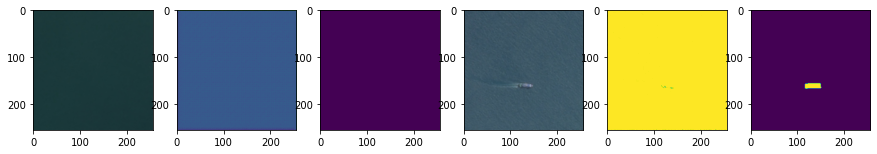

Epoch 1/5
2/2 [==============================] - 6s 3s/step - loss: 0.8314 - dice_loss: 0.9863 - accuracy: 0.5101 - val_loss: 0.7879 - val_dice_loss: 0.9903 - val_accuracy: 0.6839
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.6609 - dice_loss: 0.9853 - accuracy: 0.7029 - val_loss: 0.5816 - val_dice_loss: 0.9930 - val_accuracy: 0.7596
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.5499 - dice_loss: 0.9857 - accuracy: 0.8484 - val_loss: 0.5676 - val_dice_loss: 0.9936 - val_accuracy: 0.8805
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.4653 - dice_loss: 0.9868 - accuracy: 0.9069 - val_loss: 0.9711 - val_dice_loss: 0.9946 - val_accuracy: 0.9013
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.4024 - dice_loss: 0.9864 - accuracy: 0.9481 - val_loss: 1.4246 - val_dice_loss: 0.9936 - val_accuracy: 0.9085


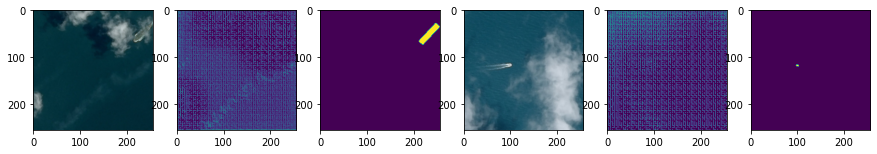

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.3424 - dice_loss: 0.9881 - accuracy: 0.9783 - val_loss: 0.8934 - val_dice_loss: 0.9857 - val_accuracy: 0.9203
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.2970 - dice_loss: 0.9879 - accuracy: 0.9862 - val_loss: 0.7504 - val_dice_loss: 0.9836 - val_accuracy: 0.9224
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.2841 - dice_loss: 0.9883 - accuracy: 0.9892 - val_loss: 0.6563 - val_dice_loss: 0.9815 - val_accuracy: 0.9155
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.2530 - dice_loss: 0.9877 - accuracy: 0.9913 - val_loss: 0.7810 - val_dice_loss: 0.9814 - val_accuracy: 0.8883
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.2164 - dice_loss: 0.9862 - accuracy: 0.9932 - val_loss: 0.9694 - val_dice_loss: 0.9827 - val_accuracy: 0.8664


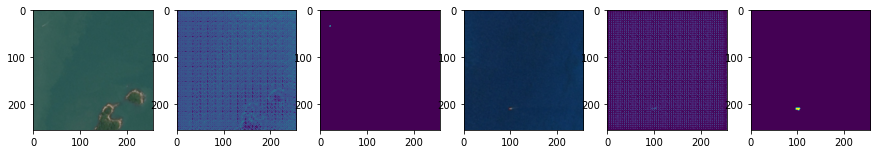

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.2073 - dice_loss: 0.9926 - accuracy: 0.9958 - val_loss: 2.1280 - val_dice_loss: 0.9886 - val_accuracy: 0.8240
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.1850 - dice_loss: 0.9924 - accuracy: 0.9962 - val_loss: 1.5804 - val_dice_loss: 0.9885 - val_accuracy: 0.8214
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.1742 - dice_loss: 0.9923 - accuracy: 0.9965 - val_loss: 1.0885 - val_dice_loss: 0.9874 - val_accuracy: 0.8349
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.1494 - dice_loss: 0.9922 - accuracy: 0.9966 - val_loss: 0.6683 - val_dice_loss: 0.9868 - val_accuracy: 0.8713
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.1391 - dice_loss: 0.9902 - accuracy: 0.9967 - val_loss: 0.3875 - val_dice_loss: 0.9863 - val_accuracy: 0.8974


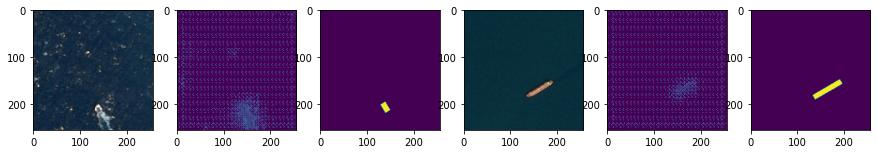

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.1404 - dice_loss: 0.9925 - accuracy: 0.9957 - val_loss: 0.3273 - val_dice_loss: 0.9879 - val_accuracy: 0.9062
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.1241 - dice_loss: 0.9910 - accuracy: 0.9957 - val_loss: 0.2946 - val_dice_loss: 0.9885 - val_accuracy: 0.9173
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.1177 - dice_loss: 0.9911 - accuracy: 0.9958 - val_loss: 0.1997 - val_dice_loss: 0.9882 - val_accuracy: 0.9438
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.1114 - dice_loss: 0.9913 - accuracy: 0.9958 - val_loss: 0.1343 - val_dice_loss: 0.9876 - val_accuracy: 0.9643
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.1059 - dice_loss: 0.9919 - accuracy: 0.9958 - val_loss: 0.0878 - val_dice_loss: 0.9855 - val_accuracy: 0.9921


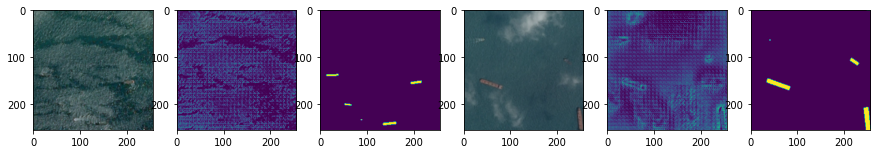

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0895 - dice_loss: 0.9878 - accuracy: 0.9955 - val_loss: 0.0640 - val_dice_loss: 0.9883 - val_accuracy: 0.9914
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0832 - dice_loss: 0.9869 - accuracy: 0.9955 - val_loss: 0.0507 - val_dice_loss: 0.9893 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0814 - dice_loss: 0.9868 - accuracy: 0.9955 - val_loss: 0.0492 - val_dice_loss: 0.9910 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0752 - dice_loss: 0.9882 - accuracy: 0.9955 - val_loss: 0.0517 - val_dice_loss: 0.9916 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0731 - dice_loss: 0.9875 - accuracy: 0.9955 - val_loss: 0.0535 - val_dice_loss: 0.9913 - val_accuracy: 0.9961


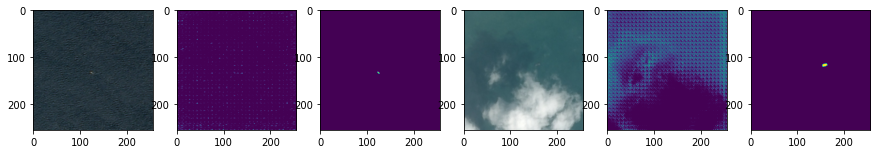

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0735 - dice_loss: 0.9883 - accuracy: 0.9950 - val_loss: 0.0649 - val_dice_loss: 0.9763 - val_accuracy: 0.9927
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0675 - dice_loss: 0.9870 - accuracy: 0.9950 - val_loss: 0.0654 - val_dice_loss: 0.9735 - val_accuracy: 0.9927
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0651 - dice_loss: 0.9875 - accuracy: 0.9950 - val_loss: 0.0693 - val_dice_loss: 0.9717 - val_accuracy: 0.9927
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0632 - dice_loss: 0.9877 - accuracy: 0.9950 - val_loss: 0.0721 - val_dice_loss: 0.9707 - val_accuracy: 0.9928
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0612 - dice_loss: 0.9868 - accuracy: 0.9950 - val_loss: 0.0735 - val_dice_loss: 0.9702 - val_accuracy: 0.9928


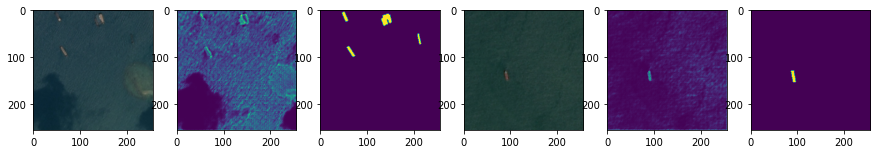

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0570 - dice_loss: 0.9888 - accuracy: 0.9965 - val_loss: 0.0917 - val_dice_loss: 0.9787 - val_accuracy: 0.9926
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0494 - dice_loss: 0.9881 - accuracy: 0.9965 - val_loss: 0.0864 - val_dice_loss: 0.9779 - val_accuracy: 0.9927
Epoch 3/5
2/2 [==============================] - 5s 3s/step - loss: 0.0514 - dice_loss: 0.9873 - accuracy: 0.9965 - val_loss: 0.0800 - val_dice_loss: 0.9767 - val_accuracy: 0.9928
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0498 - dice_loss: 0.9876 - accuracy: 0.9965 - val_loss: 0.0760 - val_dice_loss: 0.9753 - val_accuracy: 0.9928
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0461 - dice_loss: 0.9886 - accuracy: 0.9965 - val_loss: 0.0730 - val_dice_loss: 0.9737 - val_accuracy: 0.9928


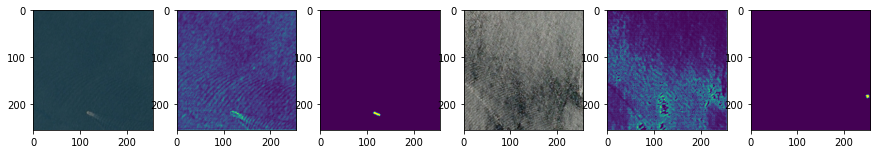

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0438 - dice_loss: 0.9866 - accuracy: 0.9956 - val_loss: 0.0619 - val_dice_loss: 0.9682 - val_accuracy: 0.9933
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0422 - dice_loss: 0.9873 - accuracy: 0.9956 - val_loss: 0.0600 - val_dice_loss: 0.9713 - val_accuracy: 0.9933
Epoch 3/5
2/2 [==============================] - 6s 3s/step - loss: 0.0408 - dice_loss: 0.9869 - accuracy: 0.9956 - val_loss: 0.0587 - val_dice_loss: 0.9752 - val_accuracy: 0.9933
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0388 - dice_loss: 0.9850 - accuracy: 0.9956 - val_loss: 0.0564 - val_dice_loss: 0.9776 - val_accuracy: 0.9933
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0391 - dice_loss: 0.9857 - accuracy: 0.9956 - val_loss: 0.0549 - val_dice_loss: 0.9789 - val_accuracy: 0.9933


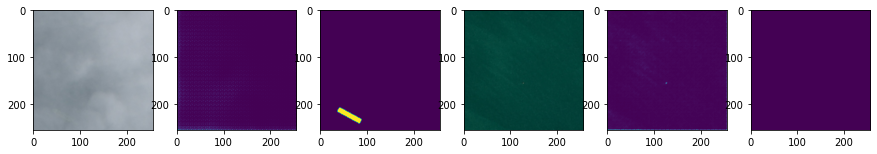

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0441 - dice_loss: 0.9869 - accuracy: 0.9945 - val_loss: 0.0305 - val_dice_loss: 0.9868 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0429 - dice_loss: 0.9862 - accuracy: 0.9945 - val_loss: 0.0277 - val_dice_loss: 0.9844 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0412 - dice_loss: 0.9855 - accuracy: 0.9945 - val_loss: 0.0279 - val_dice_loss: 0.9825 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0413 - dice_loss: 0.9848 - accuracy: 0.9945 - val_loss: 0.0297 - val_dice_loss: 0.9818 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0401 - dice_loss: 0.9828 - accuracy: 0.9945 - val_loss: 0.0320 - val_dice_loss: 0.9815 - val_accuracy: 0.9971


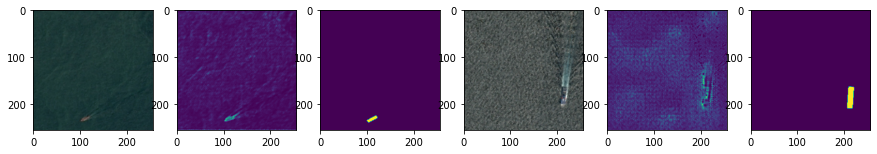

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0365 - dice_loss: 0.9863 - accuracy: 0.9959 - val_loss: 0.0527 - val_dice_loss: 0.9661 - val_accuracy: 0.9928
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0359 - dice_loss: 0.9858 - accuracy: 0.9959 - val_loss: 0.0508 - val_dice_loss: 0.9668 - val_accuracy: 0.9928
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0348 - dice_loss: 0.9832 - accuracy: 0.9959 - val_loss: 0.0494 - val_dice_loss: 0.9687 - val_accuracy: 0.9928
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0368 - dice_loss: 0.9860 - accuracy: 0.9959 - val_loss: 0.0477 - val_dice_loss: 0.9657 - val_accuracy: 0.9928
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0346 - dice_loss: 0.9857 - accuracy: 0.9959 - val_loss: 0.0447 - val_dice_loss: 0.9637 - val_accuracy: 0.9928


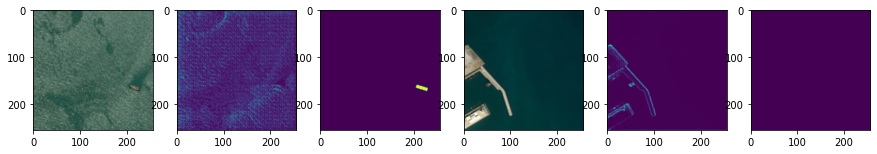

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0333 - dice_loss: 0.9892 - accuracy: 0.9964 - val_loss: 0.0374 - val_dice_loss: 0.9733 - val_accuracy: 0.9940
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0360 - dice_loss: 0.9909 - accuracy: 0.9964 - val_loss: 0.0361 - val_dice_loss: 0.9727 - val_accuracy: 0.9940
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0320 - dice_loss: 0.9886 - accuracy: 0.9964 - val_loss: 0.0352 - val_dice_loss: 0.9721 - val_accuracy: 0.9940
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0334 - dice_loss: 0.9882 - accuracy: 0.9964 - val_loss: 0.0345 - val_dice_loss: 0.9724 - val_accuracy: 0.9940
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0313 - dice_loss: 0.9881 - accuracy: 0.9964 - val_loss: 0.0340 - val_dice_loss: 0.9729 - val_accuracy: 0.9940


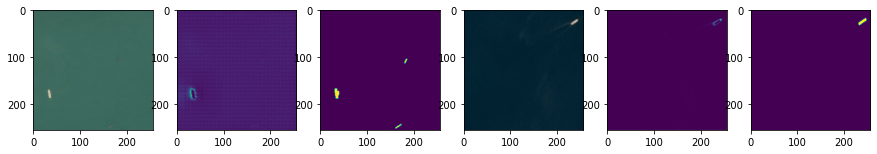

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0313 - dice_loss: 0.9857 - accuracy: 0.9958 - val_loss: 0.0311 - val_dice_loss: 0.9710 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0301 - dice_loss: 0.9829 - accuracy: 0.9958 - val_loss: 0.0302 - val_dice_loss: 0.9733 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0290 - dice_loss: 0.9815 - accuracy: 0.9958 - val_loss: 0.0297 - val_dice_loss: 0.9758 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0291 - dice_loss: 0.9828 - accuracy: 0.9958 - val_loss: 0.0296 - val_dice_loss: 0.9768 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0282 - dice_loss: 0.9802 - accuracy: 0.9958 - val_loss: 0.0293 - val_dice_loss: 0.9759 - val_accuracy: 0.9947


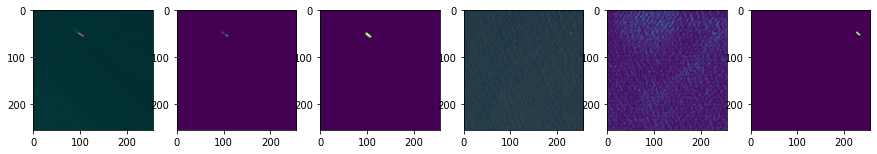

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0280 - dice_loss: 0.9918 - accuracy: 0.9974 - val_loss: 0.0352 - val_dice_loss: 0.9810 - val_accuracy: 0.9944
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0265 - dice_loss: 0.9904 - accuracy: 0.9974 - val_loss: 0.0350 - val_dice_loss: 0.9802 - val_accuracy: 0.9944
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0260 - dice_loss: 0.9913 - accuracy: 0.9974 - val_loss: 0.0348 - val_dice_loss: 0.9796 - val_accuracy: 0.9944
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0248 - dice_loss: 0.9907 - accuracy: 0.9974 - val_loss: 0.0348 - val_dice_loss: 0.9801 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0248 - dice_loss: 0.9906 - accuracy: 0.9974 - val_loss: 0.0347 - val_dice_loss: 0.9802 - val_accuracy: 0.9944


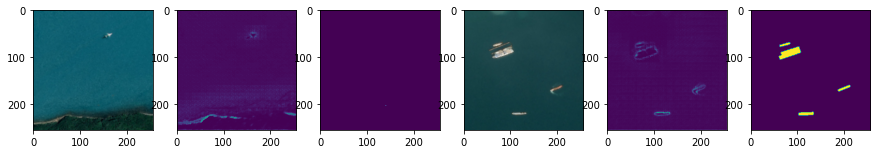

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0197 - dice_loss: 0.9895 - accuracy: 0.9977 - val_loss: 0.0339 - val_dice_loss: 0.9786 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0187 - dice_loss: 0.9905 - accuracy: 0.9977 - val_loss: 0.0340 - val_dice_loss: 0.9788 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0190 - dice_loss: 0.9902 - accuracy: 0.9977 - val_loss: 0.0341 - val_dice_loss: 0.9790 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0187 - dice_loss: 0.9907 - accuracy: 0.9977 - val_loss: 0.0341 - val_dice_loss: 0.9791 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.9904 - accuracy: 0.9977 - val_loss: 0.0337 - val_dice_loss: 0.9786 - val_accuracy: 0.9947


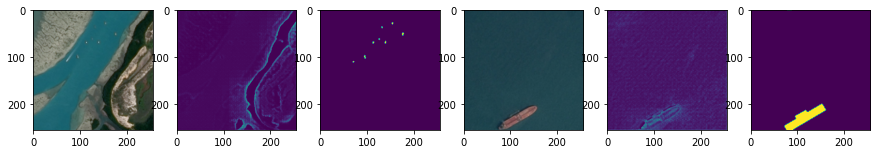

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0274 - dice_loss: 0.9841 - accuracy: 0.9957 - val_loss: 0.0241 - val_dice_loss: 0.9842 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0268 - dice_loss: 0.9832 - accuracy: 0.9957 - val_loss: 0.0246 - val_dice_loss: 0.9855 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0266 - dice_loss: 0.9774 - accuracy: 0.9957 - val_loss: 0.0247 - val_dice_loss: 0.9864 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0246 - dice_loss: 0.9598 - accuracy: 0.9956 - val_loss: 0.0247 - val_dice_loss: 0.9867 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0278 - dice_loss: 0.9629 - accuracy: 0.9956 - val_loss: 0.0243 - val_dice_loss: 0.9866 - val_accuracy: 0.9965


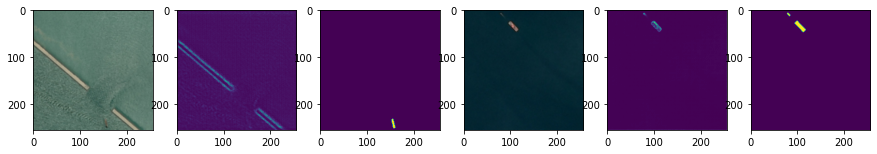

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0289 - dice_loss: 0.9478 - accuracy: 0.9949 - val_loss: 0.0320 - val_dice_loss: 0.9797 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0279 - dice_loss: 0.9310 - accuracy: 0.9949 - val_loss: 0.0326 - val_dice_loss: 0.9782 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0279 - dice_loss: 0.9292 - accuracy: 0.9948 - val_loss: 0.0332 - val_dice_loss: 0.9765 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0295 - dice_loss: 0.9380 - accuracy: 0.9949 - val_loss: 0.0334 - val_dice_loss: 0.9756 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0406 - dice_loss: 0.9691 - accuracy: 0.9949 - val_loss: 0.0319 - val_dice_loss: 0.9770 - val_accuracy: 0.9947


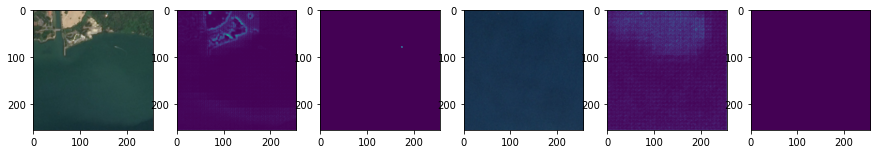

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0259 - dice_loss: 0.9046 - accuracy: 0.9948 - val_loss: 0.0229 - val_dice_loss: 0.9408 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0271 - dice_loss: 0.9123 - accuracy: 0.9947 - val_loss: 0.0225 - val_dice_loss: 0.9381 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0255 - dice_loss: 0.8953 - accuracy: 0.9948 - val_loss: 0.0221 - val_dice_loss: 0.9353 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0285 - dice_loss: 0.9027 - accuracy: 0.9949 - val_loss: 0.0216 - val_dice_loss: 0.9317 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0279 - dice_loss: 0.8754 - accuracy: 0.9952 - val_loss: 0.0211 - val_dice_loss: 0.9259 - val_accuracy: 0.9951


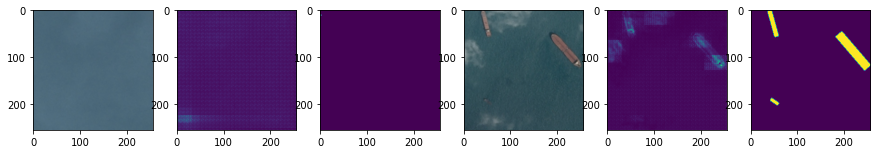

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0309 - dice_loss: 0.8851 - accuracy: 0.9917 - val_loss: 0.0199 - val_dice_loss: 0.9270 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0316 - dice_loss: 0.9044 - accuracy: 0.9923 - val_loss: 0.0212 - val_dice_loss: 0.9149 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0341 - dice_loss: 0.8872 - accuracy: 0.9922 - val_loss: 0.0193 - val_dice_loss: 0.9127 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0326 - dice_loss: 0.9069 - accuracy: 0.9922 - val_loss: 0.0189 - val_dice_loss: 0.9086 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0270 - dice_loss: 0.8481 - accuracy: 0.9926 - val_loss: 0.0184 - val_dice_loss: 0.9119 - val_accuracy: 0.9964


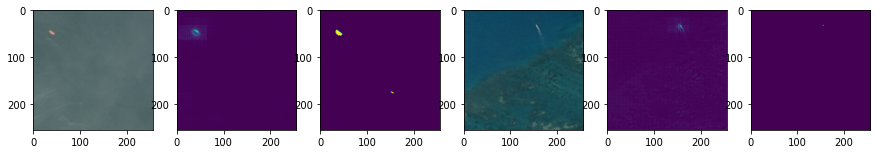

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0262 - dice_loss: 0.9457 - accuracy: 0.9949 - val_loss: 0.0159 - val_dice_loss: 0.9606 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0271 - dice_loss: 0.9510 - accuracy: 0.9951 - val_loss: 0.0160 - val_dice_loss: 0.9608 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0250 - dice_loss: 0.9420 - accuracy: 0.9951 - val_loss: 0.0162 - val_dice_loss: 0.9567 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0280 - dice_loss: 0.9659 - accuracy: 0.9951 - val_loss: 0.0181 - val_dice_loss: 0.9555 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0253 - dice_loss: 0.9578 - accuracy: 0.9951 - val_loss: 0.0219 - val_dice_loss: 0.9596 - val_accuracy: 0.9971


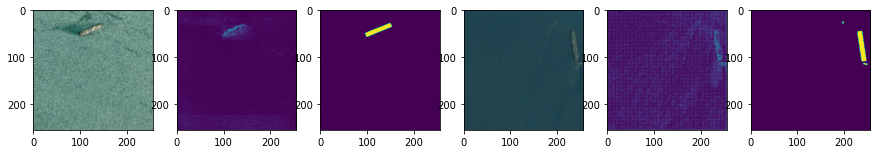

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0353 - dice_loss: 0.9221 - accuracy: 0.9923 - val_loss: 0.0266 - val_dice_loss: 0.9620 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0349 - dice_loss: 0.9102 - accuracy: 0.9924 - val_loss: 0.0208 - val_dice_loss: 0.9592 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0329 - dice_loss: 0.8855 - accuracy: 0.9926 - val_loss: 0.0183 - val_dice_loss: 0.9605 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0338 - dice_loss: 0.8864 - accuracy: 0.9923 - val_loss: 0.0172 - val_dice_loss: 0.9612 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0314 - dice_loss: 0.8598 - accuracy: 0.9929 - val_loss: 0.0165 - val_dice_loss: 0.9600 - val_accuracy: 0.9968


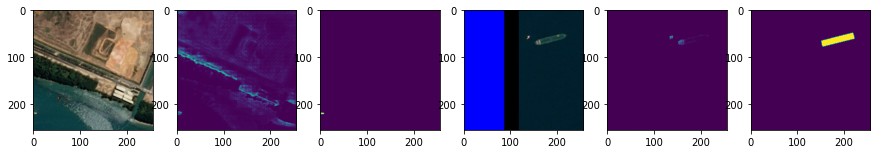

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0218 - dice_loss: 0.9468 - accuracy: 0.9963 - val_loss: 0.0168 - val_dice_loss: 0.8500 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0213 - dice_loss: 0.9348 - accuracy: 0.9963 - val_loss: 0.0176 - val_dice_loss: 0.8561 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0195 - dice_loss: 0.9170 - accuracy: 0.9964 - val_loss: 0.0180 - val_dice_loss: 0.8596 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0189 - dice_loss: 0.9094 - accuracy: 0.9964 - val_loss: 0.0187 - val_dice_loss: 0.8645 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0188 - dice_loss: 0.9210 - accuracy: 0.9964 - val_loss: 0.0201 - val_dice_loss: 0.8710 - val_accuracy: 0.9964


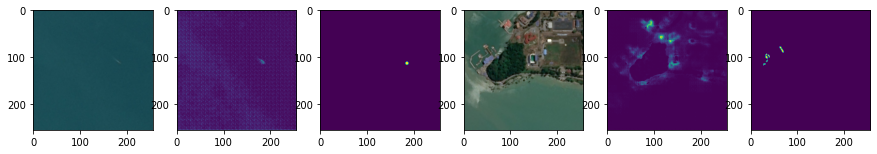

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0231 - dice_loss: 0.8486 - accuracy: 0.9953 - val_loss: 0.0233 - val_dice_loss: 0.8947 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0217 - dice_loss: 0.8341 - accuracy: 0.9955 - val_loss: 0.0231 - val_dice_loss: 0.8936 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0208 - dice_loss: 0.8519 - accuracy: 0.9954 - val_loss: 0.0227 - val_dice_loss: 0.8884 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0201 - dice_loss: 0.7987 - accuracy: 0.9957 - val_loss: 0.0226 - val_dice_loss: 0.8879 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0206 - dice_loss: 0.8111 - accuracy: 0.9956 - val_loss: 0.0231 - val_dice_loss: 0.8959 - val_accuracy: 0.9942


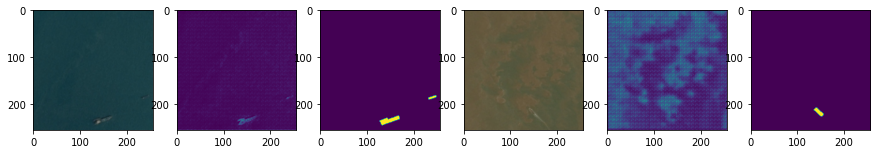

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.8943 - accuracy: 0.9975 - val_loss: 0.0204 - val_dice_loss: 0.9608 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.8857 - accuracy: 0.9974 - val_loss: 0.0203 - val_dice_loss: 0.9611 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.8734 - accuracy: 0.9975 - val_loss: 0.0201 - val_dice_loss: 0.9607 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.8915 - accuracy: 0.9974 - val_loss: 0.0198 - val_dice_loss: 0.9610 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.8679 - accuracy: 0.9975 - val_loss: 0.0197 - val_dice_loss: 0.9635 - val_accuracy: 0.9959


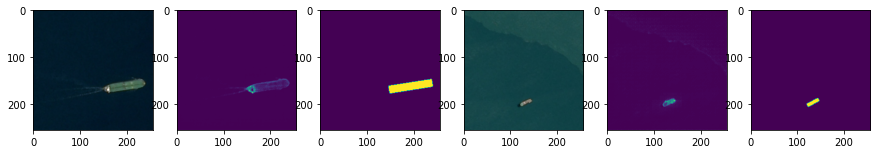

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.9121 - accuracy: 0.9968 - val_loss: 0.0247 - val_dice_loss: 0.8903 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0138 - dice_loss: 0.9025 - accuracy: 0.9971 - val_loss: 0.0252 - val_dice_loss: 0.9014 - val_accuracy: 0.9940
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0127 - dice_loss: 0.9051 - accuracy: 0.9971 - val_loss: 0.0257 - val_dice_loss: 0.9116 - val_accuracy: 0.9939
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.9200 - accuracy: 0.9971 - val_loss: 0.0259 - val_dice_loss: 0.9148 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.8890 - accuracy: 0.9972 - val_loss: 0.0256 - val_dice_loss: 0.9022 - val_accuracy: 0.9941


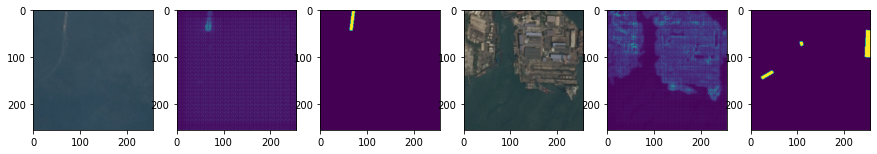

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.8905 - accuracy: 0.9963 - val_loss: 0.0197 - val_dice_loss: 0.9270 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0179 - dice_loss: 0.8869 - accuracy: 0.9964 - val_loss: 0.0192 - val_dice_loss: 0.9175 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0171 - dice_loss: 0.8506 - accuracy: 0.9964 - val_loss: 0.0189 - val_dice_loss: 0.9152 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0169 - dice_loss: 0.8641 - accuracy: 0.9963 - val_loss: 0.0194 - val_dice_loss: 0.9282 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.8626 - accuracy: 0.9964 - val_loss: 0.0203 - val_dice_loss: 0.9435 - val_accuracy: 0.9952


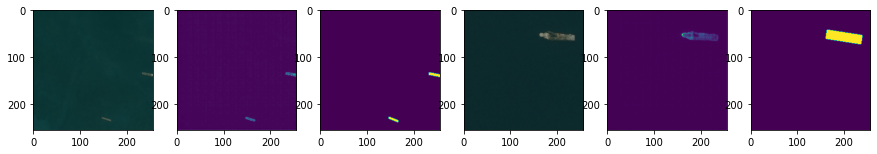

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.8684 - accuracy: 0.9962 - val_loss: 0.0154 - val_dice_loss: 0.9471 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.7980 - accuracy: 0.9964 - val_loss: 0.0157 - val_dice_loss: 0.9476 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.7786 - accuracy: 0.9963 - val_loss: 0.0156 - val_dice_loss: 0.9452 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.7684 - accuracy: 0.9969 - val_loss: 0.0152 - val_dice_loss: 0.9399 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.7784 - accuracy: 0.9968 - val_loss: 0.0147 - val_dice_loss: 0.9302 - val_accuracy: 0.9966


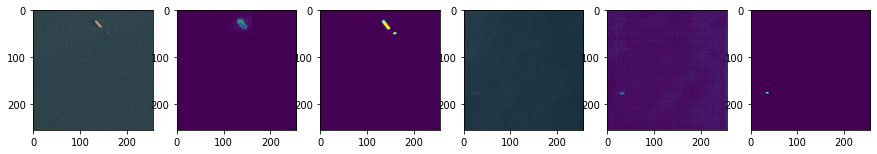

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0305 - dice_loss: 0.7354 - accuracy: 0.9925 - val_loss: 0.0267 - val_dice_loss: 0.9101 - val_accuracy: 0.9941
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0304 - dice_loss: 0.7338 - accuracy: 0.9920 - val_loss: 0.0255 - val_dice_loss: 0.8860 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0242 - dice_loss: 0.7155 - accuracy: 0.9925 - val_loss: 0.0245 - val_dice_loss: 0.8655 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0224 - dice_loss: 0.6674 - accuracy: 0.9926 - val_loss: 0.0236 - val_dice_loss: 0.8458 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0227 - dice_loss: 0.7078 - accuracy: 0.9925 - val_loss: 0.0230 - val_dice_loss: 0.8330 - val_accuracy: 0.9942


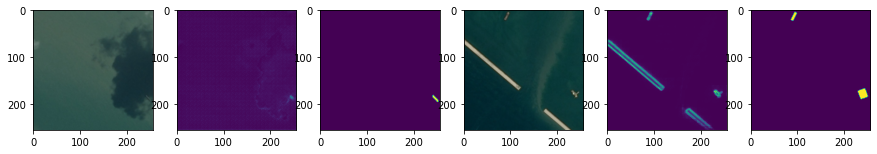

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0267 - dice_loss: 0.8150 - accuracy: 0.9918 - val_loss: 0.0131 - val_dice_loss: 0.8227 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0220 - dice_loss: 0.8503 - accuracy: 0.9943 - val_loss: 0.0140 - val_dice_loss: 0.8482 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0189 - dice_loss: 0.8252 - accuracy: 0.9949 - val_loss: 0.0148 - val_dice_loss: 0.8669 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.7738 - accuracy: 0.9953 - val_loss: 0.0154 - val_dice_loss: 0.8761 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0169 - dice_loss: 0.7761 - accuracy: 0.9948 - val_loss: 0.0156 - val_dice_loss: 0.8710 - val_accuracy: 0.9960


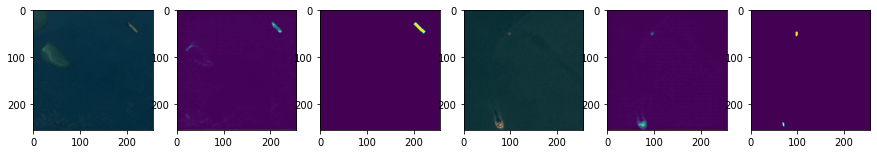

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0295 - dice_loss: 0.8168 - accuracy: 0.9933 - val_loss: 0.0205 - val_dice_loss: 0.8889 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0243 - dice_loss: 0.8259 - accuracy: 0.9942 - val_loss: 0.0202 - val_dice_loss: 0.8873 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0218 - dice_loss: 0.7613 - accuracy: 0.9940 - val_loss: 0.0199 - val_dice_loss: 0.8873 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0199 - dice_loss: 0.6968 - accuracy: 0.9941 - val_loss: 0.0201 - val_dice_loss: 0.8931 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0202 - dice_loss: 0.6997 - accuracy: 0.9943 - val_loss: 0.0210 - val_dice_loss: 0.9123 - val_accuracy: 0.9956


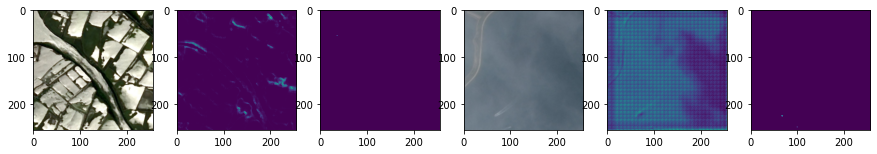

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0188 - dice_loss: 0.8644 - accuracy: 0.9957 - val_loss: 0.0230 - val_dice_loss: 0.8923 - val_accuracy: 0.9941
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.8695 - accuracy: 0.9960 - val_loss: 0.0227 - val_dice_loss: 0.8878 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0165 - dice_loss: 0.8618 - accuracy: 0.9962 - val_loss: 0.0215 - val_dice_loss: 0.8620 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.8704 - accuracy: 0.9962 - val_loss: 0.0206 - val_dice_loss: 0.8323 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.8538 - accuracy: 0.9962 - val_loss: 0.0199 - val_dice_loss: 0.8099 - val_accuracy: 0.9943


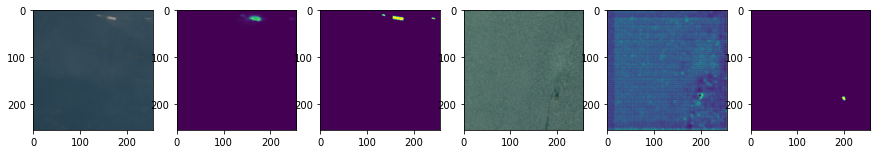

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0238 - dice_loss: 0.8821 - accuracy: 0.9951 - val_loss: 0.0192 - val_dice_loss: 0.7511 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0216 - dice_loss: 0.8678 - accuracy: 0.9951 - val_loss: 0.0184 - val_dice_loss: 0.7424 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.8333 - accuracy: 0.9953 - val_loss: 0.0189 - val_dice_loss: 0.7658 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.7852 - accuracy: 0.9956 - val_loss: 0.0191 - val_dice_loss: 0.7773 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0181 - dice_loss: 0.7714 - accuracy: 0.9953 - val_loss: 0.0191 - val_dice_loss: 0.7779 - val_accuracy: 0.9955


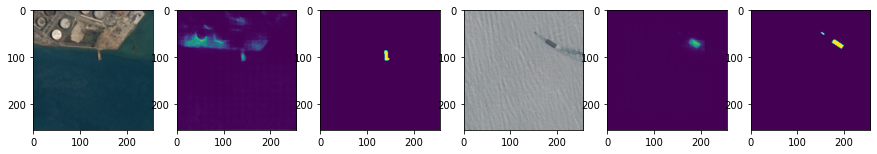

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0194 - dice_loss: 0.7170 - accuracy: 0.9952 - val_loss: 0.0259 - val_dice_loss: 0.8358 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0177 - dice_loss: 0.6695 - accuracy: 0.9952 - val_loss: 0.0256 - val_dice_loss: 0.8311 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.6412 - accuracy: 0.9952 - val_loss: 0.0266 - val_dice_loss: 0.8303 - val_accuracy: 0.9938
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.6450 - accuracy: 0.9950 - val_loss: 0.0303 - val_dice_loss: 0.8341 - val_accuracy: 0.9923
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0154 - dice_loss: 0.6272 - accuracy: 0.9953 - val_loss: 0.0371 - val_dice_loss: 0.8405 - val_accuracy: 0.9894


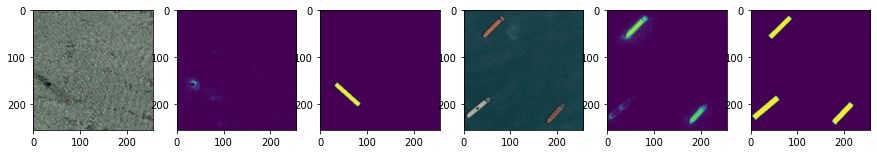

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0213 - dice_loss: 0.7792 - accuracy: 0.9943 - val_loss: 0.0214 - val_dice_loss: 0.8863 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0184 - dice_loss: 0.7647 - accuracy: 0.9944 - val_loss: 0.0201 - val_dice_loss: 0.8817 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0196 - dice_loss: 0.7817 - accuracy: 0.9943 - val_loss: 0.0206 - val_dice_loss: 0.8967 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.7603 - accuracy: 0.9943 - val_loss: 0.0199 - val_dice_loss: 0.8803 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0176 - dice_loss: 0.7527 - accuracy: 0.9946 - val_loss: 0.0182 - val_dice_loss: 0.8452 - val_accuracy: 0.9964


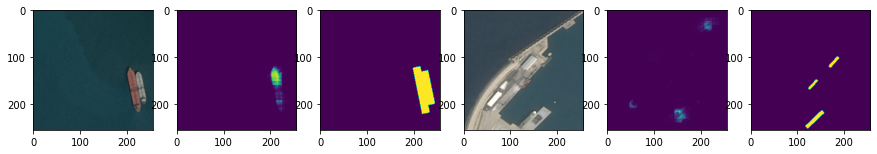

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.6571 - accuracy: 0.9956 - val_loss: 0.0299 - val_dice_loss: 0.8025 - val_accuracy: 0.9937
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0187 - dice_loss: 0.6667 - accuracy: 0.9951 - val_loss: 0.0353 - val_dice_loss: 0.8863 - val_accuracy: 0.9933
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0177 - dice_loss: 0.6444 - accuracy: 0.9954 - val_loss: 0.0405 - val_dice_loss: 0.9315 - val_accuracy: 0.9932
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0156 - dice_loss: 0.6388 - accuracy: 0.9956 - val_loss: 0.0438 - val_dice_loss: 0.9613 - val_accuracy: 0.9931
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0160 - dice_loss: 0.6528 - accuracy: 0.9956 - val_loss: 0.0456 - val_dice_loss: 0.9658 - val_accuracy: 0.9931


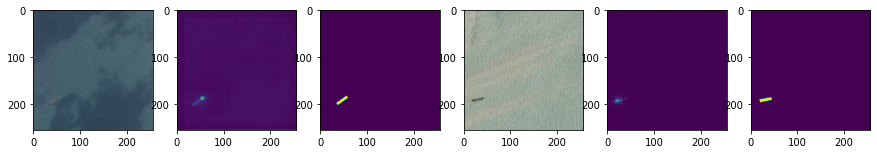

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0185 - dice_loss: 0.7395 - accuracy: 0.9957 - val_loss: 0.0249 - val_dice_loss: 0.8061 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.7304 - accuracy: 0.9959 - val_loss: 0.0206 - val_dice_loss: 0.7480 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.7224 - accuracy: 0.9956 - val_loss: 0.0158 - val_dice_loss: 0.6726 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.7188 - accuracy: 0.9961 - val_loss: 0.0156 - val_dice_loss: 0.6663 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.6776 - accuracy: 0.9967 - val_loss: 0.0157 - val_dice_loss: 0.6645 - val_accuracy: 0.9958


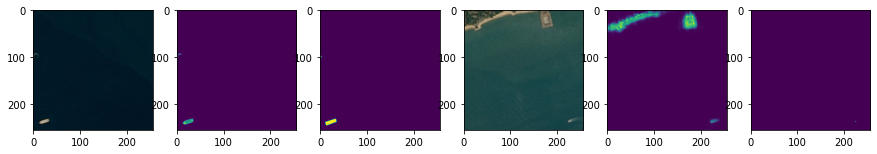

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.7744 - accuracy: 0.9952 - val_loss: 0.0174 - val_dice_loss: 0.7486 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.8276 - accuracy: 0.9947 - val_loss: 0.0193 - val_dice_loss: 0.7779 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.8807 - accuracy: 0.9962 - val_loss: 0.0235 - val_dice_loss: 0.8712 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.9097 - accuracy: 0.9964 - val_loss: 0.0273 - val_dice_loss: 0.9198 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.8997 - accuracy: 0.9964 - val_loss: 0.0285 - val_dice_loss: 0.9371 - val_accuracy: 0.9945


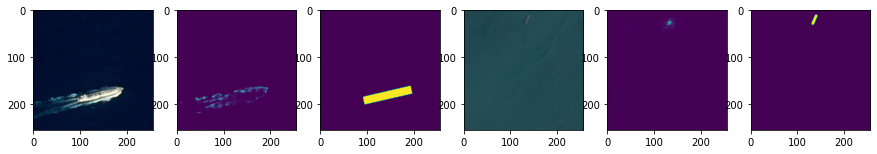

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0286 - dice_loss: 0.8501 - accuracy: 0.9937 - val_loss: 0.0349 - val_dice_loss: 0.9357 - val_accuracy: 0.9935
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0236 - dice_loss: 0.7149 - accuracy: 0.9947 - val_loss: 0.0247 - val_dice_loss: 0.7875 - val_accuracy: 0.9940
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0192 - dice_loss: 0.6761 - accuracy: 0.9949 - val_loss: 0.0187 - val_dice_loss: 0.6597 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0210 - dice_loss: 0.7061 - accuracy: 0.9949 - val_loss: 0.0181 - val_dice_loss: 0.6648 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.6949 - accuracy: 0.9946 - val_loss: 0.0179 - val_dice_loss: 0.6533 - val_accuracy: 0.9949


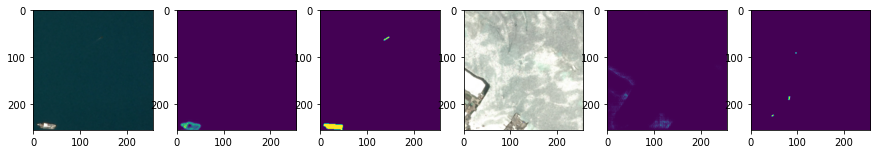

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.8375 - accuracy: 0.9957 - val_loss: 0.0135 - val_dice_loss: 0.6800 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0169 - dice_loss: 0.8142 - accuracy: 0.9960 - val_loss: 0.0137 - val_dice_loss: 0.6692 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 5s 3s/step - loss: 0.0156 - dice_loss: 0.8411 - accuracy: 0.9962 - val_loss: 0.0143 - val_dice_loss: 0.6736 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0153 - dice_loss: 0.8108 - accuracy: 0.9963 - val_loss: 0.0154 - val_dice_loss: 0.6952 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0160 - dice_loss: 0.8335 - accuracy: 0.9961 - val_loss: 0.0166 - val_dice_loss: 0.7217 - val_accuracy: 0.9957


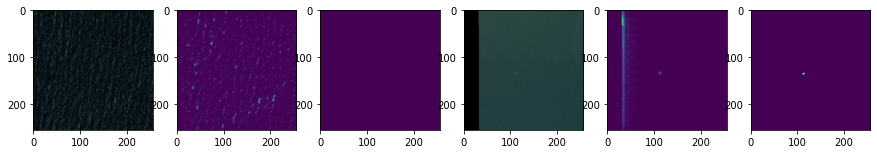

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0288 - dice_loss: 0.8615 - accuracy: 0.9923 - val_loss: 0.0131 - val_dice_loss: 0.8112 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0285 - dice_loss: 0.8517 - accuracy: 0.9923 - val_loss: 0.0119 - val_dice_loss: 0.7832 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0254 - dice_loss: 0.7969 - accuracy: 0.9926 - val_loss: 0.0114 - val_dice_loss: 0.7551 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0236 - dice_loss: 0.7660 - accuracy: 0.9928 - val_loss: 0.0119 - val_dice_loss: 0.7386 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0258 - dice_loss: 0.7961 - accuracy: 0.9923 - val_loss: 0.0117 - val_dice_loss: 0.7148 - val_accuracy: 0.9967


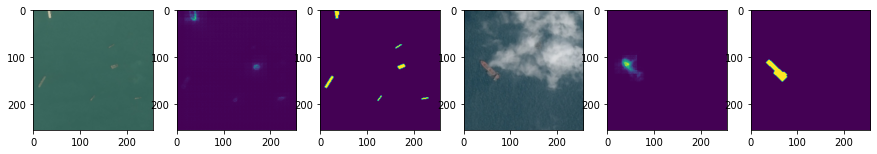

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0263 - dice_loss: 0.8160 - accuracy: 0.9936 - val_loss: 0.0200 - val_dice_loss: 0.7739 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0274 - dice_loss: 0.8699 - accuracy: 0.9936 - val_loss: 0.0189 - val_dice_loss: 0.7610 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0254 - dice_loss: 0.8465 - accuracy: 0.9941 - val_loss: 0.0193 - val_dice_loss: 0.7594 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0251 - dice_loss: 0.8496 - accuracy: 0.9942 - val_loss: 0.0203 - val_dice_loss: 0.7629 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0242 - dice_loss: 0.8543 - accuracy: 0.9945 - val_loss: 0.0206 - val_dice_loss: 0.7666 - val_accuracy: 0.9943


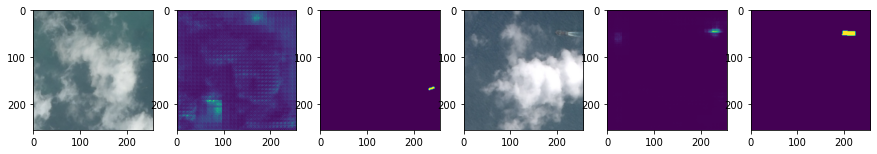

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.7949 - accuracy: 0.9955 - val_loss: 0.0215 - val_dice_loss: 0.7716 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0156 - dice_loss: 0.7846 - accuracy: 0.9959 - val_loss: 0.0208 - val_dice_loss: 0.7566 - val_accuracy: 0.9944
Epoch 3/5
2/2 [==============================] - 5s 3s/step - loss: 0.0123 - dice_loss: 0.6832 - accuracy: 0.9963 - val_loss: 0.0203 - val_dice_loss: 0.7464 - val_accuracy: 0.9945
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0115 - dice_loss: 0.6489 - accuracy: 0.9968 - val_loss: 0.0202 - val_dice_loss: 0.7441 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0119 - dice_loss: 0.6498 - accuracy: 0.9968 - val_loss: 0.0200 - val_dice_loss: 0.7408 - val_accuracy: 0.9943


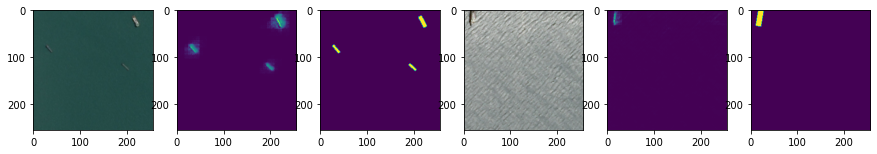

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0199 - dice_loss: 0.7760 - accuracy: 0.9948 - val_loss: 0.0097 - val_dice_loss: 0.5927 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0175 - dice_loss: 0.6995 - accuracy: 0.9953 - val_loss: 0.0095 - val_dice_loss: 0.5699 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0163 - dice_loss: 0.6690 - accuracy: 0.9954 - val_loss: 0.0101 - val_dice_loss: 0.5775 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0154 - dice_loss: 0.6409 - accuracy: 0.9958 - val_loss: 0.0113 - val_dice_loss: 0.6086 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.6304 - accuracy: 0.9960 - val_loss: 0.0143 - val_dice_loss: 0.6784 - val_accuracy: 0.9957


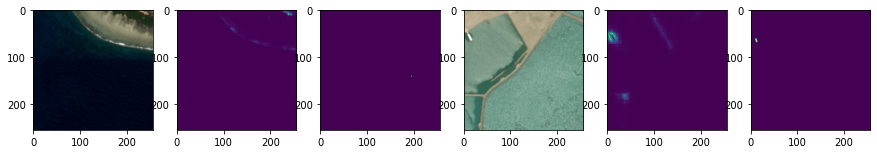

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0183 - dice_loss: 0.8476 - accuracy: 0.9959 - val_loss: 0.0219 - val_dice_loss: 0.8026 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.8242 - accuracy: 0.9958 - val_loss: 0.0210 - val_dice_loss: 0.7895 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.8105 - accuracy: 0.9961 - val_loss: 0.0199 - val_dice_loss: 0.7729 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.8102 - accuracy: 0.9962 - val_loss: 0.0183 - val_dice_loss: 0.7407 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.7589 - accuracy: 0.9963 - val_loss: 0.0171 - val_dice_loss: 0.7154 - val_accuracy: 0.9959


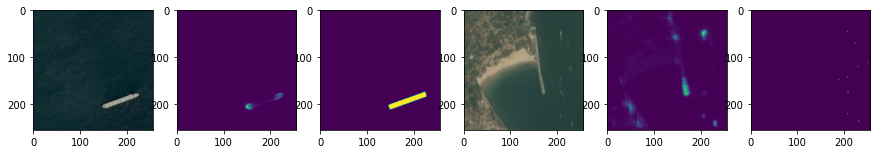

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.7783 - accuracy: 0.9960 - val_loss: 0.0138 - val_dice_loss: 0.5438 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.7639 - accuracy: 0.9963 - val_loss: 0.0138 - val_dice_loss: 0.5459 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0137 - dice_loss: 0.7384 - accuracy: 0.9963 - val_loss: 0.0136 - val_dice_loss: 0.5479 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0123 - dice_loss: 0.7186 - accuracy: 0.9965 - val_loss: 0.0136 - val_dice_loss: 0.5558 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0112 - dice_loss: 0.6808 - accuracy: 0.9968 - val_loss: 0.0139 - val_dice_loss: 0.5684 - val_accuracy: 0.9953


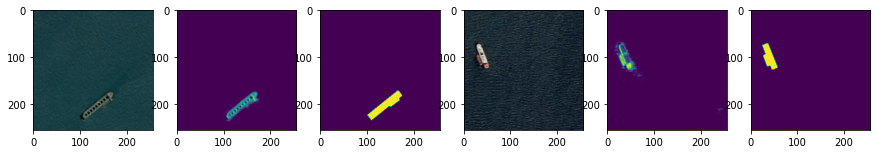

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0320 - dice_loss: 0.7815 - accuracy: 0.9921 - val_loss: 0.0223 - val_dice_loss: 0.6967 - val_accuracy: 0.9945
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0303 - dice_loss: 0.7701 - accuracy: 0.9919 - val_loss: 0.0217 - val_dice_loss: 0.6945 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0298 - dice_loss: 0.7532 - accuracy: 0.9920 - val_loss: 0.0207 - val_dice_loss: 0.7092 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0270 - dice_loss: 0.7484 - accuracy: 0.9919 - val_loss: 0.0213 - val_dice_loss: 0.7324 - val_accuracy: 0.9938
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0256 - dice_loss: 0.7354 - accuracy: 0.9917 - val_loss: 0.0229 - val_dice_loss: 0.7559 - val_accuracy: 0.9934


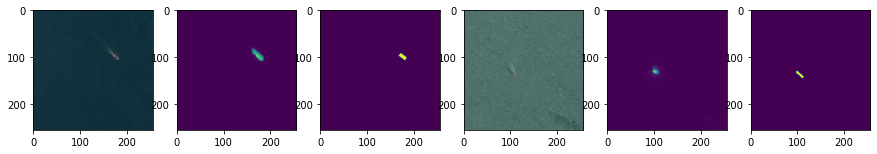

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0138 - dice_loss: 0.8227 - accuracy: 0.9962 - val_loss: 0.0132 - val_dice_loss: 0.6839 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 5s 2s/step - loss: 0.0145 - dice_loss: 0.8279 - accuracy: 0.9961 - val_loss: 0.0123 - val_dice_loss: 0.6796 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.8160 - accuracy: 0.9963 - val_loss: 0.0124 - val_dice_loss: 0.6907 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0118 - dice_loss: 0.8299 - accuracy: 0.9966 - val_loss: 0.0131 - val_dice_loss: 0.7130 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0112 - dice_loss: 0.8470 - accuracy: 0.9967 - val_loss: 0.0143 - val_dice_loss: 0.7355 - val_accuracy: 0.9959


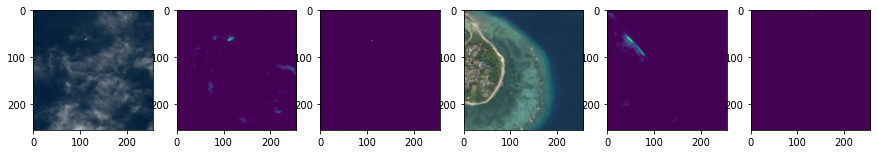

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.7680 - accuracy: 0.9958 - val_loss: 0.0132 - val_dice_loss: 0.8532 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.7459 - accuracy: 0.9958 - val_loss: 0.0158 - val_dice_loss: 0.8722 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.7358 - accuracy: 0.9955 - val_loss: 0.0166 - val_dice_loss: 0.8745 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.6927 - accuracy: 0.9961 - val_loss: 0.0153 - val_dice_loss: 0.8630 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0126 - dice_loss: 0.6811 - accuracy: 0.9962 - val_loss: 0.0143 - val_dice_loss: 0.8538 - val_accuracy: 0.9968


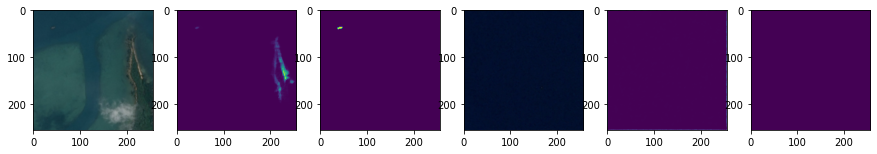

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0123 - dice_loss: 0.8257 - accuracy: 0.9972 - val_loss: 0.0200 - val_dice_loss: 0.8817 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.7884 - accuracy: 0.9972 - val_loss: 0.0196 - val_dice_loss: 0.8775 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0109 - dice_loss: 0.7663 - accuracy: 0.9973 - val_loss: 0.0191 - val_dice_loss: 0.8742 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.7307 - accuracy: 0.9973 - val_loss: 0.0186 - val_dice_loss: 0.8705 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.7420 - accuracy: 0.9973 - val_loss: 0.0177 - val_dice_loss: 0.8655 - val_accuracy: 0.9966


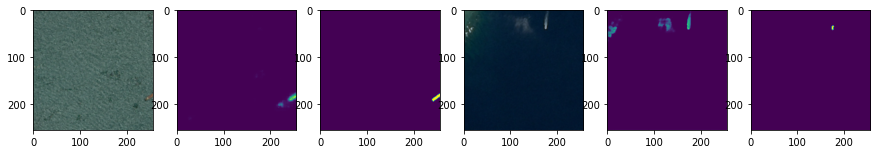

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.7169 - accuracy: 0.9953 - val_loss: 0.0202 - val_dice_loss: 0.8387 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.7157 - accuracy: 0.9953 - val_loss: 0.0202 - val_dice_loss: 0.8320 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.6771 - accuracy: 0.9954 - val_loss: 0.0203 - val_dice_loss: 0.8258 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.6933 - accuracy: 0.9953 - val_loss: 0.0205 - val_dice_loss: 0.8187 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6671 - accuracy: 0.9955 - val_loss: 0.0207 - val_dice_loss: 0.8134 - val_accuracy: 0.9950


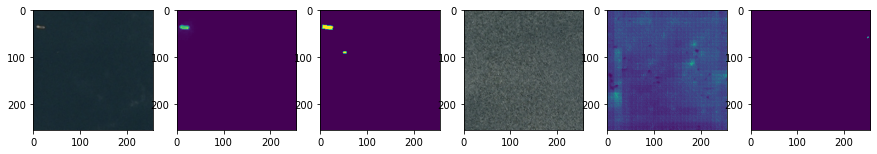

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.7246 - accuracy: 0.9967 - val_loss: 0.0118 - val_dice_loss: 0.6412 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.7426 - accuracy: 0.9968 - val_loss: 0.0115 - val_dice_loss: 0.6264 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.7260 - accuracy: 0.9970 - val_loss: 0.0115 - val_dice_loss: 0.6163 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.7158 - accuracy: 0.9974 - val_loss: 0.0114 - val_dice_loss: 0.6097 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.7104 - accuracy: 0.9975 - val_loss: 0.0113 - val_dice_loss: 0.6039 - val_accuracy: 0.9968


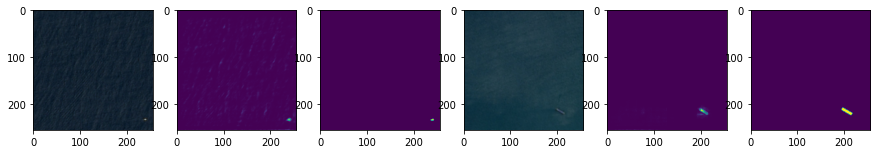

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.8323 - accuracy: 0.9955 - val_loss: 0.0107 - val_dice_loss: 0.7984 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.8569 - accuracy: 0.9956 - val_loss: 0.0102 - val_dice_loss: 0.7868 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.8334 - accuracy: 0.9956 - val_loss: 0.0099 - val_dice_loss: 0.7773 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.8401 - accuracy: 0.9956 - val_loss: 0.0094 - val_dice_loss: 0.7644 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.7942 - accuracy: 0.9957 - val_loss: 0.0090 - val_dice_loss: 0.7515 - val_accuracy: 0.9975


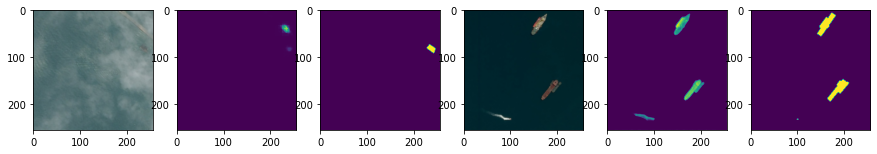

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6771 - accuracy: 0.9972 - val_loss: 0.0227 - val_dice_loss: 0.7772 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.4944 - accuracy: 0.9981 - val_loss: 0.0230 - val_dice_loss: 0.7776 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5383 - accuracy: 0.9979 - val_loss: 0.0230 - val_dice_loss: 0.7794 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5821 - accuracy: 0.9977 - val_loss: 0.0232 - val_dice_loss: 0.7844 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.4998 - accuracy: 0.9979 - val_loss: 0.0234 - val_dice_loss: 0.7940 - val_accuracy: 0.9949


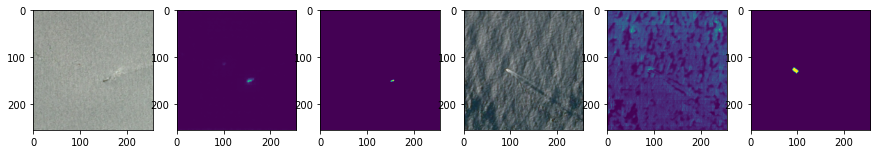

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.7307 - accuracy: 0.9983 - val_loss: 0.0101 - val_dice_loss: 0.6402 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0060 - dice_loss: 0.6757 - accuracy: 0.9984 - val_loss: 0.0104 - val_dice_loss: 0.6613 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.6822 - accuracy: 0.9984 - val_loss: 0.0108 - val_dice_loss: 0.6945 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0064 - dice_loss: 0.7481 - accuracy: 0.9985 - val_loss: 0.0113 - val_dice_loss: 0.7320 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0053 - dice_loss: 0.6877 - accuracy: 0.9985 - val_loss: 0.0117 - val_dice_loss: 0.7703 - val_accuracy: 0.9971


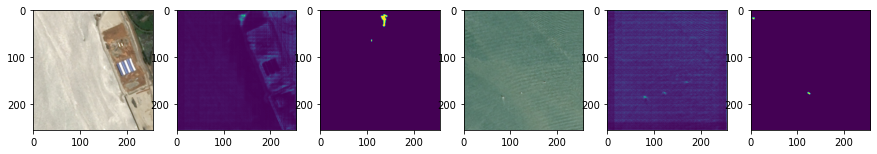

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0111 - dice_loss: 0.8342 - accuracy: 0.9980 - val_loss: 0.0176 - val_dice_loss: 0.8791 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.8179 - accuracy: 0.9980 - val_loss: 0.0160 - val_dice_loss: 0.8327 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.7956 - accuracy: 0.9981 - val_loss: 0.0137 - val_dice_loss: 0.7401 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.7641 - accuracy: 0.9980 - val_loss: 0.0121 - val_dice_loss: 0.6827 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.7463 - accuracy: 0.9981 - val_loss: 0.0110 - val_dice_loss: 0.6452 - val_accuracy: 0.9971


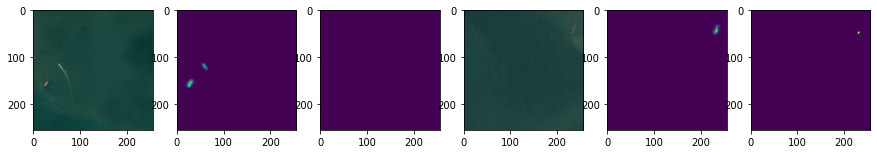

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5802 - accuracy: 0.9977 - val_loss: 0.0174 - val_dice_loss: 0.5891 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6059 - accuracy: 0.9975 - val_loss: 0.0171 - val_dice_loss: 0.5833 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6148 - accuracy: 0.9976 - val_loss: 0.0170 - val_dice_loss: 0.5812 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5658 - accuracy: 0.9978 - val_loss: 0.0171 - val_dice_loss: 0.5794 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5899 - accuracy: 0.9977 - val_loss: 0.0176 - val_dice_loss: 0.5815 - val_accuracy: 0.9954


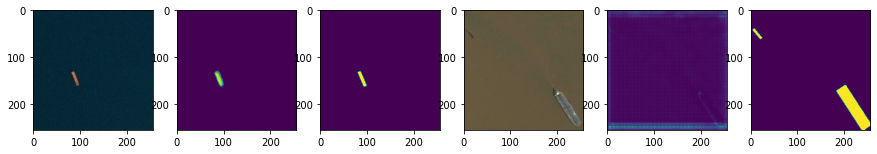

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0334 - dice_loss: 0.8670 - accuracy: 0.9922 - val_loss: 0.0181 - val_dice_loss: 0.6923 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0314 - dice_loss: 0.8668 - accuracy: 0.9929 - val_loss: 0.0185 - val_dice_loss: 0.6835 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0298 - dice_loss: 0.8533 - accuracy: 0.9932 - val_loss: 0.0184 - val_dice_loss: 0.6800 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0269 - dice_loss: 0.8076 - accuracy: 0.9934 - val_loss: 0.0179 - val_dice_loss: 0.6826 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0255 - dice_loss: 0.8130 - accuracy: 0.9932 - val_loss: 0.0174 - val_dice_loss: 0.6864 - val_accuracy: 0.9959


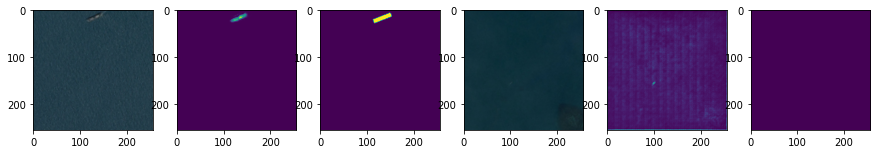

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6780 - accuracy: 0.9968 - val_loss: 0.0244 - val_dice_loss: 0.8014 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.6649 - accuracy: 0.9972 - val_loss: 0.0242 - val_dice_loss: 0.8017 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6058 - accuracy: 0.9975 - val_loss: 0.0243 - val_dice_loss: 0.8011 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6432 - accuracy: 0.9972 - val_loss: 0.0245 - val_dice_loss: 0.8003 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6217 - accuracy: 0.9974 - val_loss: 0.0247 - val_dice_loss: 0.8005 - val_accuracy: 0.9953


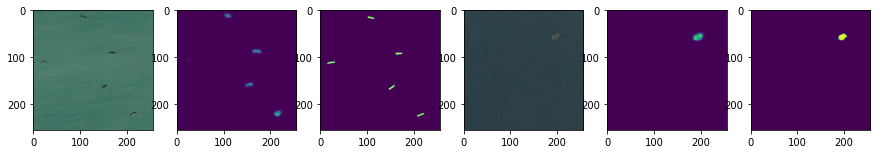

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6223 - accuracy: 0.9962 - val_loss: 0.0201 - val_dice_loss: 0.7882 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.6026 - accuracy: 0.9964 - val_loss: 0.0179 - val_dice_loss: 0.7417 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4953 - accuracy: 0.9970 - val_loss: 0.0161 - val_dice_loss: 0.6978 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.4725 - accuracy: 0.9972 - val_loss: 0.0152 - val_dice_loss: 0.6676 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5124 - accuracy: 0.9972 - val_loss: 0.0150 - val_dice_loss: 0.6536 - val_accuracy: 0.9959


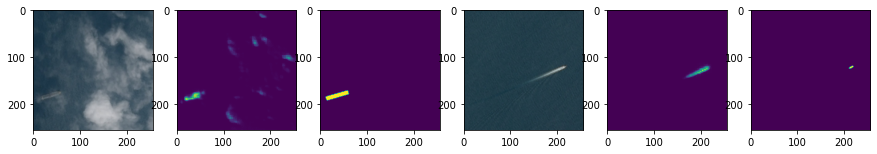

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0153 - dice_loss: 0.6451 - accuracy: 0.9964 - val_loss: 0.0135 - val_dice_loss: 0.7545 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6401 - accuracy: 0.9963 - val_loss: 0.0137 - val_dice_loss: 0.7610 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.6171 - accuracy: 0.9967 - val_loss: 0.0141 - val_dice_loss: 0.7899 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5781 - accuracy: 0.9968 - val_loss: 0.0143 - val_dice_loss: 0.8120 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5833 - accuracy: 0.9968 - val_loss: 0.0142 - val_dice_loss: 0.8198 - val_accuracy: 0.9966


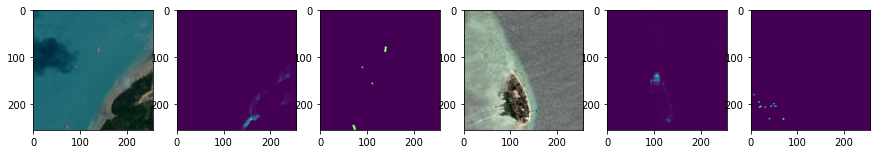

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5181 - accuracy: 0.9967 - val_loss: 0.0221 - val_dice_loss: 0.7524 - val_accuracy: 0.9941
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.4904 - accuracy: 0.9968 - val_loss: 0.0220 - val_dice_loss: 0.7435 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0085 - dice_loss: 0.5227 - accuracy: 0.9967 - val_loss: 0.0217 - val_dice_loss: 0.7350 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0080 - dice_loss: 0.4668 - accuracy: 0.9970 - val_loss: 0.0210 - val_dice_loss: 0.7143 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.4491 - accuracy: 0.9972 - val_loss: 0.0204 - val_dice_loss: 0.6962 - val_accuracy: 0.9944


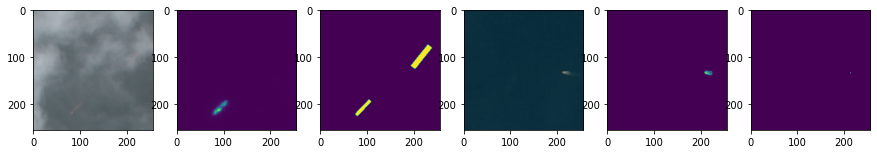

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.7680 - accuracy: 0.9960 - val_loss: 0.0160 - val_dice_loss: 0.8312 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0138 - dice_loss: 0.7812 - accuracy: 0.9965 - val_loss: 0.0163 - val_dice_loss: 0.8435 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0124 - dice_loss: 0.7450 - accuracy: 0.9967 - val_loss: 0.0167 - val_dice_loss: 0.8534 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0129 - dice_loss: 0.7645 - accuracy: 0.9967 - val_loss: 0.0171 - val_dice_loss: 0.8667 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0147 - dice_loss: 0.7777 - accuracy: 0.9966 - val_loss: 0.0182 - val_dice_loss: 0.8932 - val_accuracy: 0.9960


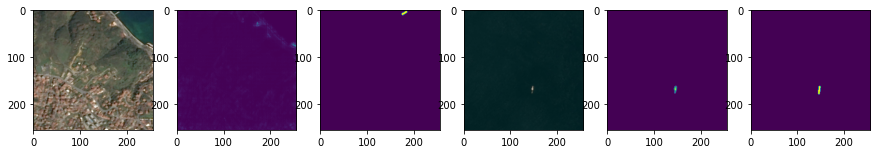

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0125 - dice_loss: 0.8361 - accuracy: 0.9970 - val_loss: 0.0132 - val_dice_loss: 0.6773 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.8186 - accuracy: 0.9973 - val_loss: 0.0133 - val_dice_loss: 0.7110 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.8206 - accuracy: 0.9972 - val_loss: 0.0136 - val_dice_loss: 0.7582 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.8128 - accuracy: 0.9973 - val_loss: 0.0138 - val_dice_loss: 0.7914 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0114 - dice_loss: 0.8253 - accuracy: 0.9972 - val_loss: 0.0139 - val_dice_loss: 0.8136 - val_accuracy: 0.9969


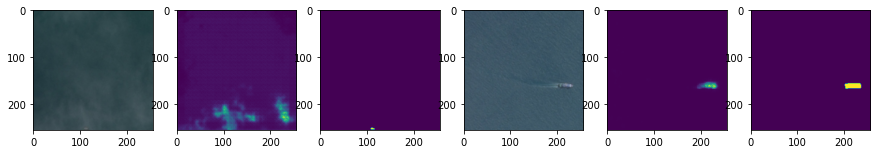

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0258 - dice_loss: 0.8025 - accuracy: 0.9935 - val_loss: 0.0117 - val_dice_loss: 0.7451 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0190 - dice_loss: 0.6786 - accuracy: 0.9941 - val_loss: 0.0106 - val_dice_loss: 0.6827 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0154 - dice_loss: 0.5829 - accuracy: 0.9951 - val_loss: 0.0106 - val_dice_loss: 0.6643 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0133 - dice_loss: 0.5442 - accuracy: 0.9956 - val_loss: 0.0109 - val_dice_loss: 0.6653 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0127 - dice_loss: 0.5532 - accuracy: 0.9959 - val_loss: 0.0109 - val_dice_loss: 0.6641 - val_accuracy: 0.9964


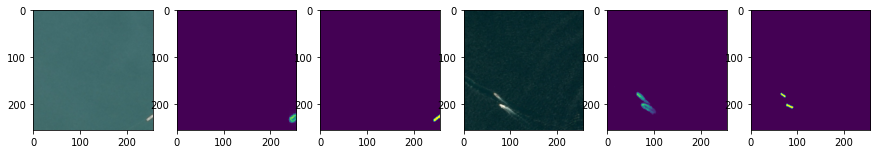

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0179 - dice_loss: 0.6183 - accuracy: 0.9949 - val_loss: 0.0206 - val_dice_loss: 0.8265 - val_accuracy: 0.9958
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0178 - dice_loss: 0.5845 - accuracy: 0.9951 - val_loss: 0.0212 - val_dice_loss: 0.8239 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0148 - dice_loss: 0.5512 - accuracy: 0.9952 - val_loss: 0.0217 - val_dice_loss: 0.8209 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0136 - dice_loss: 0.5410 - accuracy: 0.9955 - val_loss: 0.0220 - val_dice_loss: 0.8193 - val_accuracy: 0.9956
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0138 - dice_loss: 0.5303 - accuracy: 0.9953 - val_loss: 0.0219 - val_dice_loss: 0.8171 - val_accuracy: 0.9955


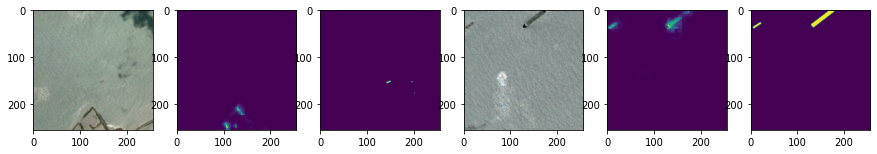

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0166 - dice_loss: 0.6915 - accuracy: 0.9938 - val_loss: 0.0108 - val_dice_loss: 0.5723 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0144 - dice_loss: 0.6418 - accuracy: 0.9948 - val_loss: 0.0106 - val_dice_loss: 0.5595 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 5s 3s/step - loss: 0.0135 - dice_loss: 0.6167 - accuracy: 0.9951 - val_loss: 0.0107 - val_dice_loss: 0.5701 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0131 - dice_loss: 0.6314 - accuracy: 0.9954 - val_loss: 0.0115 - val_dice_loss: 0.6080 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0133 - dice_loss: 0.6403 - accuracy: 0.9952 - val_loss: 0.0126 - val_dice_loss: 0.6448 - val_accuracy: 0.9965


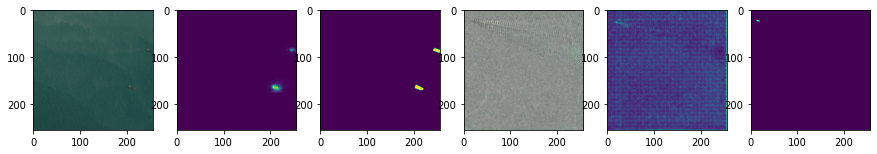

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.6268 - accuracy: 0.9976 - val_loss: 0.0111 - val_dice_loss: 0.6617 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6998 - accuracy: 0.9976 - val_loss: 0.0109 - val_dice_loss: 0.6512 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.6204 - accuracy: 0.9976 - val_loss: 0.0108 - val_dice_loss: 0.6396 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.6078 - accuracy: 0.9976 - val_loss: 0.0106 - val_dice_loss: 0.6270 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5967 - accuracy: 0.9977 - val_loss: 0.0107 - val_dice_loss: 0.6190 - val_accuracy: 0.9967


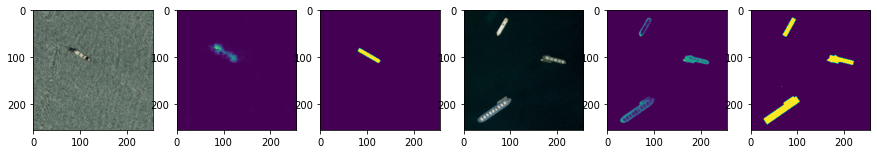

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0228 - dice_loss: 0.7608 - accuracy: 0.9939 - val_loss: 0.0244 - val_dice_loss: 0.7080 - val_accuracy: 0.9923
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0215 - dice_loss: 0.7500 - accuracy: 0.9940 - val_loss: 0.0229 - val_dice_loss: 0.6731 - val_accuracy: 0.9925
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0202 - dice_loss: 0.7045 - accuracy: 0.9938 - val_loss: 0.0216 - val_dice_loss: 0.6490 - val_accuracy: 0.9927
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.7180 - accuracy: 0.9937 - val_loss: 0.0213 - val_dice_loss: 0.6393 - val_accuracy: 0.9929
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0184 - dice_loss: 0.6875 - accuracy: 0.9938 - val_loss: 0.0218 - val_dice_loss: 0.6427 - val_accuracy: 0.9931


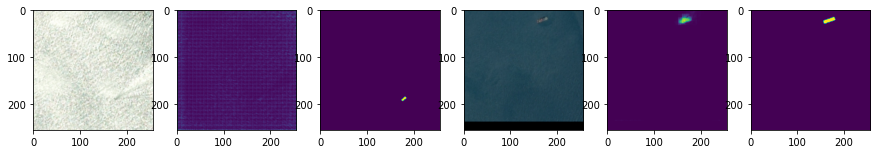

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5955 - accuracy: 0.9976 - val_loss: 0.0094 - val_dice_loss: 0.6129 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5514 - accuracy: 0.9975 - val_loss: 0.0094 - val_dice_loss: 0.6123 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.5611 - accuracy: 0.9977 - val_loss: 0.0095 - val_dice_loss: 0.6185 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.5306 - accuracy: 0.9978 - val_loss: 0.0097 - val_dice_loss: 0.6219 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.5304 - accuracy: 0.9979 - val_loss: 0.0102 - val_dice_loss: 0.6421 - val_accuracy: 0.9969


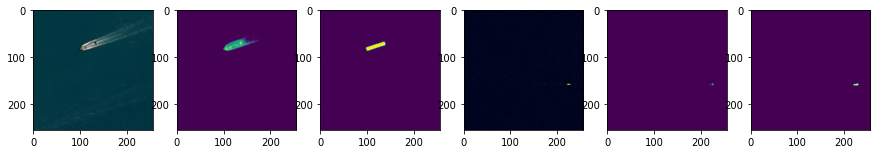

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0182 - dice_loss: 0.4929 - accuracy: 0.9944 - val_loss: 0.0117 - val_dice_loss: 0.6366 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.4205 - accuracy: 0.9950 - val_loss: 0.0117 - val_dice_loss: 0.6385 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.4330 - accuracy: 0.9951 - val_loss: 0.0120 - val_dice_loss: 0.6589 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.5019 - accuracy: 0.9939 - val_loss: 0.0130 - val_dice_loss: 0.7017 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.3723 - accuracy: 0.9958 - val_loss: 0.0140 - val_dice_loss: 0.7228 - val_accuracy: 0.9965


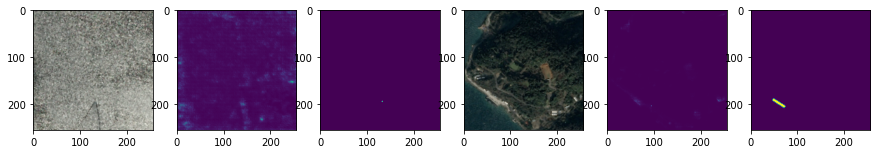

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0191 - dice_loss: 0.7242 - accuracy: 0.9936 - val_loss: 0.0152 - val_dice_loss: 0.7190 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0173 - dice_loss: 0.6904 - accuracy: 0.9940 - val_loss: 0.0157 - val_dice_loss: 0.7250 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.7085 - accuracy: 0.9948 - val_loss: 0.0164 - val_dice_loss: 0.7388 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.6753 - accuracy: 0.9951 - val_loss: 0.0175 - val_dice_loss: 0.7663 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6569 - accuracy: 0.9961 - val_loss: 0.0186 - val_dice_loss: 0.8072 - val_accuracy: 0.9963


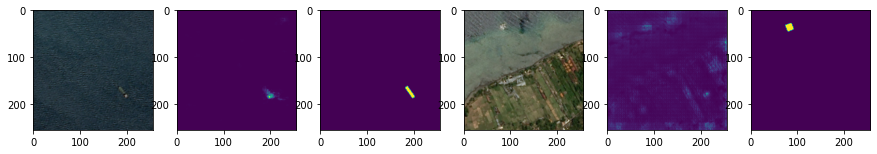

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0333 - dice_loss: 0.7443 - accuracy: 0.9931 - val_loss: 0.0162 - val_dice_loss: 0.7737 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0337 - dice_loss: 0.7517 - accuracy: 0.9929 - val_loss: 0.0152 - val_dice_loss: 0.7308 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0312 - dice_loss: 0.7424 - accuracy: 0.9931 - val_loss: 0.0136 - val_dice_loss: 0.6929 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0312 - dice_loss: 0.7277 - accuracy: 0.9934 - val_loss: 0.0119 - val_dice_loss: 0.6761 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0259 - dice_loss: 0.6725 - accuracy: 0.9937 - val_loss: 0.0130 - val_dice_loss: 0.7055 - val_accuracy: 0.9966


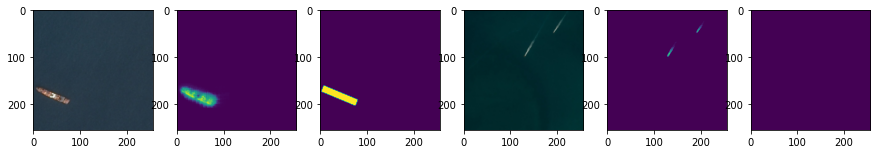

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.7566 - accuracy: 0.9956 - val_loss: 0.0156 - val_dice_loss: 0.6634 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.7235 - accuracy: 0.9974 - val_loss: 0.0152 - val_dice_loss: 0.6581 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.7371 - accuracy: 0.9966 - val_loss: 0.0147 - val_dice_loss: 0.6577 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.7060 - accuracy: 0.9973 - val_loss: 0.0154 - val_dice_loss: 0.6925 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.7193 - accuracy: 0.9975 - val_loss: 0.0176 - val_dice_loss: 0.7632 - val_accuracy: 0.9949


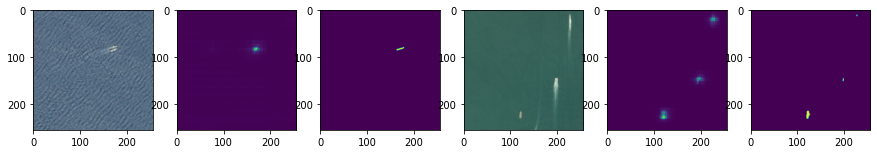

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.7932 - accuracy: 0.9978 - val_loss: 0.0159 - val_dice_loss: 0.9186 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.7428 - accuracy: 0.9979 - val_loss: 0.0171 - val_dice_loss: 0.9359 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.8097 - accuracy: 0.9977 - val_loss: 0.0177 - val_dice_loss: 0.9411 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.7901 - accuracy: 0.9977 - val_loss: 0.0180 - val_dice_loss: 0.9325 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.7069 - accuracy: 0.9979 - val_loss: 0.0179 - val_dice_loss: 0.9227 - val_accuracy: 0.9967


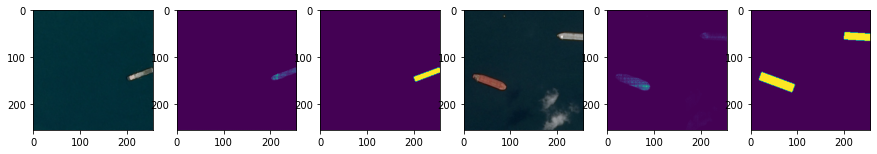

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0247 - dice_loss: 0.8013 - accuracy: 0.9931 - val_loss: 0.0204 - val_dice_loss: 0.7392 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.6802 - accuracy: 0.9935 - val_loss: 0.0172 - val_dice_loss: 0.6846 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.6224 - accuracy: 0.9944 - val_loss: 0.0128 - val_dice_loss: 0.5935 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.5608 - accuracy: 0.9951 - val_loss: 0.0101 - val_dice_loss: 0.5221 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5524 - accuracy: 0.9953 - val_loss: 0.0094 - val_dice_loss: 0.5033 - val_accuracy: 0.9970


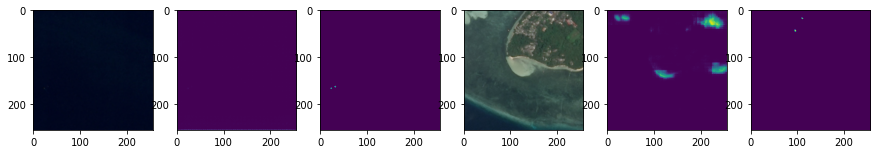

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0167 - dice_loss: 0.7817 - accuracy: 0.9953 - val_loss: 0.0109 - val_dice_loss: 0.6205 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.7980 - accuracy: 0.9956 - val_loss: 0.0104 - val_dice_loss: 0.6143 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.7382 - accuracy: 0.9958 - val_loss: 0.0100 - val_dice_loss: 0.6182 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.7363 - accuracy: 0.9962 - val_loss: 0.0103 - val_dice_loss: 0.6412 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.7185 - accuracy: 0.9975 - val_loss: 0.0113 - val_dice_loss: 0.6858 - val_accuracy: 0.9963


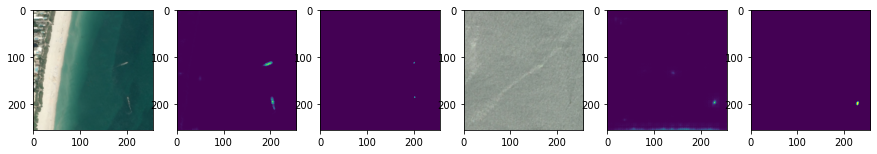

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.7107 - accuracy: 0.9980 - val_loss: 0.0109 - val_dice_loss: 0.8625 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.7054 - accuracy: 0.9980 - val_loss: 0.0113 - val_dice_loss: 0.8725 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.7071 - accuracy: 0.9981 - val_loss: 0.0118 - val_dice_loss: 0.8805 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.7116 - accuracy: 0.9980 - val_loss: 0.0123 - val_dice_loss: 0.8842 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.6813 - accuracy: 0.9980 - val_loss: 0.0127 - val_dice_loss: 0.8854 - val_accuracy: 0.9973


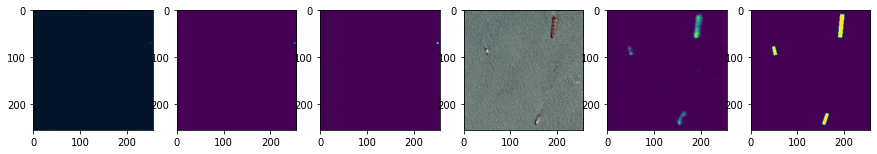

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.7419 - accuracy: 0.9968 - val_loss: 0.0287 - val_dice_loss: 0.7188 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6937 - accuracy: 0.9970 - val_loss: 0.0267 - val_dice_loss: 0.6885 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6733 - accuracy: 0.9971 - val_loss: 0.0246 - val_dice_loss: 0.6550 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6838 - accuracy: 0.9970 - val_loss: 0.0226 - val_dice_loss: 0.6156 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5963 - accuracy: 0.9974 - val_loss: 0.0213 - val_dice_loss: 0.5847 - val_accuracy: 0.9952


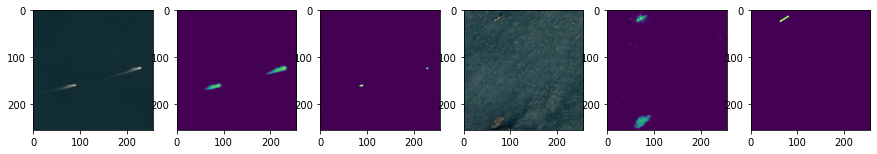

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0230 - dice_loss: 0.7661 - accuracy: 0.9937 - val_loss: 0.0113 - val_dice_loss: 0.7172 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.6898 - accuracy: 0.9938 - val_loss: 0.0134 - val_dice_loss: 0.8264 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.6630 - accuracy: 0.9943 - val_loss: 0.0176 - val_dice_loss: 0.8706 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.6963 - accuracy: 0.9941 - val_loss: 0.0178 - val_dice_loss: 0.8849 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.7020 - accuracy: 0.9941 - val_loss: 0.0180 - val_dice_loss: 0.8943 - val_accuracy: 0.9968


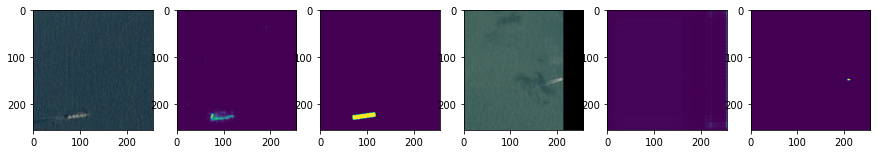

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.7856 - accuracy: 0.9961 - val_loss: 0.0290 - val_dice_loss: 0.6915 - val_accuracy: 0.9939
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.7617 - accuracy: 0.9964 - val_loss: 0.0269 - val_dice_loss: 0.6660 - val_accuracy: 0.9944
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.7507 - accuracy: 0.9965 - val_loss: 0.0257 - val_dice_loss: 0.6597 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.7171 - accuracy: 0.9970 - val_loss: 0.0252 - val_dice_loss: 0.6599 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6940 - accuracy: 0.9972 - val_loss: 0.0250 - val_dice_loss: 0.6626 - val_accuracy: 0.9947


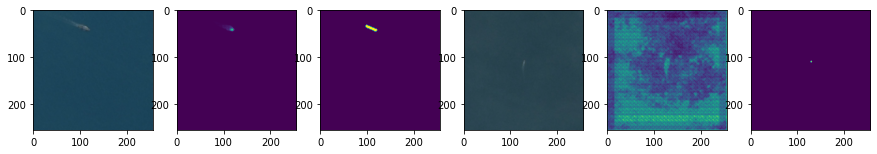

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0285 - dice_loss: 0.7707 - accuracy: 0.9922 - val_loss: 0.0189 - val_dice_loss: 0.7266 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0281 - dice_loss: 0.7650 - accuracy: 0.9921 - val_loss: 0.0189 - val_dice_loss: 0.7279 - val_accuracy: 0.9946
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0287 - dice_loss: 0.7469 - accuracy: 0.9920 - val_loss: 0.0184 - val_dice_loss: 0.7229 - val_accuracy: 0.9946
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0251 - dice_loss: 0.7179 - accuracy: 0.9922 - val_loss: 0.0184 - val_dice_loss: 0.7264 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0251 - dice_loss: 0.7184 - accuracy: 0.9922 - val_loss: 0.0184 - val_dice_loss: 0.7310 - val_accuracy: 0.9946


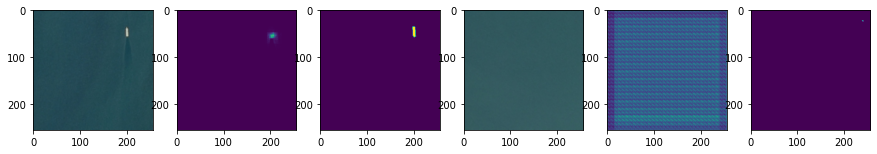

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.6446 - accuracy: 0.9967 - val_loss: 0.0199 - val_dice_loss: 0.7295 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.6491 - accuracy: 0.9966 - val_loss: 0.0201 - val_dice_loss: 0.7304 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.6095 - accuracy: 0.9969 - val_loss: 0.0204 - val_dice_loss: 0.7334 - val_accuracy: 0.9945
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6304 - accuracy: 0.9969 - val_loss: 0.0206 - val_dice_loss: 0.7363 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6230 - accuracy: 0.9964 - val_loss: 0.0205 - val_dice_loss: 0.7371 - val_accuracy: 0.9943


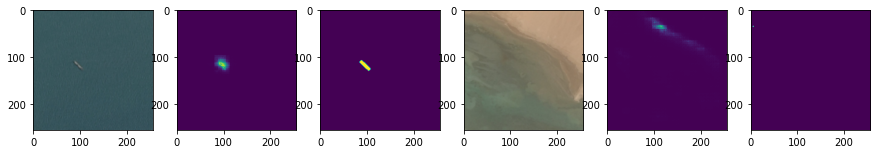

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0202 - dice_loss: 0.7784 - accuracy: 0.9944 - val_loss: 0.0189 - val_dice_loss: 0.7840 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0204 - dice_loss: 0.7750 - accuracy: 0.9943 - val_loss: 0.0185 - val_dice_loss: 0.7939 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0171 - dice_loss: 0.7506 - accuracy: 0.9943 - val_loss: 0.0183 - val_dice_loss: 0.8023 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.7175 - accuracy: 0.9945 - val_loss: 0.0176 - val_dice_loss: 0.7876 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.7105 - accuracy: 0.9946 - val_loss: 0.0165 - val_dice_loss: 0.7744 - val_accuracy: 0.9958


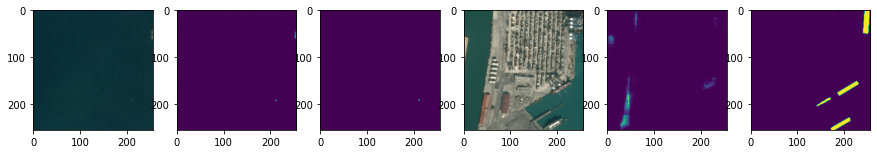

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0189 - dice_loss: 0.7710 - accuracy: 0.9943 - val_loss: 0.0135 - val_dice_loss: 0.6022 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.7410 - accuracy: 0.9945 - val_loss: 0.0148 - val_dice_loss: 0.6253 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0191 - dice_loss: 0.7545 - accuracy: 0.9946 - val_loss: 0.0147 - val_dice_loss: 0.6291 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.7260 - accuracy: 0.9945 - val_loss: 0.0145 - val_dice_loss: 0.6285 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.7100 - accuracy: 0.9947 - val_loss: 0.0150 - val_dice_loss: 0.6391 - val_accuracy: 0.9949


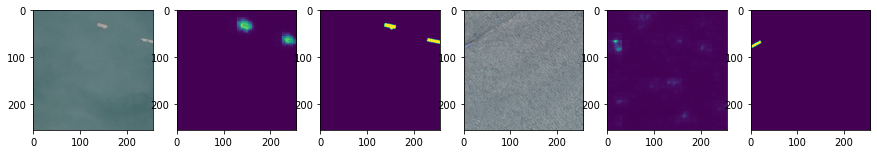

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.7615 - accuracy: 0.9980 - val_loss: 0.0150 - val_dice_loss: 0.6954 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.7321 - accuracy: 0.9980 - val_loss: 0.0189 - val_dice_loss: 0.7280 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.7391 - accuracy: 0.9975 - val_loss: 0.0211 - val_dice_loss: 0.7431 - val_accuracy: 0.9944
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.7321 - accuracy: 0.9975 - val_loss: 0.0219 - val_dice_loss: 0.7560 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.7179 - accuracy: 0.9976 - val_loss: 0.0225 - val_dice_loss: 0.7687 - val_accuracy: 0.9943


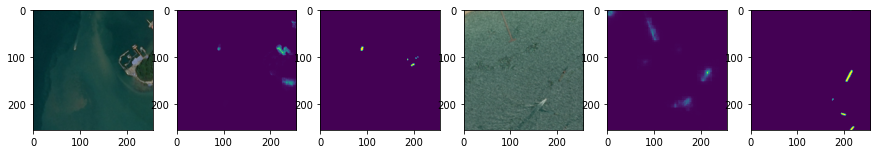

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.7323 - accuracy: 0.9953 - val_loss: 0.0115 - val_dice_loss: 0.6431 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5948 - accuracy: 0.9963 - val_loss: 0.0110 - val_dice_loss: 0.6289 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.5696 - accuracy: 0.9966 - val_loss: 0.0132 - val_dice_loss: 0.6880 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5601 - accuracy: 0.9969 - val_loss: 0.0155 - val_dice_loss: 0.7245 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.5360 - accuracy: 0.9972 - val_loss: 0.0158 - val_dice_loss: 0.7249 - val_accuracy: 0.9954


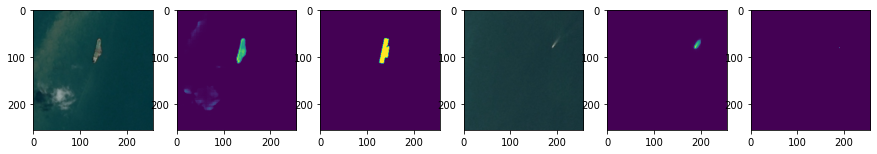

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.6008 - accuracy: 0.9947 - val_loss: 0.0175 - val_dice_loss: 0.6693 - val_accuracy: 0.9920
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5909 - accuracy: 0.9951 - val_loss: 0.0177 - val_dice_loss: 0.6646 - val_accuracy: 0.9917
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5866 - accuracy: 0.9951 - val_loss: 0.0181 - val_dice_loss: 0.6606 - val_accuracy: 0.9913
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5653 - accuracy: 0.9955 - val_loss: 0.0188 - val_dice_loss: 0.6582 - val_accuracy: 0.9907
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5969 - accuracy: 0.9947 - val_loss: 0.0193 - val_dice_loss: 0.6546 - val_accuracy: 0.9904


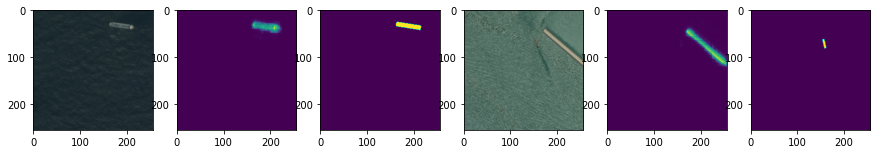

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0165 - dice_loss: 0.5571 - accuracy: 0.9947 - val_loss: 0.0206 - val_dice_loss: 0.8329 - val_accuracy: 0.9909
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0156 - dice_loss: 0.5351 - accuracy: 0.9949 - val_loss: 0.0176 - val_dice_loss: 0.8115 - val_accuracy: 0.9926
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0151 - dice_loss: 0.5157 - accuracy: 0.9953 - val_loss: 0.0141 - val_dice_loss: 0.7799 - val_accuracy: 0.9945
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0169 - dice_loss: 0.5563 - accuracy: 0.9943 - val_loss: 0.0112 - val_dice_loss: 0.7452 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0137 - dice_loss: 0.4964 - accuracy: 0.9954 - val_loss: 0.0098 - val_dice_loss: 0.7228 - val_accuracy: 0.9968


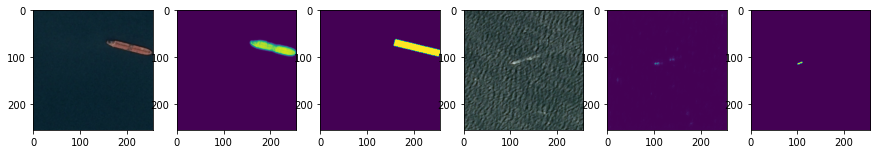

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0177 - dice_loss: 0.7921 - accuracy: 0.9952 - val_loss: 0.0150 - val_dice_loss: 0.5322 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.7509 - accuracy: 0.9954 - val_loss: 0.0152 - val_dice_loss: 0.5263 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.7479 - accuracy: 0.9957 - val_loss: 0.0159 - val_dice_loss: 0.5355 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.7248 - accuracy: 0.9958 - val_loss: 0.0175 - val_dice_loss: 0.5763 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.7298 - accuracy: 0.9961 - val_loss: 0.0184 - val_dice_loss: 0.6084 - val_accuracy: 0.9955


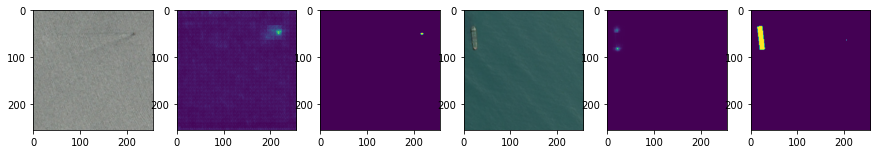

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0152 - dice_loss: 0.5969 - accuracy: 0.9950 - val_loss: 0.0321 - val_dice_loss: 0.8574 - val_accuracy: 0.9932
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0152 - dice_loss: 0.5718 - accuracy: 0.9954 - val_loss: 0.0292 - val_dice_loss: 0.8119 - val_accuracy: 0.9932
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.4910 - accuracy: 0.9960 - val_loss: 0.0265 - val_dice_loss: 0.7727 - val_accuracy: 0.9933
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.4823 - accuracy: 0.9962 - val_loss: 0.0244 - val_dice_loss: 0.7459 - val_accuracy: 0.9934
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4920 - accuracy: 0.9964 - val_loss: 0.0236 - val_dice_loss: 0.7386 - val_accuracy: 0.9934


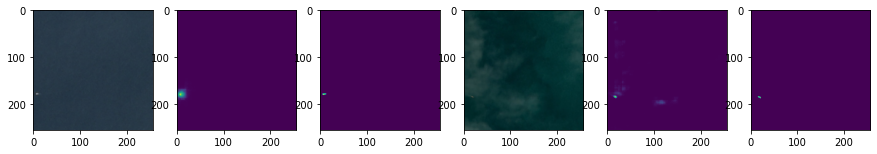

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0180 - dice_loss: 0.8140 - accuracy: 0.9939 - val_loss: 0.0095 - val_dice_loss: 0.6426 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.7927 - accuracy: 0.9944 - val_loss: 0.0095 - val_dice_loss: 0.6465 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.7712 - accuracy: 0.9949 - val_loss: 0.0095 - val_dice_loss: 0.6507 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.7742 - accuracy: 0.9960 - val_loss: 0.0095 - val_dice_loss: 0.6612 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.7521 - accuracy: 0.9958 - val_loss: 0.0098 - val_dice_loss: 0.6773 - val_accuracy: 0.9970


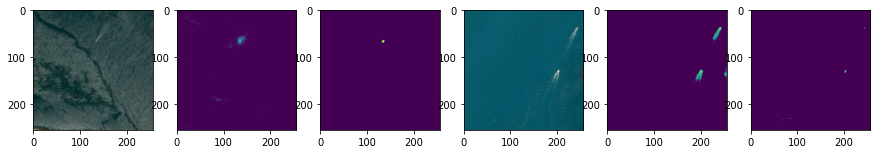

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.6739 - accuracy: 0.9975 - val_loss: 0.0123 - val_dice_loss: 0.6377 - val_accuracy: 0.9958
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.7080 - accuracy: 0.9968 - val_loss: 0.0123 - val_dice_loss: 0.6461 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6256 - accuracy: 0.9974 - val_loss: 0.0125 - val_dice_loss: 0.6543 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6513 - accuracy: 0.9974 - val_loss: 0.0127 - val_dice_loss: 0.6591 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6686 - accuracy: 0.9971 - val_loss: 0.0130 - val_dice_loss: 0.6606 - val_accuracy: 0.9958


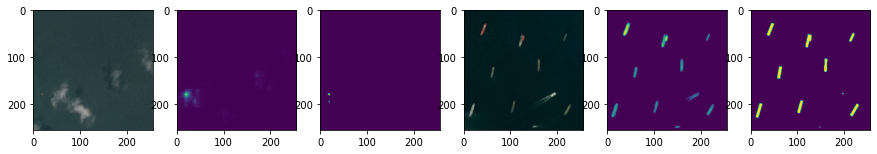

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0235 - dice_loss: 0.7214 - accuracy: 0.9936 - val_loss: 0.0105 - val_dice_loss: 0.7864 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0219 - dice_loss: 0.7152 - accuracy: 0.9937 - val_loss: 0.0102 - val_dice_loss: 0.7698 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.6532 - accuracy: 0.9939 - val_loss: 0.0101 - val_dice_loss: 0.7598 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.6595 - accuracy: 0.9941 - val_loss: 0.0101 - val_dice_loss: 0.7504 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.6443 - accuracy: 0.9943 - val_loss: 0.0103 - val_dice_loss: 0.7501 - val_accuracy: 0.9974


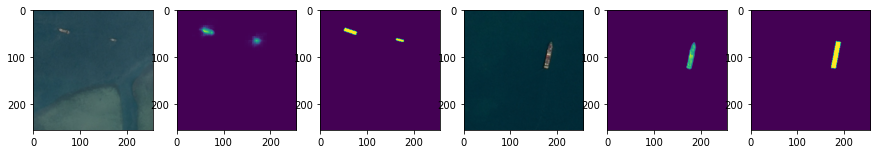

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.7713 - accuracy: 0.9980 - val_loss: 0.0179 - val_dice_loss: 0.6627 - val_accuracy: 0.9949
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.7785 - accuracy: 0.9979 - val_loss: 0.0196 - val_dice_loss: 0.7103 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.7788 - accuracy: 0.9984 - val_loss: 0.0217 - val_dice_loss: 0.7695 - val_accuracy: 0.9944
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.7795 - accuracy: 0.9983 - val_loss: 0.0235 - val_dice_loss: 0.8326 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.7439 - accuracy: 0.9985 - val_loss: 0.0252 - val_dice_loss: 0.8825 - val_accuracy: 0.9941


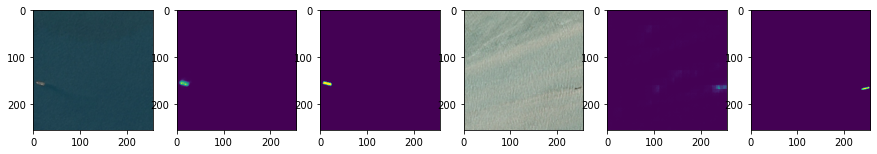

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.6519 - accuracy: 0.9959 - val_loss: 0.0152 - val_dice_loss: 0.7848 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.6299 - accuracy: 0.9958 - val_loss: 0.0111 - val_dice_loss: 0.6401 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5613 - accuracy: 0.9964 - val_loss: 0.0099 - val_dice_loss: 0.5608 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4915 - accuracy: 0.9967 - val_loss: 0.0100 - val_dice_loss: 0.5558 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5500 - accuracy: 0.9969 - val_loss: 0.0107 - val_dice_loss: 0.5693 - val_accuracy: 0.9965


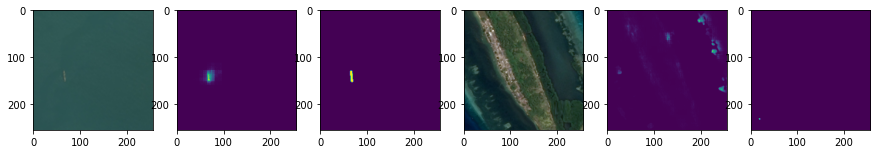

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.7363 - accuracy: 0.9951 - val_loss: 0.0086 - val_dice_loss: 0.5241 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.6872 - accuracy: 0.9954 - val_loss: 0.0086 - val_dice_loss: 0.5267 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.6740 - accuracy: 0.9957 - val_loss: 0.0085 - val_dice_loss: 0.5256 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.7261 - accuracy: 0.9947 - val_loss: 0.0085 - val_dice_loss: 0.5236 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.6929 - accuracy: 0.9950 - val_loss: 0.0085 - val_dice_loss: 0.5220 - val_accuracy: 0.9962


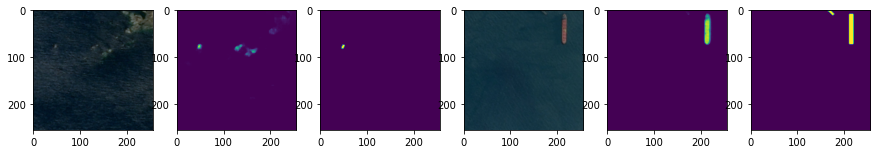

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.5214 - accuracy: 0.9955 - val_loss: 0.0114 - val_dice_loss: 0.6293 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.5094 - accuracy: 0.9950 - val_loss: 0.0113 - val_dice_loss: 0.6196 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5031 - accuracy: 0.9952 - val_loss: 0.0112 - val_dice_loss: 0.6096 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.4822 - accuracy: 0.9952 - val_loss: 0.0111 - val_dice_loss: 0.5989 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.4973 - accuracy: 0.9953 - val_loss: 0.0111 - val_dice_loss: 0.5897 - val_accuracy: 0.9966


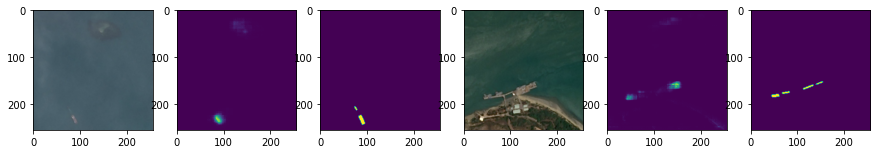

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0198 - dice_loss: 0.6057 - accuracy: 0.9948 - val_loss: 0.0121 - val_dice_loss: 0.7385 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0183 - dice_loss: 0.5957 - accuracy: 0.9947 - val_loss: 0.0120 - val_dice_loss: 0.7354 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.6377 - accuracy: 0.9953 - val_loss: 0.0118 - val_dice_loss: 0.7383 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.5686 - accuracy: 0.9957 - val_loss: 0.0118 - val_dice_loss: 0.7449 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5753 - accuracy: 0.9957 - val_loss: 0.0130 - val_dice_loss: 0.7458 - val_accuracy: 0.9949


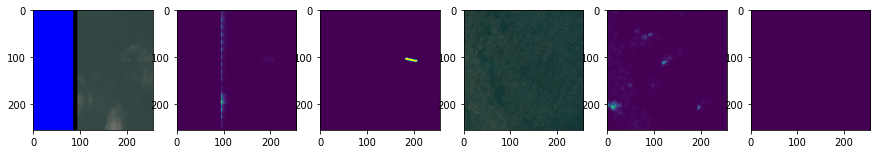

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5891 - accuracy: 0.9979 - val_loss: 0.0225 - val_dice_loss: 0.6291 - val_accuracy: 0.9911
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5729 - accuracy: 0.9978 - val_loss: 0.0233 - val_dice_loss: 0.6347 - val_accuracy: 0.9910
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.5369 - accuracy: 0.9981 - val_loss: 0.0236 - val_dice_loss: 0.6314 - val_accuracy: 0.9913
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.4932 - accuracy: 0.9984 - val_loss: 0.0237 - val_dice_loss: 0.6210 - val_accuracy: 0.9919
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.4889 - accuracy: 0.9983 - val_loss: 0.0239 - val_dice_loss: 0.6110 - val_accuracy: 0.9921


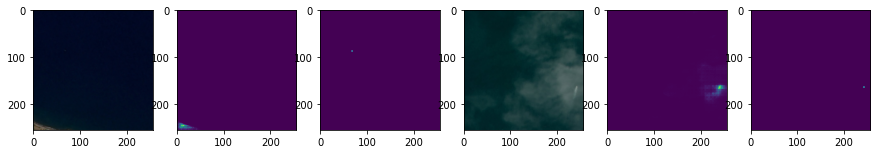

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.7643 - accuracy: 0.9953 - val_loss: 0.0138 - val_dice_loss: 0.5652 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.7550 - accuracy: 0.9955 - val_loss: 0.0140 - val_dice_loss: 0.5714 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.7593 - accuracy: 0.9954 - val_loss: 0.0141 - val_dice_loss: 0.5790 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0165 - dice_loss: 0.7444 - accuracy: 0.9954 - val_loss: 0.0140 - val_dice_loss: 0.5845 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.7341 - accuracy: 0.9954 - val_loss: 0.0138 - val_dice_loss: 0.5920 - val_accuracy: 0.9956


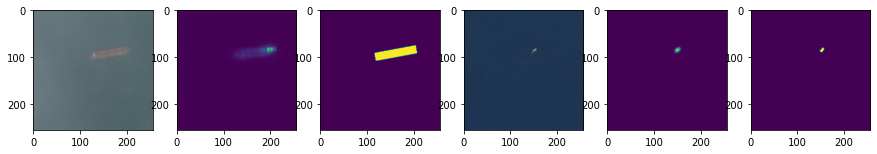

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0232 - dice_loss: 0.9181 - accuracy: 0.9958 - val_loss: 0.0154 - val_dice_loss: 0.7418 - val_accuracy: 0.9945
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0197 - dice_loss: 0.9053 - accuracy: 0.9957 - val_loss: 0.0146 - val_dice_loss: 0.7412 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0227 - dice_loss: 0.9027 - accuracy: 0.9958 - val_loss: 0.0135 - val_dice_loss: 0.7297 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0186 - dice_loss: 0.8692 - accuracy: 0.9958 - val_loss: 0.0124 - val_dice_loss: 0.7181 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.8318 - accuracy: 0.9956 - val_loss: 0.0114 - val_dice_loss: 0.7035 - val_accuracy: 0.9961


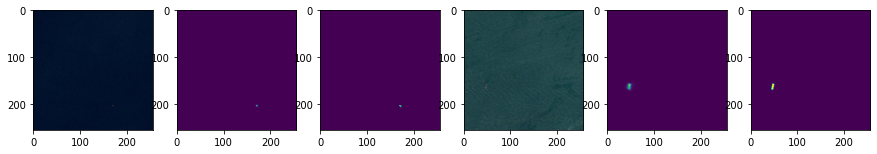

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.8680 - accuracy: 0.9962 - val_loss: 0.0162 - val_dice_loss: 0.7162 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.8824 - accuracy: 0.9970 - val_loss: 0.0176 - val_dice_loss: 0.7562 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.8655 - accuracy: 0.9983 - val_loss: 0.0196 - val_dice_loss: 0.8183 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.8430 - accuracy: 0.9987 - val_loss: 0.0222 - val_dice_loss: 0.8854 - val_accuracy: 0.9945
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0053 - dice_loss: 0.8696 - accuracy: 0.9989 - val_loss: 0.0244 - val_dice_loss: 0.9288 - val_accuracy: 0.9945


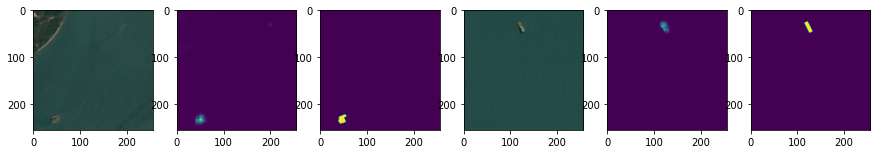

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.7458 - accuracy: 0.9950 - val_loss: 0.0171 - val_dice_loss: 0.9306 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0147 - dice_loss: 0.7468 - accuracy: 0.9949 - val_loss: 0.0149 - val_dice_loss: 0.8620 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6624 - accuracy: 0.9953 - val_loss: 0.0123 - val_dice_loss: 0.7213 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5969 - accuracy: 0.9958 - val_loss: 0.0107 - val_dice_loss: 0.6037 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5060 - accuracy: 0.9964 - val_loss: 0.0103 - val_dice_loss: 0.5624 - val_accuracy: 0.9974


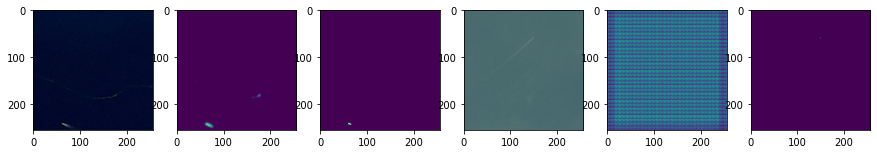

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0199 - dice_loss: 0.6249 - accuracy: 0.9922 - val_loss: 0.0069 - val_dice_loss: 0.7005 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0194 - dice_loss: 0.6010 - accuracy: 0.9926 - val_loss: 0.0079 - val_dice_loss: 0.7251 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0166 - dice_loss: 0.5417 - accuracy: 0.9936 - val_loss: 0.0089 - val_dice_loss: 0.7436 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0158 - dice_loss: 0.5444 - accuracy: 0.9939 - val_loss: 0.0096 - val_dice_loss: 0.7510 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.5345 - accuracy: 0.9934 - val_loss: 0.0097 - val_dice_loss: 0.7479 - val_accuracy: 0.9961


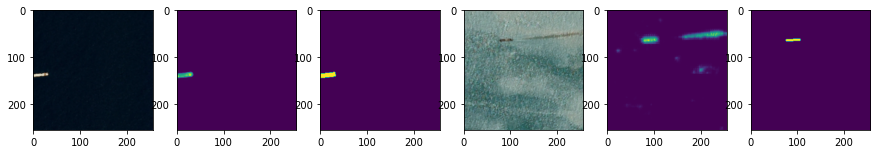

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.7236 - accuracy: 0.9956 - val_loss: 0.0080 - val_dice_loss: 0.5977 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6851 - accuracy: 0.9968 - val_loss: 0.0077 - val_dice_loss: 0.5922 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6500 - accuracy: 0.9971 - val_loss: 0.0074 - val_dice_loss: 0.5907 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.6324 - accuracy: 0.9979 - val_loss: 0.0077 - val_dice_loss: 0.5993 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5861 - accuracy: 0.9978 - val_loss: 0.0086 - val_dice_loss: 0.6260 - val_accuracy: 0.9968


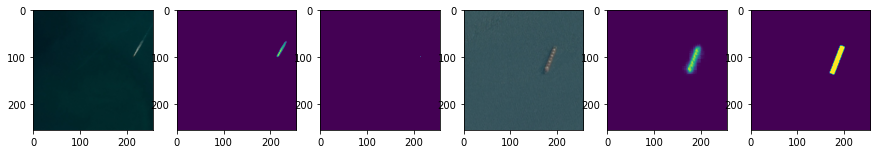

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6324 - accuracy: 0.9968 - val_loss: 0.0172 - val_dice_loss: 0.7346 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6890 - accuracy: 0.9967 - val_loss: 0.0165 - val_dice_loss: 0.7341 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6862 - accuracy: 0.9967 - val_loss: 0.0154 - val_dice_loss: 0.7295 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6635 - accuracy: 0.9966 - val_loss: 0.0150 - val_dice_loss: 0.7255 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6528 - accuracy: 0.9966 - val_loss: 0.0157 - val_dice_loss: 0.7294 - val_accuracy: 0.9959


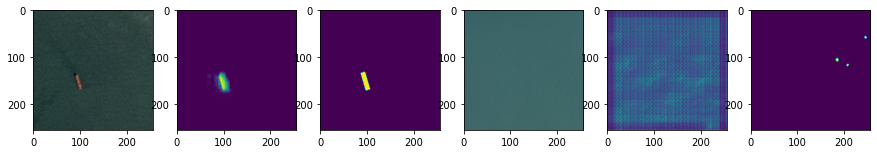

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.7372 - accuracy: 0.9954 - val_loss: 0.0191 - val_dice_loss: 0.7397 - val_accuracy: 0.9932
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0180 - dice_loss: 0.7448 - accuracy: 0.9952 - val_loss: 0.0197 - val_dice_loss: 0.7526 - val_accuracy: 0.9923
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.7308 - accuracy: 0.9950 - val_loss: 0.0212 - val_dice_loss: 0.7665 - val_accuracy: 0.9914
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0167 - dice_loss: 0.7294 - accuracy: 0.9954 - val_loss: 0.0232 - val_dice_loss: 0.7800 - val_accuracy: 0.9904
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.6884 - accuracy: 0.9954 - val_loss: 0.0247 - val_dice_loss: 0.7893 - val_accuracy: 0.9899


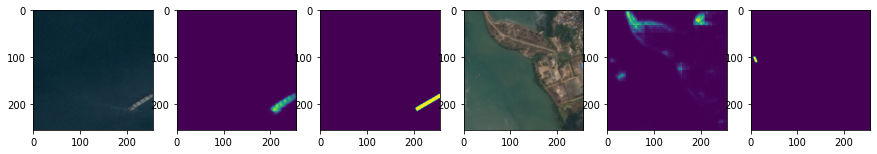

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6810 - accuracy: 0.9976 - val_loss: 0.0182 - val_dice_loss: 0.8874 - val_accuracy: 0.9939
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6507 - accuracy: 0.9974 - val_loss: 0.0165 - val_dice_loss: 0.8792 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.6470 - accuracy: 0.9978 - val_loss: 0.0146 - val_dice_loss: 0.8683 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.6309 - accuracy: 0.9979 - val_loss: 0.0125 - val_dice_loss: 0.8552 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5890 - accuracy: 0.9980 - val_loss: 0.0107 - val_dice_loss: 0.8414 - val_accuracy: 0.9972


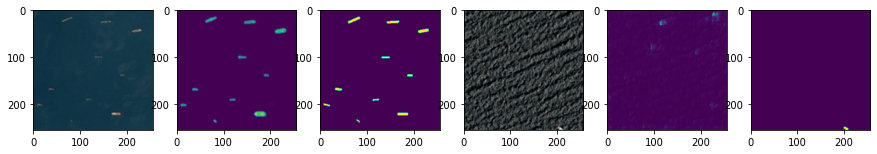

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.7541 - accuracy: 0.9954 - val_loss: 0.0259 - val_dice_loss: 0.6764 - val_accuracy: 0.9918
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.7365 - accuracy: 0.9955 - val_loss: 0.0260 - val_dice_loss: 0.6762 - val_accuracy: 0.9918
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.7015 - accuracy: 0.9955 - val_loss: 0.0258 - val_dice_loss: 0.6709 - val_accuracy: 0.9918
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6832 - accuracy: 0.9956 - val_loss: 0.0256 - val_dice_loss: 0.6633 - val_accuracy: 0.9918
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.6718 - accuracy: 0.9955 - val_loss: 0.0258 - val_dice_loss: 0.6552 - val_accuracy: 0.9917


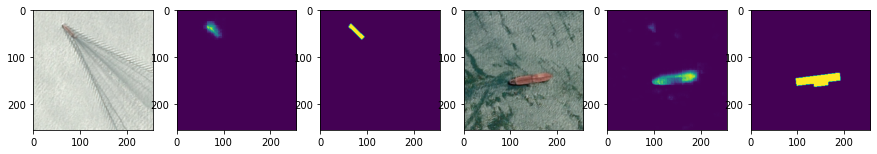

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6048 - accuracy: 0.9965 - val_loss: 0.0154 - val_dice_loss: 0.7571 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5822 - accuracy: 0.9970 - val_loss: 0.0167 - val_dice_loss: 0.7724 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5936 - accuracy: 0.9968 - val_loss: 0.0184 - val_dice_loss: 0.7930 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5556 - accuracy: 0.9969 - val_loss: 0.0200 - val_dice_loss: 0.8124 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6394 - accuracy: 0.9969 - val_loss: 0.0209 - val_dice_loss: 0.8244 - val_accuracy: 0.9940


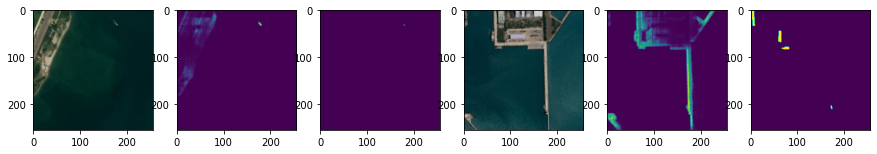

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0196 - dice_loss: 0.7360 - accuracy: 0.9942 - val_loss: 0.0105 - val_dice_loss: 0.6425 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.7292 - accuracy: 0.9943 - val_loss: 0.0102 - val_dice_loss: 0.6342 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.7155 - accuracy: 0.9941 - val_loss: 0.0099 - val_dice_loss: 0.6265 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.7127 - accuracy: 0.9942 - val_loss: 0.0096 - val_dice_loss: 0.6205 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0169 - dice_loss: 0.6634 - accuracy: 0.9945 - val_loss: 0.0095 - val_dice_loss: 0.6136 - val_accuracy: 0.9966


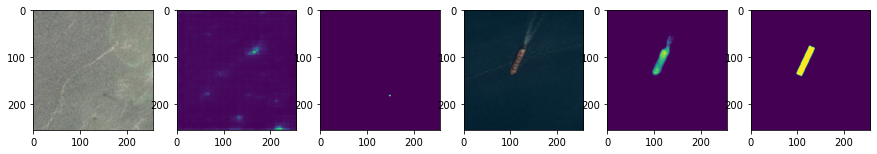

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.5909 - accuracy: 0.9961 - val_loss: 0.0053 - val_dice_loss: 0.6713 - val_accuracy: 0.9985
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5974 - accuracy: 0.9959 - val_loss: 0.0051 - val_dice_loss: 0.6588 - val_accuracy: 0.9985
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5382 - accuracy: 0.9962 - val_loss: 0.0050 - val_dice_loss: 0.6498 - val_accuracy: 0.9986
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5692 - accuracy: 0.9963 - val_loss: 0.0049 - val_dice_loss: 0.6435 - val_accuracy: 0.9986
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5005 - accuracy: 0.9967 - val_loss: 0.0049 - val_dice_loss: 0.6417 - val_accuracy: 0.9986


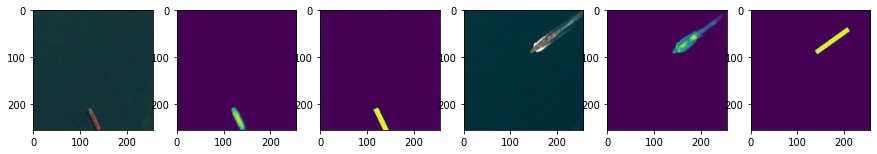

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.5633 - accuracy: 0.9955 - val_loss: 0.0218 - val_dice_loss: 0.7773 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.5336 - accuracy: 0.9956 - val_loss: 0.0222 - val_dice_loss: 0.7854 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.5516 - accuracy: 0.9956 - val_loss: 0.0224 - val_dice_loss: 0.7936 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5489 - accuracy: 0.9957 - val_loss: 0.0227 - val_dice_loss: 0.8025 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5355 - accuracy: 0.9957 - val_loss: 0.0230 - val_dice_loss: 0.8093 - val_accuracy: 0.9941


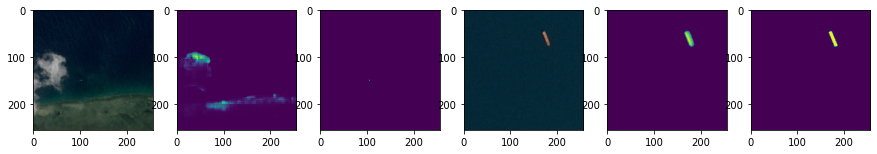

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.7400 - accuracy: 0.9976 - val_loss: 0.0092 - val_dice_loss: 0.6055 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.7390 - accuracy: 0.9972 - val_loss: 0.0091 - val_dice_loss: 0.6043 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.7120 - accuracy: 0.9975 - val_loss: 0.0088 - val_dice_loss: 0.6006 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.7096 - accuracy: 0.9978 - val_loss: 0.0087 - val_dice_loss: 0.6056 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6873 - accuracy: 0.9978 - val_loss: 0.0090 - val_dice_loss: 0.6235 - val_accuracy: 0.9969


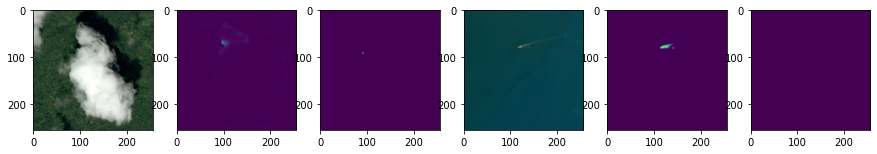

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.7445 - accuracy: 0.9981 - val_loss: 0.0082 - val_dice_loss: 0.6813 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.7834 - accuracy: 0.9981 - val_loss: 0.0083 - val_dice_loss: 0.7143 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.7638 - accuracy: 0.9984 - val_loss: 0.0086 - val_dice_loss: 0.7569 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.7302 - accuracy: 0.9984 - val_loss: 0.0091 - val_dice_loss: 0.7957 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.7623 - accuracy: 0.9983 - val_loss: 0.0094 - val_dice_loss: 0.8212 - val_accuracy: 0.9969


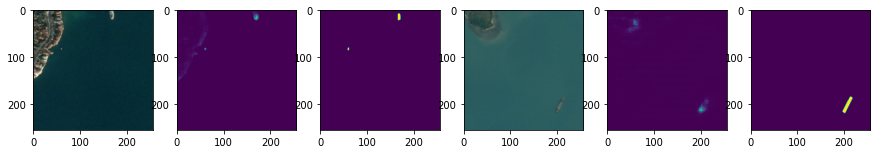

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.7071 - accuracy: 0.9942 - val_loss: 0.0125 - val_dice_loss: 0.7479 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0167 - dice_loss: 0.6631 - accuracy: 0.9946 - val_loss: 0.0112 - val_dice_loss: 0.6836 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.6360 - accuracy: 0.9950 - val_loss: 0.0100 - val_dice_loss: 0.6179 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5532 - accuracy: 0.9958 - val_loss: 0.0094 - val_dice_loss: 0.5768 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5331 - accuracy: 0.9958 - val_loss: 0.0097 - val_dice_loss: 0.5745 - val_accuracy: 0.9972


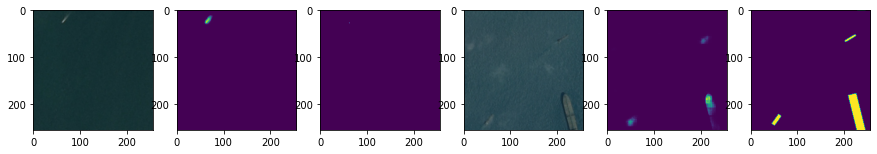

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.6384 - accuracy: 0.9950 - val_loss: 0.0163 - val_dice_loss: 0.6986 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.6501 - accuracy: 0.9950 - val_loss: 0.0163 - val_dice_loss: 0.6867 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.6221 - accuracy: 0.9945 - val_loss: 0.0160 - val_dice_loss: 0.6734 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.6070 - accuracy: 0.9951 - val_loss: 0.0156 - val_dice_loss: 0.6566 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.6293 - accuracy: 0.9950 - val_loss: 0.0152 - val_dice_loss: 0.6425 - val_accuracy: 0.9960


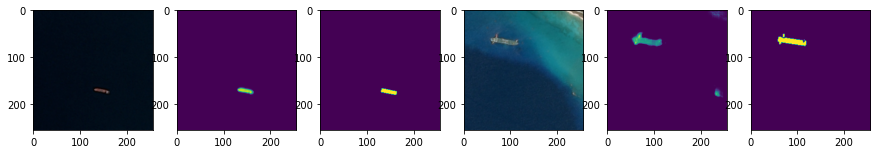

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5844 - accuracy: 0.9947 - val_loss: 0.0116 - val_dice_loss: 0.5756 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.5789 - accuracy: 0.9948 - val_loss: 0.0112 - val_dice_loss: 0.5623 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5717 - accuracy: 0.9951 - val_loss: 0.0113 - val_dice_loss: 0.5601 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.5511 - accuracy: 0.9957 - val_loss: 0.0120 - val_dice_loss: 0.5633 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.6141 - accuracy: 0.9952 - val_loss: 0.0124 - val_dice_loss: 0.5694 - val_accuracy: 0.9958


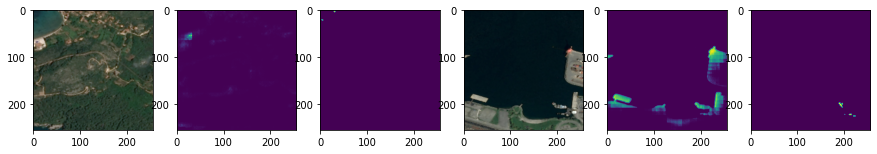

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.8299 - accuracy: 0.9954 - val_loss: 0.0123 - val_dice_loss: 0.5457 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.7940 - accuracy: 0.9958 - val_loss: 0.0121 - val_dice_loss: 0.5425 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.8137 - accuracy: 0.9954 - val_loss: 0.0119 - val_dice_loss: 0.5428 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.7682 - accuracy: 0.9968 - val_loss: 0.0124 - val_dice_loss: 0.5518 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.7385 - accuracy: 0.9970 - val_loss: 0.0129 - val_dice_loss: 0.5623 - val_accuracy: 0.9961


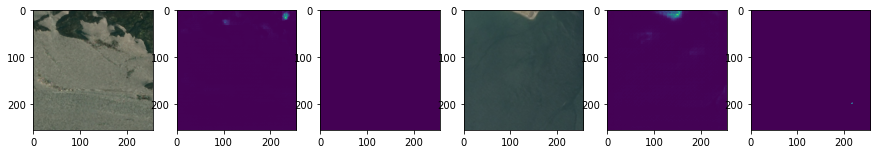

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.6058 - accuracy: 0.9966 - val_loss: 0.0199 - val_dice_loss: 0.7428 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.6347 - accuracy: 0.9966 - val_loss: 0.0196 - val_dice_loss: 0.7485 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.6291 - accuracy: 0.9969 - val_loss: 0.0188 - val_dice_loss: 0.7396 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.6197 - accuracy: 0.9970 - val_loss: 0.0165 - val_dice_loss: 0.7057 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.6547 - accuracy: 0.9965 - val_loss: 0.0145 - val_dice_loss: 0.6663 - val_accuracy: 0.9952


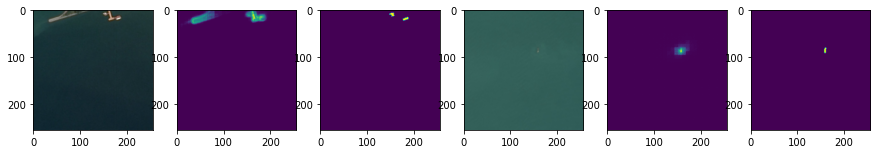

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0077 - dice_loss: 0.5628 - accuracy: 0.9970 - val_loss: 0.0196 - val_dice_loss: 0.8106 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0087 - dice_loss: 0.5726 - accuracy: 0.9967 - val_loss: 0.0192 - val_dice_loss: 0.8026 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0081 - dice_loss: 0.5350 - accuracy: 0.9969 - val_loss: 0.0190 - val_dice_loss: 0.7918 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0084 - dice_loss: 0.5568 - accuracy: 0.9968 - val_loss: 0.0189 - val_dice_loss: 0.7815 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5850 - accuracy: 0.9969 - val_loss: 0.0189 - val_dice_loss: 0.7736 - val_accuracy: 0.9952


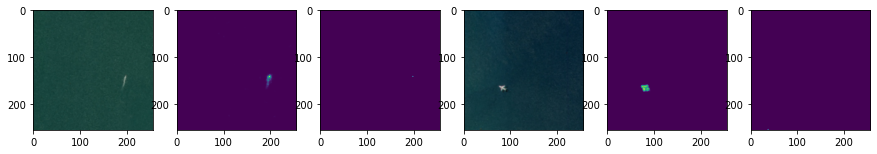

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.7112 - accuracy: 0.9975 - val_loss: 0.0070 - val_dice_loss: 0.6124 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.7189 - accuracy: 0.9975 - val_loss: 0.0070 - val_dice_loss: 0.6122 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.7105 - accuracy: 0.9971 - val_loss: 0.0070 - val_dice_loss: 0.6124 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.6888 - accuracy: 0.9975 - val_loss: 0.0071 - val_dice_loss: 0.6133 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6932 - accuracy: 0.9975 - val_loss: 0.0071 - val_dice_loss: 0.6143 - val_accuracy: 0.9978


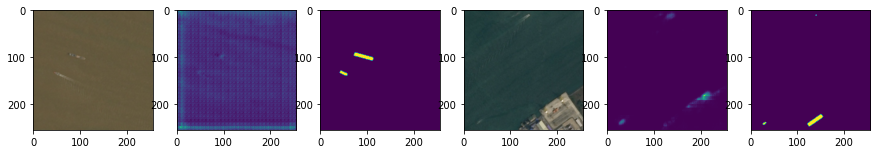

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.5447 - accuracy: 0.9981 - val_loss: 0.0189 - val_dice_loss: 0.7871 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.5708 - accuracy: 0.9977 - val_loss: 0.0191 - val_dice_loss: 0.7929 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5660 - accuracy: 0.9977 - val_loss: 0.0192 - val_dice_loss: 0.8001 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.5459 - accuracy: 0.9980 - val_loss: 0.0194 - val_dice_loss: 0.8077 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.5503 - accuracy: 0.9978 - val_loss: 0.0196 - val_dice_loss: 0.8165 - val_accuracy: 0.9957


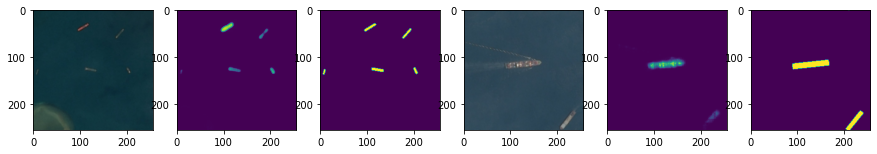

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.6373 - accuracy: 0.9969 - val_loss: 0.0134 - val_dice_loss: 0.6108 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6529 - accuracy: 0.9966 - val_loss: 0.0135 - val_dice_loss: 0.6089 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.6407 - accuracy: 0.9967 - val_loss: 0.0136 - val_dice_loss: 0.6063 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.6538 - accuracy: 0.9964 - val_loss: 0.0135 - val_dice_loss: 0.6031 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0093 - dice_loss: 0.6025 - accuracy: 0.9970 - val_loss: 0.0134 - val_dice_loss: 0.5991 - val_accuracy: 0.9960


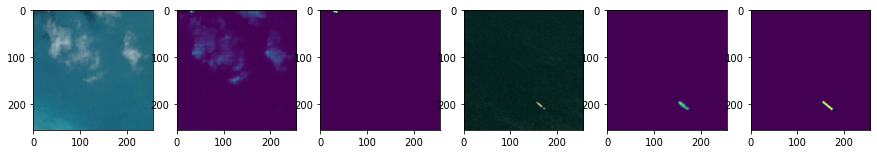

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0061 - dice_loss: 0.5759 - accuracy: 0.9978 - val_loss: 0.0206 - val_dice_loss: 0.6955 - val_accuracy: 0.9937
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5740 - accuracy: 0.9978 - val_loss: 0.0202 - val_dice_loss: 0.6862 - val_accuracy: 0.9937
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.6066 - accuracy: 0.9978 - val_loss: 0.0198 - val_dice_loss: 0.6752 - val_accuracy: 0.9937
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0059 - dice_loss: 0.5518 - accuracy: 0.9979 - val_loss: 0.0194 - val_dice_loss: 0.6655 - val_accuracy: 0.9937
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.5586 - accuracy: 0.9978 - val_loss: 0.0191 - val_dice_loss: 0.6598 - val_accuracy: 0.9937


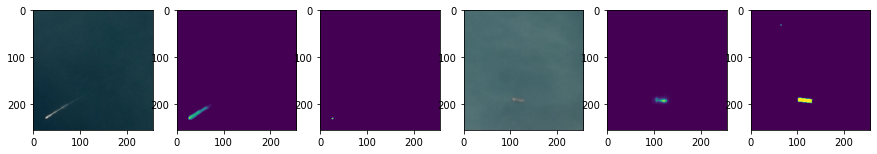

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.8058 - accuracy: 0.9978 - val_loss: 0.0176 - val_dice_loss: 0.7165 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.8002 - accuracy: 0.9979 - val_loss: 0.0179 - val_dice_loss: 0.7245 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.8050 - accuracy: 0.9979 - val_loss: 0.0183 - val_dice_loss: 0.7382 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.7615 - accuracy: 0.9982 - val_loss: 0.0188 - val_dice_loss: 0.7535 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.7472 - accuracy: 0.9982 - val_loss: 0.0192 - val_dice_loss: 0.7696 - val_accuracy: 0.9958


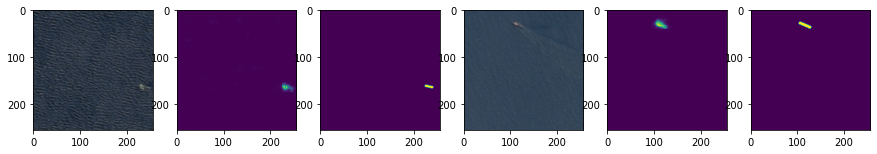

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5366 - accuracy: 0.9957 - val_loss: 0.0128 - val_dice_loss: 0.6457 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5446 - accuracy: 0.9957 - val_loss: 0.0126 - val_dice_loss: 0.6341 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.5541 - accuracy: 0.9957 - val_loss: 0.0124 - val_dice_loss: 0.6245 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5134 - accuracy: 0.9958 - val_loss: 0.0124 - val_dice_loss: 0.6184 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.4795 - accuracy: 0.9961 - val_loss: 0.0125 - val_dice_loss: 0.6171 - val_accuracy: 0.9958


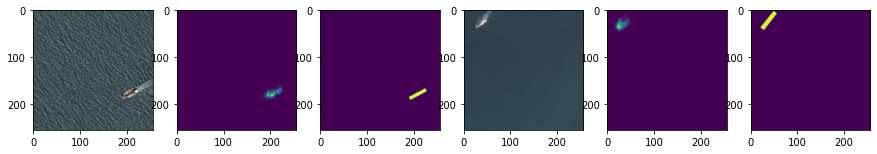

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.5428 - accuracy: 0.9955 - val_loss: 0.0128 - val_dice_loss: 0.6164 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.4830 - accuracy: 0.9958 - val_loss: 0.0130 - val_dice_loss: 0.6151 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.4735 - accuracy: 0.9960 - val_loss: 0.0133 - val_dice_loss: 0.6154 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.4600 - accuracy: 0.9958 - val_loss: 0.0135 - val_dice_loss: 0.6154 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4473 - accuracy: 0.9959 - val_loss: 0.0135 - val_dice_loss: 0.6096 - val_accuracy: 0.9955


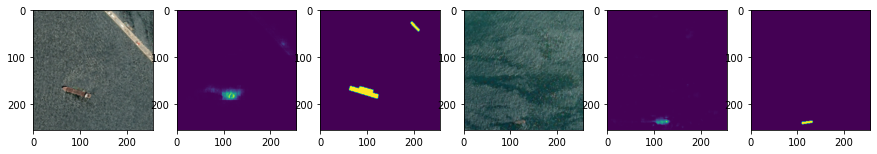

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0169 - dice_loss: 0.5651 - accuracy: 0.9945 - val_loss: 0.0157 - val_dice_loss: 0.7359 - val_accuracy: 0.9931
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0160 - dice_loss: 0.5519 - accuracy: 0.9945 - val_loss: 0.0175 - val_dice_loss: 0.7424 - val_accuracy: 0.9921
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.5173 - accuracy: 0.9949 - val_loss: 0.0187 - val_dice_loss: 0.7458 - val_accuracy: 0.9910
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.4778 - accuracy: 0.9950 - val_loss: 0.0190 - val_dice_loss: 0.7474 - val_accuracy: 0.9908
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4762 - accuracy: 0.9953 - val_loss: 0.0186 - val_dice_loss: 0.7471 - val_accuracy: 0.9910


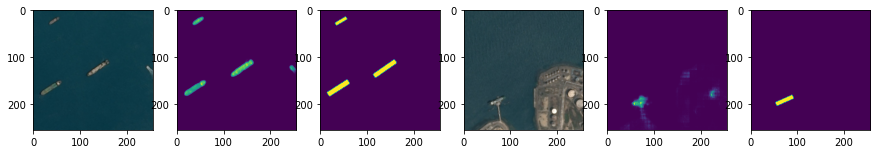

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0235 - dice_loss: 0.7863 - accuracy: 0.9902 - val_loss: 0.0165 - val_dice_loss: 0.7176 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0216 - dice_loss: 0.7888 - accuracy: 0.9918 - val_loss: 0.0157 - val_dice_loss: 0.6902 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0176 - dice_loss: 0.7237 - accuracy: 0.9940 - val_loss: 0.0157 - val_dice_loss: 0.6805 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.6910 - accuracy: 0.9960 - val_loss: 0.0158 - val_dice_loss: 0.6790 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0120 - dice_loss: 0.6538 - accuracy: 0.9963 - val_loss: 0.0161 - val_dice_loss: 0.6836 - val_accuracy: 0.9961


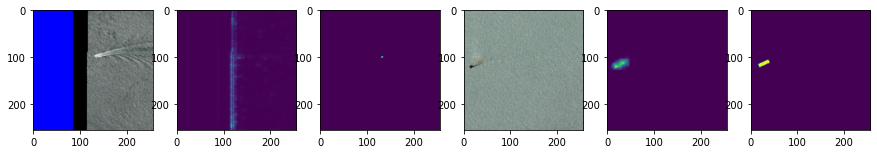

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0146 - dice_loss: 0.5499 - accuracy: 0.9954 - val_loss: 0.0097 - val_dice_loss: 0.5795 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.5323 - accuracy: 0.9959 - val_loss: 0.0095 - val_dice_loss: 0.5754 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.4208 - accuracy: 0.9965 - val_loss: 0.0095 - val_dice_loss: 0.5856 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.4257 - accuracy: 0.9963 - val_loss: 0.0101 - val_dice_loss: 0.6255 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0122 - dice_loss: 0.4162 - accuracy: 0.9968 - val_loss: 0.0115 - val_dice_loss: 0.6707 - val_accuracy: 0.9975


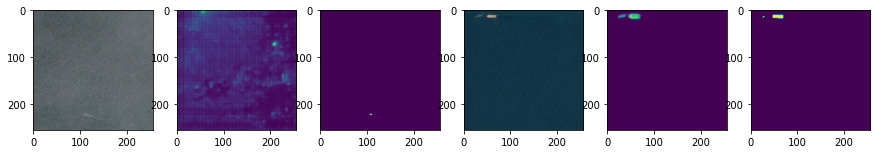

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0138 - dice_loss: 0.6594 - accuracy: 0.9965 - val_loss: 0.0058 - val_dice_loss: 0.5738 - val_accuracy: 0.9979
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.6695 - accuracy: 0.9966 - val_loss: 0.0059 - val_dice_loss: 0.5760 - val_accuracy: 0.9980
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.6873 - accuracy: 0.9959 - val_loss: 0.0059 - val_dice_loss: 0.5753 - val_accuracy: 0.9981
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.7229 - accuracy: 0.9960 - val_loss: 0.0059 - val_dice_loss: 0.5716 - val_accuracy: 0.9981
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.7621 - accuracy: 0.9951 - val_loss: 0.0058 - val_dice_loss: 0.5684 - val_accuracy: 0.9982


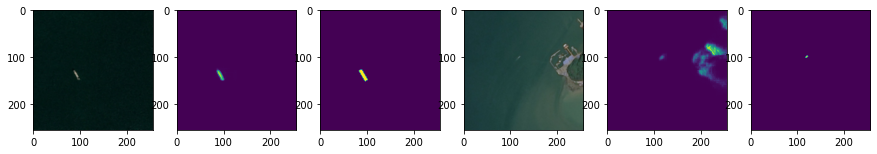

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5859 - accuracy: 0.9967 - val_loss: 0.0210 - val_dice_loss: 0.7828 - val_accuracy: 0.9920
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6445 - accuracy: 0.9965 - val_loss: 0.0190 - val_dice_loss: 0.7714 - val_accuracy: 0.9925
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.6034 - accuracy: 0.9967 - val_loss: 0.0171 - val_dice_loss: 0.7588 - val_accuracy: 0.9930
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5850 - accuracy: 0.9971 - val_loss: 0.0155 - val_dice_loss: 0.7453 - val_accuracy: 0.9935
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5356 - accuracy: 0.9972 - val_loss: 0.0145 - val_dice_loss: 0.7370 - val_accuracy: 0.9941


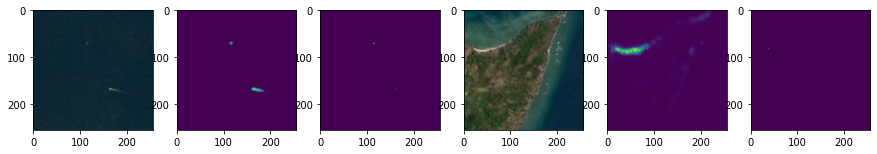

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.7674 - accuracy: 0.9943 - val_loss: 0.0123 - val_dice_loss: 0.6008 - val_accuracy: 0.9949
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0167 - dice_loss: 0.6306 - accuracy: 0.9949 - val_loss: 0.0118 - val_dice_loss: 0.5938 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.6587 - accuracy: 0.9949 - val_loss: 0.0117 - val_dice_loss: 0.5862 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5702 - accuracy: 0.9956 - val_loss: 0.0117 - val_dice_loss: 0.5836 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5716 - accuracy: 0.9955 - val_loss: 0.0119 - val_dice_loss: 0.5824 - val_accuracy: 0.9948


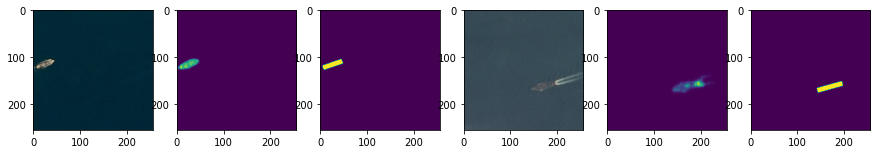

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.6891 - accuracy: 0.9955 - val_loss: 0.0099 - val_dice_loss: 0.5783 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0161 - dice_loss: 0.6601 - accuracy: 0.9956 - val_loss: 0.0098 - val_dice_loss: 0.5743 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.7138 - accuracy: 0.9956 - val_loss: 0.0098 - val_dice_loss: 0.5681 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.5826 - accuracy: 0.9961 - val_loss: 0.0098 - val_dice_loss: 0.5573 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.5599 - accuracy: 0.9963 - val_loss: 0.0098 - val_dice_loss: 0.5483 - val_accuracy: 0.9961


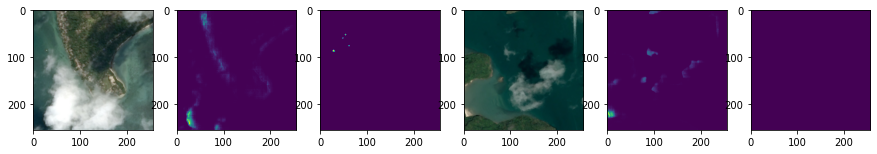

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5899 - accuracy: 0.9975 - val_loss: 0.0150 - val_dice_loss: 0.5680 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6668 - accuracy: 0.9975 - val_loss: 0.0150 - val_dice_loss: 0.5666 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6034 - accuracy: 0.9976 - val_loss: 0.0150 - val_dice_loss: 0.5700 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5713 - accuracy: 0.9975 - val_loss: 0.0153 - val_dice_loss: 0.5767 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.5532 - accuracy: 0.9975 - val_loss: 0.0155 - val_dice_loss: 0.5829 - val_accuracy: 0.9951


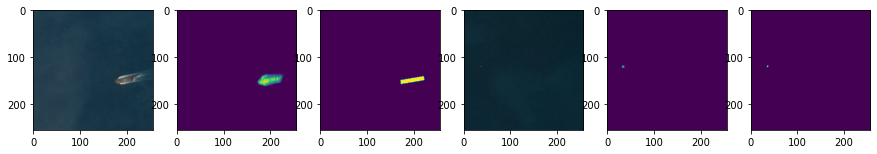

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6663 - accuracy: 0.9970 - val_loss: 0.0090 - val_dice_loss: 0.5872 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6593 - accuracy: 0.9971 - val_loss: 0.0088 - val_dice_loss: 0.5820 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.6600 - accuracy: 0.9973 - val_loss: 0.0089 - val_dice_loss: 0.5799 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.7069 - accuracy: 0.9967 - val_loss: 0.0092 - val_dice_loss: 0.5871 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.6154 - accuracy: 0.9978 - val_loss: 0.0096 - val_dice_loss: 0.5999 - val_accuracy: 0.9972


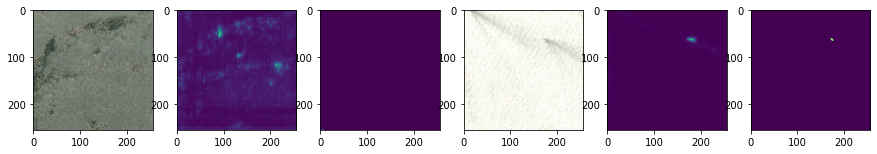

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4601 - accuracy: 0.9979 - val_loss: 0.0108 - val_dice_loss: 0.6060 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.7019 - accuracy: 0.9971 - val_loss: 0.0109 - val_dice_loss: 0.6044 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.4439 - accuracy: 0.9978 - val_loss: 0.0109 - val_dice_loss: 0.5955 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5343 - accuracy: 0.9979 - val_loss: 0.0109 - val_dice_loss: 0.5871 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0052 - dice_loss: 0.5070 - accuracy: 0.9982 - val_loss: 0.0108 - val_dice_loss: 0.5772 - val_accuracy: 0.9971


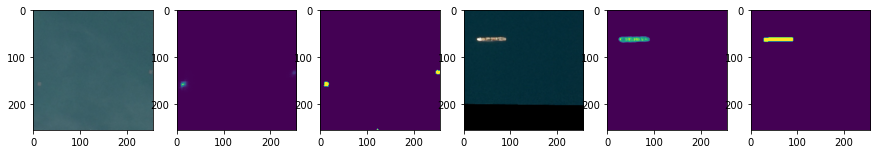

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.6899 - accuracy: 0.9963 - val_loss: 0.0136 - val_dice_loss: 0.5867 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6122 - accuracy: 0.9968 - val_loss: 0.0131 - val_dice_loss: 0.5761 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6669 - accuracy: 0.9965 - val_loss: 0.0126 - val_dice_loss: 0.5653 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5540 - accuracy: 0.9972 - val_loss: 0.0123 - val_dice_loss: 0.5539 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5655 - accuracy: 0.9972 - val_loss: 0.0122 - val_dice_loss: 0.5468 - val_accuracy: 0.9957


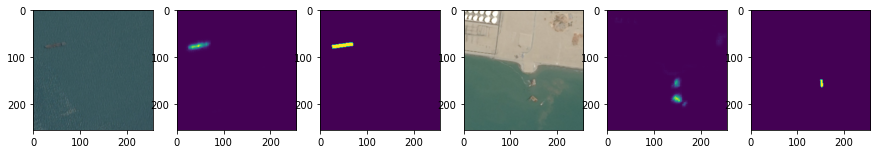

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.6450 - accuracy: 0.9971 - val_loss: 0.0233 - val_dice_loss: 0.7434 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6214 - accuracy: 0.9972 - val_loss: 0.0231 - val_dice_loss: 0.7412 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6401 - accuracy: 0.9972 - val_loss: 0.0229 - val_dice_loss: 0.7391 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.6281 - accuracy: 0.9974 - val_loss: 0.0229 - val_dice_loss: 0.7379 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6273 - accuracy: 0.9972 - val_loss: 0.0228 - val_dice_loss: 0.7376 - val_accuracy: 0.9953


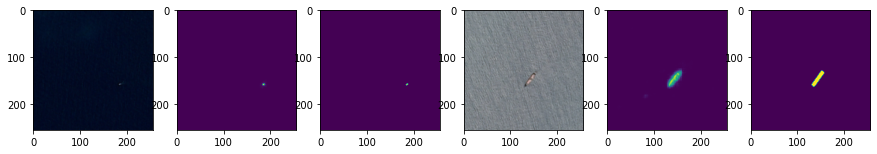

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0148 - dice_loss: 0.6123 - accuracy: 0.9951 - val_loss: 0.0106 - val_dice_loss: 0.7747 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0140 - dice_loss: 0.5610 - accuracy: 0.9952 - val_loss: 0.0106 - val_dice_loss: 0.7745 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.5664 - accuracy: 0.9952 - val_loss: 0.0107 - val_dice_loss: 0.7745 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.5494 - accuracy: 0.9955 - val_loss: 0.0106 - val_dice_loss: 0.7730 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5227 - accuracy: 0.9958 - val_loss: 0.0106 - val_dice_loss: 0.7711 - val_accuracy: 0.9967


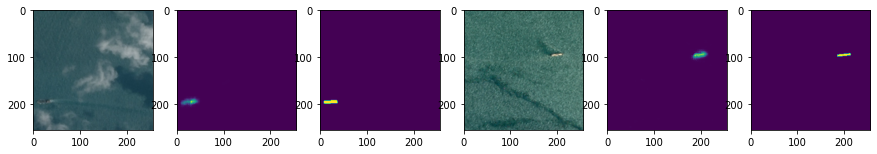

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5758 - accuracy: 0.9964 - val_loss: 0.0078 - val_dice_loss: 0.7531 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5516 - accuracy: 0.9965 - val_loss: 0.0077 - val_dice_loss: 0.7497 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5234 - accuracy: 0.9964 - val_loss: 0.0076 - val_dice_loss: 0.7449 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5193 - accuracy: 0.9969 - val_loss: 0.0074 - val_dice_loss: 0.7395 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5334 - accuracy: 0.9969 - val_loss: 0.0072 - val_dice_loss: 0.7340 - val_accuracy: 0.9972


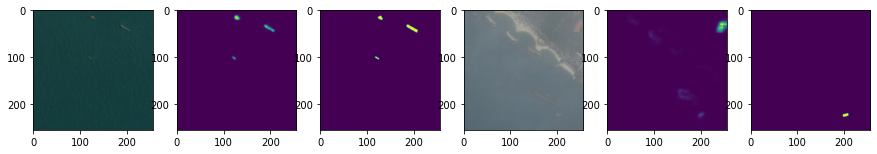

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.5978 - accuracy: 0.9944 - val_loss: 0.0159 - val_dice_loss: 0.6049 - val_accuracy: 0.9934
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.5789 - accuracy: 0.9948 - val_loss: 0.0158 - val_dice_loss: 0.6037 - val_accuracy: 0.9934
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.5831 - accuracy: 0.9948 - val_loss: 0.0158 - val_dice_loss: 0.6046 - val_accuracy: 0.9934
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5628 - accuracy: 0.9949 - val_loss: 0.0160 - val_dice_loss: 0.6057 - val_accuracy: 0.9933
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5474 - accuracy: 0.9948 - val_loss: 0.0162 - val_dice_loss: 0.6058 - val_accuracy: 0.9931


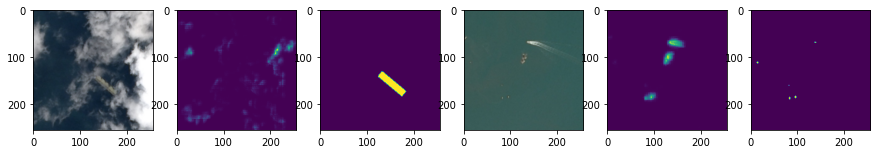

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6222 - accuracy: 0.9972 - val_loss: 0.0146 - val_dice_loss: 0.7047 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6071 - accuracy: 0.9969 - val_loss: 0.0144 - val_dice_loss: 0.7056 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.5849 - accuracy: 0.9973 - val_loss: 0.0141 - val_dice_loss: 0.7057 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5923 - accuracy: 0.9972 - val_loss: 0.0138 - val_dice_loss: 0.7078 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.5549 - accuracy: 0.9976 - val_loss: 0.0136 - val_dice_loss: 0.7103 - val_accuracy: 0.9955


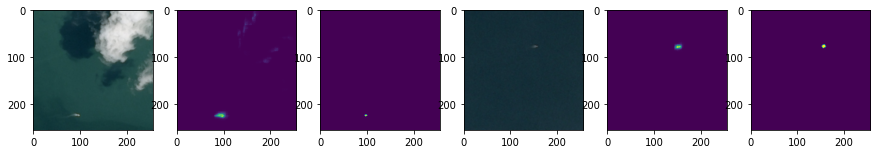

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.5455 - accuracy: 0.9951 - val_loss: 0.0102 - val_dice_loss: 0.6331 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5137 - accuracy: 0.9954 - val_loss: 0.0091 - val_dice_loss: 0.6189 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.4370 - accuracy: 0.9965 - val_loss: 0.0084 - val_dice_loss: 0.6042 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.4664 - accuracy: 0.9966 - val_loss: 0.0083 - val_dice_loss: 0.5970 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.4454 - accuracy: 0.9968 - val_loss: 0.0087 - val_dice_loss: 0.5967 - val_accuracy: 0.9970


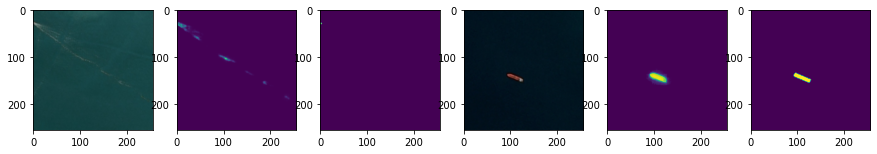

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0247 - dice_loss: 0.7463 - accuracy: 0.9915 - val_loss: 0.0198 - val_dice_loss: 0.6625 - val_accuracy: 0.9939
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0235 - dice_loss: 0.7457 - accuracy: 0.9917 - val_loss: 0.0185 - val_dice_loss: 0.6414 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.6466 - accuracy: 0.9929 - val_loss: 0.0192 - val_dice_loss: 0.6223 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.6767 - accuracy: 0.9937 - val_loss: 0.0204 - val_dice_loss: 0.6295 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.6526 - accuracy: 0.9948 - val_loss: 0.0218 - val_dice_loss: 0.6556 - val_accuracy: 0.9943


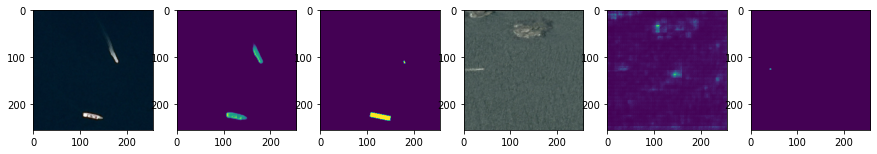

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.7207 - accuracy: 0.9976 - val_loss: 0.0096 - val_dice_loss: 0.6218 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.7146 - accuracy: 0.9977 - val_loss: 0.0093 - val_dice_loss: 0.6100 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.7164 - accuracy: 0.9977 - val_loss: 0.0092 - val_dice_loss: 0.6043 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.7250 - accuracy: 0.9977 - val_loss: 0.0092 - val_dice_loss: 0.6015 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.7388 - accuracy: 0.9977 - val_loss: 0.0091 - val_dice_loss: 0.5999 - val_accuracy: 0.9972


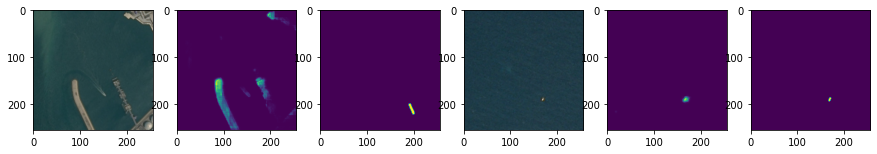

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.7417 - accuracy: 0.9966 - val_loss: 0.0099 - val_dice_loss: 0.8235 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.6808 - accuracy: 0.9967 - val_loss: 0.0099 - val_dice_loss: 0.8291 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.7255 - accuracy: 0.9966 - val_loss: 0.0100 - val_dice_loss: 0.8378 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.7482 - accuracy: 0.9968 - val_loss: 0.0102 - val_dice_loss: 0.8518 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.7189 - accuracy: 0.9968 - val_loss: 0.0110 - val_dice_loss: 0.8702 - val_accuracy: 0.9969


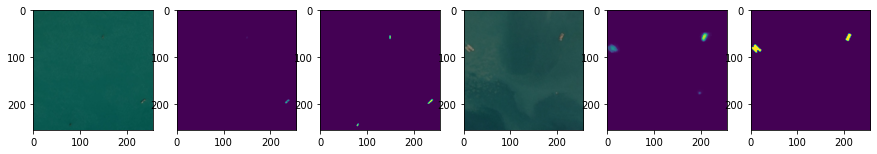

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.5896 - accuracy: 0.9971 - val_loss: 0.0188 - val_dice_loss: 0.7672 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6014 - accuracy: 0.9974 - val_loss: 0.0195 - val_dice_loss: 0.7752 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6473 - accuracy: 0.9969 - val_loss: 0.0190 - val_dice_loss: 0.7657 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.6078 - accuracy: 0.9973 - val_loss: 0.0182 - val_dice_loss: 0.7487 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6354 - accuracy: 0.9970 - val_loss: 0.0173 - val_dice_loss: 0.7272 - val_accuracy: 0.9955


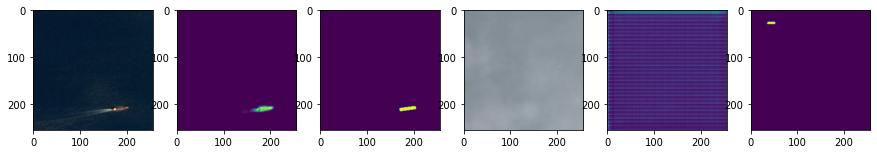

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5597 - accuracy: 0.9959 - val_loss: 0.0115 - val_dice_loss: 0.6295 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5121 - accuracy: 0.9963 - val_loss: 0.0115 - val_dice_loss: 0.6235 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5141 - accuracy: 0.9961 - val_loss: 0.0116 - val_dice_loss: 0.6202 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5258 - accuracy: 0.9960 - val_loss: 0.0118 - val_dice_loss: 0.6187 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.6143 - accuracy: 0.9958 - val_loss: 0.0120 - val_dice_loss: 0.6160 - val_accuracy: 0.9964


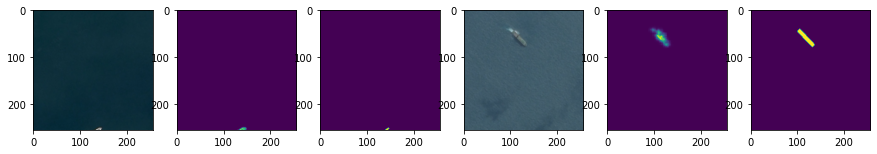

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.6523 - accuracy: 0.9950 - val_loss: 0.0145 - val_dice_loss: 0.6660 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.6793 - accuracy: 0.9951 - val_loss: 0.0146 - val_dice_loss: 0.6406 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.6420 - accuracy: 0.9952 - val_loss: 0.0161 - val_dice_loss: 0.6519 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.5899 - accuracy: 0.9955 - val_loss: 0.0202 - val_dice_loss: 0.6890 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6020 - accuracy: 0.9956 - val_loss: 0.0268 - val_dice_loss: 0.7296 - val_accuracy: 0.9930


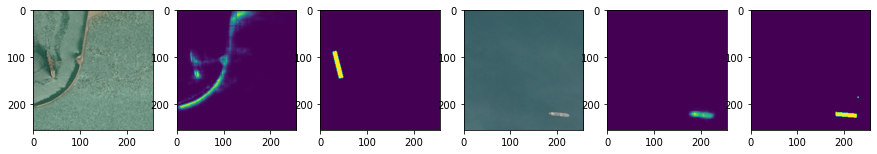

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6633 - accuracy: 0.9981 - val_loss: 0.0130 - val_dice_loss: 0.6983 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5915 - accuracy: 0.9979 - val_loss: 0.0129 - val_dice_loss: 0.6970 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5891 - accuracy: 0.9975 - val_loss: 0.0130 - val_dice_loss: 0.6968 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.6006 - accuracy: 0.9979 - val_loss: 0.0133 - val_dice_loss: 0.6984 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5942 - accuracy: 0.9974 - val_loss: 0.0138 - val_dice_loss: 0.7000 - val_accuracy: 0.9961


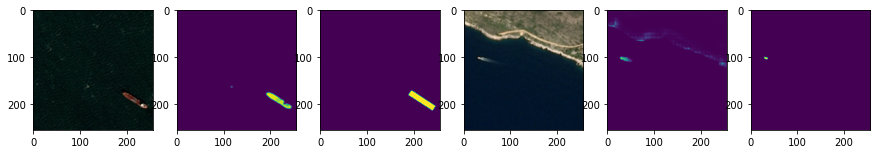

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.7486 - accuracy: 0.9957 - val_loss: 0.0084 - val_dice_loss: 0.6297 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.7541 - accuracy: 0.9957 - val_loss: 0.0081 - val_dice_loss: 0.6153 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.7223 - accuracy: 0.9960 - val_loss: 0.0080 - val_dice_loss: 0.6091 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.6971 - accuracy: 0.9963 - val_loss: 0.0082 - val_dice_loss: 0.6080 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6705 - accuracy: 0.9964 - val_loss: 0.0084 - val_dice_loss: 0.6063 - val_accuracy: 0.9978


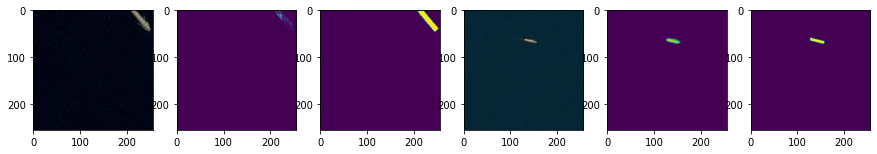

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5332 - accuracy: 0.9980 - val_loss: 0.0077 - val_dice_loss: 0.6550 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.5120 - accuracy: 0.9982 - val_loss: 0.0076 - val_dice_loss: 0.6382 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5239 - accuracy: 0.9981 - val_loss: 0.0074 - val_dice_loss: 0.6221 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0049 - dice_loss: 0.4742 - accuracy: 0.9983 - val_loss: 0.0073 - val_dice_loss: 0.6119 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.4674 - accuracy: 0.9984 - val_loss: 0.0073 - val_dice_loss: 0.6079 - val_accuracy: 0.9979


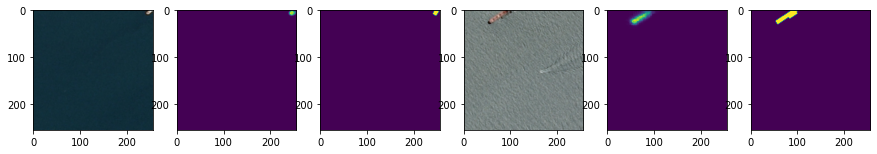

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5228 - accuracy: 0.9967 - val_loss: 0.0069 - val_dice_loss: 0.5228 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5830 - accuracy: 0.9968 - val_loss: 0.0069 - val_dice_loss: 0.5332 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.4343 - accuracy: 0.9976 - val_loss: 0.0071 - val_dice_loss: 0.5426 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.4530 - accuracy: 0.9974 - val_loss: 0.0072 - val_dice_loss: 0.5472 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.4484 - accuracy: 0.9974 - val_loss: 0.0072 - val_dice_loss: 0.5454 - val_accuracy: 0.9975


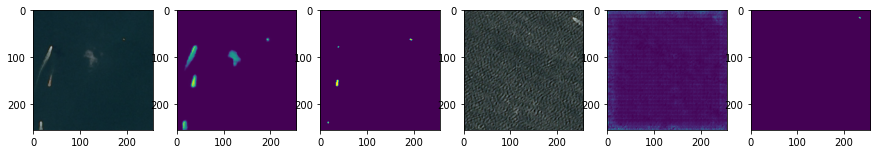

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5674 - accuracy: 0.9954 - val_loss: 0.0118 - val_dice_loss: 0.7005 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5703 - accuracy: 0.9955 - val_loss: 0.0129 - val_dice_loss: 0.7280 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5101 - accuracy: 0.9957 - val_loss: 0.0140 - val_dice_loss: 0.7455 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5494 - accuracy: 0.9950 - val_loss: 0.0142 - val_dice_loss: 0.7468 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.5775 - accuracy: 0.9956 - val_loss: 0.0137 - val_dice_loss: 0.7362 - val_accuracy: 0.9961


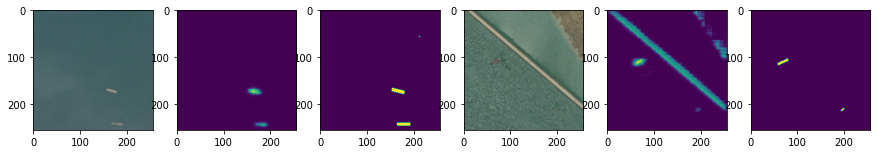

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.6982 - accuracy: 0.9965 - val_loss: 0.0077 - val_dice_loss: 0.5316 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.7029 - accuracy: 0.9964 - val_loss: 0.0080 - val_dice_loss: 0.5498 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.6962 - accuracy: 0.9960 - val_loss: 0.0086 - val_dice_loss: 0.5713 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6904 - accuracy: 0.9966 - val_loss: 0.0079 - val_dice_loss: 0.5520 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.6639 - accuracy: 0.9968 - val_loss: 0.0072 - val_dice_loss: 0.5285 - val_accuracy: 0.9976


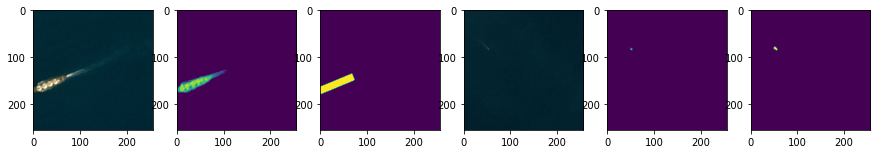

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.8279 - accuracy: 0.9973 - val_loss: 0.0106 - val_dice_loss: 0.5357 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.8161 - accuracy: 0.9973 - val_loss: 0.0106 - val_dice_loss: 0.5385 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.7961 - accuracy: 0.9974 - val_loss: 0.0107 - val_dice_loss: 0.5458 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.7845 - accuracy: 0.9974 - val_loss: 0.0108 - val_dice_loss: 0.5586 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.8217 - accuracy: 0.9972 - val_loss: 0.0111 - val_dice_loss: 0.5771 - val_accuracy: 0.9963


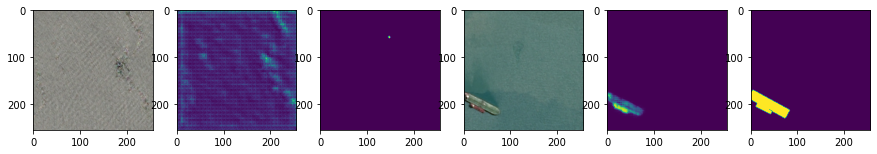

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0203 - dice_loss: 0.6679 - accuracy: 0.9937 - val_loss: 0.0150 - val_dice_loss: 0.6993 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.5583 - accuracy: 0.9946 - val_loss: 0.0150 - val_dice_loss: 0.6949 - val_accuracy: 0.9944
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0161 - dice_loss: 0.5958 - accuracy: 0.9945 - val_loss: 0.0159 - val_dice_loss: 0.6958 - val_accuracy: 0.9940
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0186 - dice_loss: 0.6583 - accuracy: 0.9929 - val_loss: 0.0159 - val_dice_loss: 0.6802 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.6246 - accuracy: 0.9934 - val_loss: 0.0147 - val_dice_loss: 0.6509 - val_accuracy: 0.9940


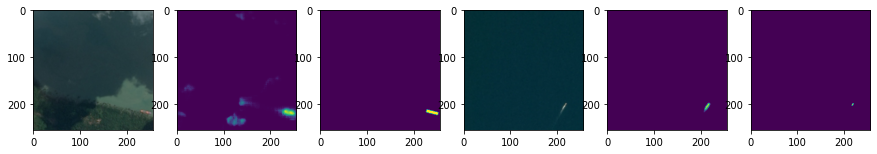

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0154 - dice_loss: 0.6847 - accuracy: 0.9958 - val_loss: 0.0103 - val_dice_loss: 0.6367 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.6546 - accuracy: 0.9960 - val_loss: 0.0095 - val_dice_loss: 0.6200 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6428 - accuracy: 0.9965 - val_loss: 0.0091 - val_dice_loss: 0.6105 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.6504 - accuracy: 0.9964 - val_loss: 0.0088 - val_dice_loss: 0.6041 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.6337 - accuracy: 0.9966 - val_loss: 0.0087 - val_dice_loss: 0.6020 - val_accuracy: 0.9965


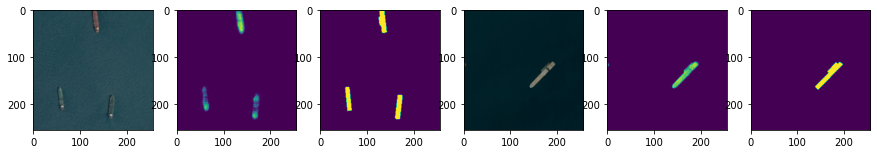

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4809 - accuracy: 0.9960 - val_loss: 0.0119 - val_dice_loss: 0.5594 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.4451 - accuracy: 0.9961 - val_loss: 0.0121 - val_dice_loss: 0.5626 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.4993 - accuracy: 0.9960 - val_loss: 0.0124 - val_dice_loss: 0.5687 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.4716 - accuracy: 0.9960 - val_loss: 0.0131 - val_dice_loss: 0.5787 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.4401 - accuracy: 0.9963 - val_loss: 0.0140 - val_dice_loss: 0.5884 - val_accuracy: 0.9941


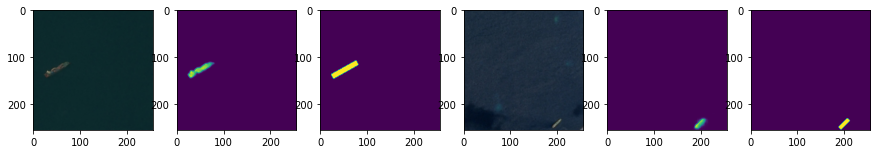

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0108 - dice_loss: 0.6777 - accuracy: 0.9966 - val_loss: 0.0213 - val_dice_loss: 0.5786 - val_accuracy: 0.9925
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0103 - dice_loss: 0.6546 - accuracy: 0.9969 - val_loss: 0.0214 - val_dice_loss: 0.5809 - val_accuracy: 0.9923
Epoch 3/5
2/2 [==============================] - 5s 3s/step - loss: 0.0092 - dice_loss: 0.6575 - accuracy: 0.9970 - val_loss: 0.0215 - val_dice_loss: 0.5831 - val_accuracy: 0.9924
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.6254 - accuracy: 0.9973 - val_loss: 0.0217 - val_dice_loss: 0.5875 - val_accuracy: 0.9927
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6293 - accuracy: 0.9978 - val_loss: 0.0222 - val_dice_loss: 0.5928 - val_accuracy: 0.9929


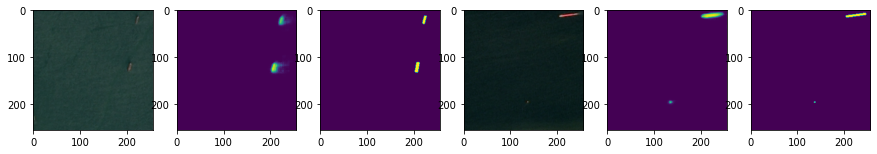

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.5648 - accuracy: 0.9977 - val_loss: 0.0207 - val_dice_loss: 0.6731 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6059 - accuracy: 0.9975 - val_loss: 0.0207 - val_dice_loss: 0.6747 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.5948 - accuracy: 0.9975 - val_loss: 0.0209 - val_dice_loss: 0.6749 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5759 - accuracy: 0.9976 - val_loss: 0.0211 - val_dice_loss: 0.6745 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.6249 - accuracy: 0.9974 - val_loss: 0.0213 - val_dice_loss: 0.6742 - val_accuracy: 0.9943


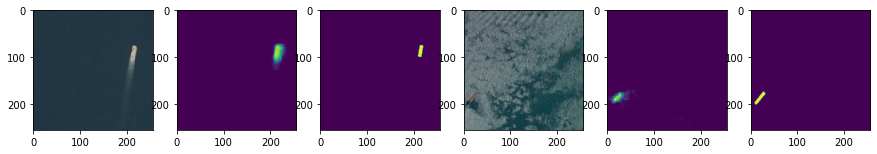

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0085 - dice_loss: 0.6752 - accuracy: 0.9979 - val_loss: 0.0118 - val_dice_loss: 0.5320 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.6831 - accuracy: 0.9979 - val_loss: 0.0118 - val_dice_loss: 0.5360 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6590 - accuracy: 0.9980 - val_loss: 0.0118 - val_dice_loss: 0.5421 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.6418 - accuracy: 0.9981 - val_loss: 0.0121 - val_dice_loss: 0.5507 - val_accuracy: 0.9956
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.6176 - accuracy: 0.9981 - val_loss: 0.0125 - val_dice_loss: 0.5629 - val_accuracy: 0.9955


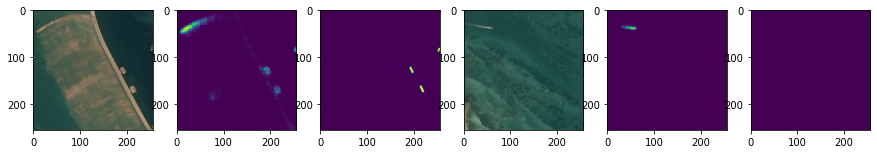

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5806 - accuracy: 0.9970 - val_loss: 0.0066 - val_dice_loss: 0.6319 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5740 - accuracy: 0.9968 - val_loss: 0.0066 - val_dice_loss: 0.6346 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.5804 - accuracy: 0.9968 - val_loss: 0.0067 - val_dice_loss: 0.6365 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0102 - dice_loss: 0.5731 - accuracy: 0.9970 - val_loss: 0.0067 - val_dice_loss: 0.6379 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5354 - accuracy: 0.9970 - val_loss: 0.0067 - val_dice_loss: 0.6400 - val_accuracy: 0.9974


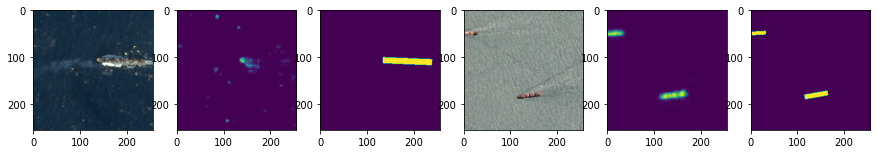

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.4656 - accuracy: 0.9966 - val_loss: 0.0113 - val_dice_loss: 0.6915 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.4227 - accuracy: 0.9968 - val_loss: 0.0112 - val_dice_loss: 0.6900 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.4316 - accuracy: 0.9967 - val_loss: 0.0111 - val_dice_loss: 0.6879 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.4031 - accuracy: 0.9970 - val_loss: 0.0111 - val_dice_loss: 0.6833 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5774 - accuracy: 0.9963 - val_loss: 0.0110 - val_dice_loss: 0.6799 - val_accuracy: 0.9969


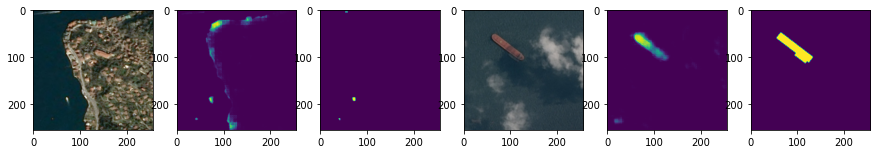

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.6122 - accuracy: 0.9963 - val_loss: 0.0114 - val_dice_loss: 0.5927 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5968 - accuracy: 0.9963 - val_loss: 0.0114 - val_dice_loss: 0.5917 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.6042 - accuracy: 0.9963 - val_loss: 0.0113 - val_dice_loss: 0.5910 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5859 - accuracy: 0.9964 - val_loss: 0.0111 - val_dice_loss: 0.5867 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.6159 - accuracy: 0.9961 - val_loss: 0.0110 - val_dice_loss: 0.5829 - val_accuracy: 0.9963


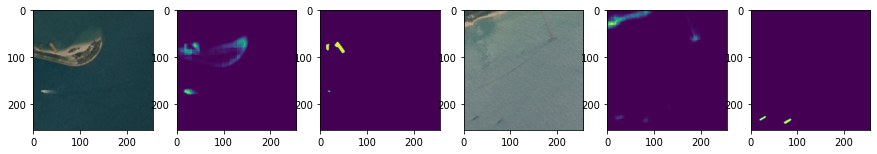

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0224 - dice_loss: 0.5874 - accuracy: 0.9938 - val_loss: 0.0167 - val_dice_loss: 0.5538 - val_accuracy: 0.9940
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0220 - dice_loss: 0.6003 - accuracy: 0.9939 - val_loss: 0.0175 - val_dice_loss: 0.5639 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.5778 - accuracy: 0.9943 - val_loss: 0.0201 - val_dice_loss: 0.5822 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.5695 - accuracy: 0.9943 - val_loss: 0.0283 - val_dice_loss: 0.6058 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.5567 - accuracy: 0.9943 - val_loss: 0.0286 - val_dice_loss: 0.6155 - val_accuracy: 0.9942


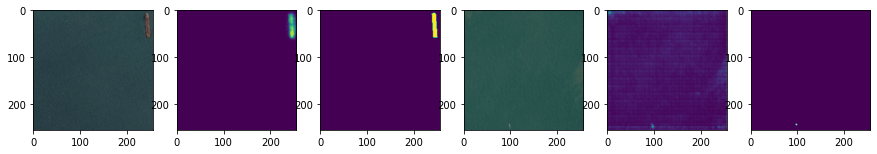

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.7150 - accuracy: 0.9946 - val_loss: 0.0099 - val_dice_loss: 0.6021 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.7504 - accuracy: 0.9940 - val_loss: 0.0099 - val_dice_loss: 0.6112 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0161 - dice_loss: 0.6861 - accuracy: 0.9952 - val_loss: 0.0100 - val_dice_loss: 0.6191 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.6953 - accuracy: 0.9952 - val_loss: 0.0101 - val_dice_loss: 0.6268 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.6851 - accuracy: 0.9951 - val_loss: 0.0102 - val_dice_loss: 0.6354 - val_accuracy: 0.9965


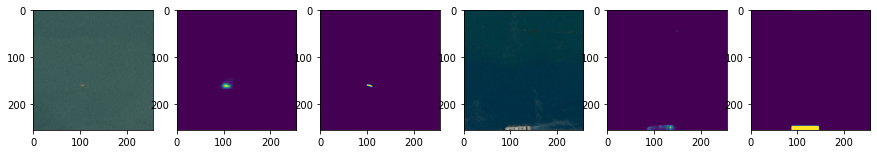

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.6203 - accuracy: 0.9969 - val_loss: 0.0086 - val_dice_loss: 0.6109 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.7094 - accuracy: 0.9968 - val_loss: 0.0088 - val_dice_loss: 0.6249 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.6004 - accuracy: 0.9973 - val_loss: 0.0091 - val_dice_loss: 0.6378 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0091 - dice_loss: 0.5537 - accuracy: 0.9974 - val_loss: 0.0093 - val_dice_loss: 0.6447 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5726 - accuracy: 0.9970 - val_loss: 0.0092 - val_dice_loss: 0.6381 - val_accuracy: 0.9966


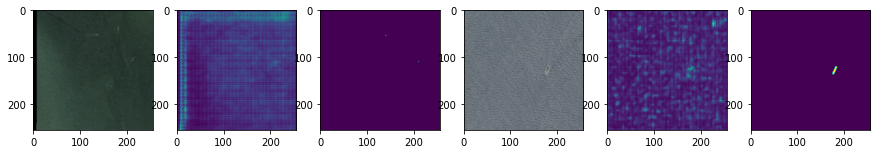

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.8082 - accuracy: 0.9973 - val_loss: 0.0157 - val_dice_loss: 0.7507 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.7804 - accuracy: 0.9976 - val_loss: 0.0155 - val_dice_loss: 0.7460 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.8072 - accuracy: 0.9974 - val_loss: 0.0151 - val_dice_loss: 0.7314 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.7582 - accuracy: 0.9974 - val_loss: 0.0145 - val_dice_loss: 0.7137 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0065 - dice_loss: 0.7642 - accuracy: 0.9973 - val_loss: 0.0142 - val_dice_loss: 0.7065 - val_accuracy: 0.9952


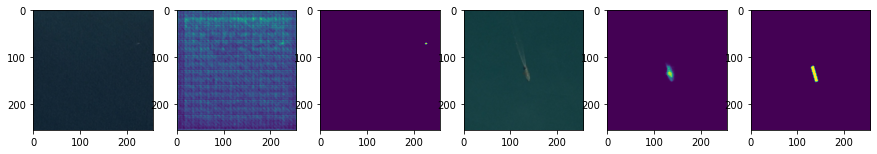

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5380 - accuracy: 0.9963 - val_loss: 0.0078 - val_dice_loss: 0.5944 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5018 - accuracy: 0.9968 - val_loss: 0.0078 - val_dice_loss: 0.5827 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.4800 - accuracy: 0.9971 - val_loss: 0.0079 - val_dice_loss: 0.5763 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.4765 - accuracy: 0.9972 - val_loss: 0.0079 - val_dice_loss: 0.5726 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.5142 - accuracy: 0.9972 - val_loss: 0.0080 - val_dice_loss: 0.5717 - val_accuracy: 0.9977


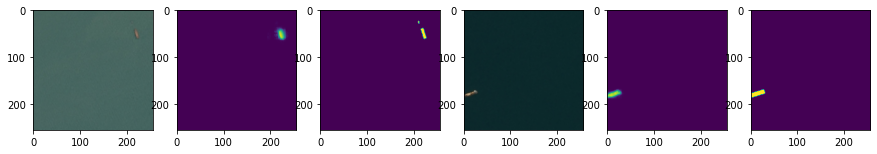

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.6645 - accuracy: 0.9951 - val_loss: 0.0258 - val_dice_loss: 0.6680 - val_accuracy: 0.9941
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.6161 - accuracy: 0.9952 - val_loss: 0.0244 - val_dice_loss: 0.6473 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.6082 - accuracy: 0.9953 - val_loss: 0.0240 - val_dice_loss: 0.6262 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0136 - dice_loss: 0.5751 - accuracy: 0.9955 - val_loss: 0.0242 - val_dice_loss: 0.6204 - val_accuracy: 0.9945
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5700 - accuracy: 0.9954 - val_loss: 0.0246 - val_dice_loss: 0.6208 - val_accuracy: 0.9946


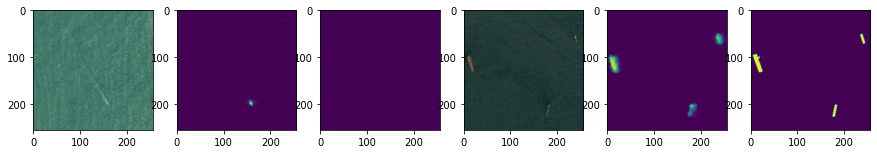

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.7100 - accuracy: 0.9970 - val_loss: 0.0216 - val_dice_loss: 0.7120 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.6972 - accuracy: 0.9970 - val_loss: 0.0227 - val_dice_loss: 0.7016 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.7096 - accuracy: 0.9972 - val_loss: 0.0240 - val_dice_loss: 0.6930 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.7053 - accuracy: 0.9975 - val_loss: 0.0243 - val_dice_loss: 0.6806 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.6762 - accuracy: 0.9973 - val_loss: 0.0246 - val_dice_loss: 0.6666 - val_accuracy: 0.9956


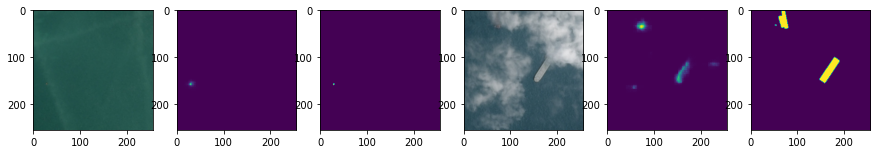

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5560 - accuracy: 0.9968 - val_loss: 0.0031 - val_dice_loss: 0.5909 - val_accuracy: 0.9989
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5913 - accuracy: 0.9965 - val_loss: 0.0030 - val_dice_loss: 0.5869 - val_accuracy: 0.9989
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5452 - accuracy: 0.9967 - val_loss: 0.0030 - val_dice_loss: 0.5826 - val_accuracy: 0.9989
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5292 - accuracy: 0.9967 - val_loss: 0.0030 - val_dice_loss: 0.5792 - val_accuracy: 0.9990
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5062 - accuracy: 0.9970 - val_loss: 0.0030 - val_dice_loss: 0.5777 - val_accuracy: 0.9990


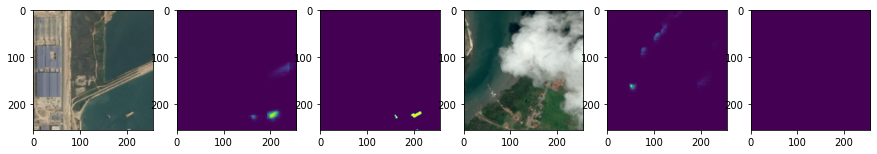

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.6107 - accuracy: 0.9961 - val_loss: 0.0072 - val_dice_loss: 0.5025 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0121 - dice_loss: 0.6053 - accuracy: 0.9962 - val_loss: 0.0070 - val_dice_loss: 0.4917 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6053 - accuracy: 0.9960 - val_loss: 0.0071 - val_dice_loss: 0.4873 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5870 - accuracy: 0.9967 - val_loss: 0.0073 - val_dice_loss: 0.4871 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5518 - accuracy: 0.9967 - val_loss: 0.0074 - val_dice_loss: 0.4865 - val_accuracy: 0.9977


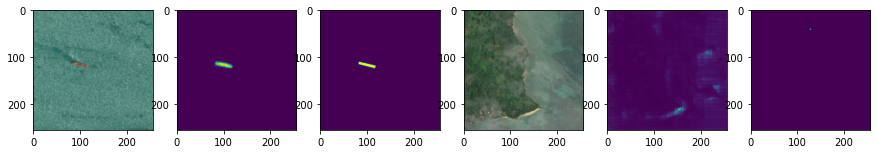

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.6763 - accuracy: 0.9976 - val_loss: 0.0089 - val_dice_loss: 0.4963 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.6728 - accuracy: 0.9981 - val_loss: 0.0089 - val_dice_loss: 0.4945 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.6687 - accuracy: 0.9981 - val_loss: 0.0090 - val_dice_loss: 0.4988 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0058 - dice_loss: 0.6523 - accuracy: 0.9985 - val_loss: 0.0092 - val_dice_loss: 0.5058 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.6554 - accuracy: 0.9984 - val_loss: 0.0094 - val_dice_loss: 0.5156 - val_accuracy: 0.9969


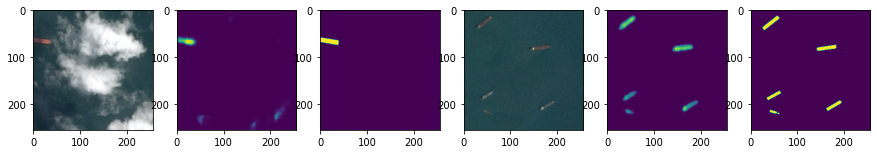

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5932 - accuracy: 0.9966 - val_loss: 0.0212 - val_dice_loss: 0.7297 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6058 - accuracy: 0.9967 - val_loss: 0.0209 - val_dice_loss: 0.7308 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5878 - accuracy: 0.9967 - val_loss: 0.0206 - val_dice_loss: 0.7288 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6217 - accuracy: 0.9968 - val_loss: 0.0203 - val_dice_loss: 0.7245 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5206 - accuracy: 0.9970 - val_loss: 0.0201 - val_dice_loss: 0.7209 - val_accuracy: 0.9968


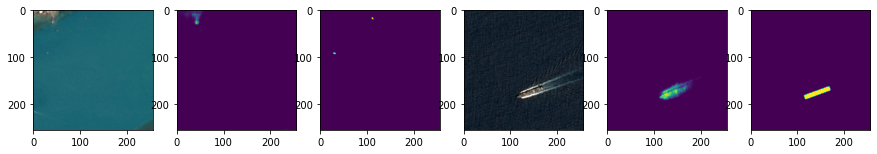

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.5985 - accuracy: 0.9971 - val_loss: 0.0181 - val_dice_loss: 0.4723 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.6394 - accuracy: 0.9971 - val_loss: 0.0176 - val_dice_loss: 0.4754 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.5828 - accuracy: 0.9972 - val_loss: 0.0175 - val_dice_loss: 0.4834 - val_accuracy: 0.9944
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0110 - dice_loss: 0.5618 - accuracy: 0.9974 - val_loss: 0.0177 - val_dice_loss: 0.4991 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5458 - accuracy: 0.9973 - val_loss: 0.0181 - val_dice_loss: 0.5170 - val_accuracy: 0.9941


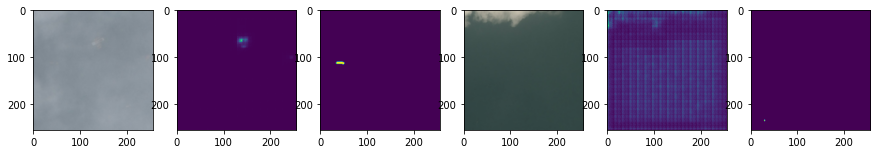

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0211 - dice_loss: 0.6599 - accuracy: 0.9953 - val_loss: 0.0120 - val_dice_loss: 0.5632 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0168 - dice_loss: 0.5968 - accuracy: 0.9954 - val_loss: 0.0122 - val_dice_loss: 0.5632 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.5218 - accuracy: 0.9959 - val_loss: 0.0122 - val_dice_loss: 0.5612 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.6286 - accuracy: 0.9954 - val_loss: 0.0119 - val_dice_loss: 0.5587 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.6051 - accuracy: 0.9959 - val_loss: 0.0116 - val_dice_loss: 0.5586 - val_accuracy: 0.9973


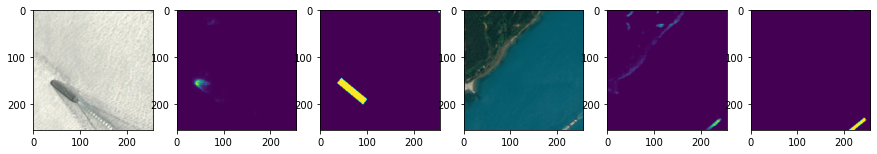

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.6067 - accuracy: 0.9973 - val_loss: 0.0189 - val_dice_loss: 0.6240 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6101 - accuracy: 0.9975 - val_loss: 0.0210 - val_dice_loss: 0.6281 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5906 - accuracy: 0.9979 - val_loss: 0.0218 - val_dice_loss: 0.6324 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5824 - accuracy: 0.9977 - val_loss: 0.0223 - val_dice_loss: 0.6393 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0076 - dice_loss: 0.6006 - accuracy: 0.9976 - val_loss: 0.0224 - val_dice_loss: 0.6465 - val_accuracy: 0.9948


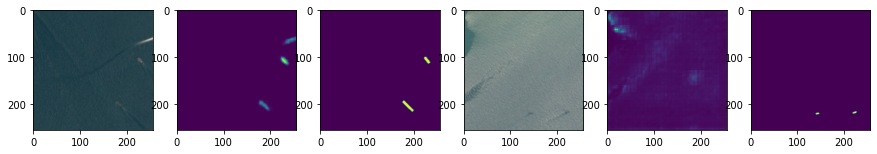

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.5695 - accuracy: 0.9963 - val_loss: 0.0082 - val_dice_loss: 0.6403 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.5954 - accuracy: 0.9961 - val_loss: 0.0082 - val_dice_loss: 0.6399 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.6054 - accuracy: 0.9961 - val_loss: 0.0080 - val_dice_loss: 0.6364 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.5635 - accuracy: 0.9962 - val_loss: 0.0079 - val_dice_loss: 0.6354 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.5355 - accuracy: 0.9962 - val_loss: 0.0079 - val_dice_loss: 0.6400 - val_accuracy: 0.9975


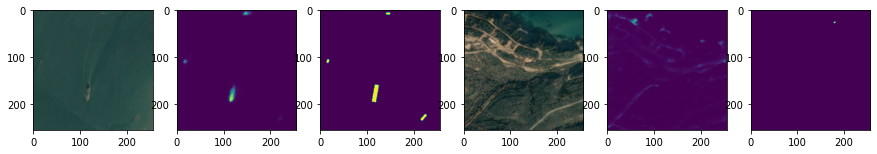

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0111 - dice_loss: 0.6034 - accuracy: 0.9963 - val_loss: 0.0121 - val_dice_loss: 0.6529 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6364 - accuracy: 0.9961 - val_loss: 0.0134 - val_dice_loss: 0.6770 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.6053 - accuracy: 0.9961 - val_loss: 0.0155 - val_dice_loss: 0.7089 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.5959 - accuracy: 0.9964 - val_loss: 0.0177 - val_dice_loss: 0.7315 - val_accuracy: 0.9936
Epoch 5/5
2/2 [==============================] - 5s 2s/step - loss: 0.0098 - dice_loss: 0.5700 - accuracy: 0.9967 - val_loss: 0.0184 - val_dice_loss: 0.7371 - val_accuracy: 0.9933


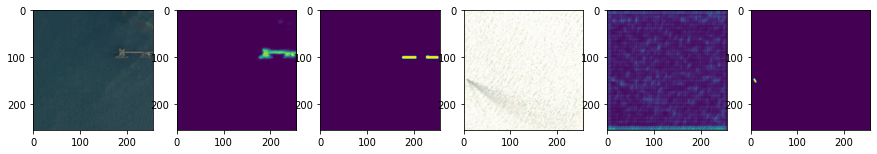

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.7106 - accuracy: 0.9965 - val_loss: 0.0137 - val_dice_loss: 0.7330 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.6927 - accuracy: 0.9966 - val_loss: 0.0126 - val_dice_loss: 0.7188 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.7584 - accuracy: 0.9965 - val_loss: 0.0114 - val_dice_loss: 0.7003 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6781 - accuracy: 0.9974 - val_loss: 0.0104 - val_dice_loss: 0.6831 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.7011 - accuracy: 0.9973 - val_loss: 0.0096 - val_dice_loss: 0.6699 - val_accuracy: 0.9971


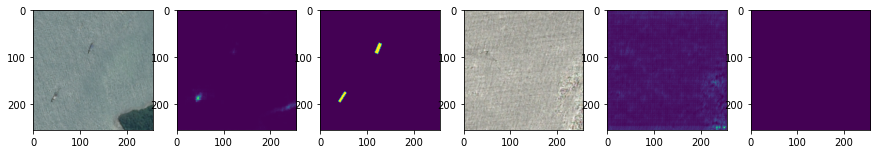

Epoch 1/5
2/2 [==============================] - 5s 4s/step - loss: 0.0387 - dice_loss: 0.7815 - accuracy: 0.9924 - val_loss: 0.0170 - val_dice_loss: 0.7543 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0359 - dice_loss: 0.7731 - accuracy: 0.9925 - val_loss: 0.0164 - val_dice_loss: 0.7540 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0335 - dice_loss: 0.7723 - accuracy: 0.9921 - val_loss: 0.0162 - val_dice_loss: 0.7510 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0297 - dice_loss: 0.7818 - accuracy: 0.9923 - val_loss: 0.0168 - val_dice_loss: 0.7496 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0247 - dice_loss: 0.7535 - accuracy: 0.9921 - val_loss: 0.0191 - val_dice_loss: 0.7641 - val_accuracy: 0.9946


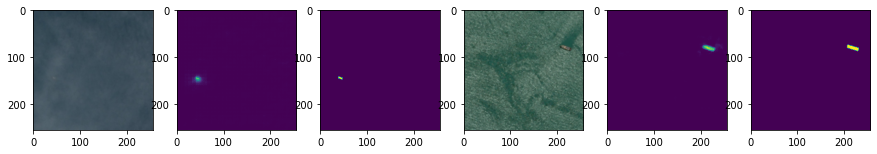

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0201 - dice_loss: 0.7217 - accuracy: 0.9953 - val_loss: 0.0192 - val_dice_loss: 0.7039 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0220 - dice_loss: 0.7390 - accuracy: 0.9954 - val_loss: 0.0204 - val_dice_loss: 0.7181 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.7203 - accuracy: 0.9953 - val_loss: 0.0209 - val_dice_loss: 0.7384 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0194 - dice_loss: 0.7152 - accuracy: 0.9955 - val_loss: 0.0186 - val_dice_loss: 0.7500 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0165 - dice_loss: 0.6911 - accuracy: 0.9957 - val_loss: 0.0165 - val_dice_loss: 0.7355 - val_accuracy: 0.9944


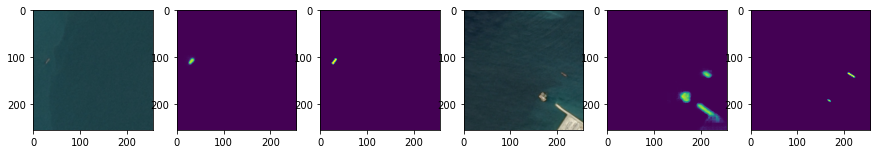

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.6487 - accuracy: 0.9951 - val_loss: 0.0142 - val_dice_loss: 0.5631 - val_accuracy: 0.9945
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.6556 - accuracy: 0.9958 - val_loss: 0.0133 - val_dice_loss: 0.5425 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.6148 - accuracy: 0.9958 - val_loss: 0.0134 - val_dice_loss: 0.5385 - val_accuracy: 0.9946
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0099 - dice_loss: 0.5352 - accuracy: 0.9964 - val_loss: 0.0139 - val_dice_loss: 0.5375 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5199 - accuracy: 0.9965 - val_loss: 0.0143 - val_dice_loss: 0.5375 - val_accuracy: 0.9948


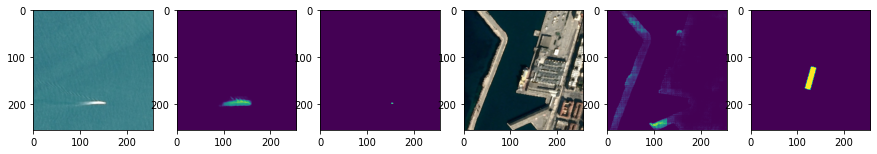

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.5893 - accuracy: 0.9960 - val_loss: 0.0154 - val_dice_loss: 0.6059 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 5s 2s/step - loss: 0.0161 - dice_loss: 0.6374 - accuracy: 0.9960 - val_loss: 0.0161 - val_dice_loss: 0.6051 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6219 - accuracy: 0.9959 - val_loss: 0.0167 - val_dice_loss: 0.6064 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5865 - accuracy: 0.9961 - val_loss: 0.0173 - val_dice_loss: 0.6079 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5454 - accuracy: 0.9963 - val_loss: 0.0178 - val_dice_loss: 0.6110 - val_accuracy: 0.9958


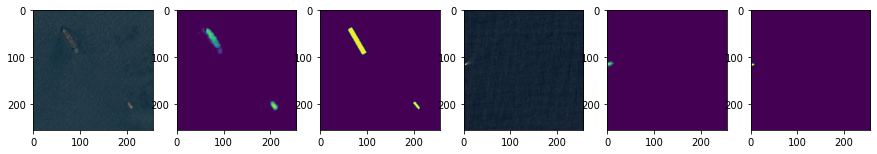

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5969 - accuracy: 0.9986 - val_loss: 0.0079 - val_dice_loss: 0.7217 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.5761 - accuracy: 0.9986 - val_loss: 0.0083 - val_dice_loss: 0.7383 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.5498 - accuracy: 0.9986 - val_loss: 0.0087 - val_dice_loss: 0.7566 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.5825 - accuracy: 0.9986 - val_loss: 0.0090 - val_dice_loss: 0.7748 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.5005 - accuracy: 0.9985 - val_loss: 0.0093 - val_dice_loss: 0.7931 - val_accuracy: 0.9973


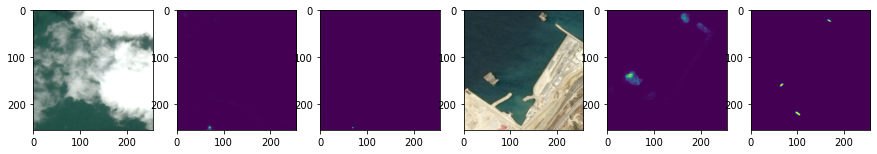

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.7143 - accuracy: 0.9957 - val_loss: 0.0164 - val_dice_loss: 0.7327 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.6810 - accuracy: 0.9957 - val_loss: 0.0145 - val_dice_loss: 0.7099 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.6933 - accuracy: 0.9957 - val_loss: 0.0126 - val_dice_loss: 0.6679 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.6784 - accuracy: 0.9955 - val_loss: 0.0110 - val_dice_loss: 0.6125 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.6034 - accuracy: 0.9961 - val_loss: 0.0103 - val_dice_loss: 0.5730 - val_accuracy: 0.9966


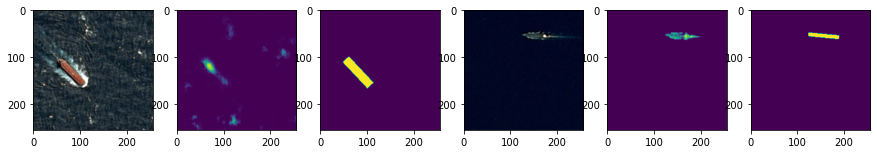

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0183 - dice_loss: 0.6184 - accuracy: 0.9946 - val_loss: 0.0174 - val_dice_loss: 0.6061 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0179 - dice_loss: 0.5962 - accuracy: 0.9945 - val_loss: 0.0156 - val_dice_loss: 0.5762 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.6725 - accuracy: 0.9933 - val_loss: 0.0144 - val_dice_loss: 0.5654 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 5s 4s/step - loss: 0.0174 - dice_loss: 0.6025 - accuracy: 0.9936 - val_loss: 0.0139 - val_dice_loss: 0.5643 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 5s 2s/step - loss: 0.0159 - dice_loss: 0.5908 - accuracy: 0.9946 - val_loss: 0.0138 - val_dice_loss: 0.5675 - val_accuracy: 0.9954


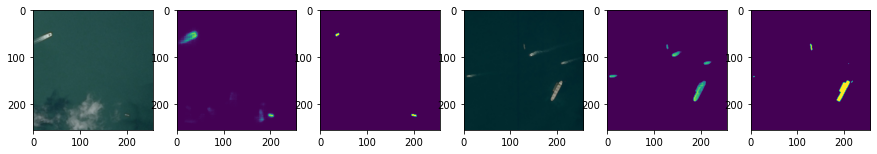

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0100 - dice_loss: 0.6465 - accuracy: 0.9973 - val_loss: 0.0115 - val_dice_loss: 0.6169 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0093 - dice_loss: 0.5969 - accuracy: 0.9979 - val_loss: 0.0116 - val_dice_loss: 0.6142 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0082 - dice_loss: 0.5767 - accuracy: 0.9980 - val_loss: 0.0118 - val_dice_loss: 0.6142 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0075 - dice_loss: 0.6094 - accuracy: 0.9980 - val_loss: 0.0122 - val_dice_loss: 0.6182 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0072 - dice_loss: 0.5493 - accuracy: 0.9979 - val_loss: 0.0125 - val_dice_loss: 0.6237 - val_accuracy: 0.9966


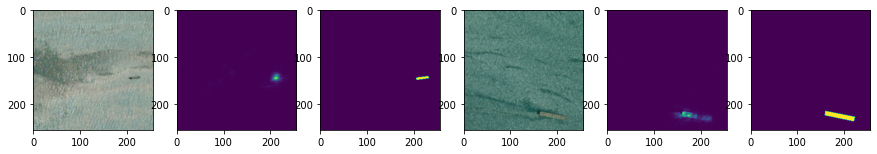

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0118 - dice_loss: 0.7390 - accuracy: 0.9962 - val_loss: 0.0112 - val_dice_loss: 0.7246 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.7562 - accuracy: 0.9958 - val_loss: 0.0110 - val_dice_loss: 0.7227 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.7667 - accuracy: 0.9956 - val_loss: 0.0105 - val_dice_loss: 0.7036 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.7245 - accuracy: 0.9959 - val_loss: 0.0099 - val_dice_loss: 0.6831 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.7052 - accuracy: 0.9962 - val_loss: 0.0094 - val_dice_loss: 0.6624 - val_accuracy: 0.9967


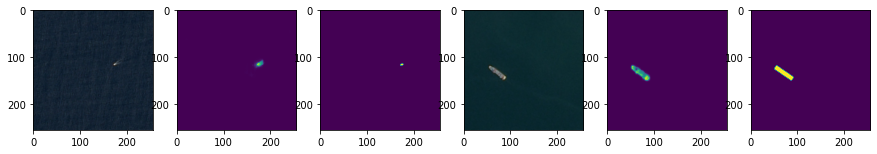

Epoch 1/5
2/2 [==============================] - 9s 5s/step - loss: 0.0131 - dice_loss: 0.5538 - accuracy: 0.9951 - val_loss: 0.0082 - val_dice_loss: 0.6037 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0126 - dice_loss: 0.5597 - accuracy: 0.9953 - val_loss: 0.0080 - val_dice_loss: 0.5922 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5109 - accuracy: 0.9956 - val_loss: 0.0080 - val_dice_loss: 0.5841 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0110 - dice_loss: 0.5186 - accuracy: 0.9957 - val_loss: 0.0080 - val_dice_loss: 0.5834 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0105 - dice_loss: 0.5131 - accuracy: 0.9960 - val_loss: 0.0081 - val_dice_loss: 0.5861 - val_accuracy: 0.9976


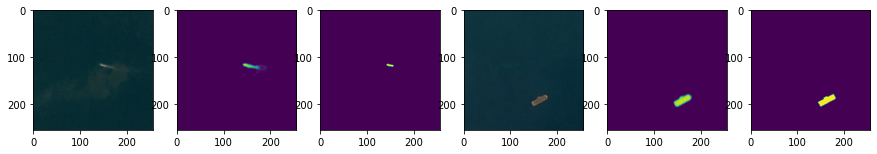

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.6649 - accuracy: 0.9952 - val_loss: 0.0142 - val_dice_loss: 0.5699 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.5912 - accuracy: 0.9961 - val_loss: 0.0142 - val_dice_loss: 0.5718 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5652 - accuracy: 0.9960 - val_loss: 0.0141 - val_dice_loss: 0.5735 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0100 - dice_loss: 0.5083 - accuracy: 0.9962 - val_loss: 0.0140 - val_dice_loss: 0.5765 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0097 - dice_loss: 0.5305 - accuracy: 0.9963 - val_loss: 0.0139 - val_dice_loss: 0.5796 - val_accuracy: 0.9947


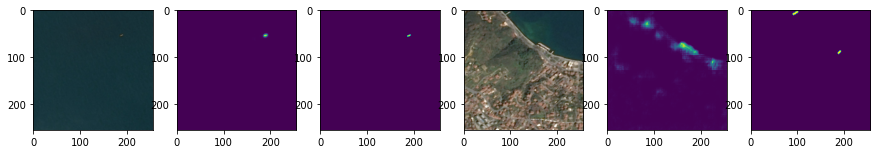

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.7218 - accuracy: 0.9944 - val_loss: 0.0146 - val_dice_loss: 0.5045 - val_accuracy: 0.9949
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.6962 - accuracy: 0.9946 - val_loss: 0.0151 - val_dice_loss: 0.5162 - val_accuracy: 0.9947
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.6777 - accuracy: 0.9950 - val_loss: 0.0160 - val_dice_loss: 0.5354 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 5s 4s/step - loss: 0.0132 - dice_loss: 0.6442 - accuracy: 0.9951 - val_loss: 0.0168 - val_dice_loss: 0.5510 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.6246 - accuracy: 0.9958 - val_loss: 0.0176 - val_dice_loss: 0.5665 - val_accuracy: 0.9935


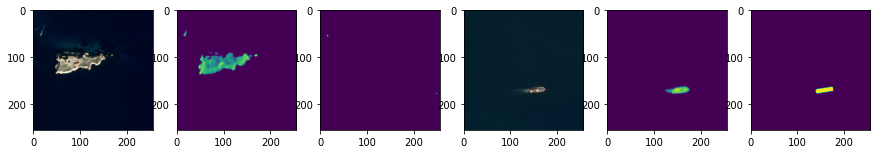

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0166 - dice_loss: 0.7175 - accuracy: 0.9950 - val_loss: 0.0179 - val_dice_loss: 0.8160 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0160 - dice_loss: 0.7035 - accuracy: 0.9950 - val_loss: 0.0180 - val_dice_loss: 0.8210 - val_accuracy: 0.9946
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0142 - dice_loss: 0.6266 - accuracy: 0.9952 - val_loss: 0.0169 - val_dice_loss: 0.8098 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0116 - dice_loss: 0.6359 - accuracy: 0.9954 - val_loss: 0.0159 - val_dice_loss: 0.8006 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0114 - dice_loss: 0.6439 - accuracy: 0.9953 - val_loss: 0.0154 - val_dice_loss: 0.7938 - val_accuracy: 0.9957


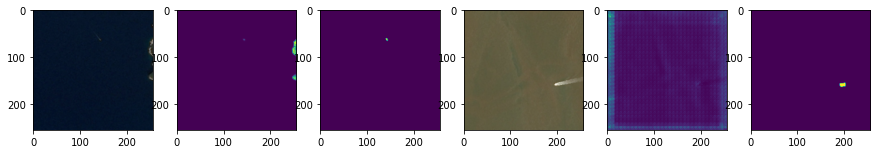

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0134 - dice_loss: 0.6034 - accuracy: 0.9961 - val_loss: 0.0084 - val_dice_loss: 0.5897 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 6s 4s/step - loss: 0.0130 - dice_loss: 0.5497 - accuracy: 0.9959 - val_loss: 0.0083 - val_dice_loss: 0.5879 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0112 - dice_loss: 0.5381 - accuracy: 0.9958 - val_loss: 0.0081 - val_dice_loss: 0.5848 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.6046 - accuracy: 0.9961 - val_loss: 0.0080 - val_dice_loss: 0.5772 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5563 - accuracy: 0.9960 - val_loss: 0.0080 - val_dice_loss: 0.5727 - val_accuracy: 0.9976


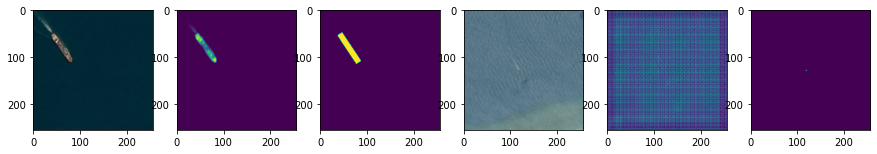

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0122 - dice_loss: 0.6691 - accuracy: 0.9965 - val_loss: 0.0114 - val_dice_loss: 0.7155 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0098 - dice_loss: 0.6216 - accuracy: 0.9968 - val_loss: 0.0114 - val_dice_loss: 0.7108 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0088 - dice_loss: 0.5871 - accuracy: 0.9969 - val_loss: 0.0114 - val_dice_loss: 0.7095 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5736 - accuracy: 0.9969 - val_loss: 0.0115 - val_dice_loss: 0.7119 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.5259 - accuracy: 0.9976 - val_loss: 0.0116 - val_dice_loss: 0.7162 - val_accuracy: 0.9964


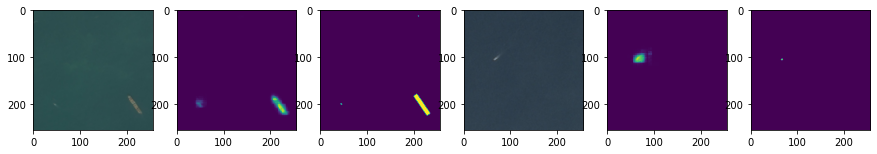

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.5033 - accuracy: 0.9952 - val_loss: 0.0085 - val_dice_loss: 0.4106 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.4811 - accuracy: 0.9949 - val_loss: 0.0082 - val_dice_loss: 0.3987 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.4796 - accuracy: 0.9954 - val_loss: 0.0080 - val_dice_loss: 0.3899 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0099 - dice_loss: 0.4404 - accuracy: 0.9955 - val_loss: 0.0078 - val_dice_loss: 0.3828 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.4599 - accuracy: 0.9956 - val_loss: 0.0077 - val_dice_loss: 0.3804 - val_accuracy: 0.9974


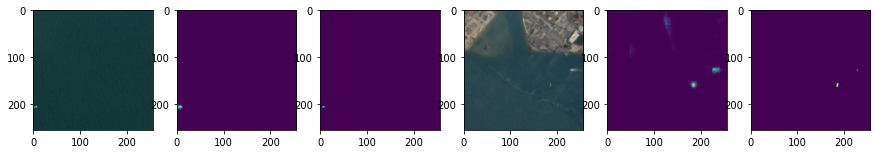

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.5090 - accuracy: 0.9950 - val_loss: 0.0153 - val_dice_loss: 0.5658 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0151 - dice_loss: 0.4630 - accuracy: 0.9950 - val_loss: 0.0144 - val_dice_loss: 0.5546 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.4973 - accuracy: 0.9946 - val_loss: 0.0138 - val_dice_loss: 0.5453 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.4814 - accuracy: 0.9948 - val_loss: 0.0133 - val_dice_loss: 0.5401 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.4661 - accuracy: 0.9950 - val_loss: 0.0130 - val_dice_loss: 0.5370 - val_accuracy: 0.9959


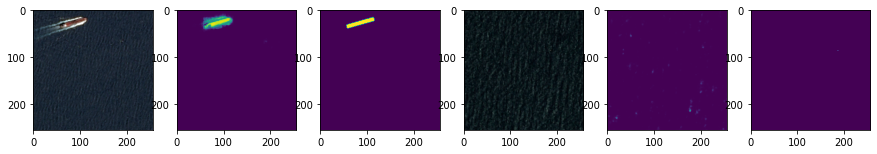

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0063 - dice_loss: 0.6286 - accuracy: 0.9981 - val_loss: 0.0114 - val_dice_loss: 0.4327 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.5787 - accuracy: 0.9985 - val_loss: 0.0115 - val_dice_loss: 0.4340 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.5386 - accuracy: 0.9985 - val_loss: 0.0117 - val_dice_loss: 0.4385 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.5210 - accuracy: 0.9986 - val_loss: 0.0121 - val_dice_loss: 0.4486 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0044 - dice_loss: 0.5181 - accuracy: 0.9987 - val_loss: 0.0129 - val_dice_loss: 0.4677 - val_accuracy: 0.9956


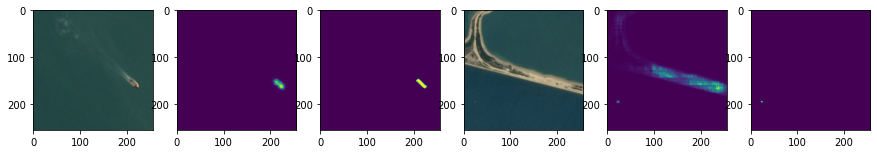

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0085 - dice_loss: 0.7134 - accuracy: 0.9977 - val_loss: 0.0132 - val_dice_loss: 0.6740 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.7290 - accuracy: 0.9977 - val_loss: 0.0143 - val_dice_loss: 0.7005 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0067 - dice_loss: 0.6664 - accuracy: 0.9979 - val_loss: 0.0150 - val_dice_loss: 0.7157 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.6300 - accuracy: 0.9980 - val_loss: 0.0155 - val_dice_loss: 0.7250 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.6086 - accuracy: 0.9980 - val_loss: 0.0158 - val_dice_loss: 0.7312 - val_accuracy: 0.9958


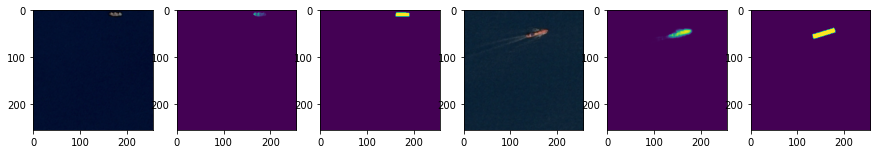

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.5841 - accuracy: 0.9953 - val_loss: 0.0252 - val_dice_loss: 0.7756 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.6082 - accuracy: 0.9951 - val_loss: 0.0249 - val_dice_loss: 0.7550 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.5634 - accuracy: 0.9956 - val_loss: 0.0242 - val_dice_loss: 0.7295 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0116 - dice_loss: 0.5369 - accuracy: 0.9959 - val_loss: 0.0234 - val_dice_loss: 0.7084 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.5535 - accuracy: 0.9958 - val_loss: 0.0225 - val_dice_loss: 0.6909 - val_accuracy: 0.9952


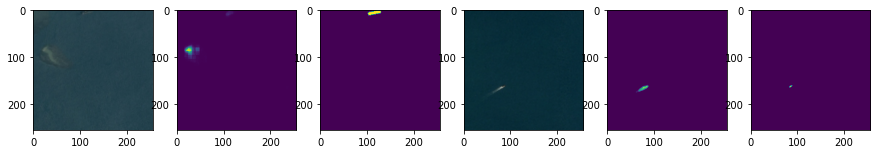

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.4852 - accuracy: 0.9971 - val_loss: 0.0202 - val_dice_loss: 0.6565 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.4281 - accuracy: 0.9974 - val_loss: 0.0197 - val_dice_loss: 0.6451 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.4314 - accuracy: 0.9974 - val_loss: 0.0195 - val_dice_loss: 0.6403 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.4153 - accuracy: 0.9971 - val_loss: 0.0196 - val_dice_loss: 0.6394 - val_accuracy: 0.9941
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0066 - dice_loss: 0.3902 - accuracy: 0.9979 - val_loss: 0.0199 - val_dice_loss: 0.6420 - val_accuracy: 0.9941


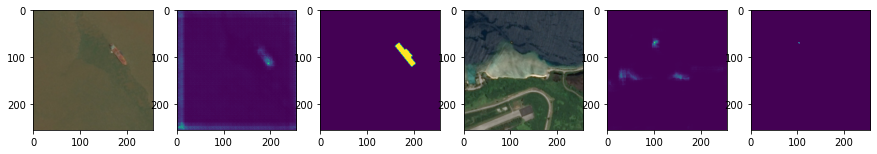

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.6905 - accuracy: 0.9983 - val_loss: 0.0117 - val_dice_loss: 0.6207 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.7018 - accuracy: 0.9983 - val_loss: 0.0120 - val_dice_loss: 0.6258 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.6626 - accuracy: 0.9986 - val_loss: 0.0125 - val_dice_loss: 0.6408 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.6189 - accuracy: 0.9986 - val_loss: 0.0132 - val_dice_loss: 0.6605 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0046 - dice_loss: 0.6124 - accuracy: 0.9987 - val_loss: 0.0140 - val_dice_loss: 0.6790 - val_accuracy: 0.9963


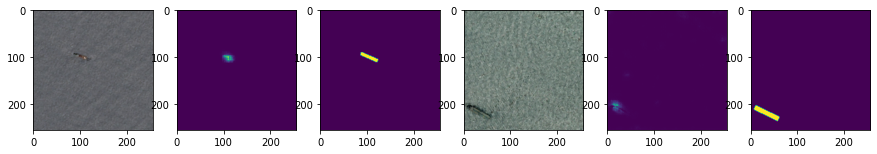

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.5844 - accuracy: 0.9938 - val_loss: 0.0107 - val_dice_loss: 0.5300 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0190 - dice_loss: 0.6142 - accuracy: 0.9937 - val_loss: 0.0098 - val_dice_loss: 0.5052 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.5328 - accuracy: 0.9942 - val_loss: 0.0086 - val_dice_loss: 0.4798 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.5308 - accuracy: 0.9944 - val_loss: 0.0079 - val_dice_loss: 0.4680 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.4723 - accuracy: 0.9952 - val_loss: 0.0074 - val_dice_loss: 0.4629 - val_accuracy: 0.9970


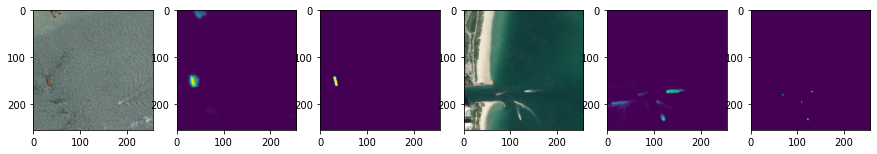

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5465 - accuracy: 0.9956 - val_loss: 0.0057 - val_dice_loss: 0.6153 - val_accuracy: 0.9981
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5323 - accuracy: 0.9960 - val_loss: 0.0067 - val_dice_loss: 0.6510 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5204 - accuracy: 0.9963 - val_loss: 0.0076 - val_dice_loss: 0.6777 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0096 - dice_loss: 0.5158 - accuracy: 0.9963 - val_loss: 0.0081 - val_dice_loss: 0.6834 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.5058 - accuracy: 0.9965 - val_loss: 0.0078 - val_dice_loss: 0.6695 - val_accuracy: 0.9972


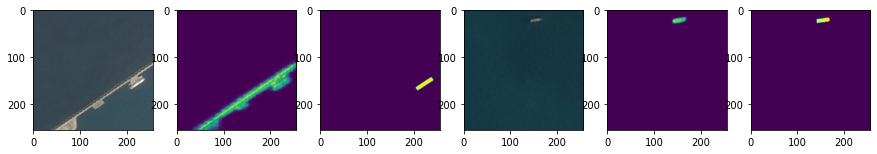

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0185 - dice_loss: 0.7881 - accuracy: 0.9940 - val_loss: 0.0118 - val_dice_loss: 0.7329 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0147 - dice_loss: 0.7298 - accuracy: 0.9949 - val_loss: 0.0108 - val_dice_loss: 0.7203 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.6815 - accuracy: 0.9956 - val_loss: 0.0102 - val_dice_loss: 0.7138 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.7373 - accuracy: 0.9960 - val_loss: 0.0103 - val_dice_loss: 0.7142 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.7345 - accuracy: 0.9963 - val_loss: 0.0106 - val_dice_loss: 0.7130 - val_accuracy: 0.9971


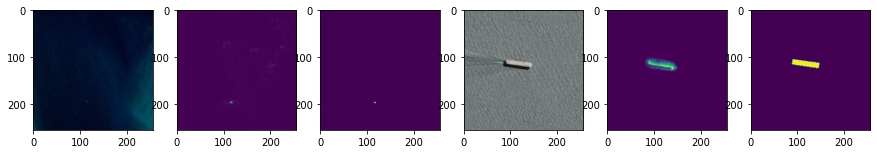

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5603 - accuracy: 0.9973 - val_loss: 0.0142 - val_dice_loss: 0.6049 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.5868 - accuracy: 0.9971 - val_loss: 0.0143 - val_dice_loss: 0.6297 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6054 - accuracy: 0.9972 - val_loss: 0.0138 - val_dice_loss: 0.6414 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0086 - dice_loss: 0.5590 - accuracy: 0.9974 - val_loss: 0.0133 - val_dice_loss: 0.6445 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.5594 - accuracy: 0.9974 - val_loss: 0.0127 - val_dice_loss: 0.6394 - val_accuracy: 0.9961


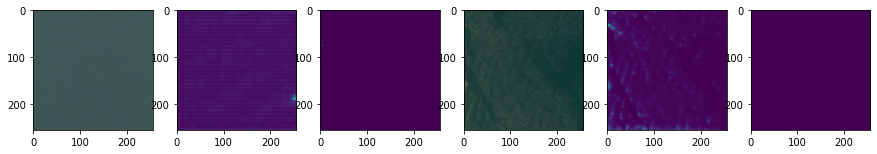

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.6379 - accuracy: 0.9983 - val_loss: 0.0073 - val_dice_loss: 0.6767 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0052 - dice_loss: 0.6702 - accuracy: 0.9984 - val_loss: 0.0074 - val_dice_loss: 0.6778 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.6393 - accuracy: 0.9985 - val_loss: 0.0075 - val_dice_loss: 0.6805 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.6023 - accuracy: 0.9986 - val_loss: 0.0076 - val_dice_loss: 0.6838 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0043 - dice_loss: 0.5939 - accuracy: 0.9987 - val_loss: 0.0077 - val_dice_loss: 0.6874 - val_accuracy: 0.9975


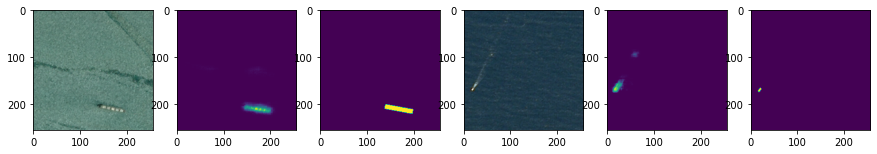

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5591 - accuracy: 0.9963 - val_loss: 0.0109 - val_dice_loss: 0.4896 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5680 - accuracy: 0.9963 - val_loss: 0.0110 - val_dice_loss: 0.4869 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0106 - dice_loss: 0.5764 - accuracy: 0.9962 - val_loss: 0.0109 - val_dice_loss: 0.4821 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.5451 - accuracy: 0.9966 - val_loss: 0.0109 - val_dice_loss: 0.4777 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5886 - accuracy: 0.9968 - val_loss: 0.0108 - val_dice_loss: 0.4736 - val_accuracy: 0.9970


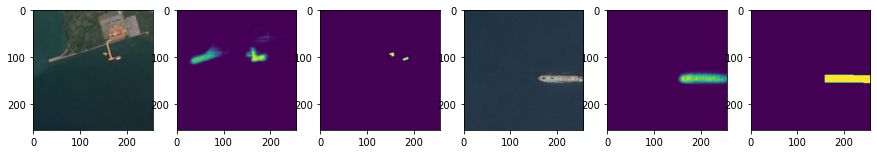

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0133 - dice_loss: 0.5434 - accuracy: 0.9951 - val_loss: 0.0063 - val_dice_loss: 0.7153 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0130 - dice_loss: 0.5294 - accuracy: 0.9951 - val_loss: 0.0067 - val_dice_loss: 0.7170 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.5206 - accuracy: 0.9955 - val_loss: 0.0073 - val_dice_loss: 0.7227 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5150 - accuracy: 0.9959 - val_loss: 0.0079 - val_dice_loss: 0.7308 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0111 - dice_loss: 0.5188 - accuracy: 0.9955 - val_loss: 0.0088 - val_dice_loss: 0.7431 - val_accuracy: 0.9962


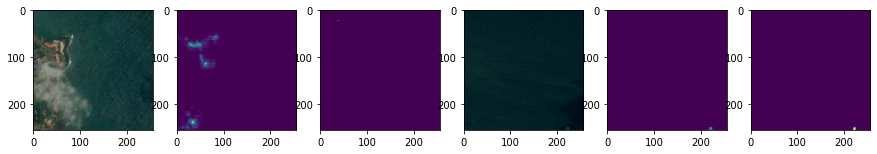

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.6022 - accuracy: 0.9974 - val_loss: 0.0198 - val_dice_loss: 0.6537 - val_accuracy: 0.9926
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.6878 - accuracy: 0.9969 - val_loss: 0.0189 - val_dice_loss: 0.6396 - val_accuracy: 0.9933
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0069 - dice_loss: 0.5547 - accuracy: 0.9978 - val_loss: 0.0181 - val_dice_loss: 0.6261 - val_accuracy: 0.9939
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0067 - dice_loss: 0.5840 - accuracy: 0.9978 - val_loss: 0.0178 - val_dice_loss: 0.6212 - val_accuracy: 0.9940
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.5309 - accuracy: 0.9979 - val_loss: 0.0179 - val_dice_loss: 0.6265 - val_accuracy: 0.9941


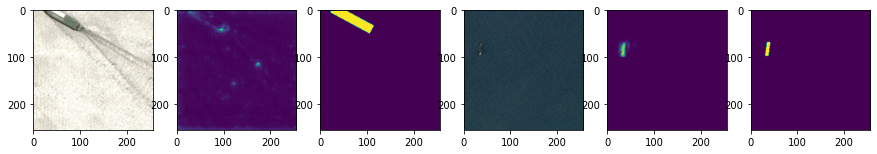

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0107 - dice_loss: 0.5923 - accuracy: 0.9972 - val_loss: 0.0408 - val_dice_loss: 0.5860 - val_accuracy: 0.9899
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.5667 - accuracy: 0.9976 - val_loss: 0.0462 - val_dice_loss: 0.6169 - val_accuracy: 0.9901
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5572 - accuracy: 0.9976 - val_loss: 0.0517 - val_dice_loss: 0.6634 - val_accuracy: 0.9895
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5657 - accuracy: 0.9977 - val_loss: 0.0560 - val_dice_loss: 0.6990 - val_accuracy: 0.9894
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5219 - accuracy: 0.9978 - val_loss: 0.0590 - val_dice_loss: 0.7210 - val_accuracy: 0.9893


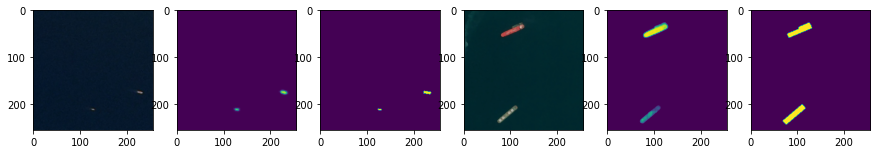

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0186 - dice_loss: 0.6345 - accuracy: 0.9949 - val_loss: 0.0105 - val_dice_loss: 0.6978 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.5607 - accuracy: 0.9956 - val_loss: 0.0106 - val_dice_loss: 0.6902 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.5399 - accuracy: 0.9956 - val_loss: 0.0107 - val_dice_loss: 0.6846 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.5401 - accuracy: 0.9959 - val_loss: 0.0107 - val_dice_loss: 0.6807 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4878 - accuracy: 0.9960 - val_loss: 0.0104 - val_dice_loss: 0.6751 - val_accuracy: 0.9975


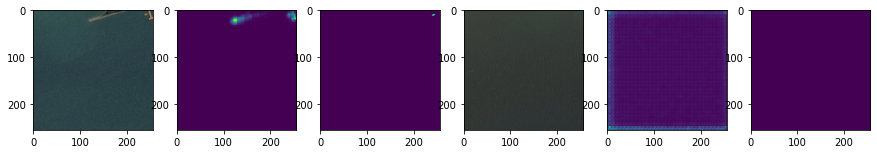

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6344 - accuracy: 0.9962 - val_loss: 0.0151 - val_dice_loss: 0.6925 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6024 - accuracy: 0.9963 - val_loss: 0.0141 - val_dice_loss: 0.6933 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.6070 - accuracy: 0.9964 - val_loss: 0.0134 - val_dice_loss: 0.6952 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6064 - accuracy: 0.9963 - val_loss: 0.0129 - val_dice_loss: 0.7012 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5918 - accuracy: 0.9967 - val_loss: 0.0127 - val_dice_loss: 0.7066 - val_accuracy: 0.9970


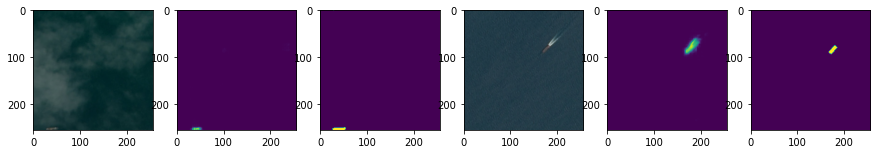

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5309 - accuracy: 0.9966 - val_loss: 0.0144 - val_dice_loss: 0.6778 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.5246 - accuracy: 0.9969 - val_loss: 0.0145 - val_dice_loss: 0.6860 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5035 - accuracy: 0.9970 - val_loss: 0.0146 - val_dice_loss: 0.6919 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5326 - accuracy: 0.9969 - val_loss: 0.0146 - val_dice_loss: 0.6944 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.4781 - accuracy: 0.9970 - val_loss: 0.0146 - val_dice_loss: 0.6957 - val_accuracy: 0.9944


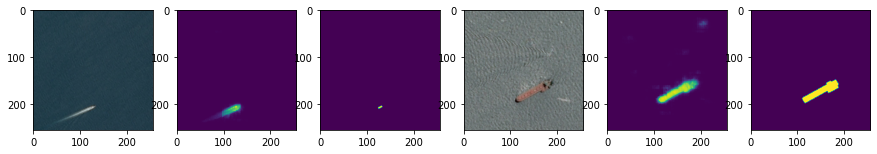

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.6769 - accuracy: 0.9952 - val_loss: 0.0120 - val_dice_loss: 0.6197 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6001 - accuracy: 0.9958 - val_loss: 0.0119 - val_dice_loss: 0.6183 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.6074 - accuracy: 0.9961 - val_loss: 0.0121 - val_dice_loss: 0.6189 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5750 - accuracy: 0.9967 - val_loss: 0.0120 - val_dice_loss: 0.6199 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5397 - accuracy: 0.9969 - val_loss: 0.0121 - val_dice_loss: 0.6224 - val_accuracy: 0.9963


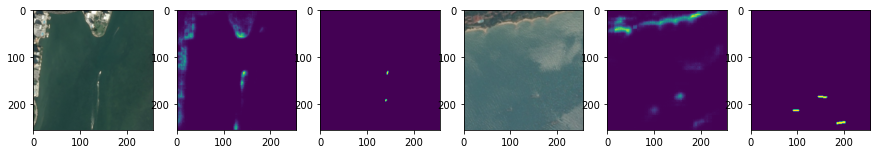

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0117 - dice_loss: 0.6516 - accuracy: 0.9965 - val_loss: 0.0094 - val_dice_loss: 0.6752 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0119 - dice_loss: 0.6861 - accuracy: 0.9966 - val_loss: 0.0093 - val_dice_loss: 0.6729 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6592 - accuracy: 0.9966 - val_loss: 0.0094 - val_dice_loss: 0.6687 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.6752 - accuracy: 0.9963 - val_loss: 0.0095 - val_dice_loss: 0.6652 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.6681 - accuracy: 0.9964 - val_loss: 0.0092 - val_dice_loss: 0.6600 - val_accuracy: 0.9972


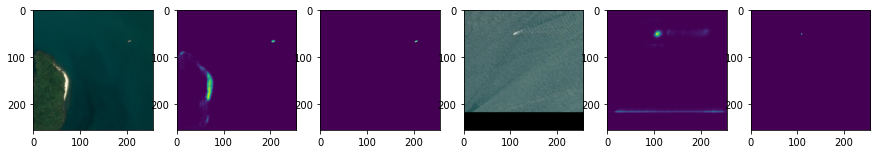

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.7589 - accuracy: 0.9979 - val_loss: 0.0094 - val_dice_loss: 0.5723 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.7487 - accuracy: 0.9979 - val_loss: 0.0091 - val_dice_loss: 0.5640 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.7508 - accuracy: 0.9979 - val_loss: 0.0086 - val_dice_loss: 0.5543 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.7200 - accuracy: 0.9978 - val_loss: 0.0083 - val_dice_loss: 0.5473 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.6978 - accuracy: 0.9979 - val_loss: 0.0080 - val_dice_loss: 0.5439 - val_accuracy: 0.9970


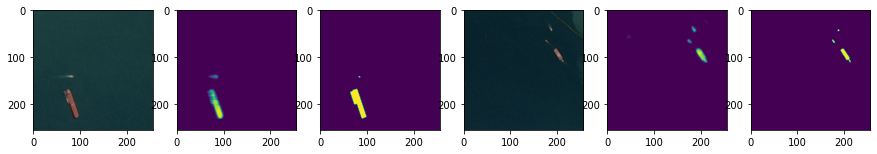

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4514 - accuracy: 0.9959 - val_loss: 0.0113 - val_dice_loss: 0.6350 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4431 - accuracy: 0.9962 - val_loss: 0.0110 - val_dice_loss: 0.6316 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.4206 - accuracy: 0.9966 - val_loss: 0.0108 - val_dice_loss: 0.6265 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.3715 - accuracy: 0.9972 - val_loss: 0.0107 - val_dice_loss: 0.6216 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.3530 - accuracy: 0.9974 - val_loss: 0.0106 - val_dice_loss: 0.6158 - val_accuracy: 0.9966


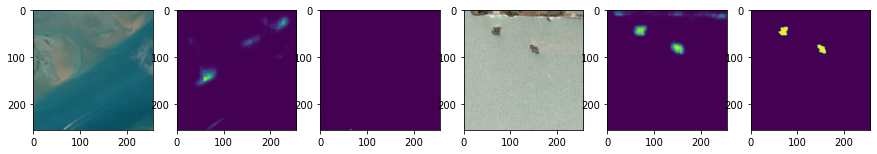

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.4462 - accuracy: 0.9973 - val_loss: 0.0090 - val_dice_loss: 0.5079 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.4668 - accuracy: 0.9977 - val_loss: 0.0090 - val_dice_loss: 0.5065 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.4788 - accuracy: 0.9976 - val_loss: 0.0090 - val_dice_loss: 0.5082 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.4572 - accuracy: 0.9977 - val_loss: 0.0091 - val_dice_loss: 0.5166 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.5109 - accuracy: 0.9974 - val_loss: 0.0095 - val_dice_loss: 0.5340 - val_accuracy: 0.9969


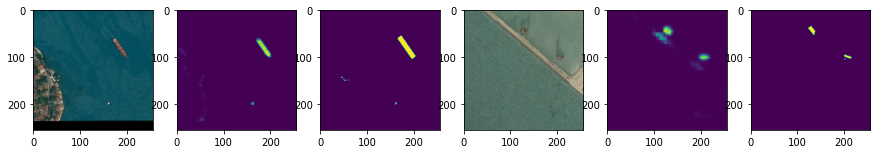

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5409 - accuracy: 0.9962 - val_loss: 0.0136 - val_dice_loss: 0.6120 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4950 - accuracy: 0.9963 - val_loss: 0.0135 - val_dice_loss: 0.6116 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5085 - accuracy: 0.9963 - val_loss: 0.0131 - val_dice_loss: 0.6025 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.4861 - accuracy: 0.9966 - val_loss: 0.0123 - val_dice_loss: 0.5847 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.4648 - accuracy: 0.9968 - val_loss: 0.0118 - val_dice_loss: 0.5694 - val_accuracy: 0.9965


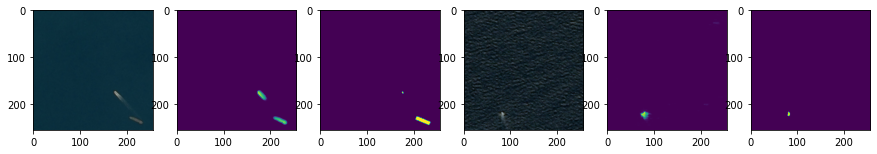

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5005 - accuracy: 0.9979 - val_loss: 0.0069 - val_dice_loss: 0.6490 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.4944 - accuracy: 0.9977 - val_loss: 0.0071 - val_dice_loss: 0.6574 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5412 - accuracy: 0.9977 - val_loss: 0.0073 - val_dice_loss: 0.6644 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5239 - accuracy: 0.9977 - val_loss: 0.0076 - val_dice_loss: 0.6708 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5316 - accuracy: 0.9979 - val_loss: 0.0078 - val_dice_loss: 0.6771 - val_accuracy: 0.9973


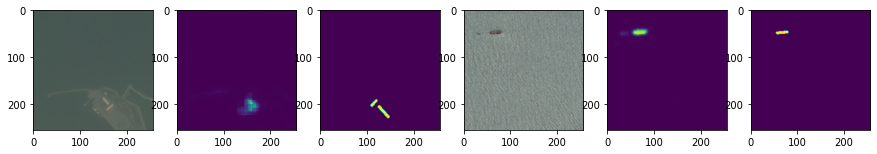

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6591 - accuracy: 0.9978 - val_loss: 0.0055 - val_dice_loss: 0.6451 - val_accuracy: 0.9984
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6677 - accuracy: 0.9977 - val_loss: 0.0055 - val_dice_loss: 0.6513 - val_accuracy: 0.9984
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.6633 - accuracy: 0.9977 - val_loss: 0.0056 - val_dice_loss: 0.6593 - val_accuracy: 0.9984
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.6604 - accuracy: 0.9978 - val_loss: 0.0057 - val_dice_loss: 0.6705 - val_accuracy: 0.9984
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.6689 - accuracy: 0.9979 - val_loss: 0.0058 - val_dice_loss: 0.6815 - val_accuracy: 0.9984


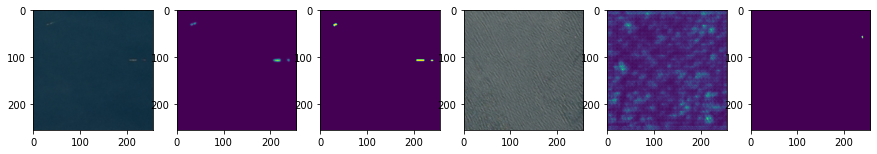

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.5948 - accuracy: 0.9955 - val_loss: 0.0082 - val_dice_loss: 0.6371 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.5602 - accuracy: 0.9950 - val_loss: 0.0081 - val_dice_loss: 0.6317 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.5432 - accuracy: 0.9954 - val_loss: 0.0078 - val_dice_loss: 0.6233 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4854 - accuracy: 0.9958 - val_loss: 0.0076 - val_dice_loss: 0.6163 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.4608 - accuracy: 0.9960 - val_loss: 0.0073 - val_dice_loss: 0.6094 - val_accuracy: 0.9973


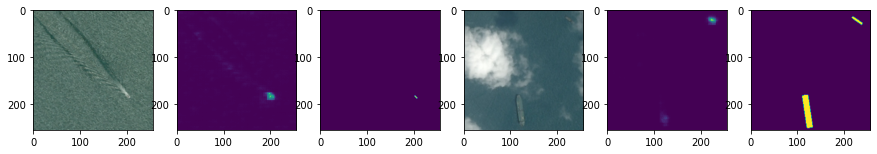

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0165 - dice_loss: 0.6565 - accuracy: 0.9952 - val_loss: 0.0106 - val_dice_loss: 0.4775 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0178 - dice_loss: 0.7000 - accuracy: 0.9952 - val_loss: 0.0105 - val_dice_loss: 0.4736 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0176 - dice_loss: 0.6250 - accuracy: 0.9951 - val_loss: 0.0104 - val_dice_loss: 0.4712 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0141 - dice_loss: 0.6293 - accuracy: 0.9954 - val_loss: 0.0104 - val_dice_loss: 0.4700 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0145 - dice_loss: 0.6154 - accuracy: 0.9953 - val_loss: 0.0103 - val_dice_loss: 0.4677 - val_accuracy: 0.9969


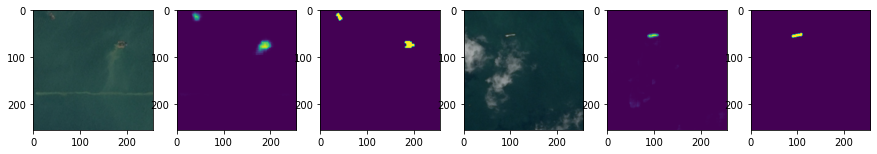

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.7069 - accuracy: 0.9958 - val_loss: 0.0081 - val_dice_loss: 0.6116 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6943 - accuracy: 0.9962 - val_loss: 0.0079 - val_dice_loss: 0.6024 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6396 - accuracy: 0.9970 - val_loss: 0.0077 - val_dice_loss: 0.5956 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.6469 - accuracy: 0.9975 - val_loss: 0.0076 - val_dice_loss: 0.5914 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.6074 - accuracy: 0.9982 - val_loss: 0.0075 - val_dice_loss: 0.5913 - val_accuracy: 0.9969


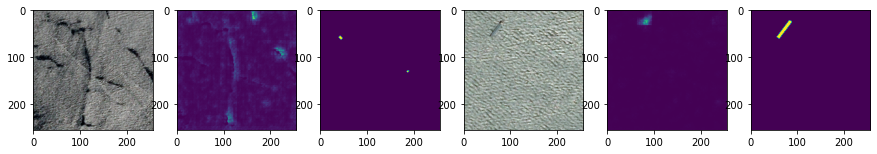

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.7154 - accuracy: 0.9954 - val_loss: 0.0226 - val_dice_loss: 0.8371 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.7465 - accuracy: 0.9950 - val_loss: 0.0224 - val_dice_loss: 0.8382 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.7397 - accuracy: 0.9951 - val_loss: 0.0219 - val_dice_loss: 0.8425 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.7241 - accuracy: 0.9955 - val_loss: 0.0217 - val_dice_loss: 0.8490 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.6734 - accuracy: 0.9954 - val_loss: 0.0217 - val_dice_loss: 0.8556 - val_accuracy: 0.9948


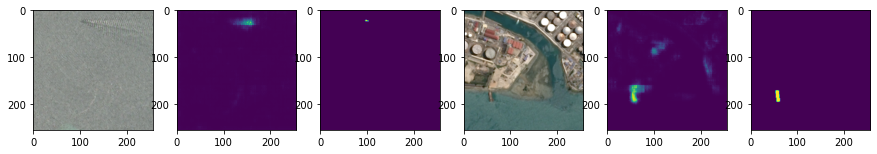

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.5996 - accuracy: 0.9955 - val_loss: 0.0149 - val_dice_loss: 0.5401 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5665 - accuracy: 0.9957 - val_loss: 0.0151 - val_dice_loss: 0.5429 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5612 - accuracy: 0.9957 - val_loss: 0.0153 - val_dice_loss: 0.5431 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5398 - accuracy: 0.9960 - val_loss: 0.0155 - val_dice_loss: 0.5416 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5254 - accuracy: 0.9962 - val_loss: 0.0157 - val_dice_loss: 0.5401 - val_accuracy: 0.9946


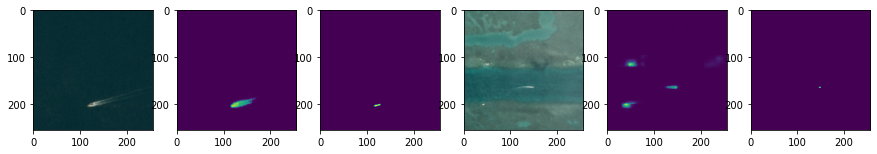

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6439 - accuracy: 0.9956 - val_loss: 0.0142 - val_dice_loss: 0.5906 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5987 - accuracy: 0.9959 - val_loss: 0.0147 - val_dice_loss: 0.5906 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.5993 - accuracy: 0.9962 - val_loss: 0.0155 - val_dice_loss: 0.5994 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5591 - accuracy: 0.9964 - val_loss: 0.0168 - val_dice_loss: 0.6172 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5682 - accuracy: 0.9965 - val_loss: 0.0179 - val_dice_loss: 0.6342 - val_accuracy: 0.9953


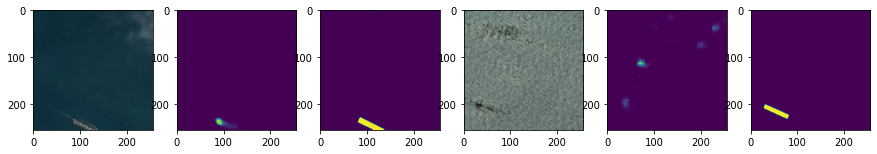

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0140 - dice_loss: 0.6381 - accuracy: 0.9961 - val_loss: 0.0141 - val_dice_loss: 0.6319 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0141 - dice_loss: 0.6734 - accuracy: 0.9958 - val_loss: 0.0141 - val_dice_loss: 0.6356 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0124 - dice_loss: 0.6040 - accuracy: 0.9964 - val_loss: 0.0138 - val_dice_loss: 0.6371 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5942 - accuracy: 0.9966 - val_loss: 0.0136 - val_dice_loss: 0.6427 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6099 - accuracy: 0.9964 - val_loss: 0.0135 - val_dice_loss: 0.6518 - val_accuracy: 0.9960


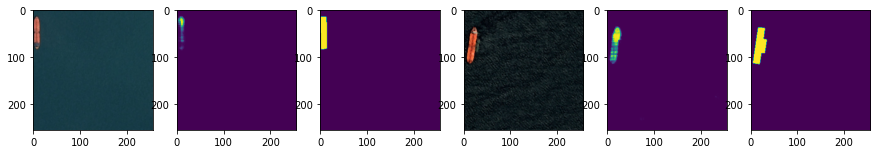

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0114 - dice_loss: 0.6441 - accuracy: 0.9958 - val_loss: 0.0147 - val_dice_loss: 0.5424 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5833 - accuracy: 0.9961 - val_loss: 0.0141 - val_dice_loss: 0.5227 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5505 - accuracy: 0.9963 - val_loss: 0.0142 - val_dice_loss: 0.5168 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.4794 - accuracy: 0.9969 - val_loss: 0.0150 - val_dice_loss: 0.5313 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.4986 - accuracy: 0.9967 - val_loss: 0.0160 - val_dice_loss: 0.5571 - val_accuracy: 0.9944


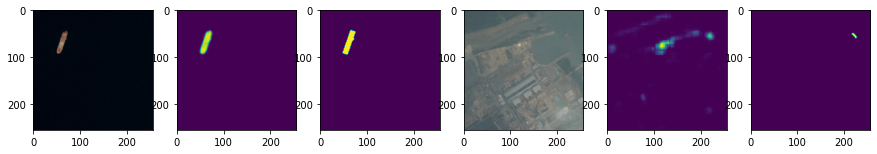

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.5870 - accuracy: 0.9963 - val_loss: 0.0117 - val_dice_loss: 0.4731 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.6170 - accuracy: 0.9957 - val_loss: 0.0112 - val_dice_loss: 0.4672 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5620 - accuracy: 0.9970 - val_loss: 0.0107 - val_dice_loss: 0.4601 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5577 - accuracy: 0.9972 - val_loss: 0.0105 - val_dice_loss: 0.4561 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5295 - accuracy: 0.9973 - val_loss: 0.0106 - val_dice_loss: 0.4567 - val_accuracy: 0.9967


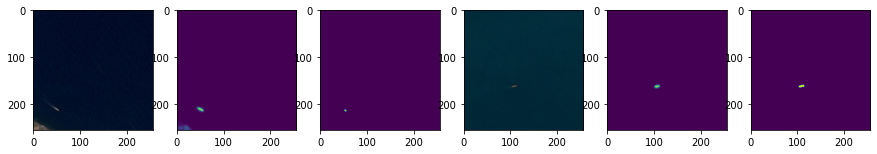

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.6485 - accuracy: 0.9953 - val_loss: 0.0100 - val_dice_loss: 0.6022 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.6629 - accuracy: 0.9950 - val_loss: 0.0101 - val_dice_loss: 0.6055 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.6640 - accuracy: 0.9953 - val_loss: 0.0102 - val_dice_loss: 0.6082 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.6442 - accuracy: 0.9950 - val_loss: 0.0103 - val_dice_loss: 0.6141 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.6064 - accuracy: 0.9958 - val_loss: 0.0105 - val_dice_loss: 0.6217 - val_accuracy: 0.9970


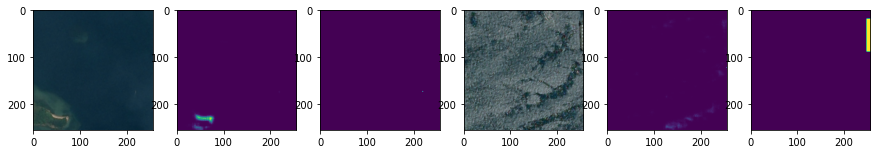

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5839 - accuracy: 0.9960 - val_loss: 0.0124 - val_dice_loss: 0.5780 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.5655 - accuracy: 0.9961 - val_loss: 0.0124 - val_dice_loss: 0.5792 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5397 - accuracy: 0.9966 - val_loss: 0.0125 - val_dice_loss: 0.5771 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5342 - accuracy: 0.9962 - val_loss: 0.0128 - val_dice_loss: 0.5758 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.4980 - accuracy: 0.9970 - val_loss: 0.0131 - val_dice_loss: 0.5786 - val_accuracy: 0.9961


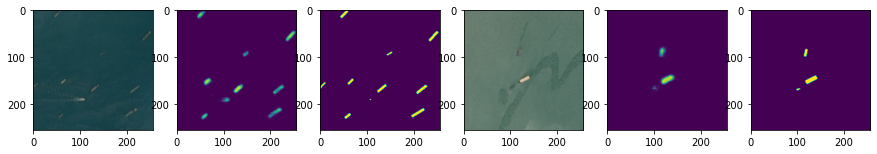

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5115 - accuracy: 0.9971 - val_loss: 0.0110 - val_dice_loss: 0.5797 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.4856 - accuracy: 0.9969 - val_loss: 0.0110 - val_dice_loss: 0.5806 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.4769 - accuracy: 0.9971 - val_loss: 0.0113 - val_dice_loss: 0.5835 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.4416 - accuracy: 0.9968 - val_loss: 0.0115 - val_dice_loss: 0.5834 - val_accuracy: 0.9956
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4494 - accuracy: 0.9972 - val_loss: 0.0116 - val_dice_loss: 0.5815 - val_accuracy: 0.9956


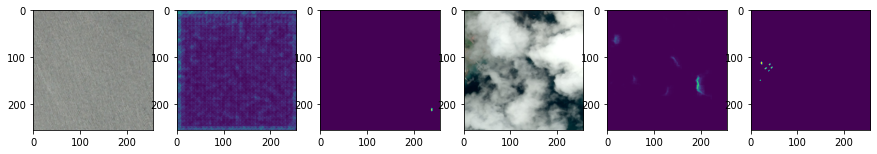

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.7370 - accuracy: 0.9937 - val_loss: 0.0129 - val_dice_loss: 0.5307 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.6355 - accuracy: 0.9957 - val_loss: 0.0115 - val_dice_loss: 0.5087 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5649 - accuracy: 0.9958 - val_loss: 0.0107 - val_dice_loss: 0.4940 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5363 - accuracy: 0.9962 - val_loss: 0.0102 - val_dice_loss: 0.4845 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5765 - accuracy: 0.9958 - val_loss: 0.0100 - val_dice_loss: 0.4803 - val_accuracy: 0.9968


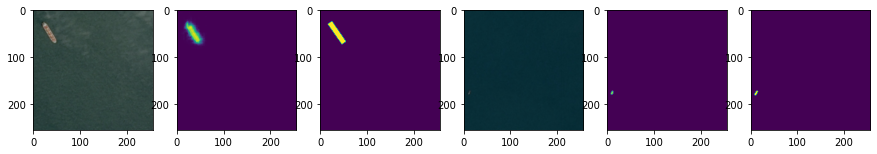

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0191 - dice_loss: 0.5639 - accuracy: 0.9925 - val_loss: 0.0170 - val_dice_loss: 0.6904 - val_accuracy: 0.9929
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.5349 - accuracy: 0.9936 - val_loss: 0.0155 - val_dice_loss: 0.6725 - val_accuracy: 0.9935
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.5050 - accuracy: 0.9959 - val_loss: 0.0143 - val_dice_loss: 0.6527 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.5291 - accuracy: 0.9958 - val_loss: 0.0132 - val_dice_loss: 0.6350 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0132 - dice_loss: 0.4842 - accuracy: 0.9962 - val_loss: 0.0128 - val_dice_loss: 0.6275 - val_accuracy: 0.9954


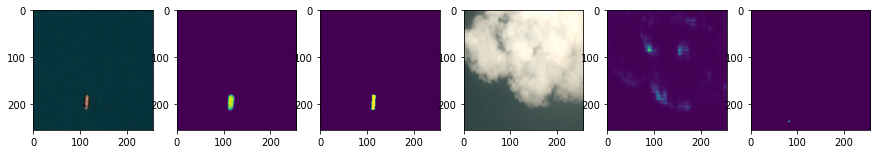

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0139 - dice_loss: 0.6376 - accuracy: 0.9951 - val_loss: 0.0094 - val_dice_loss: 0.6013 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5549 - accuracy: 0.9953 - val_loss: 0.0095 - val_dice_loss: 0.6030 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.5708 - accuracy: 0.9954 - val_loss: 0.0096 - val_dice_loss: 0.6135 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5568 - accuracy: 0.9954 - val_loss: 0.0103 - val_dice_loss: 0.6343 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5405 - accuracy: 0.9958 - val_loss: 0.0114 - val_dice_loss: 0.6593 - val_accuracy: 0.9954


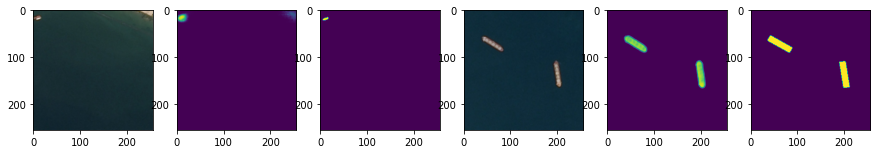

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.5480 - accuracy: 0.9948 - val_loss: 0.0147 - val_dice_loss: 0.6932 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.5766 - accuracy: 0.9939 - val_loss: 0.0142 - val_dice_loss: 0.6850 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.5756 - accuracy: 0.9947 - val_loss: 0.0134 - val_dice_loss: 0.6709 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.5442 - accuracy: 0.9950 - val_loss: 0.0130 - val_dice_loss: 0.6617 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.5333 - accuracy: 0.9952 - val_loss: 0.0126 - val_dice_loss: 0.6528 - val_accuracy: 0.9954


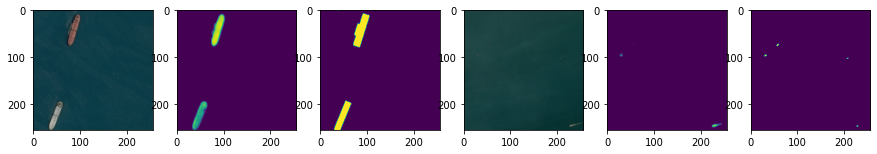

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.5451 - accuracy: 0.9976 - val_loss: 0.0123 - val_dice_loss: 0.4316 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.5155 - accuracy: 0.9977 - val_loss: 0.0122 - val_dice_loss: 0.4289 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5160 - accuracy: 0.9979 - val_loss: 0.0125 - val_dice_loss: 0.4376 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4801 - accuracy: 0.9979 - val_loss: 0.0132 - val_dice_loss: 0.4592 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.4760 - accuracy: 0.9979 - val_loss: 0.0141 - val_dice_loss: 0.4875 - val_accuracy: 0.9950


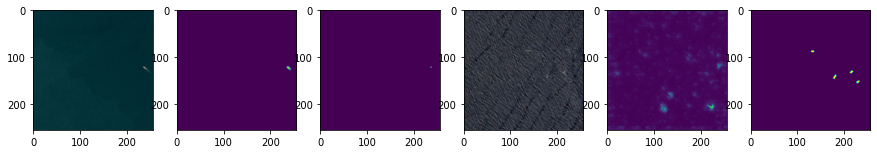

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5716 - accuracy: 0.9962 - val_loss: 0.0064 - val_dice_loss: 0.4617 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5662 - accuracy: 0.9962 - val_loss: 0.0065 - val_dice_loss: 0.4696 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5494 - accuracy: 0.9963 - val_loss: 0.0064 - val_dice_loss: 0.4655 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5509 - accuracy: 0.9966 - val_loss: 0.0064 - val_dice_loss: 0.4610 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5476 - accuracy: 0.9962 - val_loss: 0.0064 - val_dice_loss: 0.4547 - val_accuracy: 0.9977


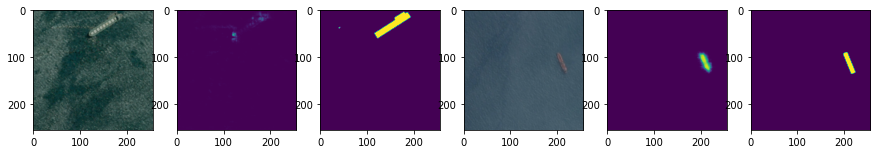

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.5090 - accuracy: 0.9973 - val_loss: 0.0181 - val_dice_loss: 0.5768 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.5046 - accuracy: 0.9974 - val_loss: 0.0171 - val_dice_loss: 0.5566 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.5714 - accuracy: 0.9974 - val_loss: 0.0159 - val_dice_loss: 0.5322 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.5093 - accuracy: 0.9976 - val_loss: 0.0150 - val_dice_loss: 0.5132 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.4668 - accuracy: 0.9975 - val_loss: 0.0144 - val_dice_loss: 0.5037 - val_accuracy: 0.9954


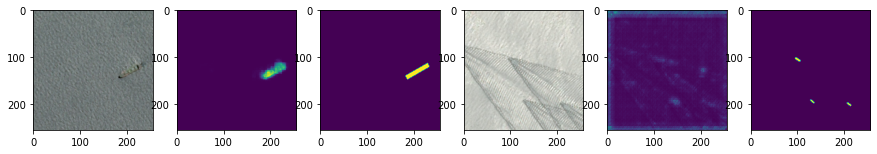

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.6807 - accuracy: 0.9951 - val_loss: 0.0070 - val_dice_loss: 0.5054 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.6334 - accuracy: 0.9958 - val_loss: 0.0069 - val_dice_loss: 0.5060 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6664 - accuracy: 0.9954 - val_loss: 0.0068 - val_dice_loss: 0.5095 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.6861 - accuracy: 0.9955 - val_loss: 0.0067 - val_dice_loss: 0.5157 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.6171 - accuracy: 0.9963 - val_loss: 0.0068 - val_dice_loss: 0.5269 - val_accuracy: 0.9972


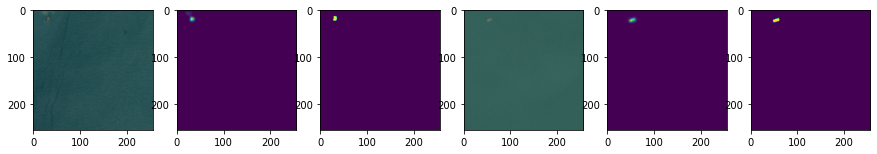

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.5770 - accuracy: 0.9958 - val_loss: 0.0316 - val_dice_loss: 0.5806 - val_accuracy: 0.9936
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5204 - accuracy: 0.9964 - val_loss: 0.0326 - val_dice_loss: 0.5871 - val_accuracy: 0.9937
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.4694 - accuracy: 0.9968 - val_loss: 0.0342 - val_dice_loss: 0.5914 - val_accuracy: 0.9938
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5009 - accuracy: 0.9966 - val_loss: 0.0356 - val_dice_loss: 0.5927 - val_accuracy: 0.9937
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.4478 - accuracy: 0.9969 - val_loss: 0.0368 - val_dice_loss: 0.5954 - val_accuracy: 0.9937


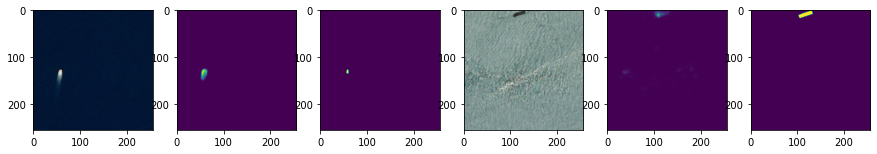

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.5774 - accuracy: 0.9956 - val_loss: 0.0208 - val_dice_loss: 0.5691 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.4942 - accuracy: 0.9956 - val_loss: 0.0204 - val_dice_loss: 0.5632 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5025 - accuracy: 0.9960 - val_loss: 0.0201 - val_dice_loss: 0.5571 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.4803 - accuracy: 0.9960 - val_loss: 0.0199 - val_dice_loss: 0.5540 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5104 - accuracy: 0.9959 - val_loss: 0.0200 - val_dice_loss: 0.5535 - val_accuracy: 0.9942


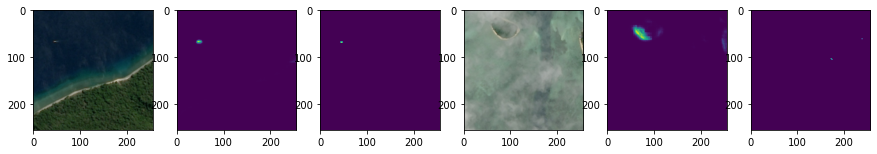

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0107 - dice_loss: 0.5078 - accuracy: 0.9969 - val_loss: 0.0120 - val_dice_loss: 0.6624 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.4741 - accuracy: 0.9966 - val_loss: 0.0121 - val_dice_loss: 0.6646 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.4773 - accuracy: 0.9968 - val_loss: 0.0124 - val_dice_loss: 0.6705 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4758 - accuracy: 0.9969 - val_loss: 0.0127 - val_dice_loss: 0.6768 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5864 - accuracy: 0.9970 - val_loss: 0.0132 - val_dice_loss: 0.6867 - val_accuracy: 0.9949


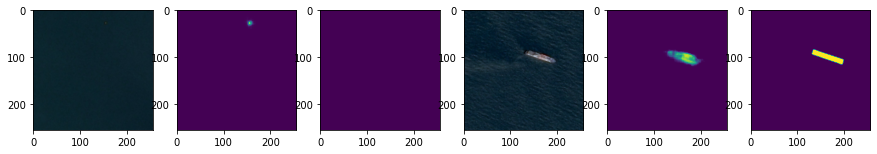

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.4922 - accuracy: 0.9964 - val_loss: 0.0119 - val_dice_loss: 0.6268 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5017 - accuracy: 0.9962 - val_loss: 0.0123 - val_dice_loss: 0.6343 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5042 - accuracy: 0.9969 - val_loss: 0.0124 - val_dice_loss: 0.6361 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.4547 - accuracy: 0.9969 - val_loss: 0.0121 - val_dice_loss: 0.6286 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5369 - accuracy: 0.9967 - val_loss: 0.0116 - val_dice_loss: 0.6188 - val_accuracy: 0.9953


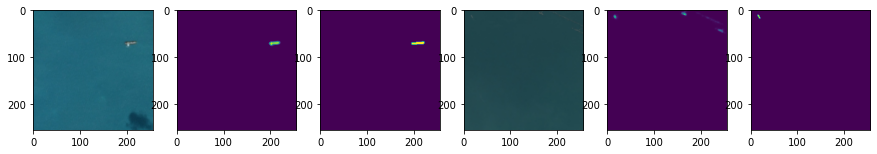

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.6075 - accuracy: 0.9960 - val_loss: 0.0119 - val_dice_loss: 0.5474 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5469 - accuracy: 0.9969 - val_loss: 0.0113 - val_dice_loss: 0.5232 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5034 - accuracy: 0.9970 - val_loss: 0.0109 - val_dice_loss: 0.5056 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.4500 - accuracy: 0.9976 - val_loss: 0.0109 - val_dice_loss: 0.5044 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.4684 - accuracy: 0.9975 - val_loss: 0.0112 - val_dice_loss: 0.5141 - val_accuracy: 0.9968


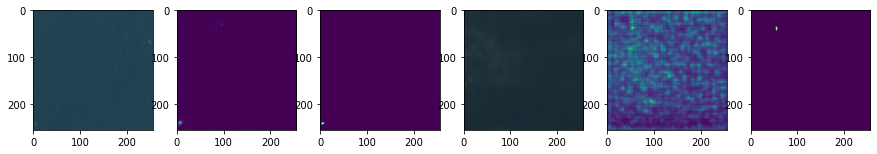

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.5966 - accuracy: 0.9961 - val_loss: 0.0120 - val_dice_loss: 0.7203 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5271 - accuracy: 0.9963 - val_loss: 0.0116 - val_dice_loss: 0.7064 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5282 - accuracy: 0.9961 - val_loss: 0.0110 - val_dice_loss: 0.6791 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5273 - accuracy: 0.9962 - val_loss: 0.0106 - val_dice_loss: 0.6588 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5003 - accuracy: 0.9964 - val_loss: 0.0103 - val_dice_loss: 0.6410 - val_accuracy: 0.9972


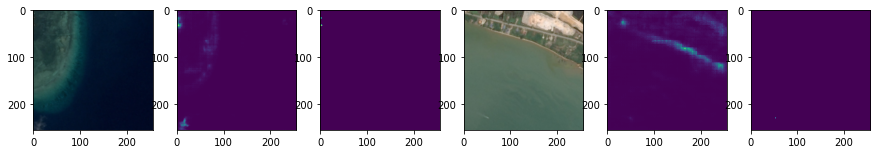

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.4865 - accuracy: 0.9976 - val_loss: 0.0131 - val_dice_loss: 0.5884 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.4565 - accuracy: 0.9978 - val_loss: 0.0127 - val_dice_loss: 0.5853 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.4373 - accuracy: 0.9980 - val_loss: 0.0124 - val_dice_loss: 0.5830 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.4150 - accuracy: 0.9981 - val_loss: 0.0123 - val_dice_loss: 0.5816 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.4297 - accuracy: 0.9984 - val_loss: 0.0122 - val_dice_loss: 0.5808 - val_accuracy: 0.9964


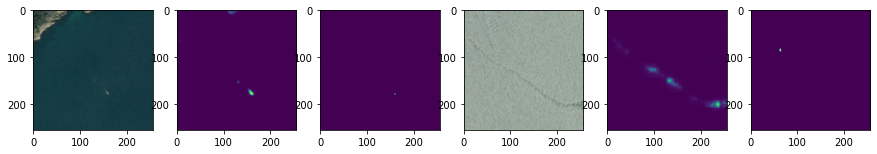

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5801 - accuracy: 0.9962 - val_loss: 0.0060 - val_dice_loss: 0.5624 - val_accuracy: 0.9981
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5448 - accuracy: 0.9966 - val_loss: 0.0059 - val_dice_loss: 0.5628 - val_accuracy: 0.9981
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5480 - accuracy: 0.9963 - val_loss: 0.0058 - val_dice_loss: 0.5638 - val_accuracy: 0.9982
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5476 - accuracy: 0.9964 - val_loss: 0.0057 - val_dice_loss: 0.5659 - val_accuracy: 0.9981
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5248 - accuracy: 0.9967 - val_loss: 0.0057 - val_dice_loss: 0.5691 - val_accuracy: 0.9981


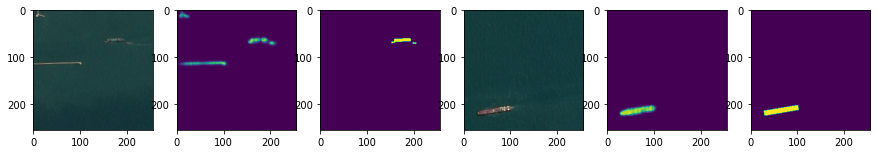

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.4683 - accuracy: 0.9961 - val_loss: 0.0108 - val_dice_loss: 0.5538 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.4438 - accuracy: 0.9963 - val_loss: 0.0111 - val_dice_loss: 0.5634 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0098 - dice_loss: 0.4605 - accuracy: 0.9961 - val_loss: 0.0112 - val_dice_loss: 0.5684 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.4298 - accuracy: 0.9965 - val_loss: 0.0113 - val_dice_loss: 0.5721 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.4271 - accuracy: 0.9969 - val_loss: 0.0113 - val_dice_loss: 0.5732 - val_accuracy: 0.9961


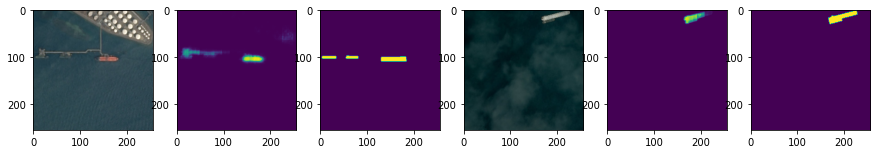

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0076 - dice_loss: 0.6092 - accuracy: 0.9976 - val_loss: 0.0149 - val_dice_loss: 0.6179 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.5856 - accuracy: 0.9977 - val_loss: 0.0148 - val_dice_loss: 0.6156 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.5632 - accuracy: 0.9981 - val_loss: 0.0146 - val_dice_loss: 0.6120 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0069 - dice_loss: 0.5828 - accuracy: 0.9979 - val_loss: 0.0145 - val_dice_loss: 0.6086 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0068 - dice_loss: 0.5712 - accuracy: 0.9977 - val_loss: 0.0144 - val_dice_loss: 0.6060 - val_accuracy: 0.9943


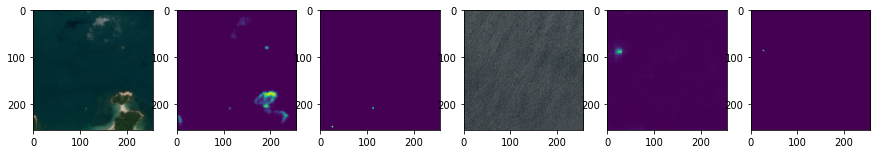

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.6263 - accuracy: 0.9961 - val_loss: 0.0087 - val_dice_loss: 0.5250 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.5954 - accuracy: 0.9959 - val_loss: 0.0086 - val_dice_loss: 0.5212 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.6368 - accuracy: 0.9964 - val_loss: 0.0086 - val_dice_loss: 0.5197 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5566 - accuracy: 0.9960 - val_loss: 0.0086 - val_dice_loss: 0.5208 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0120 - dice_loss: 0.5762 - accuracy: 0.9965 - val_loss: 0.0086 - val_dice_loss: 0.5200 - val_accuracy: 0.9967


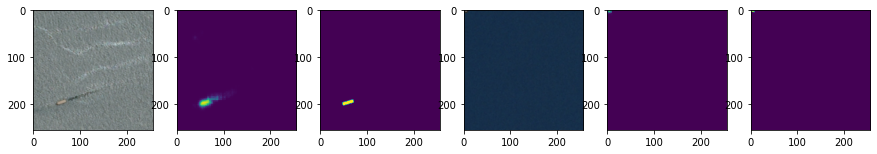

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.5428 - accuracy: 0.9980 - val_loss: 0.0114 - val_dice_loss: 0.5148 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0071 - dice_loss: 0.5757 - accuracy: 0.9981 - val_loss: 0.0115 - val_dice_loss: 0.5146 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.5021 - accuracy: 0.9978 - val_loss: 0.0116 - val_dice_loss: 0.5148 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.5419 - accuracy: 0.9981 - val_loss: 0.0116 - val_dice_loss: 0.5156 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0064 - dice_loss: 0.5226 - accuracy: 0.9980 - val_loss: 0.0117 - val_dice_loss: 0.5163 - val_accuracy: 0.9965


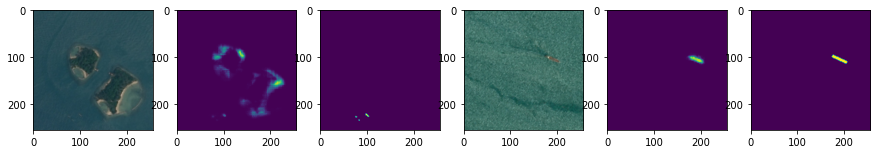

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0059 - dice_loss: 0.4706 - accuracy: 0.9979 - val_loss: 0.0086 - val_dice_loss: 0.5398 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0058 - dice_loss: 0.5578 - accuracy: 0.9978 - val_loss: 0.0085 - val_dice_loss: 0.5359 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0061 - dice_loss: 0.4839 - accuracy: 0.9978 - val_loss: 0.0085 - val_dice_loss: 0.5337 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0057 - dice_loss: 0.5123 - accuracy: 0.9980 - val_loss: 0.0084 - val_dice_loss: 0.5341 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0055 - dice_loss: 0.4296 - accuracy: 0.9980 - val_loss: 0.0085 - val_dice_loss: 0.5377 - val_accuracy: 0.9968


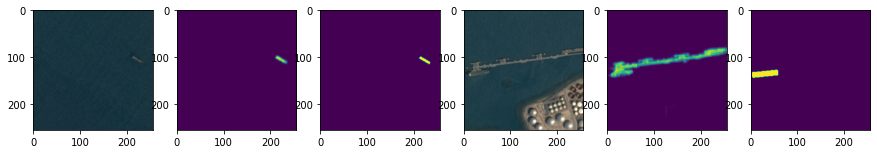

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0123 - dice_loss: 0.6049 - accuracy: 0.9951 - val_loss: 0.0071 - val_dice_loss: 0.7323 - val_accuracy: 0.9981
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.6068 - accuracy: 0.9949 - val_loss: 0.0070 - val_dice_loss: 0.7321 - val_accuracy: 0.9981
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6110 - accuracy: 0.9950 - val_loss: 0.0070 - val_dice_loss: 0.7366 - val_accuracy: 0.9981
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6943 - accuracy: 0.9948 - val_loss: 0.0070 - val_dice_loss: 0.7418 - val_accuracy: 0.9980
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.5615 - accuracy: 0.9960 - val_loss: 0.0071 - val_dice_loss: 0.7496 - val_accuracy: 0.9980


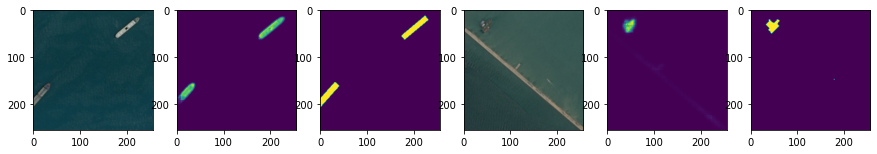

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0107 - dice_loss: 0.4711 - accuracy: 0.9963 - val_loss: 0.0063 - val_dice_loss: 0.4268 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.4962 - accuracy: 0.9961 - val_loss: 0.0063 - val_dice_loss: 0.4290 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.4897 - accuracy: 0.9960 - val_loss: 0.0063 - val_dice_loss: 0.4304 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.4771 - accuracy: 0.9965 - val_loss: 0.0063 - val_dice_loss: 0.4293 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4791 - accuracy: 0.9962 - val_loss: 0.0063 - val_dice_loss: 0.4274 - val_accuracy: 0.9973


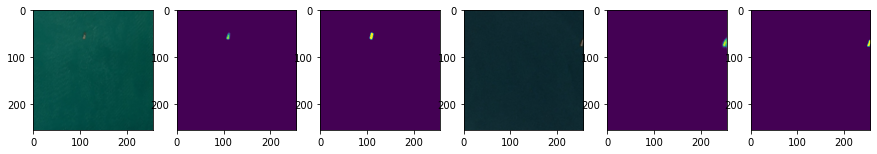

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.5103 - accuracy: 0.9971 - val_loss: 0.0050 - val_dice_loss: 0.6001 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.5192 - accuracy: 0.9970 - val_loss: 0.0050 - val_dice_loss: 0.6001 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5461 - accuracy: 0.9969 - val_loss: 0.0056 - val_dice_loss: 0.6053 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.5544 - accuracy: 0.9970 - val_loss: 0.0062 - val_dice_loss: 0.6093 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0149 - dice_loss: 0.5476 - accuracy: 0.9969 - val_loss: 0.0064 - val_dice_loss: 0.6106 - val_accuracy: 0.9977


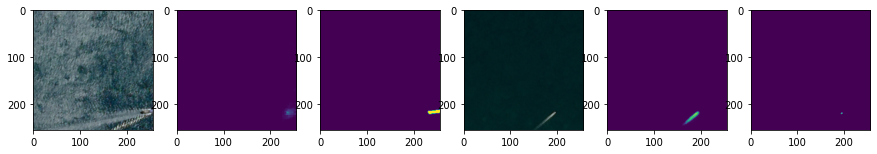

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0089 - dice_loss: 0.6273 - accuracy: 0.9965 - val_loss: 0.0306 - val_dice_loss: 0.7900 - val_accuracy: 0.9931
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.6161 - accuracy: 0.9965 - val_loss: 0.0293 - val_dice_loss: 0.7917 - val_accuracy: 0.9931
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.6018 - accuracy: 0.9971 - val_loss: 0.0283 - val_dice_loss: 0.8012 - val_accuracy: 0.9931
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.6347 - accuracy: 0.9969 - val_loss: 0.0276 - val_dice_loss: 0.8121 - val_accuracy: 0.9931
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.6503 - accuracy: 0.9965 - val_loss: 0.0273 - val_dice_loss: 0.8219 - val_accuracy: 0.9932


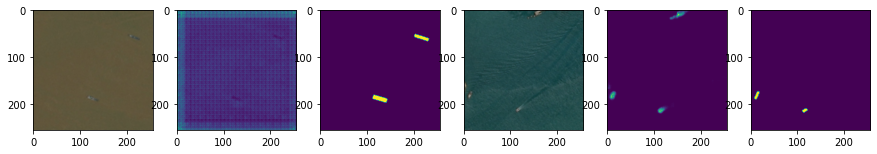

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.6385 - accuracy: 0.9957 - val_loss: 0.0168 - val_dice_loss: 0.7633 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.6428 - accuracy: 0.9956 - val_loss: 0.0164 - val_dice_loss: 0.7446 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.6425 - accuracy: 0.9957 - val_loss: 0.0161 - val_dice_loss: 0.7236 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.6032 - accuracy: 0.9958 - val_loss: 0.0162 - val_dice_loss: 0.7137 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5726 - accuracy: 0.9962 - val_loss: 0.0165 - val_dice_loss: 0.7109 - val_accuracy: 0.9956


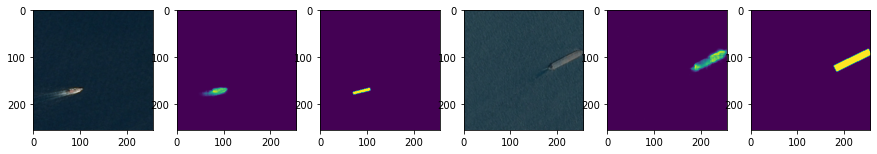

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0169 - dice_loss: 0.4699 - accuracy: 0.9945 - val_loss: 0.0170 - val_dice_loss: 0.7009 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.4290 - accuracy: 0.9958 - val_loss: 0.0173 - val_dice_loss: 0.6945 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.5902 - accuracy: 0.9945 - val_loss: 0.0177 - val_dice_loss: 0.6934 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.4155 - accuracy: 0.9958 - val_loss: 0.0178 - val_dice_loss: 0.6877 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.3933 - accuracy: 0.9963 - val_loss: 0.0173 - val_dice_loss: 0.6772 - val_accuracy: 0.9953


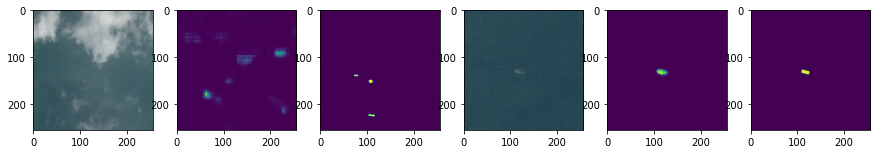

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.6784 - accuracy: 0.9954 - val_loss: 0.0162 - val_dice_loss: 0.7258 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.6462 - accuracy: 0.9971 - val_loss: 0.0158 - val_dice_loss: 0.7215 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5794 - accuracy: 0.9972 - val_loss: 0.0159 - val_dice_loss: 0.7247 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.6508 - accuracy: 0.9973 - val_loss: 0.0165 - val_dice_loss: 0.7355 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5342 - accuracy: 0.9978 - val_loss: 0.0176 - val_dice_loss: 0.7547 - val_accuracy: 0.9959


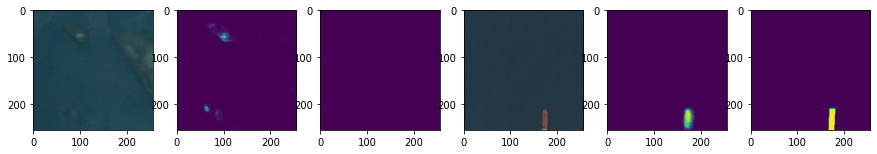

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.6183 - accuracy: 0.9971 - val_loss: 0.0185 - val_dice_loss: 0.6052 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5951 - accuracy: 0.9973 - val_loss: 0.0197 - val_dice_loss: 0.6427 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.7627 - accuracy: 0.9969 - val_loss: 0.0204 - val_dice_loss: 0.6645 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.6240 - accuracy: 0.9971 - val_loss: 0.0201 - val_dice_loss: 0.6523 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.6983 - accuracy: 0.9971 - val_loss: 0.0194 - val_dice_loss: 0.6309 - val_accuracy: 0.9951


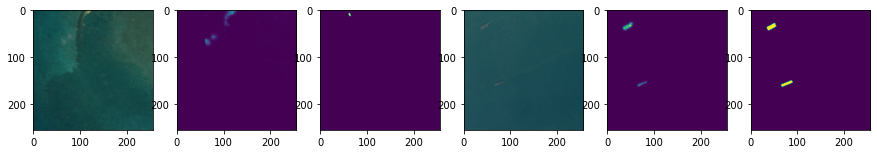

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.5770 - accuracy: 0.9944 - val_loss: 0.0257 - val_dice_loss: 0.6477 - val_accuracy: 0.9932
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.4822 - accuracy: 0.9955 - val_loss: 0.0243 - val_dice_loss: 0.6074 - val_accuracy: 0.9936
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.4689 - accuracy: 0.9959 - val_loss: 0.0234 - val_dice_loss: 0.5743 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.4556 - accuracy: 0.9964 - val_loss: 0.0227 - val_dice_loss: 0.5498 - val_accuracy: 0.9944
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.4670 - accuracy: 0.9967 - val_loss: 0.0219 - val_dice_loss: 0.5305 - val_accuracy: 0.9946


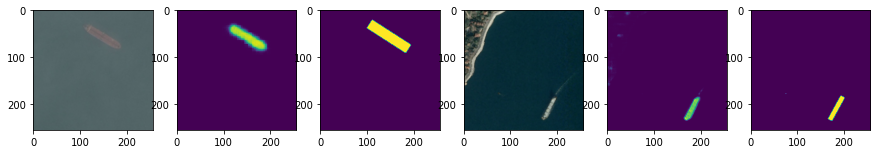

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5341 - accuracy: 0.9951 - val_loss: 0.0117 - val_dice_loss: 0.6458 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.5283 - accuracy: 0.9952 - val_loss: 0.0116 - val_dice_loss: 0.6380 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0125 - dice_loss: 0.5000 - accuracy: 0.9956 - val_loss: 0.0115 - val_dice_loss: 0.6328 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.4766 - accuracy: 0.9956 - val_loss: 0.0115 - val_dice_loss: 0.6331 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.4597 - accuracy: 0.9959 - val_loss: 0.0115 - val_dice_loss: 0.6389 - val_accuracy: 0.9963


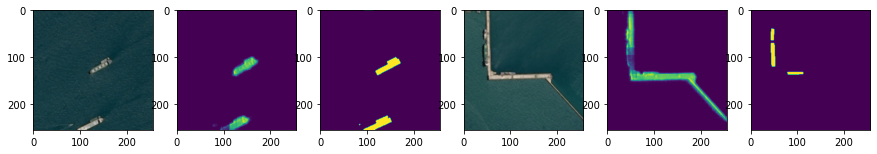

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.6307 - accuracy: 0.9944 - val_loss: 0.0081 - val_dice_loss: 0.5021 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5780 - accuracy: 0.9955 - val_loss: 0.0082 - val_dice_loss: 0.5128 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5079 - accuracy: 0.9965 - val_loss: 0.0085 - val_dice_loss: 0.5283 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.5900 - accuracy: 0.9964 - val_loss: 0.0091 - val_dice_loss: 0.5491 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5492 - accuracy: 0.9965 - val_loss: 0.0095 - val_dice_loss: 0.5657 - val_accuracy: 0.9966


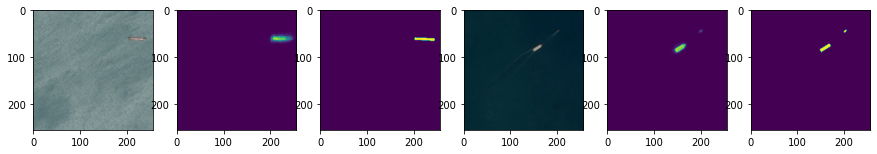

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.6813 - accuracy: 0.9936 - val_loss: 0.0050 - val_dice_loss: 0.6164 - val_accuracy: 0.9981
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.6472 - accuracy: 0.9935 - val_loss: 0.0052 - val_dice_loss: 0.6234 - val_accuracy: 0.9980
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.5523 - accuracy: 0.9951 - val_loss: 0.0058 - val_dice_loss: 0.6364 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.5347 - accuracy: 0.9953 - val_loss: 0.0064 - val_dice_loss: 0.6497 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5048 - accuracy: 0.9957 - val_loss: 0.0068 - val_dice_loss: 0.6560 - val_accuracy: 0.9972


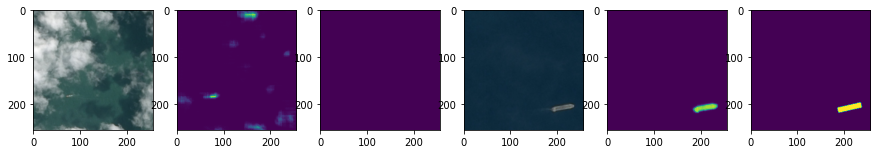

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.6210 - accuracy: 0.9956 - val_loss: 0.0173 - val_dice_loss: 0.4642 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.6030 - accuracy: 0.9957 - val_loss: 0.0172 - val_dice_loss: 0.4705 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.6058 - accuracy: 0.9958 - val_loss: 0.0175 - val_dice_loss: 0.4825 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.5682 - accuracy: 0.9958 - val_loss: 0.0177 - val_dice_loss: 0.4925 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5597 - accuracy: 0.9964 - val_loss: 0.0179 - val_dice_loss: 0.5003 - val_accuracy: 0.9945


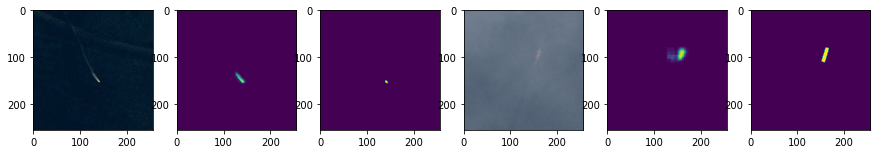

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.5692 - accuracy: 0.9973 - val_loss: 0.0120 - val_dice_loss: 0.6355 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.5872 - accuracy: 0.9970 - val_loss: 0.0117 - val_dice_loss: 0.6349 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.5784 - accuracy: 0.9972 - val_loss: 0.0113 - val_dice_loss: 0.6299 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5680 - accuracy: 0.9973 - val_loss: 0.0110 - val_dice_loss: 0.6211 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.5704 - accuracy: 0.9973 - val_loss: 0.0110 - val_dice_loss: 0.6157 - val_accuracy: 0.9961


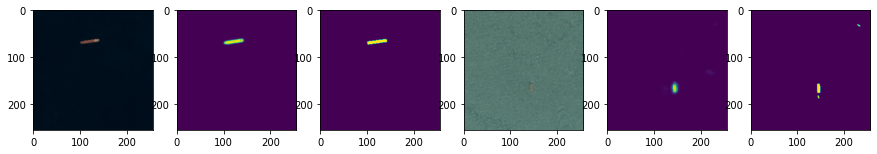

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.5994 - accuracy: 0.9971 - val_loss: 0.0091 - val_dice_loss: 0.6031 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6081 - accuracy: 0.9972 - val_loss: 0.0089 - val_dice_loss: 0.5941 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5778 - accuracy: 0.9974 - val_loss: 0.0087 - val_dice_loss: 0.5868 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5865 - accuracy: 0.9976 - val_loss: 0.0087 - val_dice_loss: 0.5814 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5762 - accuracy: 0.9975 - val_loss: 0.0087 - val_dice_loss: 0.5771 - val_accuracy: 0.9968


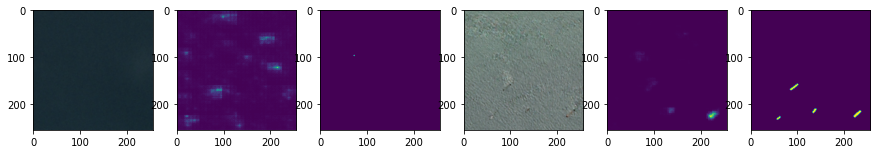

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.5959 - accuracy: 0.9954 - val_loss: 0.0185 - val_dice_loss: 0.6032 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.5886 - accuracy: 0.9956 - val_loss: 0.0195 - val_dice_loss: 0.5980 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.6567 - accuracy: 0.9957 - val_loss: 0.0203 - val_dice_loss: 0.5933 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.6322 - accuracy: 0.9953 - val_loss: 0.0211 - val_dice_loss: 0.5875 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5619 - accuracy: 0.9959 - val_loss: 0.0217 - val_dice_loss: 0.5820 - val_accuracy: 0.9960


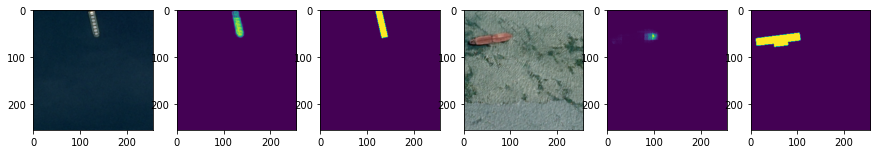

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0174 - dice_loss: 0.6343 - accuracy: 0.9939 - val_loss: 0.0118 - val_dice_loss: 0.5948 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.6132 - accuracy: 0.9946 - val_loss: 0.0120 - val_dice_loss: 0.5852 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.6256 - accuracy: 0.9938 - val_loss: 0.0121 - val_dice_loss: 0.5724 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.6118 - accuracy: 0.9940 - val_loss: 0.0118 - val_dice_loss: 0.5603 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.5730 - accuracy: 0.9945 - val_loss: 0.0115 - val_dice_loss: 0.5575 - val_accuracy: 0.9966


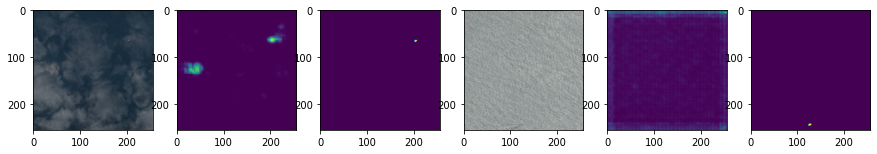

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0163 - dice_loss: 0.5612 - accuracy: 0.9962 - val_loss: 0.0062 - val_dice_loss: 0.5154 - val_accuracy: 0.9982
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.5384 - accuracy: 0.9968 - val_loss: 0.0059 - val_dice_loss: 0.5121 - val_accuracy: 0.9982
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.5312 - accuracy: 0.9967 - val_loss: 0.0057 - val_dice_loss: 0.5141 - val_accuracy: 0.9983
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0135 - dice_loss: 0.4975 - accuracy: 0.9970 - val_loss: 0.0057 - val_dice_loss: 0.5227 - val_accuracy: 0.9983
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5765 - accuracy: 0.9970 - val_loss: 0.0059 - val_dice_loss: 0.5489 - val_accuracy: 0.9983


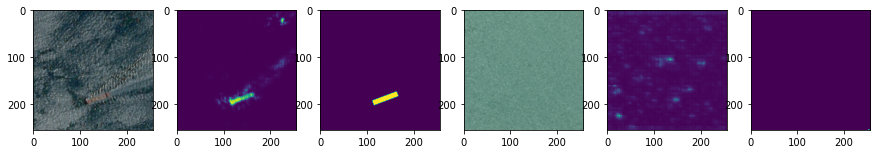

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.7134 - accuracy: 0.9936 - val_loss: 0.0236 - val_dice_loss: 0.6243 - val_accuracy: 0.9930
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0167 - dice_loss: 0.6263 - accuracy: 0.9939 - val_loss: 0.0229 - val_dice_loss: 0.6299 - val_accuracy: 0.9932
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.6718 - accuracy: 0.9933 - val_loss: 0.0220 - val_dice_loss: 0.6331 - val_accuracy: 0.9936
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6400 - accuracy: 0.9945 - val_loss: 0.0211 - val_dice_loss: 0.6307 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.6794 - accuracy: 0.9940 - val_loss: 0.0201 - val_dice_loss: 0.6263 - val_accuracy: 0.9943


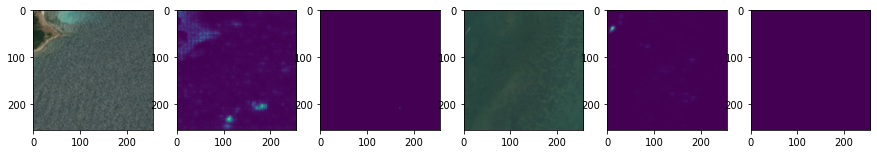

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.6010 - accuracy: 0.9963 - val_loss: 0.0106 - val_dice_loss: 0.6168 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6800 - accuracy: 0.9957 - val_loss: 0.0107 - val_dice_loss: 0.6215 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.6309 - accuracy: 0.9960 - val_loss: 0.0111 - val_dice_loss: 0.6265 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.6324 - accuracy: 0.9962 - val_loss: 0.0117 - val_dice_loss: 0.6319 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.5951 - accuracy: 0.9962 - val_loss: 0.0123 - val_dice_loss: 0.6362 - val_accuracy: 0.9961


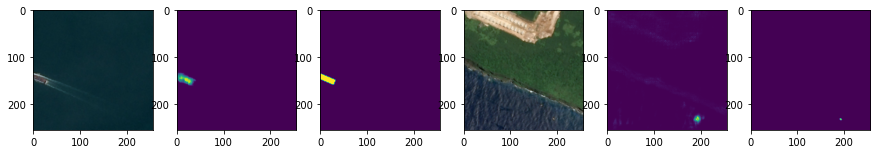

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.6342 - accuracy: 0.9960 - val_loss: 0.0259 - val_dice_loss: 0.6052 - val_accuracy: 0.9931
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.6014 - accuracy: 0.9961 - val_loss: 0.0269 - val_dice_loss: 0.6010 - val_accuracy: 0.9930
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.5210 - accuracy: 0.9968 - val_loss: 0.0282 - val_dice_loss: 0.6011 - val_accuracy: 0.9930
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5609 - accuracy: 0.9964 - val_loss: 0.0298 - val_dice_loss: 0.6018 - val_accuracy: 0.9929
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5080 - accuracy: 0.9970 - val_loss: 0.0314 - val_dice_loss: 0.6013 - val_accuracy: 0.9929


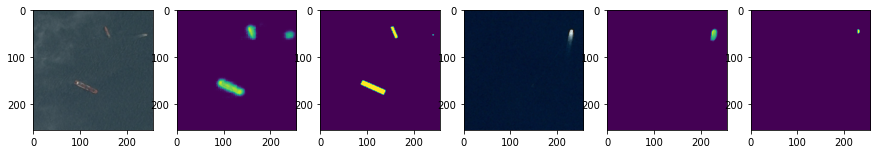

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.6765 - accuracy: 0.9954 - val_loss: 0.0189 - val_dice_loss: 0.5638 - val_accuracy: 0.9944
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.6816 - accuracy: 0.9954 - val_loss: 0.0189 - val_dice_loss: 0.5661 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6862 - accuracy: 0.9958 - val_loss: 0.0188 - val_dice_loss: 0.5706 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.6750 - accuracy: 0.9970 - val_loss: 0.0186 - val_dice_loss: 0.5790 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6621 - accuracy: 0.9974 - val_loss: 0.0186 - val_dice_loss: 0.5905 - val_accuracy: 0.9956


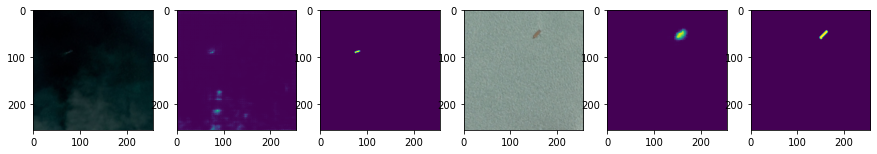

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.6890 - accuracy: 0.9952 - val_loss: 0.0062 - val_dice_loss: 0.5357 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.6597 - accuracy: 0.9956 - val_loss: 0.0064 - val_dice_loss: 0.5450 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.6357 - accuracy: 0.9958 - val_loss: 0.0065 - val_dice_loss: 0.5509 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5513 - accuracy: 0.9963 - val_loss: 0.0067 - val_dice_loss: 0.5522 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5253 - accuracy: 0.9965 - val_loss: 0.0068 - val_dice_loss: 0.5517 - val_accuracy: 0.9971


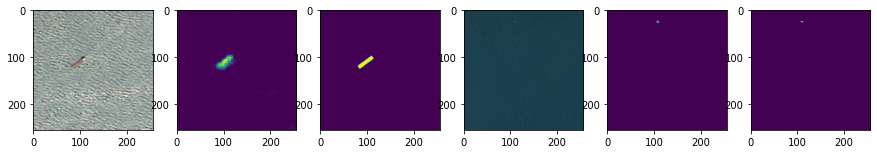

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5803 - accuracy: 0.9954 - val_loss: 0.0103 - val_dice_loss: 0.6411 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.5528 - accuracy: 0.9958 - val_loss: 0.0107 - val_dice_loss: 0.6439 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.5311 - accuracy: 0.9959 - val_loss: 0.0109 - val_dice_loss: 0.6475 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5294 - accuracy: 0.9959 - val_loss: 0.0112 - val_dice_loss: 0.6510 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0117 - dice_loss: 0.5768 - accuracy: 0.9960 - val_loss: 0.0113 - val_dice_loss: 0.6543 - val_accuracy: 0.9964


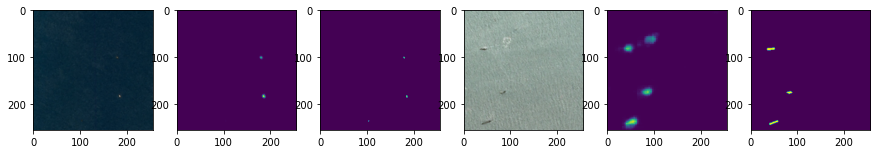

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.7700 - accuracy: 0.9956 - val_loss: 0.0111 - val_dice_loss: 0.6764 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0131 - dice_loss: 0.7645 - accuracy: 0.9958 - val_loss: 0.0106 - val_dice_loss: 0.6710 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.7171 - accuracy: 0.9968 - val_loss: 0.0100 - val_dice_loss: 0.6669 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6860 - accuracy: 0.9969 - val_loss: 0.0096 - val_dice_loss: 0.6664 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.7058 - accuracy: 0.9965 - val_loss: 0.0095 - val_dice_loss: 0.6739 - val_accuracy: 0.9976


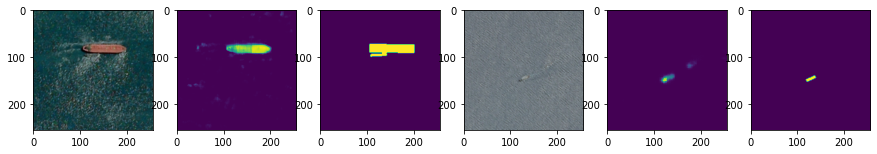

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0070 - dice_loss: 0.5320 - accuracy: 0.9973 - val_loss: 0.0138 - val_dice_loss: 0.5811 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.5364 - accuracy: 0.9973 - val_loss: 0.0138 - val_dice_loss: 0.5845 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0072 - dice_loss: 0.5363 - accuracy: 0.9972 - val_loss: 0.0137 - val_dice_loss: 0.5832 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0067 - dice_loss: 0.5221 - accuracy: 0.9975 - val_loss: 0.0135 - val_dice_loss: 0.5798 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.5120 - accuracy: 0.9975 - val_loss: 0.0134 - val_dice_loss: 0.5778 - val_accuracy: 0.9955


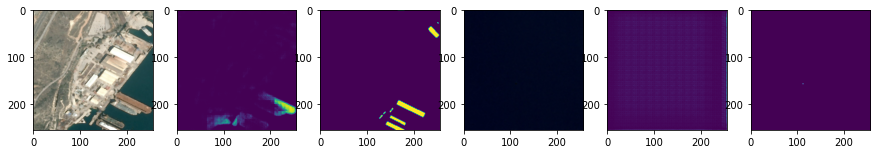

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6647 - accuracy: 0.9973 - val_loss: 0.0134 - val_dice_loss: 0.5153 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5872 - accuracy: 0.9976 - val_loss: 0.0131 - val_dice_loss: 0.5041 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5418 - accuracy: 0.9977 - val_loss: 0.0130 - val_dice_loss: 0.4982 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5376 - accuracy: 0.9978 - val_loss: 0.0130 - val_dice_loss: 0.4960 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.6437 - accuracy: 0.9979 - val_loss: 0.0130 - val_dice_loss: 0.4957 - val_accuracy: 0.9962


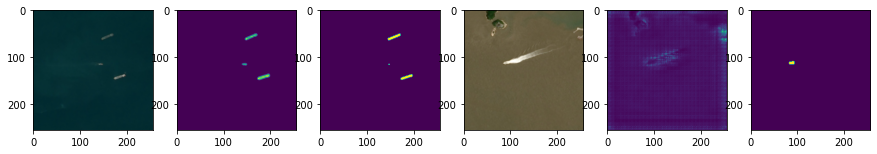

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0316 - dice_loss: 0.7156 - accuracy: 0.9894 - val_loss: 0.0087 - val_dice_loss: 0.4414 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0301 - dice_loss: 0.7528 - accuracy: 0.9903 - val_loss: 0.0086 - val_dice_loss: 0.4413 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0268 - dice_loss: 0.6858 - accuracy: 0.9920 - val_loss: 0.0086 - val_dice_loss: 0.4440 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0225 - dice_loss: 0.6721 - accuracy: 0.9924 - val_loss: 0.0086 - val_dice_loss: 0.4470 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0207 - dice_loss: 0.6370 - accuracy: 0.9925 - val_loss: 0.0087 - val_dice_loss: 0.4487 - val_accuracy: 0.9966


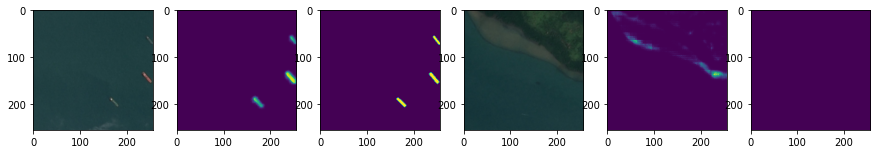

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0142 - dice_loss: 0.6184 - accuracy: 0.9953 - val_loss: 0.0109 - val_dice_loss: 0.5443 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0143 - dice_loss: 0.5998 - accuracy: 0.9951 - val_loss: 0.0111 - val_dice_loss: 0.5454 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0143 - dice_loss: 0.5825 - accuracy: 0.9953 - val_loss: 0.0110 - val_dice_loss: 0.5407 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.5876 - accuracy: 0.9953 - val_loss: 0.0108 - val_dice_loss: 0.5334 - val_accuracy: 0.9956
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0125 - dice_loss: 0.5508 - accuracy: 0.9958 - val_loss: 0.0105 - val_dice_loss: 0.5256 - val_accuracy: 0.9957


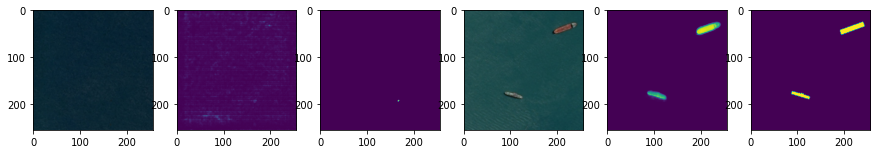

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0094 - dice_loss: 0.5571 - accuracy: 0.9970 - val_loss: 0.0117 - val_dice_loss: 0.5738 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0084 - dice_loss: 0.5351 - accuracy: 0.9972 - val_loss: 0.0108 - val_dice_loss: 0.5539 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0081 - dice_loss: 0.5542 - accuracy: 0.9971 - val_loss: 0.0101 - val_dice_loss: 0.5353 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.5000 - accuracy: 0.9973 - val_loss: 0.0097 - val_dice_loss: 0.5204 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0077 - dice_loss: 0.5069 - accuracy: 0.9972 - val_loss: 0.0094 - val_dice_loss: 0.5095 - val_accuracy: 0.9970


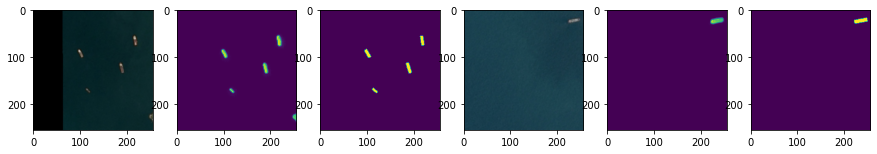

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.5975 - accuracy: 0.9963 - val_loss: 0.0117 - val_dice_loss: 0.6976 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.5791 - accuracy: 0.9962 - val_loss: 0.0121 - val_dice_loss: 0.7060 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5784 - accuracy: 0.9964 - val_loss: 0.0126 - val_dice_loss: 0.7161 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5994 - accuracy: 0.9964 - val_loss: 0.0129 - val_dice_loss: 0.7261 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5523 - accuracy: 0.9966 - val_loss: 0.0133 - val_dice_loss: 0.7389 - val_accuracy: 0.9970


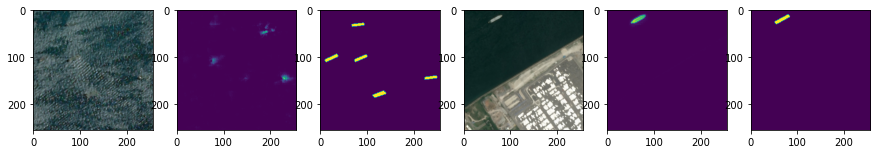

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.7500 - accuracy: 0.9982 - val_loss: 0.0147 - val_dice_loss: 0.7491 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.7141 - accuracy: 0.9980 - val_loss: 0.0145 - val_dice_loss: 0.7441 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.7223 - accuracy: 0.9981 - val_loss: 0.0143 - val_dice_loss: 0.7408 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0052 - dice_loss: 0.7313 - accuracy: 0.9981 - val_loss: 0.0142 - val_dice_loss: 0.7392 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0049 - dice_loss: 0.6961 - accuracy: 0.9983 - val_loss: 0.0141 - val_dice_loss: 0.7389 - val_accuracy: 0.9965


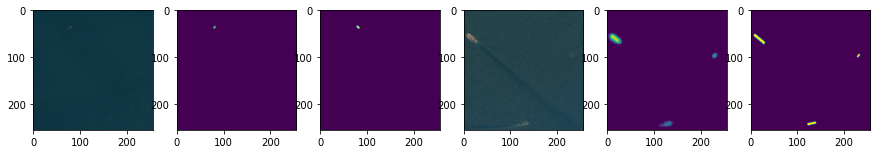

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0182 - dice_loss: 0.6613 - accuracy: 0.9948 - val_loss: 0.0093 - val_dice_loss: 0.6757 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0190 - dice_loss: 0.7248 - accuracy: 0.9947 - val_loss: 0.0091 - val_dice_loss: 0.6730 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0165 - dice_loss: 0.6649 - accuracy: 0.9949 - val_loss: 0.0090 - val_dice_loss: 0.6711 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.6538 - accuracy: 0.9952 - val_loss: 0.0089 - val_dice_loss: 0.6647 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.6168 - accuracy: 0.9954 - val_loss: 0.0088 - val_dice_loss: 0.6599 - val_accuracy: 0.9971


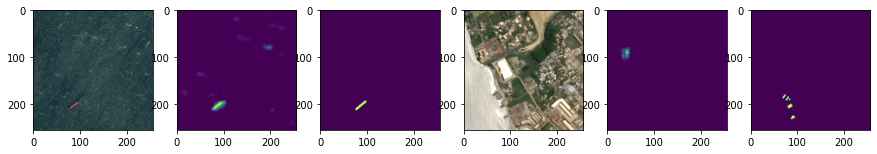

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.5288 - accuracy: 0.9972 - val_loss: 0.0077 - val_dice_loss: 0.6913 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.4956 - accuracy: 0.9975 - val_loss: 0.0077 - val_dice_loss: 0.6850 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5310 - accuracy: 0.9970 - val_loss: 0.0076 - val_dice_loss: 0.6793 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0085 - dice_loss: 0.5102 - accuracy: 0.9976 - val_loss: 0.0075 - val_dice_loss: 0.6758 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0082 - dice_loss: 0.4808 - accuracy: 0.9976 - val_loss: 0.0075 - val_dice_loss: 0.6732 - val_accuracy: 0.9979


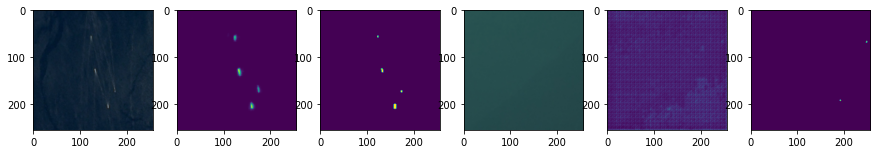

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.5871 - accuracy: 0.9966 - val_loss: 0.0162 - val_dice_loss: 0.5501 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.6382 - accuracy: 0.9953 - val_loss: 0.0158 - val_dice_loss: 0.5452 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5922 - accuracy: 0.9957 - val_loss: 0.0156 - val_dice_loss: 0.5435 - val_accuracy: 0.9944
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.5950 - accuracy: 0.9964 - val_loss: 0.0153 - val_dice_loss: 0.5421 - val_accuracy: 0.9945
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.5759 - accuracy: 0.9966 - val_loss: 0.0151 - val_dice_loss: 0.5419 - val_accuracy: 0.9947


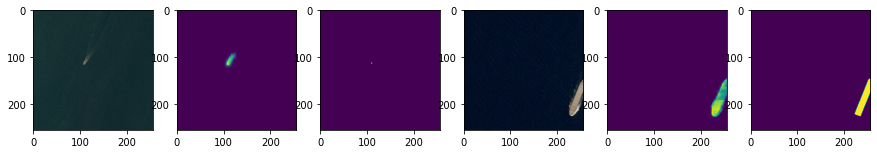

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0095 - dice_loss: 0.5805 - accuracy: 0.9964 - val_loss: 0.0105 - val_dice_loss: 0.7627 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.6134 - accuracy: 0.9963 - val_loss: 0.0107 - val_dice_loss: 0.7663 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0093 - dice_loss: 0.6094 - accuracy: 0.9964 - val_loss: 0.0110 - val_dice_loss: 0.7674 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0087 - dice_loss: 0.5646 - accuracy: 0.9968 - val_loss: 0.0113 - val_dice_loss: 0.7679 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0089 - dice_loss: 0.5807 - accuracy: 0.9967 - val_loss: 0.0116 - val_dice_loss: 0.7678 - val_accuracy: 0.9974


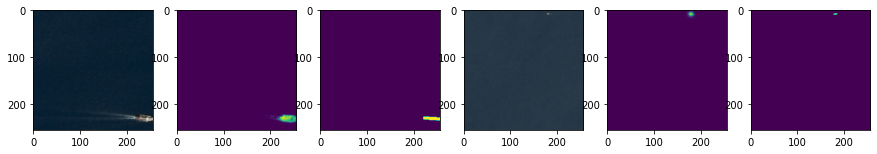

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0166 - dice_loss: 0.5910 - accuracy: 0.9948 - val_loss: 0.0070 - val_dice_loss: 0.6210 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.5990 - accuracy: 0.9945 - val_loss: 0.0070 - val_dice_loss: 0.6209 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0162 - dice_loss: 0.5862 - accuracy: 0.9946 - val_loss: 0.0069 - val_dice_loss: 0.6213 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0166 - dice_loss: 0.6108 - accuracy: 0.9940 - val_loss: 0.0069 - val_dice_loss: 0.6215 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0139 - dice_loss: 0.5296 - accuracy: 0.9955 - val_loss: 0.0070 - val_dice_loss: 0.6228 - val_accuracy: 0.9973


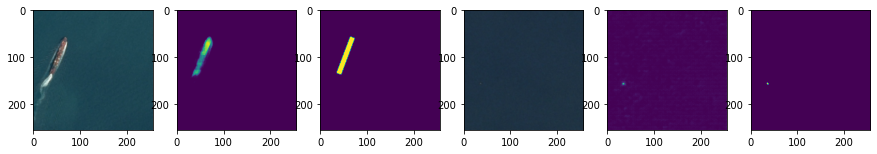

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0092 - dice_loss: 0.5139 - accuracy: 0.9969 - val_loss: 0.0099 - val_dice_loss: 0.5623 - val_accuracy: 0.9958
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0099 - dice_loss: 0.5623 - accuracy: 0.9962 - val_loss: 0.0099 - val_dice_loss: 0.5592 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0086 - dice_loss: 0.4747 - accuracy: 0.9973 - val_loss: 0.0097 - val_dice_loss: 0.5532 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0078 - dice_loss: 0.4279 - accuracy: 0.9972 - val_loss: 0.0095 - val_dice_loss: 0.5466 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0083 - dice_loss: 0.5578 - accuracy: 0.9970 - val_loss: 0.0094 - val_dice_loss: 0.5403 - val_accuracy: 0.9960


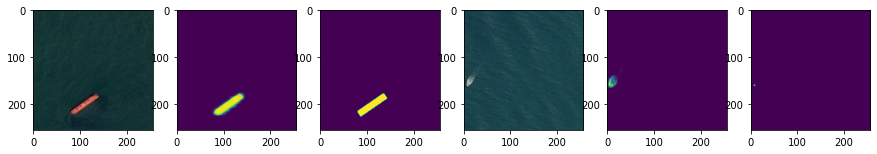

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0064 - dice_loss: 0.5261 - accuracy: 0.9983 - val_loss: 0.0094 - val_dice_loss: 0.5388 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0068 - dice_loss: 0.5543 - accuracy: 0.9979 - val_loss: 0.0093 - val_dice_loss: 0.5365 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0065 - dice_loss: 0.5443 - accuracy: 0.9982 - val_loss: 0.0092 - val_dice_loss: 0.5340 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0065 - dice_loss: 0.5239 - accuracy: 0.9981 - val_loss: 0.0092 - val_dice_loss: 0.5318 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 5s 3s/step - loss: 0.0063 - dice_loss: 0.5005 - accuracy: 0.9983 - val_loss: 0.0091 - val_dice_loss: 0.5297 - val_accuracy: 0.9976


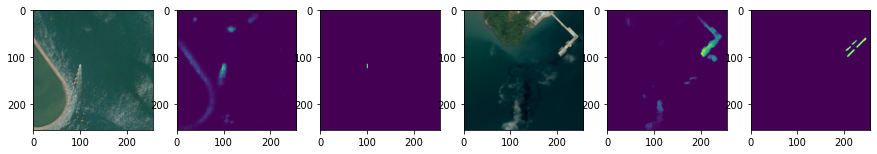

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0137 - dice_loss: 0.5514 - accuracy: 0.9954 - val_loss: 0.0144 - val_dice_loss: 0.6091 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5732 - accuracy: 0.9951 - val_loss: 0.0145 - val_dice_loss: 0.6103 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5784 - accuracy: 0.9951 - val_loss: 0.0146 - val_dice_loss: 0.6120 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0124 - dice_loss: 0.5482 - accuracy: 0.9955 - val_loss: 0.0147 - val_dice_loss: 0.6135 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0120 - dice_loss: 0.5113 - accuracy: 0.9956 - val_loss: 0.0148 - val_dice_loss: 0.6188 - val_accuracy: 0.9949


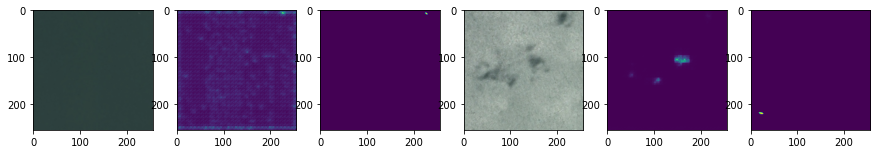

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0188 - dice_loss: 0.5735 - accuracy: 0.9948 - val_loss: 0.0122 - val_dice_loss: 0.5089 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.5657 - accuracy: 0.9954 - val_loss: 0.0122 - val_dice_loss: 0.5057 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.5459 - accuracy: 0.9953 - val_loss: 0.0121 - val_dice_loss: 0.5028 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.5470 - accuracy: 0.9957 - val_loss: 0.0119 - val_dice_loss: 0.4983 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.5320 - accuracy: 0.9956 - val_loss: 0.0117 - val_dice_loss: 0.4940 - val_accuracy: 0.9964


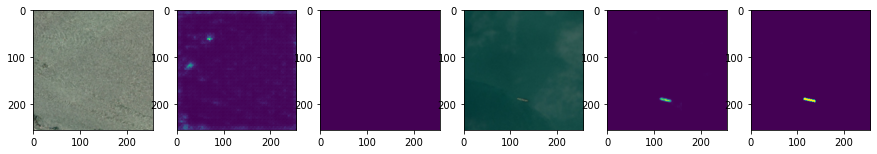

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0072 - dice_loss: 0.4467 - accuracy: 0.9976 - val_loss: 0.0089 - val_dice_loss: 0.5578 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.5192 - accuracy: 0.9981 - val_loss: 0.0091 - val_dice_loss: 0.5602 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.4388 - accuracy: 0.9980 - val_loss: 0.0091 - val_dice_loss: 0.5615 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4308 - accuracy: 0.9981 - val_loss: 0.0092 - val_dice_loss: 0.5621 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.4470 - accuracy: 0.9981 - val_loss: 0.0092 - val_dice_loss: 0.5631 - val_accuracy: 0.9972


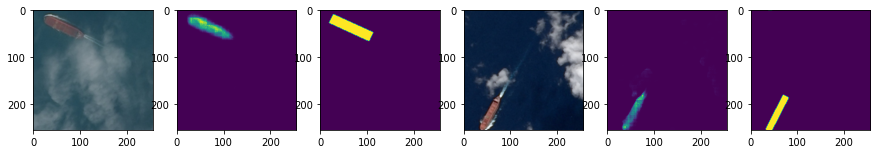

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5163 - accuracy: 0.9962 - val_loss: 0.0120 - val_dice_loss: 0.5453 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5232 - accuracy: 0.9962 - val_loss: 0.0119 - val_dice_loss: 0.5441 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0096 - dice_loss: 0.4887 - accuracy: 0.9964 - val_loss: 0.0117 - val_dice_loss: 0.5422 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0091 - dice_loss: 0.4583 - accuracy: 0.9965 - val_loss: 0.0114 - val_dice_loss: 0.5380 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0089 - dice_loss: 0.4806 - accuracy: 0.9967 - val_loss: 0.0111 - val_dice_loss: 0.5325 - val_accuracy: 0.9955


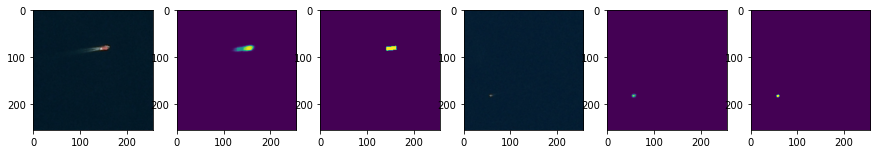

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.5100 - accuracy: 0.9980 - val_loss: 0.0066 - val_dice_loss: 0.4814 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0072 - dice_loss: 0.5453 - accuracy: 0.9979 - val_loss: 0.0066 - val_dice_loss: 0.4785 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.5334 - accuracy: 0.9979 - val_loss: 0.0065 - val_dice_loss: 0.4772 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5063 - accuracy: 0.9979 - val_loss: 0.0064 - val_dice_loss: 0.4784 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5077 - accuracy: 0.9980 - val_loss: 0.0065 - val_dice_loss: 0.4812 - val_accuracy: 0.9978


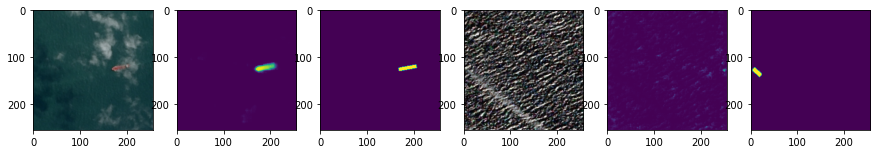

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5928 - accuracy: 0.9969 - val_loss: 0.0089 - val_dice_loss: 0.4216 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0102 - dice_loss: 0.5843 - accuracy: 0.9967 - val_loss: 0.0088 - val_dice_loss: 0.4200 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0106 - dice_loss: 0.5770 - accuracy: 0.9969 - val_loss: 0.0087 - val_dice_loss: 0.4182 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.5948 - accuracy: 0.9969 - val_loss: 0.0087 - val_dice_loss: 0.4161 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5369 - accuracy: 0.9970 - val_loss: 0.0087 - val_dice_loss: 0.4137 - val_accuracy: 0.9978


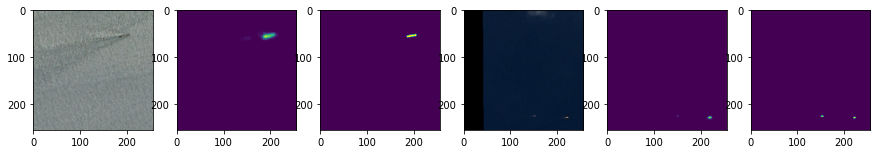

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0160 - dice_loss: 0.5951 - accuracy: 0.9942 - val_loss: 0.0163 - val_dice_loss: 0.6549 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.5840 - accuracy: 0.9942 - val_loss: 0.0163 - val_dice_loss: 0.6617 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.5806 - accuracy: 0.9945 - val_loss: 0.0165 - val_dice_loss: 0.6643 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0147 - dice_loss: 0.5819 - accuracy: 0.9946 - val_loss: 0.0168 - val_dice_loss: 0.6680 - val_accuracy: 0.9958
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.5409 - accuracy: 0.9952 - val_loss: 0.0174 - val_dice_loss: 0.6782 - val_accuracy: 0.9957


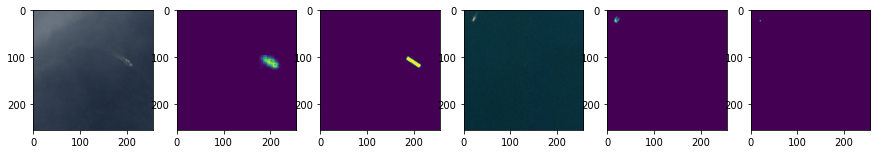

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0127 - dice_loss: 0.6015 - accuracy: 0.9960 - val_loss: 0.0380 - val_dice_loss: 0.7438 - val_accuracy: 0.9921
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0124 - dice_loss: 0.6329 - accuracy: 0.9963 - val_loss: 0.0387 - val_dice_loss: 0.7603 - val_accuracy: 0.9919
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0119 - dice_loss: 0.5891 - accuracy: 0.9964 - val_loss: 0.0389 - val_dice_loss: 0.7720 - val_accuracy: 0.9918
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6056 - accuracy: 0.9967 - val_loss: 0.0385 - val_dice_loss: 0.7759 - val_accuracy: 0.9918
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0115 - dice_loss: 0.6178 - accuracy: 0.9965 - val_loss: 0.0379 - val_dice_loss: 0.7789 - val_accuracy: 0.9918


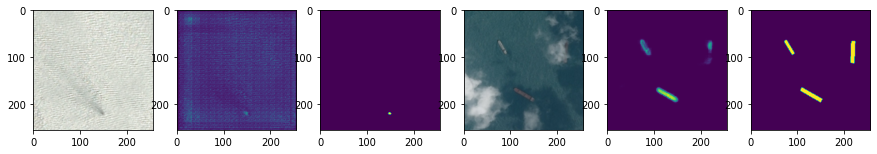

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.5742 - accuracy: 0.9960 - val_loss: 0.0081 - val_dice_loss: 0.5048 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5685 - accuracy: 0.9961 - val_loss: 0.0077 - val_dice_loss: 0.4845 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5103 - accuracy: 0.9964 - val_loss: 0.0080 - val_dice_loss: 0.4870 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.4508 - accuracy: 0.9970 - val_loss: 0.0084 - val_dice_loss: 0.4986 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.4647 - accuracy: 0.9968 - val_loss: 0.0088 - val_dice_loss: 0.5082 - val_accuracy: 0.9973


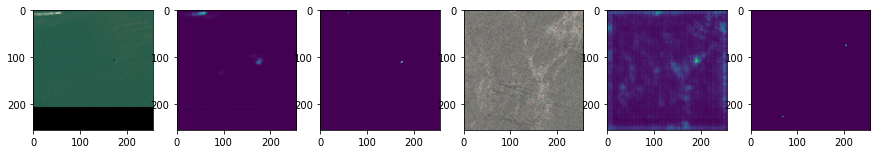

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.4918 - accuracy: 0.9956 - val_loss: 0.0079 - val_dice_loss: 0.4760 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.4768 - accuracy: 0.9957 - val_loss: 0.0079 - val_dice_loss: 0.4697 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0114 - dice_loss: 0.4829 - accuracy: 0.9963 - val_loss: 0.0080 - val_dice_loss: 0.4672 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0106 - dice_loss: 0.4571 - accuracy: 0.9959 - val_loss: 0.0081 - val_dice_loss: 0.4670 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.4580 - accuracy: 0.9956 - val_loss: 0.0083 - val_dice_loss: 0.4693 - val_accuracy: 0.9968


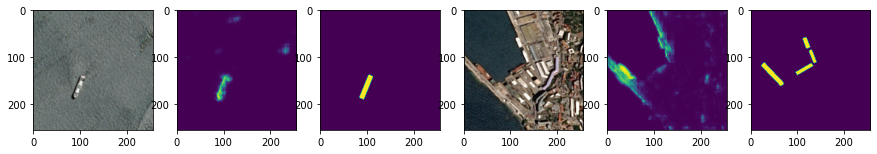

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.4883 - accuracy: 0.9956 - val_loss: 0.0138 - val_dice_loss: 0.6257 - val_accuracy: 0.9951
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.5071 - accuracy: 0.9958 - val_loss: 0.0138 - val_dice_loss: 0.6264 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4666 - accuracy: 0.9958 - val_loss: 0.0138 - val_dice_loss: 0.6264 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0110 - dice_loss: 0.4842 - accuracy: 0.9959 - val_loss: 0.0139 - val_dice_loss: 0.6262 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.4815 - accuracy: 0.9957 - val_loss: 0.0139 - val_dice_loss: 0.6250 - val_accuracy: 0.9951


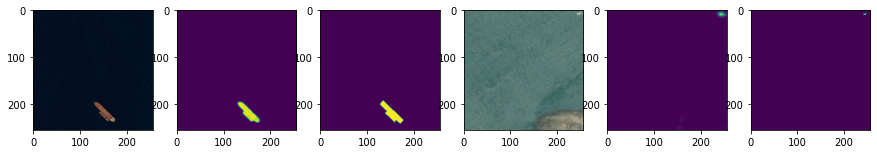

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.6673 - accuracy: 0.9964 - val_loss: 0.0084 - val_dice_loss: 0.5197 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6531 - accuracy: 0.9963 - val_loss: 0.0078 - val_dice_loss: 0.5105 - val_accuracy: 0.9979
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0103 - dice_loss: 0.6604 - accuracy: 0.9967 - val_loss: 0.0073 - val_dice_loss: 0.5042 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0096 - dice_loss: 0.6420 - accuracy: 0.9967 - val_loss: 0.0071 - val_dice_loss: 0.5035 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.6516 - accuracy: 0.9964 - val_loss: 0.0070 - val_dice_loss: 0.5067 - val_accuracy: 0.9978


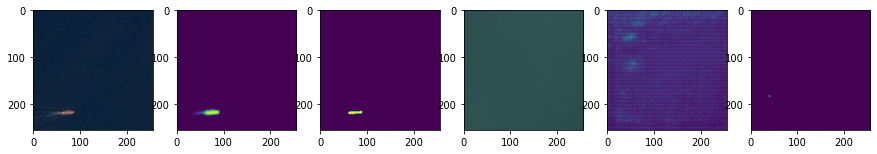

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.6665 - accuracy: 0.9967 - val_loss: 0.0096 - val_dice_loss: 0.6841 - val_accuracy: 0.9979
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.6908 - accuracy: 0.9966 - val_loss: 0.0096 - val_dice_loss: 0.6877 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.6334 - accuracy: 0.9967 - val_loss: 0.0095 - val_dice_loss: 0.6906 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.6347 - accuracy: 0.9969 - val_loss: 0.0094 - val_dice_loss: 0.6932 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6405 - accuracy: 0.9971 - val_loss: 0.0092 - val_dice_loss: 0.6937 - val_accuracy: 0.9978


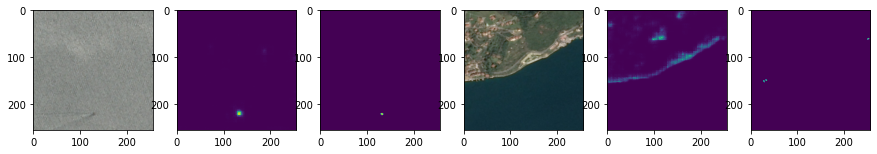

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.5597 - accuracy: 0.9955 - val_loss: 0.0074 - val_dice_loss: 0.6380 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.5286 - accuracy: 0.9959 - val_loss: 0.0076 - val_dice_loss: 0.6395 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0161 - dice_loss: 0.5016 - accuracy: 0.9963 - val_loss: 0.0077 - val_dice_loss: 0.6381 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.5578 - accuracy: 0.9960 - val_loss: 0.0079 - val_dice_loss: 0.6350 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.5273 - accuracy: 0.9962 - val_loss: 0.0079 - val_dice_loss: 0.6279 - val_accuracy: 0.9972


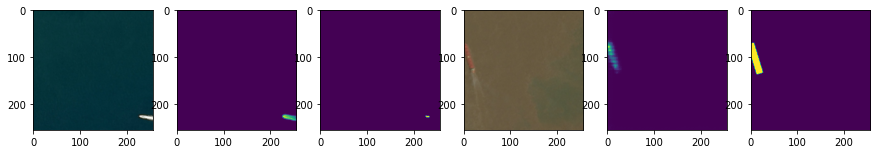

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5766 - accuracy: 0.9960 - val_loss: 0.0146 - val_dice_loss: 0.6193 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.5526 - accuracy: 0.9963 - val_loss: 0.0148 - val_dice_loss: 0.6223 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.5663 - accuracy: 0.9959 - val_loss: 0.0149 - val_dice_loss: 0.6246 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.5629 - accuracy: 0.9961 - val_loss: 0.0150 - val_dice_loss: 0.6262 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.5525 - accuracy: 0.9963 - val_loss: 0.0151 - val_dice_loss: 0.6258 - val_accuracy: 0.9957


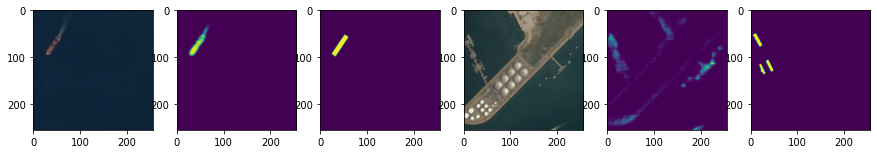

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5548 - accuracy: 0.9976 - val_loss: 0.0090 - val_dice_loss: 0.5358 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5452 - accuracy: 0.9975 - val_loss: 0.0088 - val_dice_loss: 0.5294 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5708 - accuracy: 0.9973 - val_loss: 0.0085 - val_dice_loss: 0.5209 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5386 - accuracy: 0.9976 - val_loss: 0.0081 - val_dice_loss: 0.5109 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.4766 - accuracy: 0.9977 - val_loss: 0.0078 - val_dice_loss: 0.5025 - val_accuracy: 0.9976


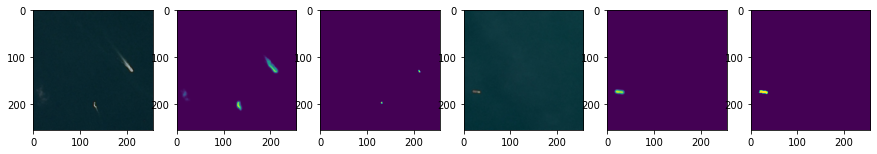

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.4754 - accuracy: 0.9962 - val_loss: 0.0087 - val_dice_loss: 0.4641 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.4771 - accuracy: 0.9960 - val_loss: 0.0087 - val_dice_loss: 0.4648 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.4540 - accuracy: 0.9962 - val_loss: 0.0087 - val_dice_loss: 0.4650 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.4408 - accuracy: 0.9964 - val_loss: 0.0087 - val_dice_loss: 0.4656 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.4297 - accuracy: 0.9966 - val_loss: 0.0088 - val_dice_loss: 0.4674 - val_accuracy: 0.9963


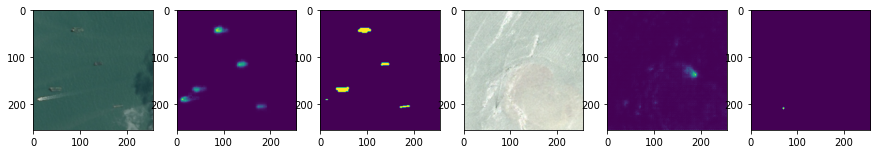

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.6593 - accuracy: 0.9977 - val_loss: 0.0172 - val_dice_loss: 0.4956 - val_accuracy: 0.9943
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5603 - accuracy: 0.9977 - val_loss: 0.0177 - val_dice_loss: 0.5011 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.5585 - accuracy: 0.9978 - val_loss: 0.0184 - val_dice_loss: 0.5095 - val_accuracy: 0.9939
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5354 - accuracy: 0.9979 - val_loss: 0.0190 - val_dice_loss: 0.5172 - val_accuracy: 0.9938
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.5431 - accuracy: 0.9981 - val_loss: 0.0196 - val_dice_loss: 0.5240 - val_accuracy: 0.9937


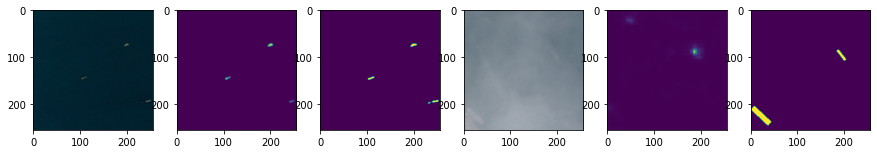

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.6557 - accuracy: 0.9959 - val_loss: 0.0067 - val_dice_loss: 0.4732 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.6211 - accuracy: 0.9961 - val_loss: 0.0067 - val_dice_loss: 0.4768 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5945 - accuracy: 0.9964 - val_loss: 0.0068 - val_dice_loss: 0.4775 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5995 - accuracy: 0.9963 - val_loss: 0.0068 - val_dice_loss: 0.4774 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5950 - accuracy: 0.9963 - val_loss: 0.0069 - val_dice_loss: 0.4742 - val_accuracy: 0.9977


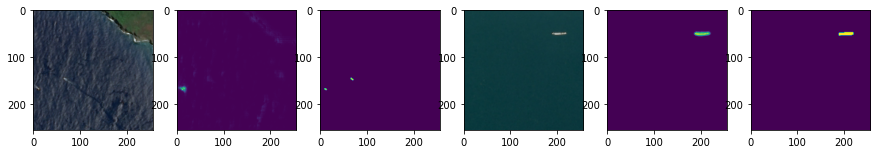

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5635 - accuracy: 0.9965 - val_loss: 0.0283 - val_dice_loss: 0.8714 - val_accuracy: 0.9945
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.6005 - accuracy: 0.9964 - val_loss: 0.0295 - val_dice_loss: 0.8721 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0116 - dice_loss: 0.5540 - accuracy: 0.9967 - val_loss: 0.0313 - val_dice_loss: 0.8679 - val_accuracy: 0.9945
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0099 - dice_loss: 0.6285 - accuracy: 0.9966 - val_loss: 0.0325 - val_dice_loss: 0.8599 - val_accuracy: 0.9945
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5559 - accuracy: 0.9970 - val_loss: 0.0324 - val_dice_loss: 0.8527 - val_accuracy: 0.9945


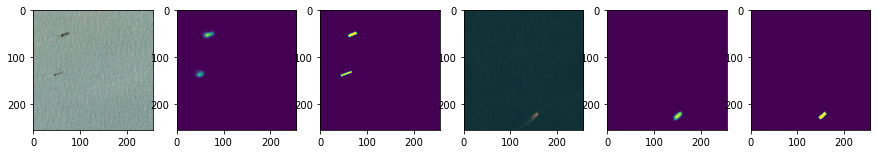

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0215 - dice_loss: 0.6654 - accuracy: 0.9946 - val_loss: 0.0258 - val_dice_loss: 0.6397 - val_accuracy: 0.9944
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0175 - dice_loss: 0.6264 - accuracy: 0.9947 - val_loss: 0.0275 - val_dice_loss: 0.6315 - val_accuracy: 0.9946
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0182 - dice_loss: 0.6558 - accuracy: 0.9950 - val_loss: 0.0297 - val_dice_loss: 0.6248 - val_accuracy: 0.9947
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0151 - dice_loss: 0.6238 - accuracy: 0.9947 - val_loss: 0.0317 - val_dice_loss: 0.6136 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0150 - dice_loss: 0.6193 - accuracy: 0.9956 - val_loss: 0.0329 - val_dice_loss: 0.6126 - val_accuracy: 0.9948


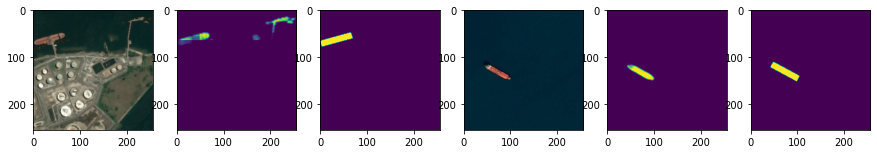

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.6098 - accuracy: 0.9971 - val_loss: 0.0136 - val_dice_loss: 0.6594 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0081 - dice_loss: 0.4936 - accuracy: 0.9967 - val_loss: 0.0135 - val_dice_loss: 0.6552 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0078 - dice_loss: 0.4762 - accuracy: 0.9973 - val_loss: 0.0134 - val_dice_loss: 0.6573 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0074 - dice_loss: 0.4411 - accuracy: 0.9971 - val_loss: 0.0136 - val_dice_loss: 0.6636 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.4502 - accuracy: 0.9972 - val_loss: 0.0139 - val_dice_loss: 0.6713 - val_accuracy: 0.9964


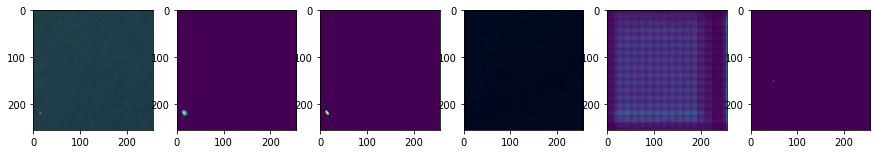

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.4545 - accuracy: 0.9980 - val_loss: 0.0227 - val_dice_loss: 0.7446 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.4713 - accuracy: 0.9979 - val_loss: 0.0224 - val_dice_loss: 0.7441 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.4480 - accuracy: 0.9980 - val_loss: 0.0220 - val_dice_loss: 0.7427 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.4948 - accuracy: 0.9980 - val_loss: 0.0216 - val_dice_loss: 0.7418 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0050 - dice_loss: 0.5219 - accuracy: 0.9982 - val_loss: 0.0212 - val_dice_loss: 0.7412 - val_accuracy: 0.9969


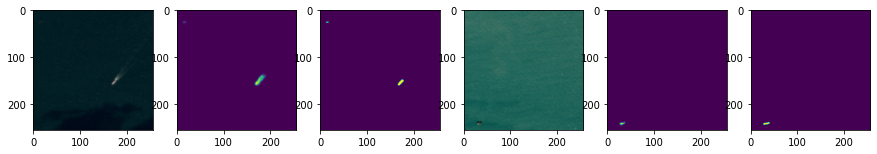

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0112 - dice_loss: 0.5053 - accuracy: 0.9966 - val_loss: 0.0226 - val_dice_loss: 0.6315 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0099 - dice_loss: 0.4961 - accuracy: 0.9966 - val_loss: 0.0218 - val_dice_loss: 0.6333 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4849 - accuracy: 0.9969 - val_loss: 0.0202 - val_dice_loss: 0.6294 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.4982 - accuracy: 0.9966 - val_loss: 0.0186 - val_dice_loss: 0.6271 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0093 - dice_loss: 0.4907 - accuracy: 0.9967 - val_loss: 0.0172 - val_dice_loss: 0.6249 - val_accuracy: 0.9963


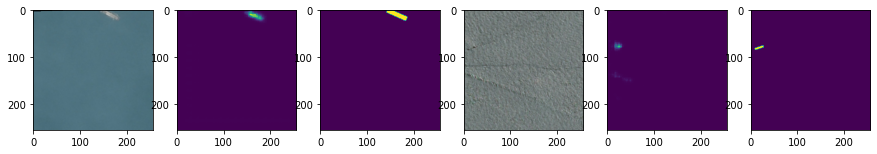

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0109 - dice_loss: 0.5735 - accuracy: 0.9970 - val_loss: 0.0144 - val_dice_loss: 0.5467 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5757 - accuracy: 0.9970 - val_loss: 0.0142 - val_dice_loss: 0.5530 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5762 - accuracy: 0.9972 - val_loss: 0.0141 - val_dice_loss: 0.5583 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0104 - dice_loss: 0.6191 - accuracy: 0.9971 - val_loss: 0.0139 - val_dice_loss: 0.5646 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0099 - dice_loss: 0.5420 - accuracy: 0.9973 - val_loss: 0.0138 - val_dice_loss: 0.5709 - val_accuracy: 0.9960


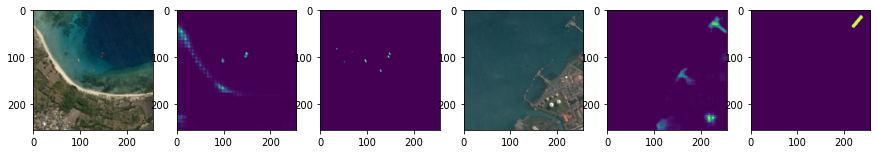

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.3994 - accuracy: 0.9958 - val_loss: 0.0077 - val_dice_loss: 0.6171 - val_accuracy: 0.9982
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.4021 - accuracy: 0.9962 - val_loss: 0.0082 - val_dice_loss: 0.6283 - val_accuracy: 0.9980
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.4162 - accuracy: 0.9955 - val_loss: 0.0088 - val_dice_loss: 0.6398 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 6s 3s/step - loss: 0.0108 - dice_loss: 0.3661 - accuracy: 0.9963 - val_loss: 0.0090 - val_dice_loss: 0.6409 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.3986 - accuracy: 0.9965 - val_loss: 0.0089 - val_dice_loss: 0.6349 - val_accuracy: 0.9975


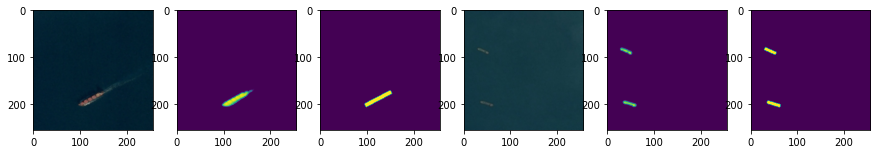

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.4912 - accuracy: 0.9971 - val_loss: 0.0083 - val_dice_loss: 0.4244 - val_accuracy: 0.9980
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0087 - dice_loss: 0.4369 - accuracy: 0.9972 - val_loss: 0.0084 - val_dice_loss: 0.4255 - val_accuracy: 0.9980
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.4614 - accuracy: 0.9973 - val_loss: 0.0084 - val_dice_loss: 0.4258 - val_accuracy: 0.9980
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.4781 - accuracy: 0.9974 - val_loss: 0.0083 - val_dice_loss: 0.4249 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0074 - dice_loss: 0.4016 - accuracy: 0.9975 - val_loss: 0.0080 - val_dice_loss: 0.4176 - val_accuracy: 0.9979


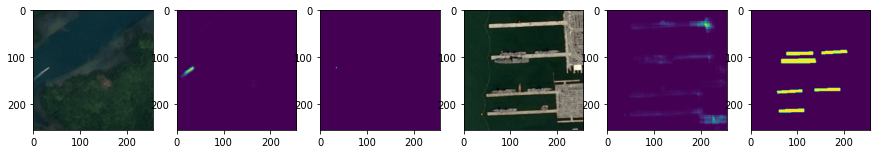

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0205 - dice_loss: 0.5925 - accuracy: 0.9943 - val_loss: 0.0109 - val_dice_loss: 0.6720 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0195 - dice_loss: 0.5913 - accuracy: 0.9941 - val_loss: 0.0110 - val_dice_loss: 0.6741 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0197 - dice_loss: 0.6058 - accuracy: 0.9943 - val_loss: 0.0124 - val_dice_loss: 0.6971 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0160 - dice_loss: 0.5494 - accuracy: 0.9940 - val_loss: 0.0136 - val_dice_loss: 0.7165 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0167 - dice_loss: 0.5733 - accuracy: 0.9934 - val_loss: 0.0143 - val_dice_loss: 0.7283 - val_accuracy: 0.9962


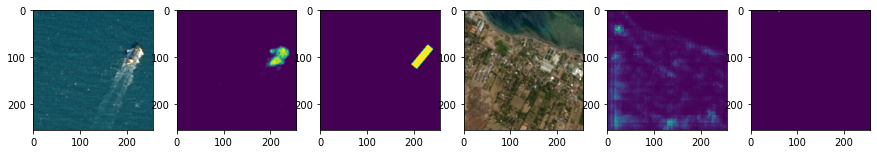

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5552 - accuracy: 0.9965 - val_loss: 0.0140 - val_dice_loss: 0.6591 - val_accuracy: 0.9958
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5582 - accuracy: 0.9966 - val_loss: 0.0136 - val_dice_loss: 0.6546 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5402 - accuracy: 0.9967 - val_loss: 0.0132 - val_dice_loss: 0.6461 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0091 - dice_loss: 0.5455 - accuracy: 0.9969 - val_loss: 0.0127 - val_dice_loss: 0.6345 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5220 - accuracy: 0.9970 - val_loss: 0.0124 - val_dice_loss: 0.6245 - val_accuracy: 0.9963


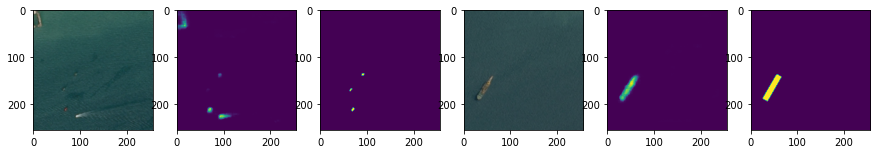

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.4567 - accuracy: 0.9968 - val_loss: 0.0075 - val_dice_loss: 0.6551 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.4774 - accuracy: 0.9968 - val_loss: 0.0073 - val_dice_loss: 0.6509 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.4441 - accuracy: 0.9971 - val_loss: 0.0073 - val_dice_loss: 0.6488 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4379 - accuracy: 0.9970 - val_loss: 0.0073 - val_dice_loss: 0.6493 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4359 - accuracy: 0.9971 - val_loss: 0.0073 - val_dice_loss: 0.6523 - val_accuracy: 0.9977


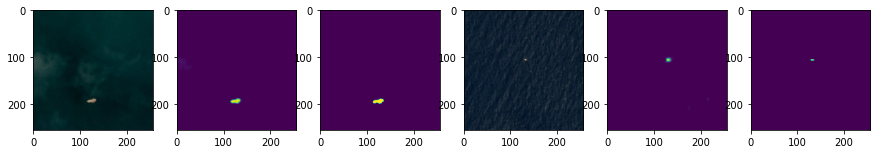

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.3637 - accuracy: 0.9971 - val_loss: 0.0175 - val_dice_loss: 0.7039 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0106 - dice_loss: 0.4797 - accuracy: 0.9963 - val_loss: 0.0175 - val_dice_loss: 0.7071 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0092 - dice_loss: 0.3595 - accuracy: 0.9972 - val_loss: 0.0176 - val_dice_loss: 0.7083 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.3425 - accuracy: 0.9972 - val_loss: 0.0176 - val_dice_loss: 0.7102 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0098 - dice_loss: 0.3410 - accuracy: 0.9972 - val_loss: 0.0177 - val_dice_loss: 0.7118 - val_accuracy: 0.9950


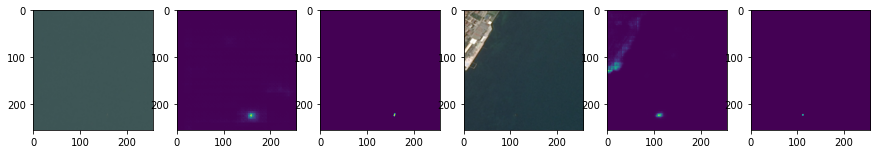

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0194 - dice_loss: 0.5910 - accuracy: 0.9944 - val_loss: 0.0129 - val_dice_loss: 0.5488 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0186 - dice_loss: 0.5707 - accuracy: 0.9945 - val_loss: 0.0127 - val_dice_loss: 0.5345 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0154 - dice_loss: 0.5581 - accuracy: 0.9947 - val_loss: 0.0125 - val_dice_loss: 0.5136 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0137 - dice_loss: 0.5130 - accuracy: 0.9950 - val_loss: 0.0125 - val_dice_loss: 0.4982 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0122 - dice_loss: 0.5324 - accuracy: 0.9953 - val_loss: 0.0128 - val_dice_loss: 0.4929 - val_accuracy: 0.9965


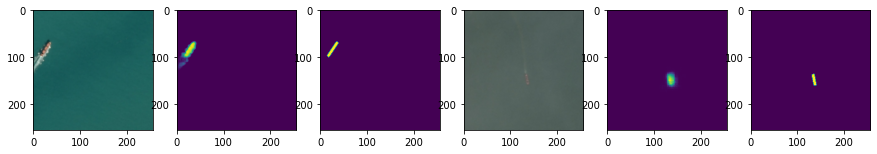

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0312 - dice_loss: 0.4873 - accuracy: 0.9916 - val_loss: 0.0185 - val_dice_loss: 0.5273 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0303 - dice_loss: 0.4904 - accuracy: 0.9912 - val_loss: 0.0187 - val_dice_loss: 0.5329 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0276 - dice_loss: 0.4930 - accuracy: 0.9922 - val_loss: 0.0188 - val_dice_loss: 0.5415 - val_accuracy: 0.9931
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0246 - dice_loss: 0.4967 - accuracy: 0.9918 - val_loss: 0.0187 - val_dice_loss: 0.5476 - val_accuracy: 0.9928
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0227 - dice_loss: 0.4874 - accuracy: 0.9917 - val_loss: 0.0191 - val_dice_loss: 0.5545 - val_accuracy: 0.9927


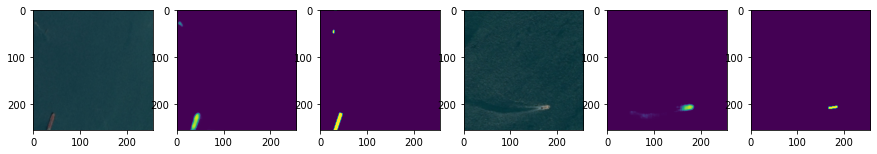

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0137 - dice_loss: 0.7021 - accuracy: 0.9952 - val_loss: 0.0094 - val_dice_loss: 0.4779 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0123 - dice_loss: 0.6937 - accuracy: 0.9963 - val_loss: 0.0092 - val_dice_loss: 0.4764 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.6368 - accuracy: 0.9966 - val_loss: 0.0092 - val_dice_loss: 0.4851 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0084 - dice_loss: 0.6013 - accuracy: 0.9969 - val_loss: 0.0094 - val_dice_loss: 0.4966 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.5996 - accuracy: 0.9966 - val_loss: 0.0097 - val_dice_loss: 0.5110 - val_accuracy: 0.9964


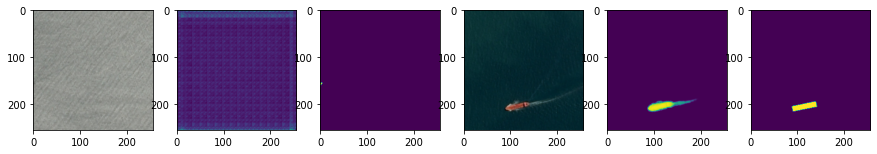

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.6946 - accuracy: 0.9950 - val_loss: 0.0111 - val_dice_loss: 0.5906 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0193 - dice_loss: 0.6828 - accuracy: 0.9954 - val_loss: 0.0114 - val_dice_loss: 0.6007 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0197 - dice_loss: 0.7020 - accuracy: 0.9956 - val_loss: 0.0117 - val_dice_loss: 0.6135 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0183 - dice_loss: 0.6569 - accuracy: 0.9957 - val_loss: 0.0119 - val_dice_loss: 0.6305 - val_accuracy: 0.9965
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0164 - dice_loss: 0.6646 - accuracy: 0.9956 - val_loss: 0.0119 - val_dice_loss: 0.6481 - val_accuracy: 0.9964


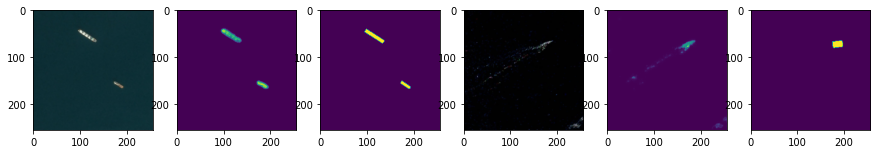

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0073 - dice_loss: 0.7095 - accuracy: 0.9986 - val_loss: 0.0203 - val_dice_loss: 0.8214 - val_accuracy: 0.9957
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0068 - dice_loss: 0.6895 - accuracy: 0.9986 - val_loss: 0.0198 - val_dice_loss: 0.8277 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.6550 - accuracy: 0.9986 - val_loss: 0.0195 - val_dice_loss: 0.8350 - val_accuracy: 0.9957
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.6752 - accuracy: 0.9986 - val_loss: 0.0194 - val_dice_loss: 0.8426 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.6475 - accuracy: 0.9986 - val_loss: 0.0194 - val_dice_loss: 0.8496 - val_accuracy: 0.9957


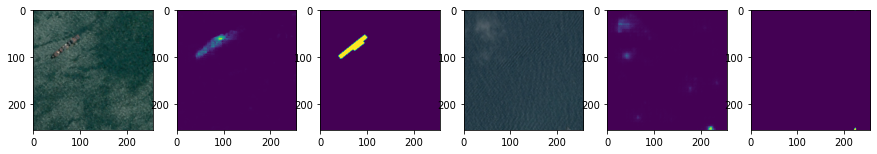

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0147 - dice_loss: 0.6859 - accuracy: 0.9972 - val_loss: 0.0167 - val_dice_loss: 0.6978 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0143 - dice_loss: 0.7049 - accuracy: 0.9971 - val_loss: 0.0166 - val_dice_loss: 0.6923 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.6870 - accuracy: 0.9971 - val_loss: 0.0164 - val_dice_loss: 0.6823 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.6983 - accuracy: 0.9971 - val_loss: 0.0161 - val_dice_loss: 0.6729 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.6709 - accuracy: 0.9971 - val_loss: 0.0157 - val_dice_loss: 0.6564 - val_accuracy: 0.9954


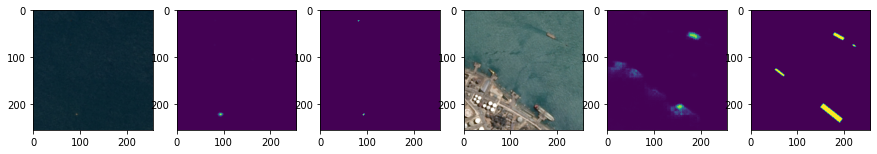

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6267 - accuracy: 0.9954 - val_loss: 0.0128 - val_dice_loss: 0.7086 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.6179 - accuracy: 0.9959 - val_loss: 0.0125 - val_dice_loss: 0.6904 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.6547 - accuracy: 0.9958 - val_loss: 0.0123 - val_dice_loss: 0.6759 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5522 - accuracy: 0.9964 - val_loss: 0.0121 - val_dice_loss: 0.6630 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5559 - accuracy: 0.9966 - val_loss: 0.0119 - val_dice_loss: 0.6520 - val_accuracy: 0.9963


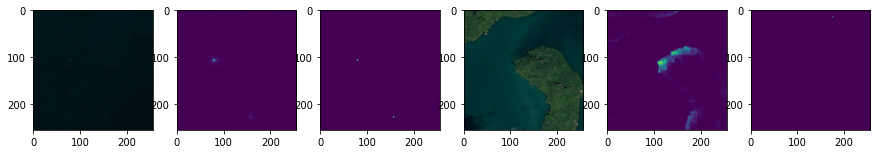

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6328 - accuracy: 0.9976 - val_loss: 0.0084 - val_dice_loss: 0.5595 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.6333 - accuracy: 0.9977 - val_loss: 0.0084 - val_dice_loss: 0.5553 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.6637 - accuracy: 0.9976 - val_loss: 0.0084 - val_dice_loss: 0.5508 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6155 - accuracy: 0.9975 - val_loss: 0.0084 - val_dice_loss: 0.5468 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6106 - accuracy: 0.9975 - val_loss: 0.0083 - val_dice_loss: 0.5416 - val_accuracy: 0.9976


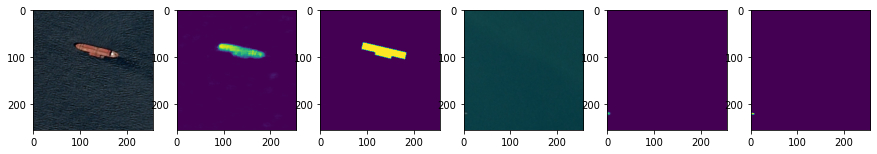

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.7221 - accuracy: 0.9973 - val_loss: 0.0203 - val_dice_loss: 0.6347 - val_accuracy: 0.9938
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.7320 - accuracy: 0.9974 - val_loss: 0.0205 - val_dice_loss: 0.6412 - val_accuracy: 0.9938
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.7235 - accuracy: 0.9976 - val_loss: 0.0209 - val_dice_loss: 0.6524 - val_accuracy: 0.9938
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.6948 - accuracy: 0.9977 - val_loss: 0.0214 - val_dice_loss: 0.6652 - val_accuracy: 0.9937
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.7053 - accuracy: 0.9974 - val_loss: 0.0218 - val_dice_loss: 0.6785 - val_accuracy: 0.9936


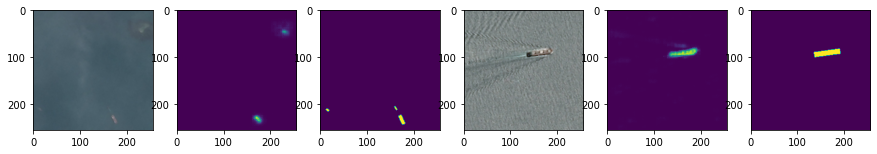

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0121 - dice_loss: 0.6318 - accuracy: 0.9966 - val_loss: 0.0113 - val_dice_loss: 0.7039 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0113 - dice_loss: 0.6356 - accuracy: 0.9964 - val_loss: 0.0114 - val_dice_loss: 0.7044 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0110 - dice_loss: 0.6592 - accuracy: 0.9962 - val_loss: 0.0116 - val_dice_loss: 0.7058 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.6399 - accuracy: 0.9963 - val_loss: 0.0117 - val_dice_loss: 0.7047 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6209 - accuracy: 0.9963 - val_loss: 0.0118 - val_dice_loss: 0.7020 - val_accuracy: 0.9969


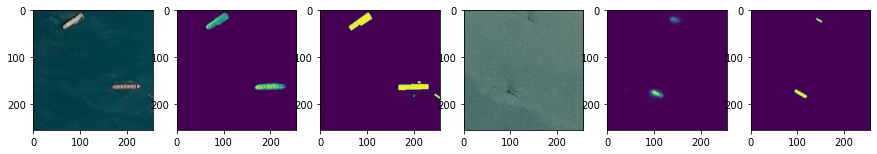

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0097 - dice_loss: 0.6068 - accuracy: 0.9969 - val_loss: 0.0078 - val_dice_loss: 0.5385 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5982 - accuracy: 0.9970 - val_loss: 0.0076 - val_dice_loss: 0.5370 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5745 - accuracy: 0.9972 - val_loss: 0.0076 - val_dice_loss: 0.5411 - val_accuracy: 0.9979
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5621 - accuracy: 0.9973 - val_loss: 0.0080 - val_dice_loss: 0.5545 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.5331 - accuracy: 0.9975 - val_loss: 0.0084 - val_dice_loss: 0.5661 - val_accuracy: 0.9980


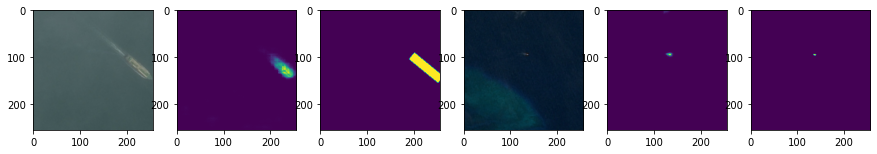

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6814 - accuracy: 0.9963 - val_loss: 0.0203 - val_dice_loss: 0.7206 - val_accuracy: 0.9931
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.6362 - accuracy: 0.9967 - val_loss: 0.0206 - val_dice_loss: 0.7292 - val_accuracy: 0.9931
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.6294 - accuracy: 0.9971 - val_loss: 0.0211 - val_dice_loss: 0.7445 - val_accuracy: 0.9930
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6021 - accuracy: 0.9972 - val_loss: 0.0220 - val_dice_loss: 0.7632 - val_accuracy: 0.9928
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.5768 - accuracy: 0.9974 - val_loss: 0.0229 - val_dice_loss: 0.7803 - val_accuracy: 0.9928


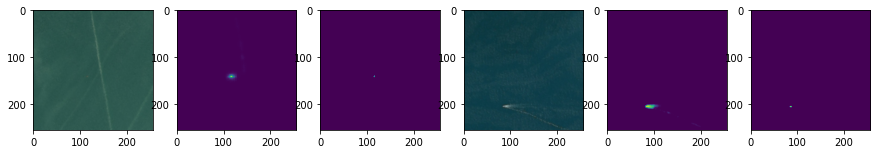

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.7271 - accuracy: 0.9984 - val_loss: 0.0144 - val_dice_loss: 0.7342 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0052 - dice_loss: 0.7009 - accuracy: 0.9984 - val_loss: 0.0143 - val_dice_loss: 0.7270 - val_accuracy: 0.9956
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.6965 - accuracy: 0.9986 - val_loss: 0.0141 - val_dice_loss: 0.7147 - val_accuracy: 0.9956
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0050 - dice_loss: 0.6872 - accuracy: 0.9985 - val_loss: 0.0136 - val_dice_loss: 0.6917 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0043 - dice_loss: 0.6321 - accuracy: 0.9988 - val_loss: 0.0132 - val_dice_loss: 0.6707 - val_accuracy: 0.9957


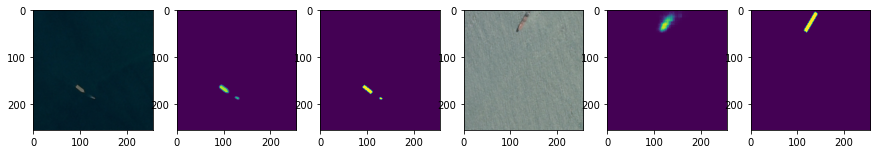

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0259 - dice_loss: 0.6234 - accuracy: 0.9926 - val_loss: 0.0074 - val_dice_loss: 0.6320 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0235 - dice_loss: 0.5456 - accuracy: 0.9936 - val_loss: 0.0069 - val_dice_loss: 0.6026 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0198 - dice_loss: 0.5313 - accuracy: 0.9940 - val_loss: 0.0075 - val_dice_loss: 0.6177 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.4857 - accuracy: 0.9946 - val_loss: 0.0088 - val_dice_loss: 0.6515 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.4669 - accuracy: 0.9949 - val_loss: 0.0102 - val_dice_loss: 0.6849 - val_accuracy: 0.9967


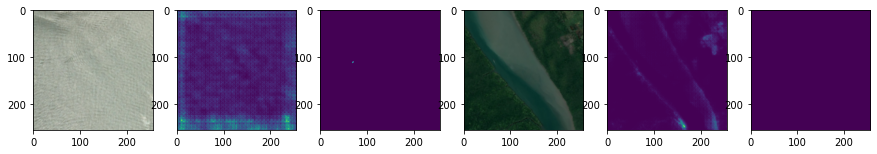

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0114 - dice_loss: 0.7321 - accuracy: 0.9962 - val_loss: 0.0133 - val_dice_loss: 0.6942 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.7185 - accuracy: 0.9956 - val_loss: 0.0129 - val_dice_loss: 0.6829 - val_accuracy: 0.9957
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6608 - accuracy: 0.9966 - val_loss: 0.0126 - val_dice_loss: 0.6688 - val_accuracy: 0.9958
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6233 - accuracy: 0.9977 - val_loss: 0.0128 - val_dice_loss: 0.6591 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.6328 - accuracy: 0.9976 - val_loss: 0.0133 - val_dice_loss: 0.6544 - val_accuracy: 0.9959


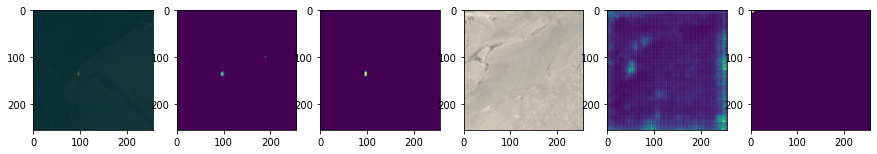

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6645 - accuracy: 0.9974 - val_loss: 0.0112 - val_dice_loss: 0.5438 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.6945 - accuracy: 0.9973 - val_loss: 0.0108 - val_dice_loss: 0.5360 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6422 - accuracy: 0.9976 - val_loss: 0.0106 - val_dice_loss: 0.5308 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.6387 - accuracy: 0.9976 - val_loss: 0.0103 - val_dice_loss: 0.5261 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.6300 - accuracy: 0.9978 - val_loss: 0.0101 - val_dice_loss: 0.5227 - val_accuracy: 0.9966


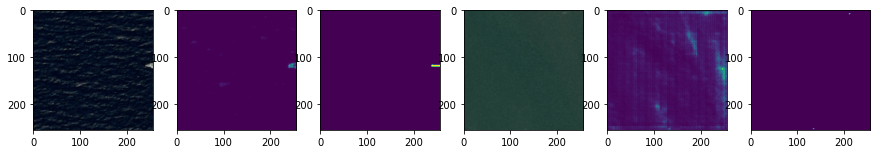

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.6299 - accuracy: 0.9970 - val_loss: 0.0109 - val_dice_loss: 0.6213 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.5893 - accuracy: 0.9972 - val_loss: 0.0124 - val_dice_loss: 0.6404 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5838 - accuracy: 0.9972 - val_loss: 0.0143 - val_dice_loss: 0.6645 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.5614 - accuracy: 0.9975 - val_loss: 0.0149 - val_dice_loss: 0.6724 - val_accuracy: 0.9945
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.5723 - accuracy: 0.9974 - val_loss: 0.0144 - val_dice_loss: 0.6679 - val_accuracy: 0.9946


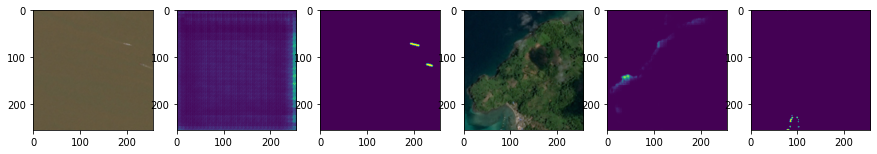

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0136 - dice_loss: 0.6546 - accuracy: 0.9959 - val_loss: 0.0194 - val_dice_loss: 0.8362 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0140 - dice_loss: 0.6474 - accuracy: 0.9960 - val_loss: 0.0169 - val_dice_loss: 0.8074 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5464 - accuracy: 0.9963 - val_loss: 0.0158 - val_dice_loss: 0.7826 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5697 - accuracy: 0.9963 - val_loss: 0.0147 - val_dice_loss: 0.7502 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5508 - accuracy: 0.9967 - val_loss: 0.0138 - val_dice_loss: 0.7161 - val_accuracy: 0.9968


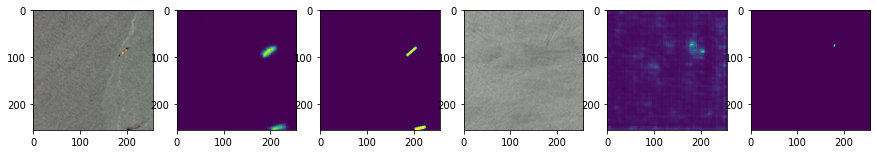

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5540 - accuracy: 0.9959 - val_loss: 0.0122 - val_dice_loss: 0.6859 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5675 - accuracy: 0.9956 - val_loss: 0.0121 - val_dice_loss: 0.6837 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5281 - accuracy: 0.9961 - val_loss: 0.0121 - val_dice_loss: 0.6822 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5159 - accuracy: 0.9961 - val_loss: 0.0121 - val_dice_loss: 0.6801 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.5271 - accuracy: 0.9962 - val_loss: 0.0121 - val_dice_loss: 0.6773 - val_accuracy: 0.9964


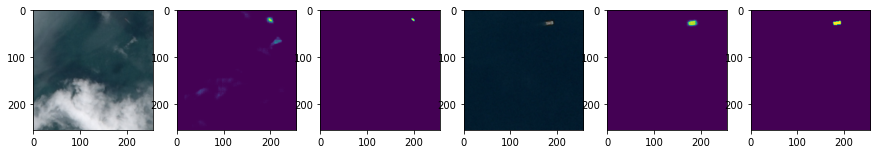

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0083 - dice_loss: 0.3760 - accuracy: 0.9969 - val_loss: 0.0141 - val_dice_loss: 0.6440 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.3586 - accuracy: 0.9971 - val_loss: 0.0141 - val_dice_loss: 0.6425 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.3902 - accuracy: 0.9966 - val_loss: 0.0140 - val_dice_loss: 0.6401 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0082 - dice_loss: 0.3785 - accuracy: 0.9970 - val_loss: 0.0140 - val_dice_loss: 0.6393 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0074 - dice_loss: 0.3473 - accuracy: 0.9974 - val_loss: 0.0139 - val_dice_loss: 0.6373 - val_accuracy: 0.9955


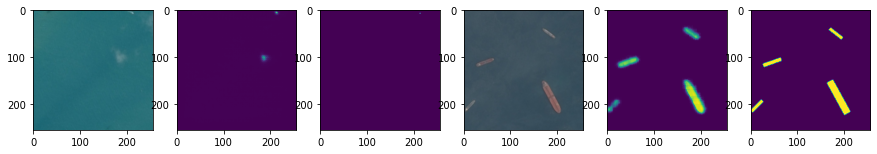

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.4264 - accuracy: 0.9971 - val_loss: 0.0080 - val_dice_loss: 0.3805 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.3845 - accuracy: 0.9971 - val_loss: 0.0079 - val_dice_loss: 0.3774 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.4792 - accuracy: 0.9969 - val_loss: 0.0078 - val_dice_loss: 0.3739 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.3932 - accuracy: 0.9971 - val_loss: 0.0077 - val_dice_loss: 0.3711 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.3580 - accuracy: 0.9973 - val_loss: 0.0077 - val_dice_loss: 0.3686 - val_accuracy: 0.9971


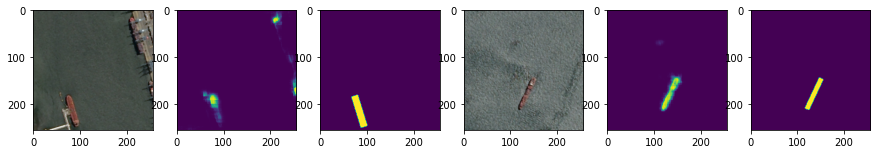

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6161 - accuracy: 0.9972 - val_loss: 0.0117 - val_dice_loss: 0.5814 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5350 - accuracy: 0.9979 - val_loss: 0.0118 - val_dice_loss: 0.5845 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5671 - accuracy: 0.9972 - val_loss: 0.0119 - val_dice_loss: 0.5868 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5716 - accuracy: 0.9973 - val_loss: 0.0120 - val_dice_loss: 0.5888 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5708 - accuracy: 0.9973 - val_loss: 0.0120 - val_dice_loss: 0.5868 - val_accuracy: 0.9966


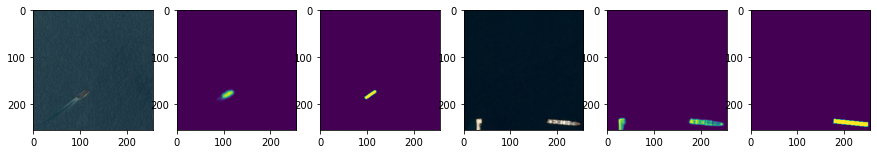

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.5321 - accuracy: 0.9982 - val_loss: 0.0095 - val_dice_loss: 0.5366 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0045 - dice_loss: 0.5257 - accuracy: 0.9983 - val_loss: 0.0095 - val_dice_loss: 0.5355 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0044 - dice_loss: 0.5082 - accuracy: 0.9982 - val_loss: 0.0096 - val_dice_loss: 0.5354 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0044 - dice_loss: 0.5197 - accuracy: 0.9983 - val_loss: 0.0096 - val_dice_loss: 0.5370 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0041 - dice_loss: 0.4785 - accuracy: 0.9983 - val_loss: 0.0097 - val_dice_loss: 0.5392 - val_accuracy: 0.9972


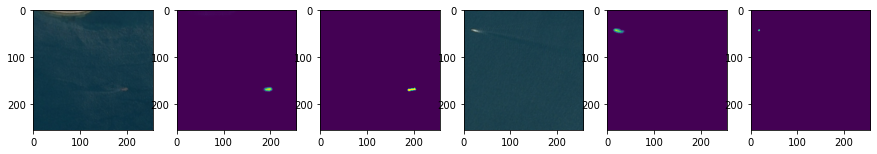

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5794 - accuracy: 0.9976 - val_loss: 0.0073 - val_dice_loss: 0.6077 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0054 - dice_loss: 0.5231 - accuracy: 0.9978 - val_loss: 0.0073 - val_dice_loss: 0.6067 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5111 - accuracy: 0.9978 - val_loss: 0.0074 - val_dice_loss: 0.6063 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0055 - dice_loss: 0.5584 - accuracy: 0.9978 - val_loss: 0.0073 - val_dice_loss: 0.6036 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5387 - accuracy: 0.9978 - val_loss: 0.0073 - val_dice_loss: 0.6010 - val_accuracy: 0.9973


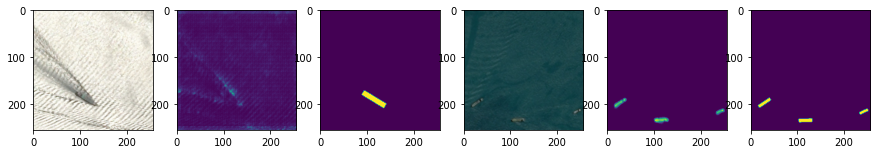

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5341 - accuracy: 0.9962 - val_loss: 0.0119 - val_dice_loss: 0.4241 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.4911 - accuracy: 0.9969 - val_loss: 0.0116 - val_dice_loss: 0.4175 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.4758 - accuracy: 0.9971 - val_loss: 0.0112 - val_dice_loss: 0.4112 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.4864 - accuracy: 0.9969 - val_loss: 0.0108 - val_dice_loss: 0.4072 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.4886 - accuracy: 0.9970 - val_loss: 0.0104 - val_dice_loss: 0.4055 - val_accuracy: 0.9967


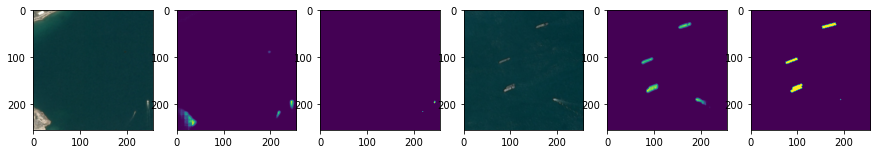

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.5236 - accuracy: 0.9973 - val_loss: 0.0075 - val_dice_loss: 0.5198 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.5000 - accuracy: 0.9974 - val_loss: 0.0077 - val_dice_loss: 0.5273 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.5028 - accuracy: 0.9971 - val_loss: 0.0080 - val_dice_loss: 0.5372 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.5054 - accuracy: 0.9974 - val_loss: 0.0084 - val_dice_loss: 0.5461 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.4659 - accuracy: 0.9979 - val_loss: 0.0087 - val_dice_loss: 0.5545 - val_accuracy: 0.9961


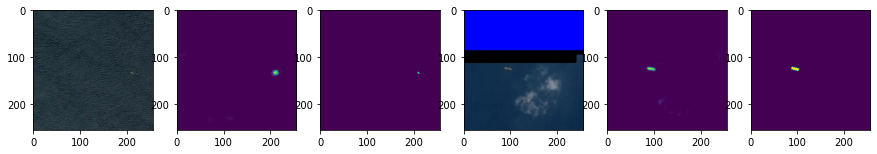

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0049 - dice_loss: 0.4982 - accuracy: 0.9984 - val_loss: 0.0066 - val_dice_loss: 0.5134 - val_accuracy: 0.9980
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0045 - dice_loss: 0.4225 - accuracy: 0.9984 - val_loss: 0.0067 - val_dice_loss: 0.5169 - val_accuracy: 0.9981
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0044 - dice_loss: 0.4225 - accuracy: 0.9986 - val_loss: 0.0067 - val_dice_loss: 0.5193 - val_accuracy: 0.9980
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.4397 - accuracy: 0.9984 - val_loss: 0.0067 - val_dice_loss: 0.5217 - val_accuracy: 0.9980
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0043 - dice_loss: 0.4375 - accuracy: 0.9985 - val_loss: 0.0068 - val_dice_loss: 0.5243 - val_accuracy: 0.9980


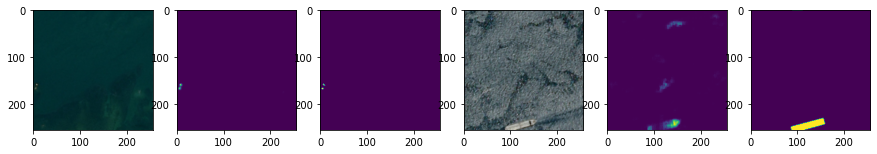

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.6046 - accuracy: 0.9951 - val_loss: 0.0064 - val_dice_loss: 0.4238 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.6050 - accuracy: 0.9953 - val_loss: 0.0066 - val_dice_loss: 0.4325 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5893 - accuracy: 0.9955 - val_loss: 0.0068 - val_dice_loss: 0.4424 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5862 - accuracy: 0.9964 - val_loss: 0.0070 - val_dice_loss: 0.4547 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5590 - accuracy: 0.9967 - val_loss: 0.0073 - val_dice_loss: 0.4669 - val_accuracy: 0.9974


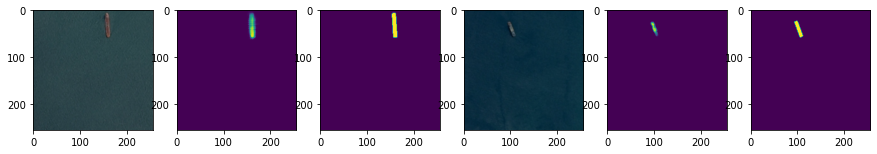

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5816 - accuracy: 0.9973 - val_loss: 0.0106 - val_dice_loss: 0.5168 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5858 - accuracy: 0.9973 - val_loss: 0.0105 - val_dice_loss: 0.5163 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5592 - accuracy: 0.9974 - val_loss: 0.0103 - val_dice_loss: 0.5158 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5836 - accuracy: 0.9973 - val_loss: 0.0102 - val_dice_loss: 0.5144 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5647 - accuracy: 0.9974 - val_loss: 0.0100 - val_dice_loss: 0.5121 - val_accuracy: 0.9963


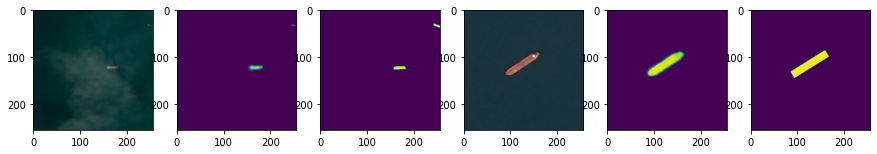

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.5259 - accuracy: 0.9971 - val_loss: 0.0118 - val_dice_loss: 0.7225 - val_accuracy: 0.9956
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.4681 - accuracy: 0.9975 - val_loss: 0.0116 - val_dice_loss: 0.7186 - val_accuracy: 0.9958
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4265 - accuracy: 0.9977 - val_loss: 0.0115 - val_dice_loss: 0.7147 - val_accuracy: 0.9959
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.4343 - accuracy: 0.9977 - val_loss: 0.0114 - val_dice_loss: 0.7113 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.4804 - accuracy: 0.9976 - val_loss: 0.0112 - val_dice_loss: 0.7072 - val_accuracy: 0.9960


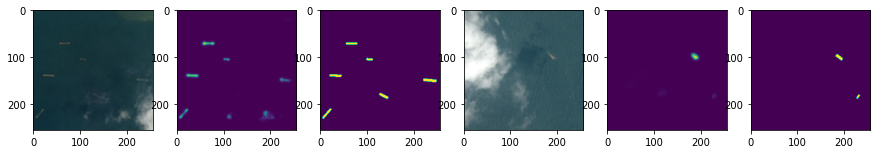

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.6923 - accuracy: 0.9967 - val_loss: 0.0104 - val_dice_loss: 0.5450 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.7017 - accuracy: 0.9968 - val_loss: 0.0104 - val_dice_loss: 0.5468 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.6643 - accuracy: 0.9967 - val_loss: 0.0103 - val_dice_loss: 0.5488 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.6560 - accuracy: 0.9969 - val_loss: 0.0103 - val_dice_loss: 0.5499 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6298 - accuracy: 0.9967 - val_loss: 0.0102 - val_dice_loss: 0.5516 - val_accuracy: 0.9962


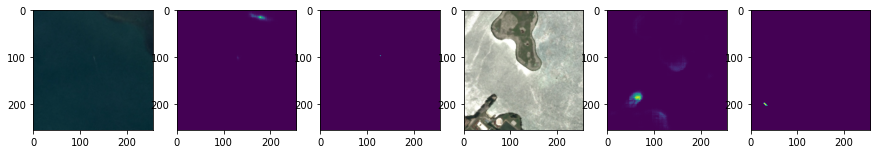

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0179 - dice_loss: 0.6476 - accuracy: 0.9965 - val_loss: 0.0096 - val_dice_loss: 0.5202 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0171 - dice_loss: 0.6599 - accuracy: 0.9964 - val_loss: 0.0098 - val_dice_loss: 0.5264 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0153 - dice_loss: 0.6909 - accuracy: 0.9964 - val_loss: 0.0099 - val_dice_loss: 0.5321 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.6393 - accuracy: 0.9964 - val_loss: 0.0102 - val_dice_loss: 0.5416 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6764 - accuracy: 0.9964 - val_loss: 0.0105 - val_dice_loss: 0.5544 - val_accuracy: 0.9968


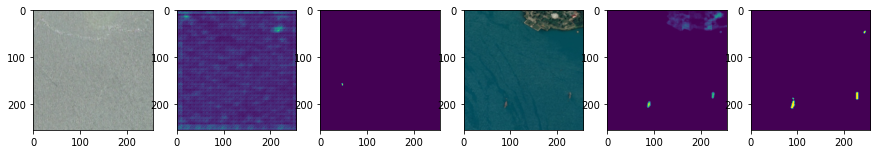

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.5973 - accuracy: 0.9985 - val_loss: 0.0127 - val_dice_loss: 0.5987 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.7470 - accuracy: 0.9985 - val_loss: 0.0131 - val_dice_loss: 0.6082 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.6305 - accuracy: 0.9985 - val_loss: 0.0131 - val_dice_loss: 0.6109 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.6034 - accuracy: 0.9983 - val_loss: 0.0129 - val_dice_loss: 0.6083 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.7059 - accuracy: 0.9986 - val_loss: 0.0126 - val_dice_loss: 0.6037 - val_accuracy: 0.9968


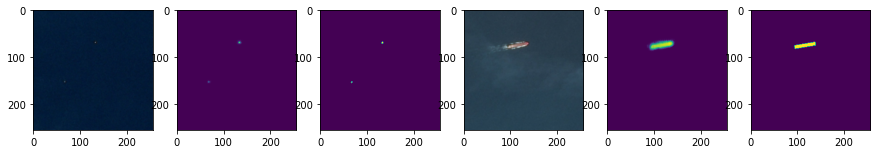

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.6761 - accuracy: 0.9974 - val_loss: 0.0121 - val_dice_loss: 0.6543 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6578 - accuracy: 0.9972 - val_loss: 0.0119 - val_dice_loss: 0.6548 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.6216 - accuracy: 0.9978 - val_loss: 0.0118 - val_dice_loss: 0.6545 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6517 - accuracy: 0.9972 - val_loss: 0.0117 - val_dice_loss: 0.6525 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0078 - dice_loss: 0.6894 - accuracy: 0.9968 - val_loss: 0.0116 - val_dice_loss: 0.6502 - val_accuracy: 0.9952


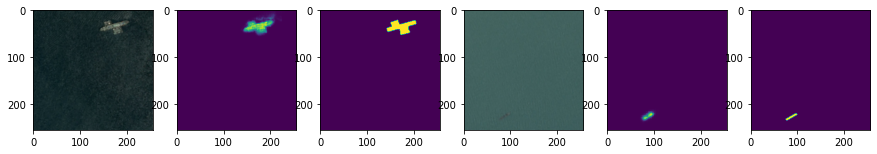

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.7646 - accuracy: 0.9970 - val_loss: 0.0097 - val_dice_loss: 0.5028 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0097 - dice_loss: 0.7190 - accuracy: 0.9972 - val_loss: 0.0097 - val_dice_loss: 0.4913 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.7169 - accuracy: 0.9969 - val_loss: 0.0096 - val_dice_loss: 0.4847 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.7143 - accuracy: 0.9967 - val_loss: 0.0097 - val_dice_loss: 0.4802 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.6687 - accuracy: 0.9976 - val_loss: 0.0097 - val_dice_loss: 0.4768 - val_accuracy: 0.9975


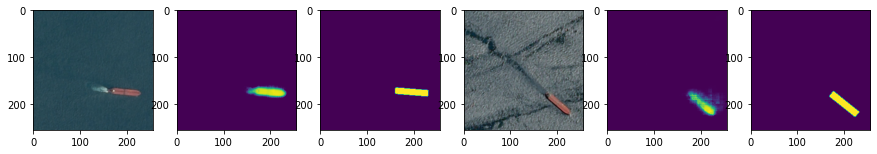

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0214 - dice_loss: 0.5598 - accuracy: 0.9940 - val_loss: 0.0077 - val_dice_loss: 0.5713 - val_accuracy: 0.9980
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0165 - dice_loss: 0.5514 - accuracy: 0.9945 - val_loss: 0.0080 - val_dice_loss: 0.5884 - val_accuracy: 0.9980
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.4593 - accuracy: 0.9949 - val_loss: 0.0090 - val_dice_loss: 0.6250 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0115 - dice_loss: 0.4280 - accuracy: 0.9954 - val_loss: 0.0105 - val_dice_loss: 0.6619 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.3988 - accuracy: 0.9964 - val_loss: 0.0122 - val_dice_loss: 0.6919 - val_accuracy: 0.9967


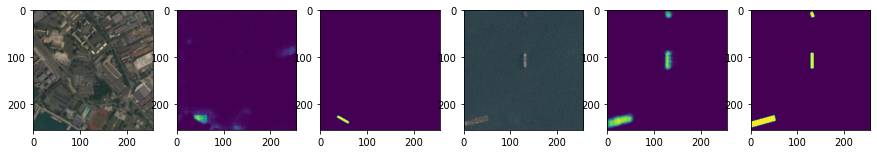

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0155 - dice_loss: 0.5669 - accuracy: 0.9941 - val_loss: 0.0115 - val_dice_loss: 0.6168 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.5868 - accuracy: 0.9942 - val_loss: 0.0113 - val_dice_loss: 0.6163 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5586 - accuracy: 0.9950 - val_loss: 0.0107 - val_dice_loss: 0.6105 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.5489 - accuracy: 0.9956 - val_loss: 0.0101 - val_dice_loss: 0.6029 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.5906 - accuracy: 0.9956 - val_loss: 0.0095 - val_dice_loss: 0.5957 - val_accuracy: 0.9971


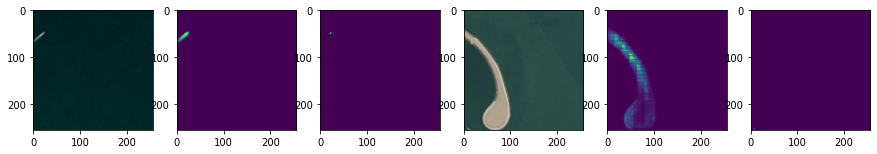

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.6479 - accuracy: 0.9961 - val_loss: 0.0081 - val_dice_loss: 0.7343 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.6514 - accuracy: 0.9963 - val_loss: 0.0078 - val_dice_loss: 0.7291 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0137 - dice_loss: 0.7363 - accuracy: 0.9958 - val_loss: 0.0077 - val_dice_loss: 0.7275 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.6284 - accuracy: 0.9963 - val_loss: 0.0077 - val_dice_loss: 0.7306 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.6181 - accuracy: 0.9962 - val_loss: 0.0079 - val_dice_loss: 0.7375 - val_accuracy: 0.9973


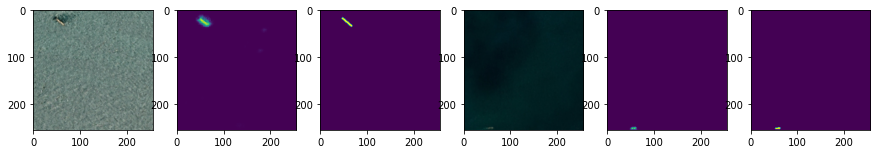

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0057 - dice_loss: 0.5449 - accuracy: 0.9979 - val_loss: 0.0082 - val_dice_loss: 0.4943 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0056 - dice_loss: 0.5929 - accuracy: 0.9977 - val_loss: 0.0084 - val_dice_loss: 0.5003 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0057 - dice_loss: 0.6290 - accuracy: 0.9976 - val_loss: 0.0085 - val_dice_loss: 0.5072 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0052 - dice_loss: 0.5251 - accuracy: 0.9977 - val_loss: 0.0087 - val_dice_loss: 0.5122 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0047 - dice_loss: 0.5163 - accuracy: 0.9978 - val_loss: 0.0088 - val_dice_loss: 0.5156 - val_accuracy: 0.9970


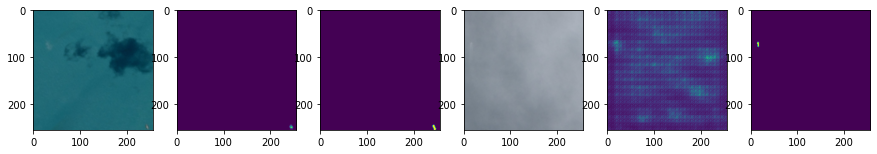

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.5905 - accuracy: 0.9966 - val_loss: 0.0119 - val_dice_loss: 0.5871 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5497 - accuracy: 0.9969 - val_loss: 0.0118 - val_dice_loss: 0.5826 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5272 - accuracy: 0.9970 - val_loss: 0.0116 - val_dice_loss: 0.5720 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5578 - accuracy: 0.9970 - val_loss: 0.0114 - val_dice_loss: 0.5597 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5736 - accuracy: 0.9968 - val_loss: 0.0112 - val_dice_loss: 0.5485 - val_accuracy: 0.9965


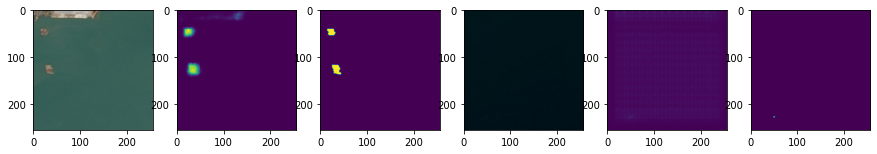

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0178 - dice_loss: 0.5739 - accuracy: 0.9944 - val_loss: 0.0089 - val_dice_loss: 0.5981 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.5540 - accuracy: 0.9945 - val_loss: 0.0088 - val_dice_loss: 0.5950 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.5363 - accuracy: 0.9947 - val_loss: 0.0086 - val_dice_loss: 0.5921 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.5257 - accuracy: 0.9949 - val_loss: 0.0086 - val_dice_loss: 0.5918 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.5044 - accuracy: 0.9949 - val_loss: 0.0086 - val_dice_loss: 0.5933 - val_accuracy: 0.9968


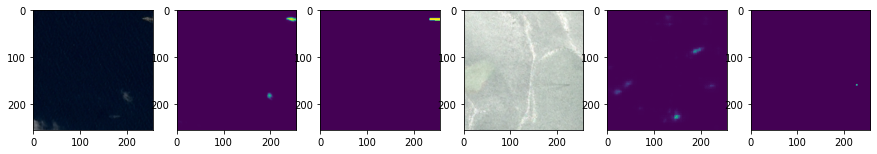

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5111 - accuracy: 0.9970 - val_loss: 0.0119 - val_dice_loss: 0.7689 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.4965 - accuracy: 0.9967 - val_loss: 0.0117 - val_dice_loss: 0.7752 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.4893 - accuracy: 0.9970 - val_loss: 0.0117 - val_dice_loss: 0.7800 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.4779 - accuracy: 0.9972 - val_loss: 0.0118 - val_dice_loss: 0.7840 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.4539 - accuracy: 0.9977 - val_loss: 0.0118 - val_dice_loss: 0.7877 - val_accuracy: 0.9971


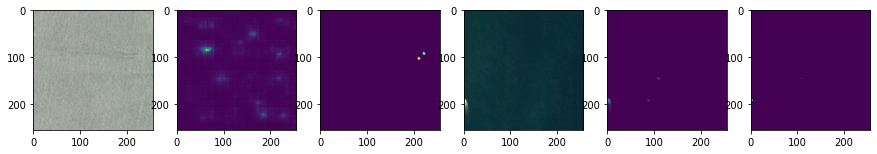

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0197 - dice_loss: 0.5607 - accuracy: 0.9953 - val_loss: 0.0070 - val_dice_loss: 0.5741 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0187 - dice_loss: 0.5458 - accuracy: 0.9953 - val_loss: 0.0070 - val_dice_loss: 0.5743 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0183 - dice_loss: 0.5450 - accuracy: 0.9954 - val_loss: 0.0069 - val_dice_loss: 0.5720 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0196 - dice_loss: 0.6770 - accuracy: 0.9944 - val_loss: 0.0068 - val_dice_loss: 0.5752 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.5190 - accuracy: 0.9960 - val_loss: 0.0068 - val_dice_loss: 0.5809 - val_accuracy: 0.9976


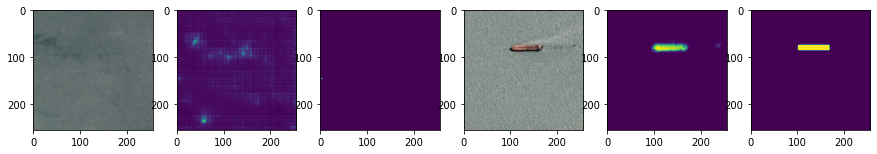

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.6406 - accuracy: 0.9969 - val_loss: 0.0081 - val_dice_loss: 0.5460 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6542 - accuracy: 0.9967 - val_loss: 0.0083 - val_dice_loss: 0.5514 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6425 - accuracy: 0.9966 - val_loss: 0.0084 - val_dice_loss: 0.5555 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.6530 - accuracy: 0.9967 - val_loss: 0.0086 - val_dice_loss: 0.5595 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.6483 - accuracy: 0.9966 - val_loss: 0.0088 - val_dice_loss: 0.5641 - val_accuracy: 0.9969


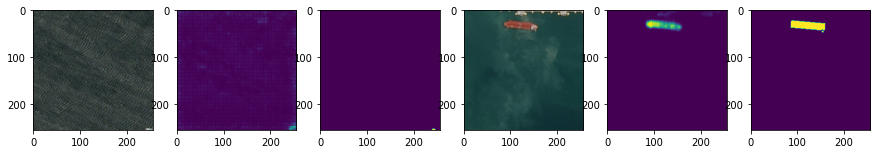

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5266 - accuracy: 0.9981 - val_loss: 0.0099 - val_dice_loss: 0.5486 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.5412 - accuracy: 0.9980 - val_loss: 0.0101 - val_dice_loss: 0.5507 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.5407 - accuracy: 0.9979 - val_loss: 0.0101 - val_dice_loss: 0.5513 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.5055 - accuracy: 0.9981 - val_loss: 0.0102 - val_dice_loss: 0.5492 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.4955 - accuracy: 0.9981 - val_loss: 0.0102 - val_dice_loss: 0.5463 - val_accuracy: 0.9974


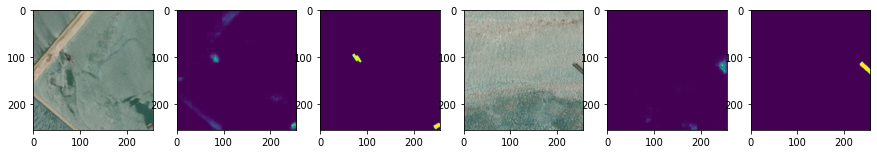

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.5389 - accuracy: 0.9981 - val_loss: 0.0143 - val_dice_loss: 0.5394 - val_accuracy: 0.9945
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6737 - accuracy: 0.9978 - val_loss: 0.0143 - val_dice_loss: 0.5406 - val_accuracy: 0.9945
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5381 - accuracy: 0.9980 - val_loss: 0.0142 - val_dice_loss: 0.5384 - val_accuracy: 0.9945
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5369 - accuracy: 0.9983 - val_loss: 0.0140 - val_dice_loss: 0.5349 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5849 - accuracy: 0.9982 - val_loss: 0.0139 - val_dice_loss: 0.5332 - val_accuracy: 0.9947


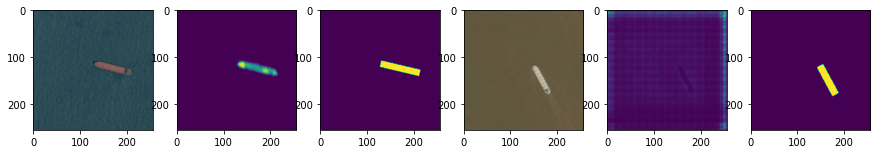

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.6888 - accuracy: 0.9954 - val_loss: 0.0105 - val_dice_loss: 0.5086 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0133 - dice_loss: 0.6234 - accuracy: 0.9960 - val_loss: 0.0097 - val_dice_loss: 0.4737 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.5943 - accuracy: 0.9962 - val_loss: 0.0090 - val_dice_loss: 0.4437 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6336 - accuracy: 0.9959 - val_loss: 0.0085 - val_dice_loss: 0.4240 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5674 - accuracy: 0.9965 - val_loss: 0.0083 - val_dice_loss: 0.4106 - val_accuracy: 0.9968


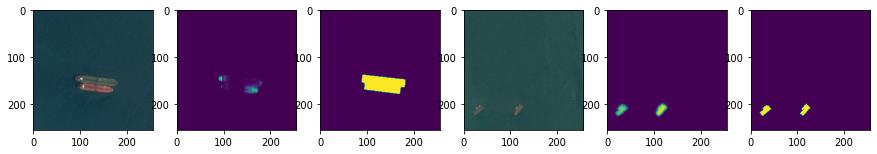

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0200 - dice_loss: 0.6822 - accuracy: 0.9933 - val_loss: 0.0197 - val_dice_loss: 0.6419 - val_accuracy: 0.9946
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.5788 - accuracy: 0.9940 - val_loss: 0.0181 - val_dice_loss: 0.6194 - val_accuracy: 0.9946
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0150 - dice_loss: 0.5322 - accuracy: 0.9944 - val_loss: 0.0165 - val_dice_loss: 0.5921 - val_accuracy: 0.9946
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0140 - dice_loss: 0.4837 - accuracy: 0.9950 - val_loss: 0.0153 - val_dice_loss: 0.5680 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0130 - dice_loss: 0.4860 - accuracy: 0.9952 - val_loss: 0.0142 - val_dice_loss: 0.5440 - val_accuracy: 0.9946


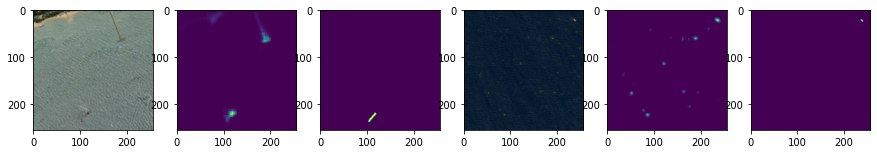

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5521 - accuracy: 0.9953 - val_loss: 0.0095 - val_dice_loss: 0.4958 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0157 - dice_loss: 0.6510 - accuracy: 0.9943 - val_loss: 0.0098 - val_dice_loss: 0.5030 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5858 - accuracy: 0.9952 - val_loss: 0.0099 - val_dice_loss: 0.5075 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.5574 - accuracy: 0.9955 - val_loss: 0.0099 - val_dice_loss: 0.5107 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5687 - accuracy: 0.9956 - val_loss: 0.0098 - val_dice_loss: 0.5131 - val_accuracy: 0.9953


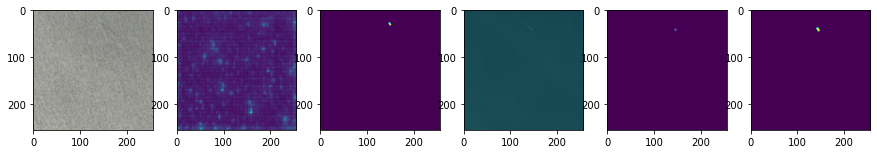

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0116 - dice_loss: 0.4937 - accuracy: 0.9955 - val_loss: 0.0199 - val_dice_loss: 0.6128 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0111 - dice_loss: 0.4850 - accuracy: 0.9961 - val_loss: 0.0196 - val_dice_loss: 0.6119 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.4680 - accuracy: 0.9954 - val_loss: 0.0193 - val_dice_loss: 0.6121 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.4430 - accuracy: 0.9962 - val_loss: 0.0192 - val_dice_loss: 0.6166 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4607 - accuracy: 0.9963 - val_loss: 0.0193 - val_dice_loss: 0.6263 - val_accuracy: 0.9951


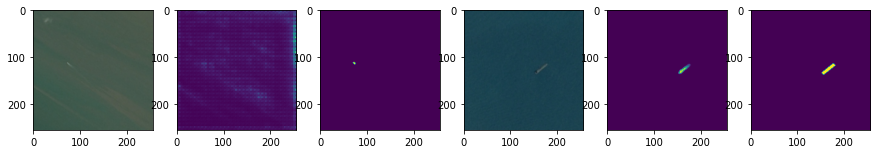

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5094 - accuracy: 0.9966 - val_loss: 0.0148 - val_dice_loss: 0.6405 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5062 - accuracy: 0.9964 - val_loss: 0.0151 - val_dice_loss: 0.6482 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4639 - accuracy: 0.9972 - val_loss: 0.0151 - val_dice_loss: 0.6466 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5115 - accuracy: 0.9966 - val_loss: 0.0149 - val_dice_loss: 0.6389 - val_accuracy: 0.9953
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.4981 - accuracy: 0.9969 - val_loss: 0.0148 - val_dice_loss: 0.6334 - val_accuracy: 0.9954


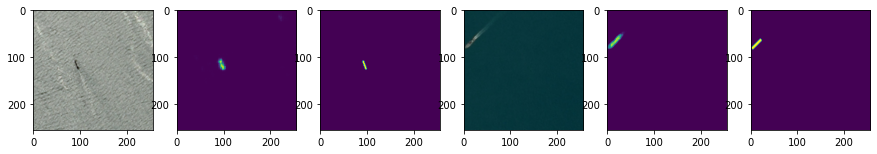

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0142 - dice_loss: 0.6662 - accuracy: 0.9957 - val_loss: 0.0120 - val_dice_loss: 0.5882 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.5254 - accuracy: 0.9962 - val_loss: 0.0118 - val_dice_loss: 0.5743 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.5193 - accuracy: 0.9962 - val_loss: 0.0117 - val_dice_loss: 0.5644 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5811 - accuracy: 0.9961 - val_loss: 0.0116 - val_dice_loss: 0.5578 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.4984 - accuracy: 0.9960 - val_loss: 0.0116 - val_dice_loss: 0.5501 - val_accuracy: 0.9970


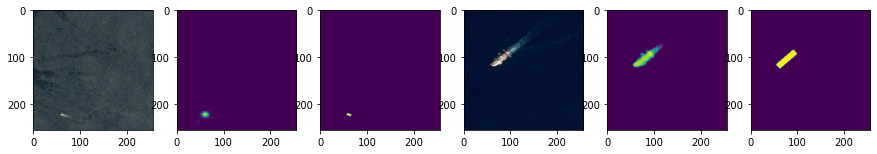

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0291 - dice_loss: 0.4917 - accuracy: 0.9920 - val_loss: 0.0147 - val_dice_loss: 0.6937 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0281 - dice_loss: 0.4735 - accuracy: 0.9923 - val_loss: 0.0152 - val_dice_loss: 0.6989 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0243 - dice_loss: 0.4284 - accuracy: 0.9935 - val_loss: 0.0156 - val_dice_loss: 0.7083 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0238 - dice_loss: 0.4247 - accuracy: 0.9933 - val_loss: 0.0160 - val_dice_loss: 0.7196 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0214 - dice_loss: 0.4275 - accuracy: 0.9938 - val_loss: 0.0161 - val_dice_loss: 0.7249 - val_accuracy: 0.9958


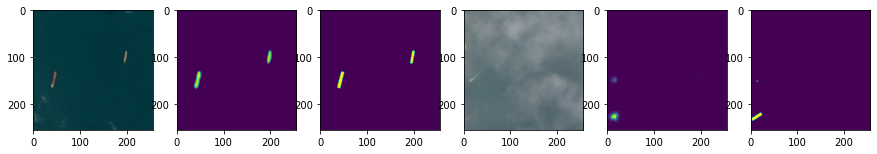

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.5953 - accuracy: 0.9951 - val_loss: 0.0090 - val_dice_loss: 0.3674 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0147 - dice_loss: 0.5824 - accuracy: 0.9945 - val_loss: 0.0090 - val_dice_loss: 0.3703 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5749 - accuracy: 0.9954 - val_loss: 0.0090 - val_dice_loss: 0.3740 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.5447 - accuracy: 0.9959 - val_loss: 0.0089 - val_dice_loss: 0.3795 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.5388 - accuracy: 0.9964 - val_loss: 0.0090 - val_dice_loss: 0.3870 - val_accuracy: 0.9967


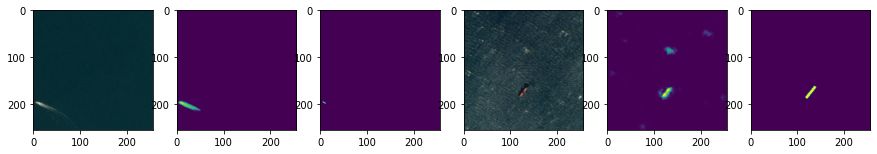

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.7484 - accuracy: 0.9952 - val_loss: 0.0205 - val_dice_loss: 0.6218 - val_accuracy: 0.9940
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0118 - dice_loss: 0.7095 - accuracy: 0.9957 - val_loss: 0.0208 - val_dice_loss: 0.6268 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0110 - dice_loss: 0.6967 - accuracy: 0.9961 - val_loss: 0.0213 - val_dice_loss: 0.6353 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.6602 - accuracy: 0.9961 - val_loss: 0.0218 - val_dice_loss: 0.6445 - val_accuracy: 0.9942
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6964 - accuracy: 0.9963 - val_loss: 0.0220 - val_dice_loss: 0.6517 - val_accuracy: 0.9942


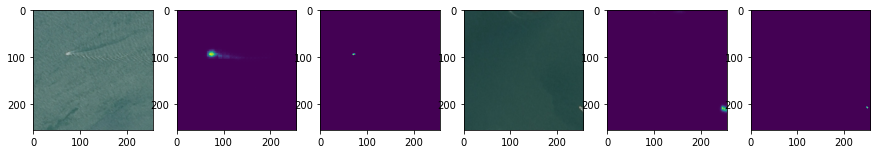

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.4372 - accuracy: 0.9977 - val_loss: 0.0133 - val_dice_loss: 0.5618 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.4806 - accuracy: 0.9973 - val_loss: 0.0136 - val_dice_loss: 0.5716 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4219 - accuracy: 0.9980 - val_loss: 0.0139 - val_dice_loss: 0.5821 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.3869 - accuracy: 0.9980 - val_loss: 0.0143 - val_dice_loss: 0.5944 - val_accuracy: 0.9948
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.4450 - accuracy: 0.9980 - val_loss: 0.0146 - val_dice_loss: 0.6040 - val_accuracy: 0.9947


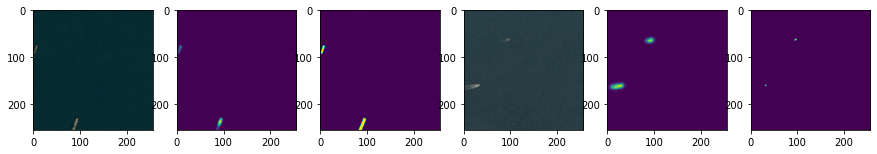

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.5852 - accuracy: 0.9964 - val_loss: 0.0040 - val_dice_loss: 0.6783 - val_accuracy: 0.9986
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.5577 - accuracy: 0.9966 - val_loss: 0.0040 - val_dice_loss: 0.6791 - val_accuracy: 0.9986
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.5823 - accuracy: 0.9968 - val_loss: 0.0040 - val_dice_loss: 0.6789 - val_accuracy: 0.9986
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.5466 - accuracy: 0.9976 - val_loss: 0.0039 - val_dice_loss: 0.6774 - val_accuracy: 0.9986
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5345 - accuracy: 0.9976 - val_loss: 0.0039 - val_dice_loss: 0.6749 - val_accuracy: 0.9986


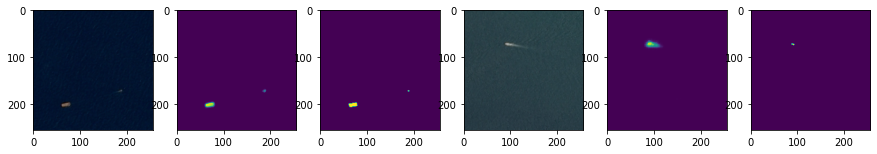

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.5076 - accuracy: 0.9972 - val_loss: 0.0113 - val_dice_loss: 0.6477 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.4703 - accuracy: 0.9976 - val_loss: 0.0113 - val_dice_loss: 0.6461 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.4930 - accuracy: 0.9976 - val_loss: 0.0113 - val_dice_loss: 0.6442 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.4760 - accuracy: 0.9977 - val_loss: 0.0113 - val_dice_loss: 0.6417 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.4563 - accuracy: 0.9979 - val_loss: 0.0112 - val_dice_loss: 0.6396 - val_accuracy: 0.9973


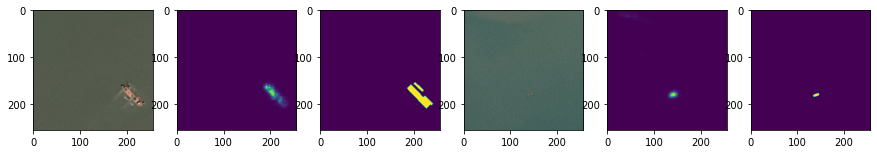

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6092 - accuracy: 0.9967 - val_loss: 0.0064 - val_dice_loss: 0.6088 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.6018 - accuracy: 0.9967 - val_loss: 0.0062 - val_dice_loss: 0.5843 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5431 - accuracy: 0.9973 - val_loss: 0.0061 - val_dice_loss: 0.5660 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5307 - accuracy: 0.9971 - val_loss: 0.0060 - val_dice_loss: 0.5561 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5028 - accuracy: 0.9974 - val_loss: 0.0061 - val_dice_loss: 0.5518 - val_accuracy: 0.9976


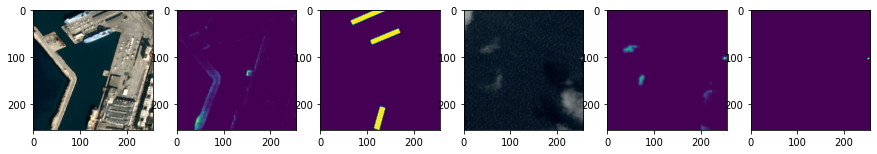

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.6420 - accuracy: 0.9978 - val_loss: 0.0186 - val_dice_loss: 0.6817 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.6643 - accuracy: 0.9976 - val_loss: 0.0184 - val_dice_loss: 0.6790 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.6447 - accuracy: 0.9978 - val_loss: 0.0181 - val_dice_loss: 0.6768 - val_accuracy: 0.9948
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0088 - dice_loss: 0.6206 - accuracy: 0.9978 - val_loss: 0.0180 - val_dice_loss: 0.6764 - val_accuracy: 0.9947
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.6333 - accuracy: 0.9977 - val_loss: 0.0180 - val_dice_loss: 0.6770 - val_accuracy: 0.9945


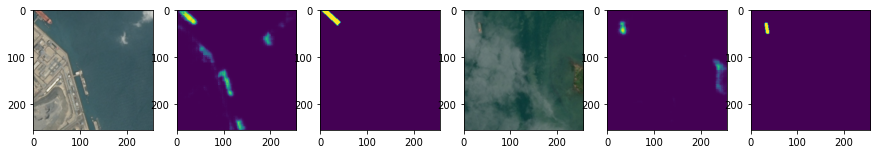

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0148 - dice_loss: 0.5465 - accuracy: 0.9955 - val_loss: 0.0132 - val_dice_loss: 0.4209 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0145 - dice_loss: 0.5460 - accuracy: 0.9957 - val_loss: 0.0132 - val_dice_loss: 0.4225 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.5502 - accuracy: 0.9954 - val_loss: 0.0132 - val_dice_loss: 0.4258 - val_accuracy: 0.9954
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.5314 - accuracy: 0.9957 - val_loss: 0.0133 - val_dice_loss: 0.4271 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0126 - dice_loss: 0.5407 - accuracy: 0.9960 - val_loss: 0.0132 - val_dice_loss: 0.4254 - val_accuracy: 0.9956


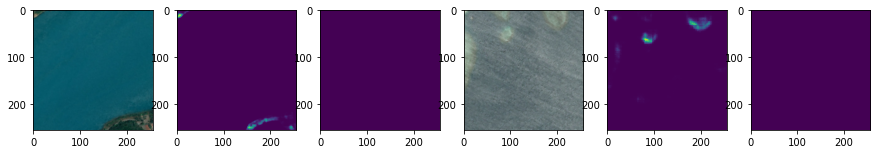

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0069 - dice_loss: 0.5891 - accuracy: 0.9976 - val_loss: 0.0112 - val_dice_loss: 0.5827 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0073 - dice_loss: 0.6261 - accuracy: 0.9975 - val_loss: 0.0108 - val_dice_loss: 0.5701 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0060 - dice_loss: 0.5476 - accuracy: 0.9979 - val_loss: 0.0102 - val_dice_loss: 0.5515 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0059 - dice_loss: 0.5531 - accuracy: 0.9979 - val_loss: 0.0098 - val_dice_loss: 0.5345 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6536 - accuracy: 0.9969 - val_loss: 0.0097 - val_dice_loss: 0.5238 - val_accuracy: 0.9971


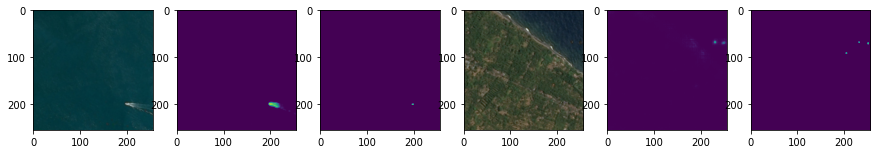

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.6484 - accuracy: 0.9980 - val_loss: 0.0174 - val_dice_loss: 0.6926 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0052 - dice_loss: 0.6146 - accuracy: 0.9984 - val_loss: 0.0176 - val_dice_loss: 0.6951 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0057 - dice_loss: 0.6428 - accuracy: 0.9983 - val_loss: 0.0180 - val_dice_loss: 0.7000 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.7016 - accuracy: 0.9986 - val_loss: 0.0188 - val_dice_loss: 0.7056 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0050 - dice_loss: 0.5886 - accuracy: 0.9985 - val_loss: 0.0194 - val_dice_loss: 0.7120 - val_accuracy: 0.9954


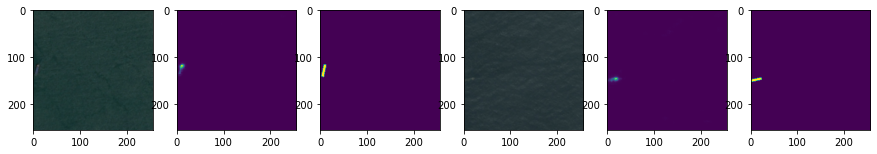

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0050 - dice_loss: 0.6359 - accuracy: 0.9988 - val_loss: 0.0061 - val_dice_loss: 0.5687 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0041 - dice_loss: 0.6275 - accuracy: 0.9989 - val_loss: 0.0063 - val_dice_loss: 0.5774 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0046 - dice_loss: 0.6882 - accuracy: 0.9986 - val_loss: 0.0065 - val_dice_loss: 0.5895 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0042 - dice_loss: 0.6417 - accuracy: 0.9988 - val_loss: 0.0067 - val_dice_loss: 0.6023 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0046 - dice_loss: 0.6844 - accuracy: 0.9984 - val_loss: 0.0069 - val_dice_loss: 0.6151 - val_accuracy: 0.9975


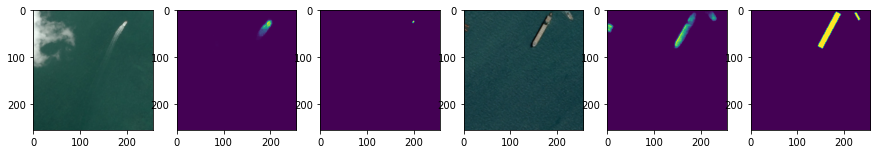

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4814 - accuracy: 0.9971 - val_loss: 0.0064 - val_dice_loss: 0.7132 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4656 - accuracy: 0.9971 - val_loss: 0.0063 - val_dice_loss: 0.7083 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.5083 - accuracy: 0.9971 - val_loss: 0.0060 - val_dice_loss: 0.6957 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.4483 - accuracy: 0.9972 - val_loss: 0.0058 - val_dice_loss: 0.6826 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.4388 - accuracy: 0.9973 - val_loss: 0.0055 - val_dice_loss: 0.6680 - val_accuracy: 0.9979


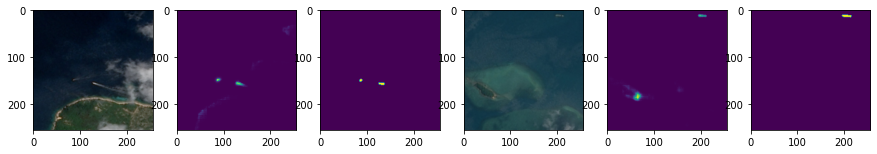

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.6382 - accuracy: 0.9972 - val_loss: 0.0098 - val_dice_loss: 0.5745 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.5211 - accuracy: 0.9977 - val_loss: 0.0097 - val_dice_loss: 0.5699 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.6224 - accuracy: 0.9973 - val_loss: 0.0096 - val_dice_loss: 0.5654 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.5326 - accuracy: 0.9977 - val_loss: 0.0095 - val_dice_loss: 0.5620 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0057 - dice_loss: 0.4913 - accuracy: 0.9978 - val_loss: 0.0095 - val_dice_loss: 0.5595 - val_accuracy: 0.9972


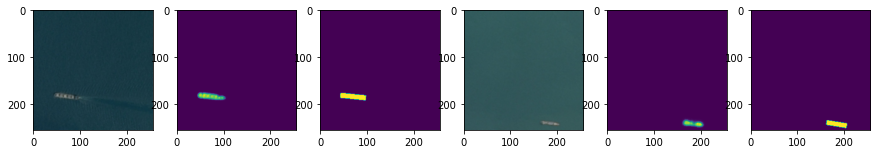

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0104 - dice_loss: 0.5708 - accuracy: 0.9956 - val_loss: 0.0113 - val_dice_loss: 0.4943 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.5404 - accuracy: 0.9955 - val_loss: 0.0113 - val_dice_loss: 0.4943 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.5436 - accuracy: 0.9961 - val_loss: 0.0112 - val_dice_loss: 0.4942 - val_accuracy: 0.9962
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.5747 - accuracy: 0.9965 - val_loss: 0.0112 - val_dice_loss: 0.4942 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5664 - accuracy: 0.9965 - val_loss: 0.0112 - val_dice_loss: 0.4950 - val_accuracy: 0.9962


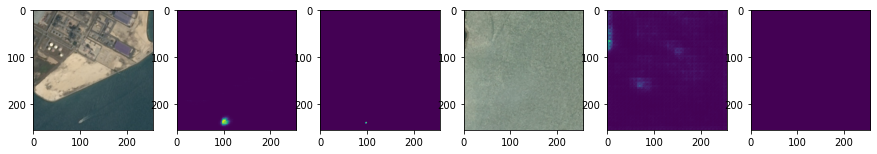

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.6615 - accuracy: 0.9967 - val_loss: 0.0069 - val_dice_loss: 0.5279 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.6255 - accuracy: 0.9968 - val_loss: 0.0069 - val_dice_loss: 0.5260 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6017 - accuracy: 0.9971 - val_loss: 0.0069 - val_dice_loss: 0.5221 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.6027 - accuracy: 0.9972 - val_loss: 0.0069 - val_dice_loss: 0.5182 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.6352 - accuracy: 0.9970 - val_loss: 0.0070 - val_dice_loss: 0.5148 - val_accuracy: 0.9979


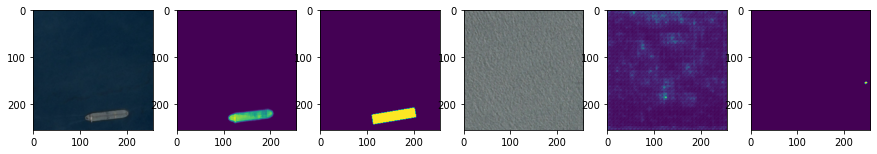

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.4939 - accuracy: 0.9981 - val_loss: 0.0199 - val_dice_loss: 0.5584 - val_accuracy: 0.9938
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5227 - accuracy: 0.9981 - val_loss: 0.0197 - val_dice_loss: 0.5561 - val_accuracy: 0.9939
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5063 - accuracy: 0.9980 - val_loss: 0.0194 - val_dice_loss: 0.5540 - val_accuracy: 0.9939
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.5072 - accuracy: 0.9981 - val_loss: 0.0193 - val_dice_loss: 0.5527 - val_accuracy: 0.9939
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0056 - dice_loss: 0.5113 - accuracy: 0.9980 - val_loss: 0.0191 - val_dice_loss: 0.5517 - val_accuracy: 0.9939


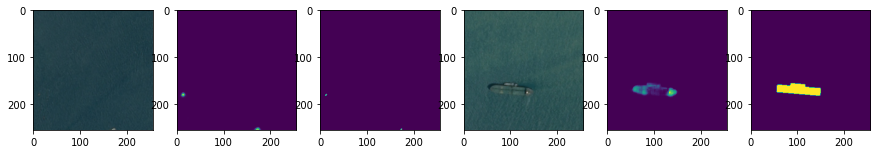

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0150 - dice_loss: 0.5546 - accuracy: 0.9945 - val_loss: 0.0119 - val_dice_loss: 0.5280 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0153 - dice_loss: 0.6087 - accuracy: 0.9947 - val_loss: 0.0116 - val_dice_loss: 0.5278 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0136 - dice_loss: 0.5326 - accuracy: 0.9948 - val_loss: 0.0113 - val_dice_loss: 0.5274 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0134 - dice_loss: 0.5374 - accuracy: 0.9947 - val_loss: 0.0112 - val_dice_loss: 0.5277 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.5639 - accuracy: 0.9948 - val_loss: 0.0112 - val_dice_loss: 0.5277 - val_accuracy: 0.9964


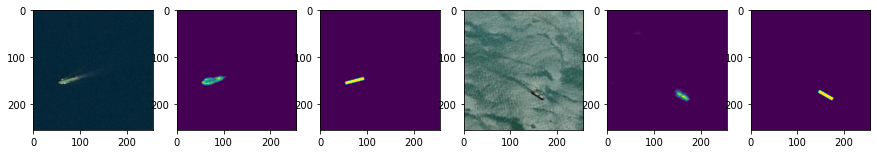

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0203 - dice_loss: 0.6704 - accuracy: 0.9937 - val_loss: 0.0134 - val_dice_loss: 0.5150 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0222 - dice_loss: 0.6719 - accuracy: 0.9942 - val_loss: 0.0132 - val_dice_loss: 0.5346 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6091 - accuracy: 0.9942 - val_loss: 0.0130 - val_dice_loss: 0.5510 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.5699 - accuracy: 0.9947 - val_loss: 0.0130 - val_dice_loss: 0.5732 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.5590 - accuracy: 0.9952 - val_loss: 0.0134 - val_dice_loss: 0.5972 - val_accuracy: 0.9959


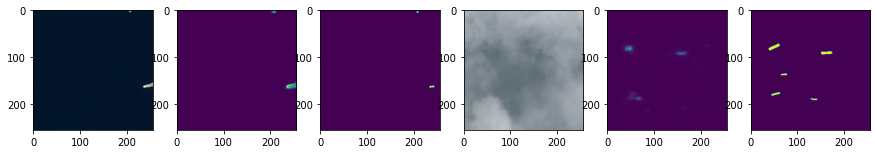

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0196 - dice_loss: 0.6175 - accuracy: 0.9957 - val_loss: 0.0125 - val_dice_loss: 0.5567 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.6168 - accuracy: 0.9957 - val_loss: 0.0123 - val_dice_loss: 0.5596 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.6468 - accuracy: 0.9959 - val_loss: 0.0119 - val_dice_loss: 0.5600 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.5590 - accuracy: 0.9959 - val_loss: 0.0121 - val_dice_loss: 0.5662 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0171 - dice_loss: 0.6111 - accuracy: 0.9955 - val_loss: 0.0127 - val_dice_loss: 0.5772 - val_accuracy: 0.9963


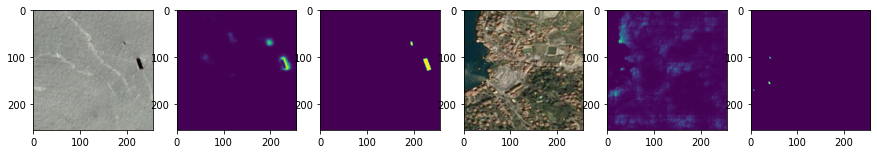

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.7495 - accuracy: 0.9950 - val_loss: 0.0098 - val_dice_loss: 0.5927 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.6804 - accuracy: 0.9954 - val_loss: 0.0096 - val_dice_loss: 0.5940 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.6824 - accuracy: 0.9954 - val_loss: 0.0096 - val_dice_loss: 0.5996 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.6535 - accuracy: 0.9955 - val_loss: 0.0097 - val_dice_loss: 0.6061 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0148 - dice_loss: 0.7061 - accuracy: 0.9948 - val_loss: 0.0098 - val_dice_loss: 0.6086 - val_accuracy: 0.9971


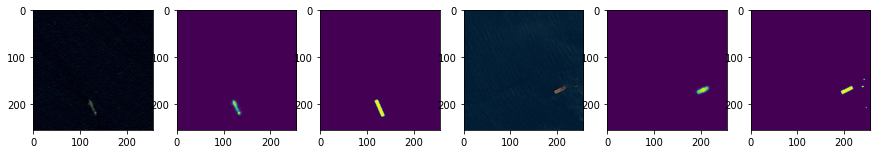

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0113 - dice_loss: 0.5173 - accuracy: 0.9966 - val_loss: 0.0197 - val_dice_loss: 0.5279 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5176 - accuracy: 0.9966 - val_loss: 0.0202 - val_dice_loss: 0.5232 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.4728 - accuracy: 0.9967 - val_loss: 0.0207 - val_dice_loss: 0.5196 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4997 - accuracy: 0.9966 - val_loss: 0.0211 - val_dice_loss: 0.5166 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.4400 - accuracy: 0.9972 - val_loss: 0.0213 - val_dice_loss: 0.5152 - val_accuracy: 0.9952


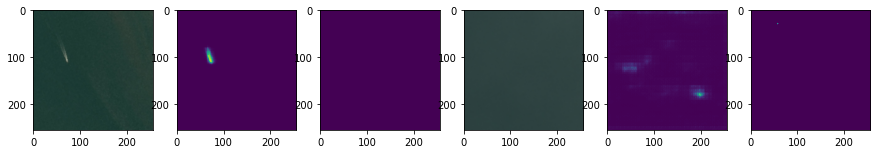

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.4999 - accuracy: 0.9966 - val_loss: 0.0104 - val_dice_loss: 0.7276 - val_accuracy: 0.9959
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0085 - dice_loss: 0.5394 - accuracy: 0.9971 - val_loss: 0.0103 - val_dice_loss: 0.7250 - val_accuracy: 0.9959
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5357 - accuracy: 0.9968 - val_loss: 0.0102 - val_dice_loss: 0.7215 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5035 - accuracy: 0.9971 - val_loss: 0.0100 - val_dice_loss: 0.7172 - val_accuracy: 0.9962
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.4983 - accuracy: 0.9969 - val_loss: 0.0097 - val_dice_loss: 0.7123 - val_accuracy: 0.9963


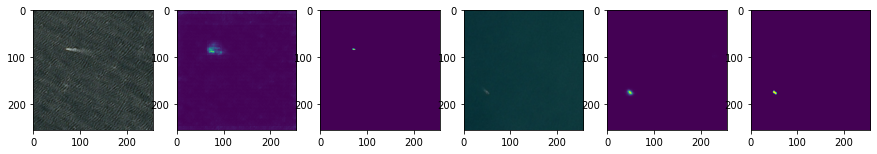

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0118 - dice_loss: 0.4564 - accuracy: 0.9961 - val_loss: 0.0106 - val_dice_loss: 0.5571 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4499 - accuracy: 0.9959 - val_loss: 0.0106 - val_dice_loss: 0.5554 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0120 - dice_loss: 0.4546 - accuracy: 0.9958 - val_loss: 0.0106 - val_dice_loss: 0.5546 - val_accuracy: 0.9968
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.3935 - accuracy: 0.9964 - val_loss: 0.0106 - val_dice_loss: 0.5549 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0108 - dice_loss: 0.3871 - accuracy: 0.9964 - val_loss: 0.0106 - val_dice_loss: 0.5559 - val_accuracy: 0.9966


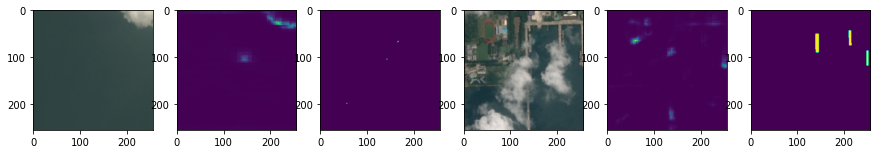

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0217 - dice_loss: 0.5566 - accuracy: 0.9940 - val_loss: 0.0162 - val_dice_loss: 0.6539 - val_accuracy: 0.9949
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0198 - dice_loss: 0.5173 - accuracy: 0.9944 - val_loss: 0.0160 - val_dice_loss: 0.6518 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0198 - dice_loss: 0.5365 - accuracy: 0.9945 - val_loss: 0.0156 - val_dice_loss: 0.6468 - val_accuracy: 0.9950
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0176 - dice_loss: 0.5440 - accuracy: 0.9945 - val_loss: 0.0151 - val_dice_loss: 0.6375 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.5068 - accuracy: 0.9948 - val_loss: 0.0148 - val_dice_loss: 0.6320 - val_accuracy: 0.9951


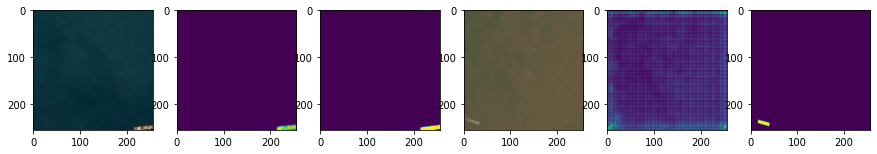

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4429 - accuracy: 0.9983 - val_loss: 0.0126 - val_dice_loss: 0.6066 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0067 - dice_loss: 0.4693 - accuracy: 0.9981 - val_loss: 0.0126 - val_dice_loss: 0.6118 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.4701 - accuracy: 0.9983 - val_loss: 0.0126 - val_dice_loss: 0.6187 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0059 - dice_loss: 0.5544 - accuracy: 0.9983 - val_loss: 0.0127 - val_dice_loss: 0.6277 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.4414 - accuracy: 0.9983 - val_loss: 0.0128 - val_dice_loss: 0.6367 - val_accuracy: 0.9968


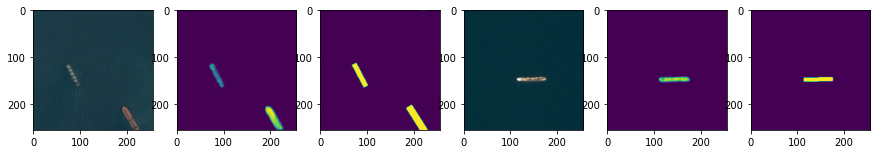

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0099 - dice_loss: 0.5335 - accuracy: 0.9969 - val_loss: 0.0238 - val_dice_loss: 0.5495 - val_accuracy: 0.9935
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5339 - accuracy: 0.9968 - val_loss: 0.0241 - val_dice_loss: 0.5536 - val_accuracy: 0.9934
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.5479 - accuracy: 0.9962 - val_loss: 0.0247 - val_dice_loss: 0.5562 - val_accuracy: 0.9934
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.5059 - accuracy: 0.9969 - val_loss: 0.0253 - val_dice_loss: 0.5568 - val_accuracy: 0.9934
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0102 - dice_loss: 0.5452 - accuracy: 0.9967 - val_loss: 0.0257 - val_dice_loss: 0.5583 - val_accuracy: 0.9934


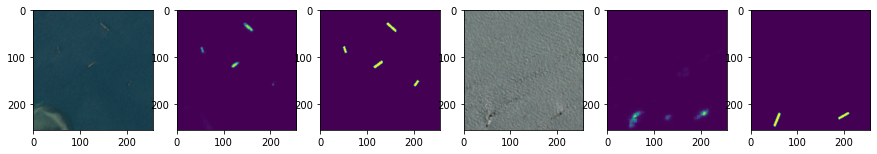

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.5309 - accuracy: 0.9974 - val_loss: 0.0085 - val_dice_loss: 0.4492 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0076 - dice_loss: 0.5167 - accuracy: 0.9974 - val_loss: 0.0083 - val_dice_loss: 0.4440 - val_accuracy: 0.9971
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0071 - dice_loss: 0.4882 - accuracy: 0.9975 - val_loss: 0.0081 - val_dice_loss: 0.4355 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.4956 - accuracy: 0.9975 - val_loss: 0.0079 - val_dice_loss: 0.4235 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.4779 - accuracy: 0.9975 - val_loss: 0.0077 - val_dice_loss: 0.4087 - val_accuracy: 0.9975


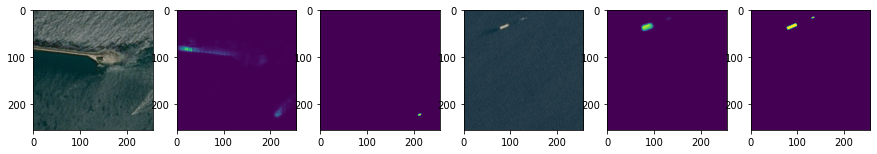

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0073 - dice_loss: 0.8506 - accuracy: 0.9980 - val_loss: 0.0086 - val_dice_loss: 0.4705 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.8462 - accuracy: 0.9981 - val_loss: 0.0087 - val_dice_loss: 0.4717 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.8229 - accuracy: 0.9983 - val_loss: 0.0088 - val_dice_loss: 0.4763 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0060 - dice_loss: 0.8151 - accuracy: 0.9984 - val_loss: 0.0089 - val_dice_loss: 0.4849 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0058 - dice_loss: 0.8026 - accuracy: 0.9984 - val_loss: 0.0091 - val_dice_loss: 0.4948 - val_accuracy: 0.9968


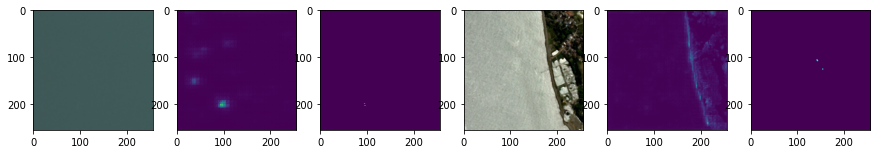

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.5896 - accuracy: 0.9979 - val_loss: 0.0099 - val_dice_loss: 0.6247 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.5999 - accuracy: 0.9982 - val_loss: 0.0102 - val_dice_loss: 0.6267 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0062 - dice_loss: 0.5747 - accuracy: 0.9981 - val_loss: 0.0102 - val_dice_loss: 0.6284 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.5995 - accuracy: 0.9981 - val_loss: 0.0099 - val_dice_loss: 0.6299 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.5954 - accuracy: 0.9981 - val_loss: 0.0098 - val_dice_loss: 0.6306 - val_accuracy: 0.9974


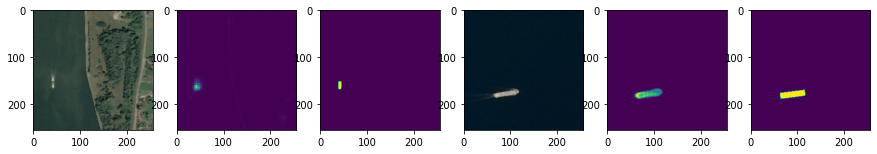

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.5186 - accuracy: 0.9964 - val_loss: 0.0154 - val_dice_loss: 0.6110 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.4898 - accuracy: 0.9968 - val_loss: 0.0151 - val_dice_loss: 0.6046 - val_accuracy: 0.9942
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5129 - accuracy: 0.9969 - val_loss: 0.0148 - val_dice_loss: 0.5974 - val_accuracy: 0.9942
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.4589 - accuracy: 0.9971 - val_loss: 0.0144 - val_dice_loss: 0.5894 - val_accuracy: 0.9943
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0077 - dice_loss: 0.4627 - accuracy: 0.9971 - val_loss: 0.0140 - val_dice_loss: 0.5807 - val_accuracy: 0.9943


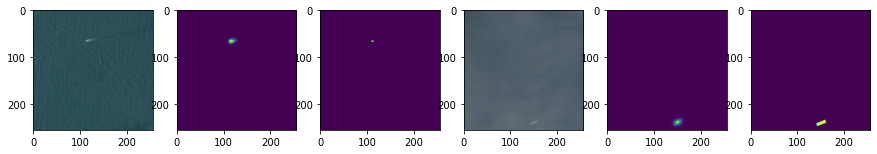

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.4712 - accuracy: 0.9974 - val_loss: 0.0102 - val_dice_loss: 0.4561 - val_accuracy: 0.9964
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0063 - dice_loss: 0.4484 - accuracy: 0.9974 - val_loss: 0.0103 - val_dice_loss: 0.4572 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0063 - dice_loss: 0.4497 - accuracy: 0.9973 - val_loss: 0.0103 - val_dice_loss: 0.4600 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0061 - dice_loss: 0.4515 - accuracy: 0.9977 - val_loss: 0.0105 - val_dice_loss: 0.4650 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0053 - dice_loss: 0.4175 - accuracy: 0.9979 - val_loss: 0.0106 - val_dice_loss: 0.4718 - val_accuracy: 0.9962


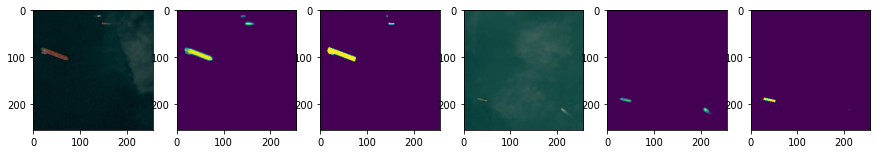

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.4560 - accuracy: 0.9969 - val_loss: 0.0074 - val_dice_loss: 0.4766 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0095 - dice_loss: 0.4675 - accuracy: 0.9969 - val_loss: 0.0075 - val_dice_loss: 0.4766 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0086 - dice_loss: 0.4516 - accuracy: 0.9969 - val_loss: 0.0073 - val_dice_loss: 0.4690 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0088 - dice_loss: 0.4684 - accuracy: 0.9968 - val_loss: 0.0072 - val_dice_loss: 0.4607 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0082 - dice_loss: 0.4422 - accuracy: 0.9971 - val_loss: 0.0071 - val_dice_loss: 0.4521 - val_accuracy: 0.9972


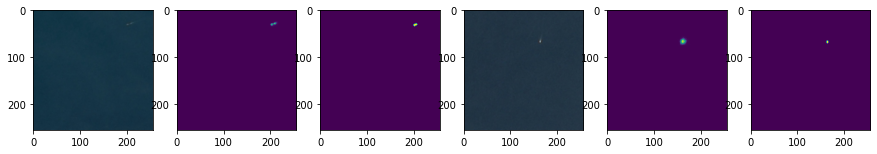

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.7113 - accuracy: 0.9969 - val_loss: 0.0060 - val_dice_loss: 0.5087 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0116 - dice_loss: 0.6546 - accuracy: 0.9971 - val_loss: 0.0060 - val_dice_loss: 0.5087 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.6600 - accuracy: 0.9968 - val_loss: 0.0060 - val_dice_loss: 0.5086 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6514 - accuracy: 0.9969 - val_loss: 0.0061 - val_dice_loss: 0.5107 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0111 - dice_loss: 0.6596 - accuracy: 0.9970 - val_loss: 0.0062 - val_dice_loss: 0.5155 - val_accuracy: 0.9972


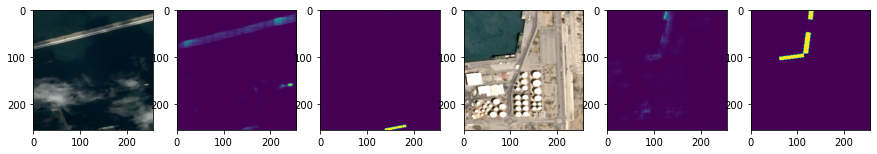

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0119 - dice_loss: 0.4919 - accuracy: 0.9962 - val_loss: 0.0135 - val_dice_loss: 0.6826 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 5s 2s/step - loss: 0.0116 - dice_loss: 0.5282 - accuracy: 0.9963 - val_loss: 0.0136 - val_dice_loss: 0.6810 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4643 - accuracy: 0.9969 - val_loss: 0.0141 - val_dice_loss: 0.6821 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.4839 - accuracy: 0.9968 - val_loss: 0.0146 - val_dice_loss: 0.6842 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.4686 - accuracy: 0.9973 - val_loss: 0.0154 - val_dice_loss: 0.6864 - val_accuracy: 0.9942


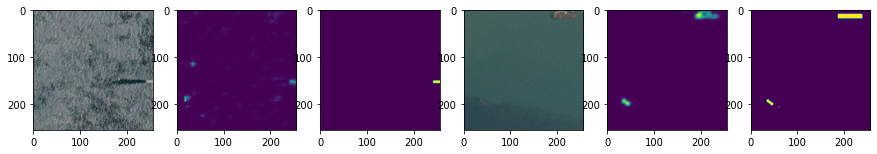

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5973 - accuracy: 0.9971 - val_loss: 0.0063 - val_dice_loss: 0.4364 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.6524 - accuracy: 0.9969 - val_loss: 0.0064 - val_dice_loss: 0.4382 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0081 - dice_loss: 0.6427 - accuracy: 0.9972 - val_loss: 0.0064 - val_dice_loss: 0.4401 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0076 - dice_loss: 0.6077 - accuracy: 0.9976 - val_loss: 0.0064 - val_dice_loss: 0.4420 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.5803 - accuracy: 0.9979 - val_loss: 0.0063 - val_dice_loss: 0.4422 - val_accuracy: 0.9973


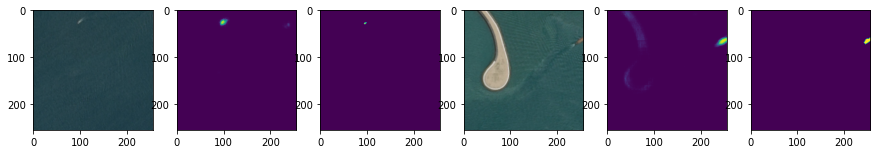

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0201 - dice_loss: 0.6947 - accuracy: 0.9948 - val_loss: 0.0154 - val_dice_loss: 0.6659 - val_accuracy: 0.9941
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0196 - dice_loss: 0.6974 - accuracy: 0.9948 - val_loss: 0.0152 - val_dice_loss: 0.6635 - val_accuracy: 0.9943
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0173 - dice_loss: 0.6415 - accuracy: 0.9951 - val_loss: 0.0151 - val_dice_loss: 0.6653 - val_accuracy: 0.9946
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0144 - dice_loss: 0.6927 - accuracy: 0.9947 - val_loss: 0.0150 - val_dice_loss: 0.6637 - val_accuracy: 0.9946
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0138 - dice_loss: 0.6411 - accuracy: 0.9950 - val_loss: 0.0147 - val_dice_loss: 0.6550 - val_accuracy: 0.9947


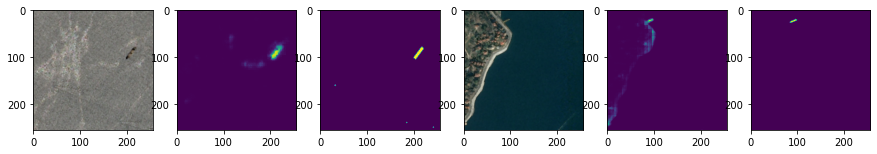

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.5957 - accuracy: 0.9975 - val_loss: 0.0152 - val_dice_loss: 0.6099 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6262 - accuracy: 0.9974 - val_loss: 0.0151 - val_dice_loss: 0.6044 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0090 - dice_loss: 0.5874 - accuracy: 0.9975 - val_loss: 0.0150 - val_dice_loss: 0.6001 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.5527 - accuracy: 0.9976 - val_loss: 0.0150 - val_dice_loss: 0.5968 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0069 - dice_loss: 0.4912 - accuracy: 0.9979 - val_loss: 0.0151 - val_dice_loss: 0.5952 - val_accuracy: 0.9962


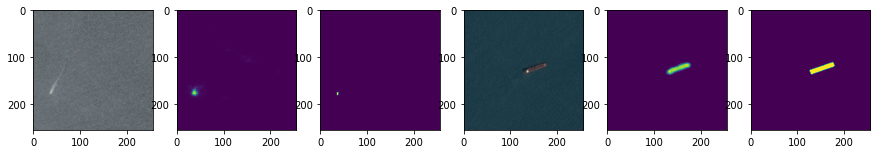

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0073 - dice_loss: 0.4335 - accuracy: 0.9974 - val_loss: 0.0156 - val_dice_loss: 0.6242 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0074 - dice_loss: 0.4207 - accuracy: 0.9976 - val_loss: 0.0156 - val_dice_loss: 0.6212 - val_accuracy: 0.9950
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0071 - dice_loss: 0.4018 - accuracy: 0.9976 - val_loss: 0.0154 - val_dice_loss: 0.6172 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0068 - dice_loss: 0.3782 - accuracy: 0.9978 - val_loss: 0.0153 - val_dice_loss: 0.6138 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0065 - dice_loss: 0.3631 - accuracy: 0.9979 - val_loss: 0.0151 - val_dice_loss: 0.6094 - val_accuracy: 0.9951


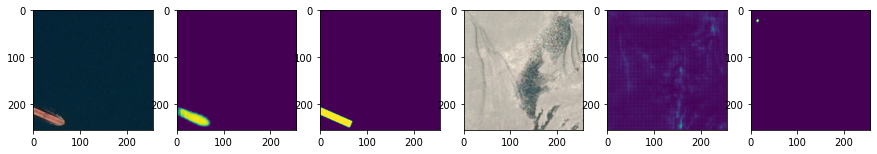

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0084 - dice_loss: 0.4779 - accuracy: 0.9969 - val_loss: 0.0098 - val_dice_loss: 0.3751 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.4862 - accuracy: 0.9970 - val_loss: 0.0097 - val_dice_loss: 0.3699 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.4910 - accuracy: 0.9969 - val_loss: 0.0096 - val_dice_loss: 0.3663 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0078 - dice_loss: 0.4426 - accuracy: 0.9970 - val_loss: 0.0096 - val_dice_loss: 0.3630 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0075 - dice_loss: 0.3979 - accuracy: 0.9971 - val_loss: 0.0096 - val_dice_loss: 0.3603 - val_accuracy: 0.9967


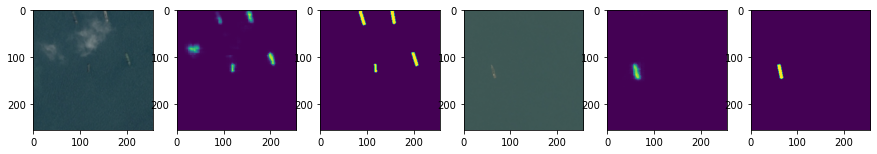

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.5737 - accuracy: 0.9949 - val_loss: 0.0090 - val_dice_loss: 0.6763 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 5s 4s/step - loss: 0.0129 - dice_loss: 0.5709 - accuracy: 0.9949 - val_loss: 0.0089 - val_dice_loss: 0.6713 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.5527 - accuracy: 0.9950 - val_loss: 0.0089 - val_dice_loss: 0.6664 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0109 - dice_loss: 0.5199 - accuracy: 0.9955 - val_loss: 0.0087 - val_dice_loss: 0.6592 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0101 - dice_loss: 0.4979 - accuracy: 0.9964 - val_loss: 0.0087 - val_dice_loss: 0.6535 - val_accuracy: 0.9976


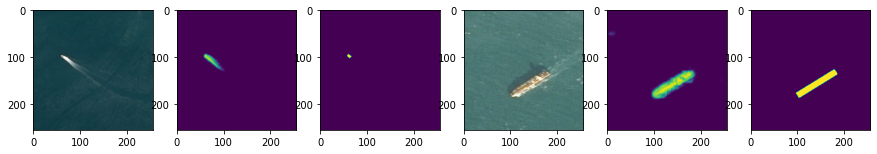

Epoch 1/5
2/2 [==============================] - 5s 2s/step - loss: 0.0170 - dice_loss: 0.4580 - accuracy: 0.9950 - val_loss: 0.0083 - val_dice_loss: 0.6589 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0167 - dice_loss: 0.4696 - accuracy: 0.9951 - val_loss: 0.0081 - val_dice_loss: 0.6590 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0149 - dice_loss: 0.4800 - accuracy: 0.9951 - val_loss: 0.0079 - val_dice_loss: 0.6588 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0146 - dice_loss: 0.4580 - accuracy: 0.9955 - val_loss: 0.0078 - val_dice_loss: 0.6625 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.4485 - accuracy: 0.9957 - val_loss: 0.0077 - val_dice_loss: 0.6679 - val_accuracy: 0.9977


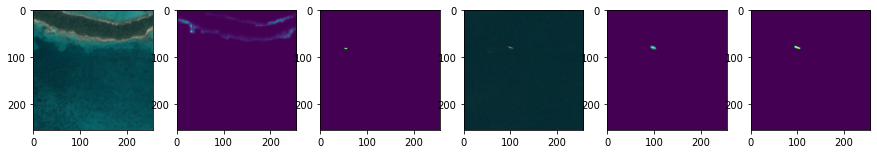

Epoch 1/5
2/2 [==============================] - 5s 2s/step - loss: 0.0165 - dice_loss: 0.7127 - accuracy: 0.9943 - val_loss: 0.0147 - val_dice_loss: 0.6976 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.6349 - accuracy: 0.9959 - val_loss: 0.0149 - val_dice_loss: 0.7068 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0145 - dice_loss: 0.6552 - accuracy: 0.9956 - val_loss: 0.0153 - val_dice_loss: 0.7162 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.6210 - accuracy: 0.9961 - val_loss: 0.0158 - val_dice_loss: 0.7233 - val_accuracy: 0.9959
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0127 - dice_loss: 0.6031 - accuracy: 0.9963 - val_loss: 0.0164 - val_dice_loss: 0.7322 - val_accuracy: 0.9958


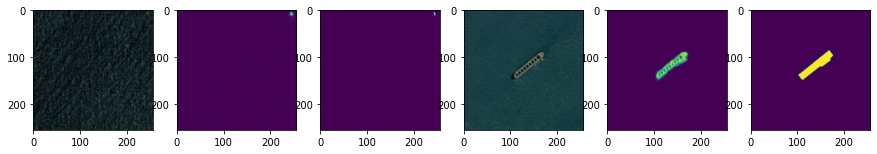

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5733 - accuracy: 0.9958 - val_loss: 0.0064 - val_dice_loss: 0.5088 - val_accuracy: 0.9978
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0121 - dice_loss: 0.5742 - accuracy: 0.9961 - val_loss: 0.0064 - val_dice_loss: 0.5082 - val_accuracy: 0.9978
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0123 - dice_loss: 0.5501 - accuracy: 0.9962 - val_loss: 0.0063 - val_dice_loss: 0.5016 - val_accuracy: 0.9979
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0112 - dice_loss: 0.5364 - accuracy: 0.9961 - val_loss: 0.0062 - val_dice_loss: 0.4937 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.5173 - accuracy: 0.9966 - val_loss: 0.0061 - val_dice_loss: 0.4838 - val_accuracy: 0.9980


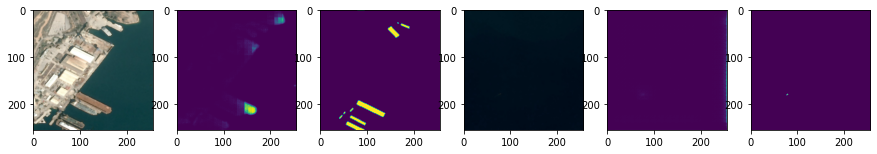

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0151 - dice_loss: 0.6164 - accuracy: 0.9954 - val_loss: 0.0168 - val_dice_loss: 0.6055 - val_accuracy: 0.9944
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0130 - dice_loss: 0.5788 - accuracy: 0.9955 - val_loss: 0.0163 - val_dice_loss: 0.5955 - val_accuracy: 0.9944
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5478 - accuracy: 0.9948 - val_loss: 0.0160 - val_dice_loss: 0.5911 - val_accuracy: 0.9943
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0107 - dice_loss: 0.5780 - accuracy: 0.9958 - val_loss: 0.0159 - val_dice_loss: 0.5896 - val_accuracy: 0.9941
Epoch 5/5
2/2 [==============================] - 4s 3s/step - loss: 0.0108 - dice_loss: 0.5524 - accuracy: 0.9960 - val_loss: 0.0159 - val_dice_loss: 0.5901 - val_accuracy: 0.9940


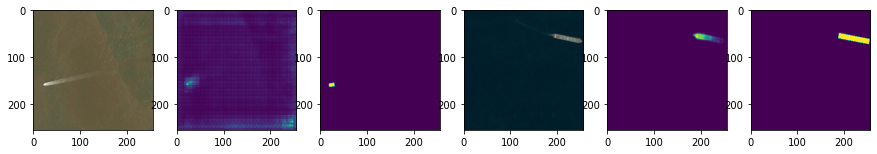

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0146 - dice_loss: 0.5678 - accuracy: 0.9957 - val_loss: 0.0259 - val_dice_loss: 0.5350 - val_accuracy: 0.9926
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0139 - dice_loss: 0.5636 - accuracy: 0.9958 - val_loss: 0.0264 - val_dice_loss: 0.5403 - val_accuracy: 0.9925
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0136 - dice_loss: 0.5724 - accuracy: 0.9960 - val_loss: 0.0268 - val_dice_loss: 0.5443 - val_accuracy: 0.9924
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0123 - dice_loss: 0.5268 - accuracy: 0.9964 - val_loss: 0.0272 - val_dice_loss: 0.5487 - val_accuracy: 0.9923
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0130 - dice_loss: 0.5658 - accuracy: 0.9957 - val_loss: 0.0273 - val_dice_loss: 0.5479 - val_accuracy: 0.9923


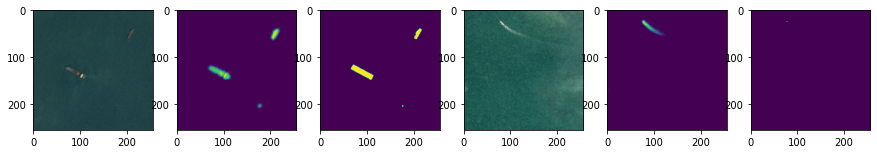

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0105 - dice_loss: 0.7532 - accuracy: 0.9968 - val_loss: 0.0094 - val_dice_loss: 0.6719 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0104 - dice_loss: 0.7515 - accuracy: 0.9967 - val_loss: 0.0096 - val_dice_loss: 0.6792 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0088 - dice_loss: 0.7203 - accuracy: 0.9968 - val_loss: 0.0099 - val_dice_loss: 0.6883 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.6997 - accuracy: 0.9972 - val_loss: 0.0102 - val_dice_loss: 0.6976 - val_accuracy: 0.9974
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0075 - dice_loss: 0.6541 - accuracy: 0.9976 - val_loss: 0.0105 - val_dice_loss: 0.7068 - val_accuracy: 0.9973


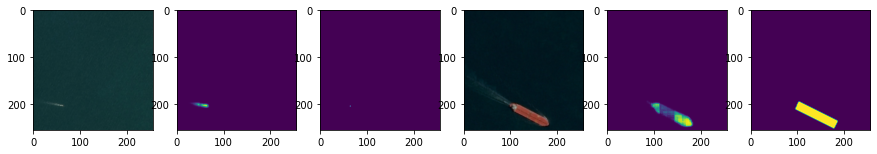

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0094 - dice_loss: 0.4274 - accuracy: 0.9969 - val_loss: 0.0171 - val_dice_loss: 0.6987 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.4382 - accuracy: 0.9970 - val_loss: 0.0166 - val_dice_loss: 0.6923 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.4955 - accuracy: 0.9970 - val_loss: 0.0160 - val_dice_loss: 0.6837 - val_accuracy: 0.9965
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0077 - dice_loss: 0.3446 - accuracy: 0.9975 - val_loss: 0.0151 - val_dice_loss: 0.6735 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.3061 - accuracy: 0.9978 - val_loss: 0.0145 - val_dice_loss: 0.6614 - val_accuracy: 0.9966


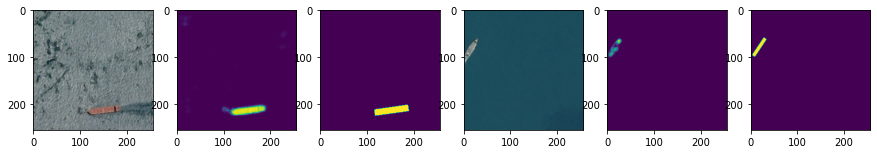

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0064 - dice_loss: 0.6089 - accuracy: 0.9977 - val_loss: 0.0062 - val_dice_loss: 0.4290 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0061 - dice_loss: 0.6136 - accuracy: 0.9980 - val_loss: 0.0062 - val_dice_loss: 0.4279 - val_accuracy: 0.9977
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0064 - dice_loss: 0.6024 - accuracy: 0.9980 - val_loss: 0.0062 - val_dice_loss: 0.4277 - val_accuracy: 0.9978
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0051 - dice_loss: 0.5396 - accuracy: 0.9981 - val_loss: 0.0062 - val_dice_loss: 0.4267 - val_accuracy: 0.9978
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0049 - dice_loss: 0.5515 - accuracy: 0.9982 - val_loss: 0.0062 - val_dice_loss: 0.4268 - val_accuracy: 0.9978


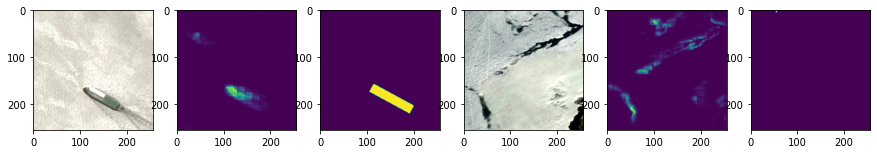

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.5968 - accuracy: 0.9975 - val_loss: 0.0141 - val_dice_loss: 0.5803 - val_accuracy: 0.9952
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0078 - dice_loss: 0.6439 - accuracy: 0.9975 - val_loss: 0.0145 - val_dice_loss: 0.5842 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.5330 - accuracy: 0.9978 - val_loss: 0.0155 - val_dice_loss: 0.5925 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 5s 3s/step - loss: 0.0066 - dice_loss: 0.5278 - accuracy: 0.9978 - val_loss: 0.0167 - val_dice_loss: 0.6002 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.5234 - accuracy: 0.9978 - val_loss: 0.0179 - val_dice_loss: 0.6071 - val_accuracy: 0.9953


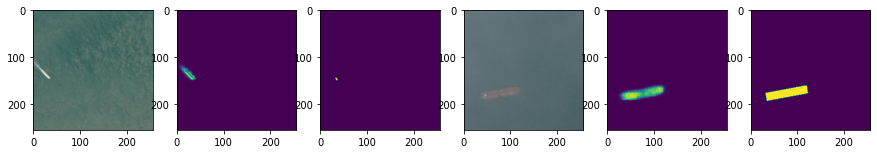

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.5692 - accuracy: 0.9961 - val_loss: 0.0112 - val_dice_loss: 0.5193 - val_accuracy: 0.9977
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0093 - dice_loss: 0.5188 - accuracy: 0.9966 - val_loss: 0.0114 - val_dice_loss: 0.5221 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5079 - accuracy: 0.9967 - val_loss: 0.0117 - val_dice_loss: 0.5282 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0077 - dice_loss: 0.4677 - accuracy: 0.9971 - val_loss: 0.0119 - val_dice_loss: 0.5387 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0072 - dice_loss: 0.4183 - accuracy: 0.9971 - val_loss: 0.0123 - val_dice_loss: 0.5584 - val_accuracy: 0.9972


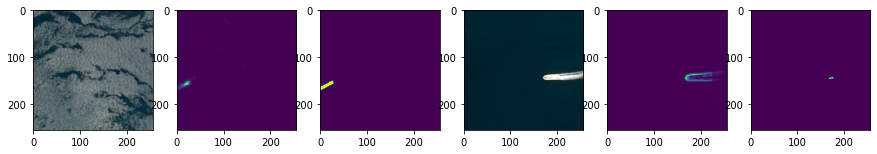

Epoch 1/5
2/2 [==============================] - 6s 4s/step - loss: 0.0142 - dice_loss: 0.6022 - accuracy: 0.9955 - val_loss: 0.0050 - val_dice_loss: 0.4853 - val_accuracy: 0.9986
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0151 - dice_loss: 0.5524 - accuracy: 0.9956 - val_loss: 0.0049 - val_dice_loss: 0.4763 - val_accuracy: 0.9986
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.5778 - accuracy: 0.9954 - val_loss: 0.0048 - val_dice_loss: 0.4688 - val_accuracy: 0.9986
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.5514 - accuracy: 0.9960 - val_loss: 0.0048 - val_dice_loss: 0.4635 - val_accuracy: 0.9986
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0107 - dice_loss: 0.5826 - accuracy: 0.9959 - val_loss: 0.0048 - val_dice_loss: 0.4567 - val_accuracy: 0.9986


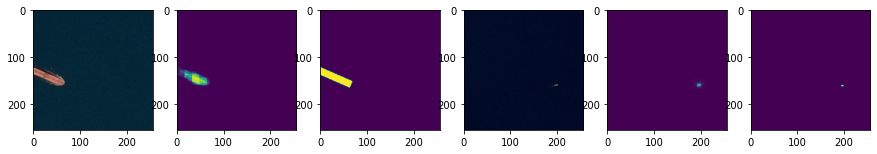

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.6499 - accuracy: 0.9974 - val_loss: 0.0093 - val_dice_loss: 0.4873 - val_accuracy: 0.9969
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.5849 - accuracy: 0.9978 - val_loss: 0.0082 - val_dice_loss: 0.4290 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0091 - dice_loss: 0.6368 - accuracy: 0.9975 - val_loss: 0.0079 - val_dice_loss: 0.4114 - val_accuracy: 0.9977
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0076 - dice_loss: 0.5766 - accuracy: 0.9979 - val_loss: 0.0076 - val_dice_loss: 0.4095 - val_accuracy: 0.9977
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0070 - dice_loss: 0.5522 - accuracy: 0.9979 - val_loss: 0.0076 - val_dice_loss: 0.4113 - val_accuracy: 0.9976


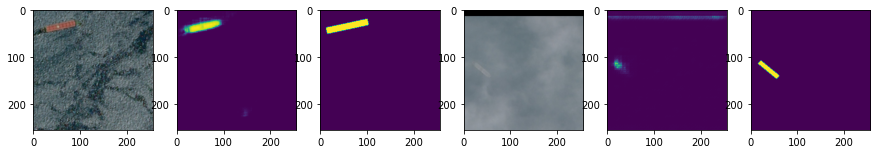

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0127 - dice_loss: 0.5363 - accuracy: 0.9950 - val_loss: 0.0066 - val_dice_loss: 0.4494 - val_accuracy: 0.9982
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0117 - dice_loss: 0.4830 - accuracy: 0.9952 - val_loss: 0.0065 - val_dice_loss: 0.4419 - val_accuracy: 0.9983
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4181 - accuracy: 0.9962 - val_loss: 0.0065 - val_dice_loss: 0.4351 - val_accuracy: 0.9983
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4198 - accuracy: 0.9964 - val_loss: 0.0065 - val_dice_loss: 0.4270 - val_accuracy: 0.9983
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0114 - dice_loss: 0.4662 - accuracy: 0.9955 - val_loss: 0.0066 - val_dice_loss: 0.4220 - val_accuracy: 0.9982


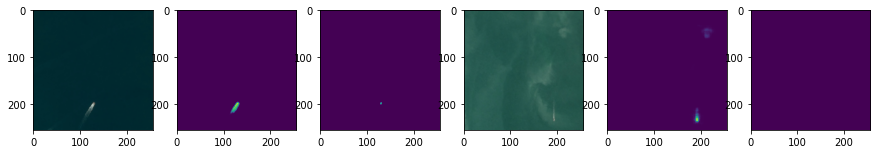

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0075 - dice_loss: 0.4572 - accuracy: 0.9974 - val_loss: 0.0056 - val_dice_loss: 0.4604 - val_accuracy: 0.9979
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0072 - dice_loss: 0.4527 - accuracy: 0.9975 - val_loss: 0.0055 - val_dice_loss: 0.4578 - val_accuracy: 0.9979
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0075 - dice_loss: 0.4612 - accuracy: 0.9974 - val_loss: 0.0054 - val_dice_loss: 0.4547 - val_accuracy: 0.9979
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.4666 - accuracy: 0.9972 - val_loss: 0.0053 - val_dice_loss: 0.4528 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0071 - dice_loss: 0.4358 - accuracy: 0.9974 - val_loss: 0.0053 - val_dice_loss: 0.4510 - val_accuracy: 0.9979


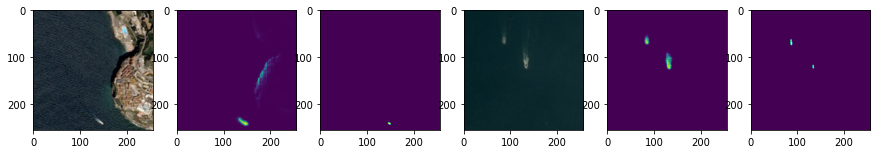

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.5652 - accuracy: 0.9943 - val_loss: 0.0142 - val_dice_loss: 0.4729 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0184 - dice_loss: 0.5746 - accuracy: 0.9940 - val_loss: 0.0143 - val_dice_loss: 0.4693 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0166 - dice_loss: 0.5220 - accuracy: 0.9944 - val_loss: 0.0145 - val_dice_loss: 0.4667 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.5289 - accuracy: 0.9941 - val_loss: 0.0148 - val_dice_loss: 0.4654 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0152 - dice_loss: 0.4899 - accuracy: 0.9945 - val_loss: 0.0150 - val_dice_loss: 0.4649 - val_accuracy: 0.9962


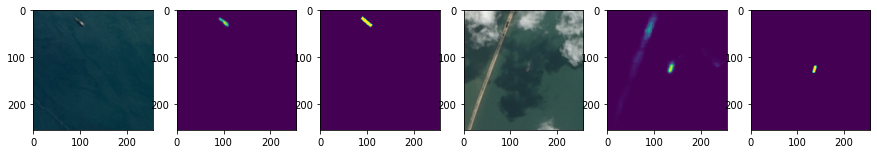

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.4697 - accuracy: 0.9968 - val_loss: 0.0109 - val_dice_loss: 0.5129 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0089 - dice_loss: 0.5209 - accuracy: 0.9967 - val_loss: 0.0110 - val_dice_loss: 0.5101 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.4622 - accuracy: 0.9969 - val_loss: 0.0114 - val_dice_loss: 0.5133 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.4330 - accuracy: 0.9973 - val_loss: 0.0120 - val_dice_loss: 0.5182 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.4415 - accuracy: 0.9973 - val_loss: 0.0125 - val_dice_loss: 0.5223 - val_accuracy: 0.9966


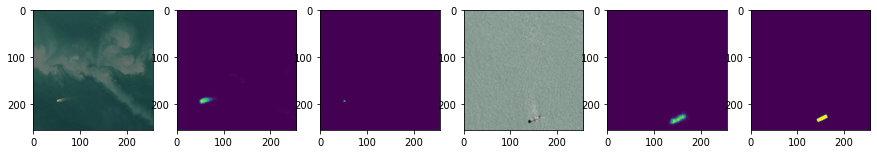

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0303 - dice_loss: 0.5511 - accuracy: 0.9920 - val_loss: 0.0164 - val_dice_loss: 0.7169 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0259 - dice_loss: 0.5388 - accuracy: 0.9920 - val_loss: 0.0149 - val_dice_loss: 0.6872 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0225 - dice_loss: 0.4606 - accuracy: 0.9928 - val_loss: 0.0139 - val_dice_loss: 0.6693 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0202 - dice_loss: 0.4582 - accuracy: 0.9935 - val_loss: 0.0135 - val_dice_loss: 0.6594 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0179 - dice_loss: 0.4851 - accuracy: 0.9938 - val_loss: 0.0133 - val_dice_loss: 0.6527 - val_accuracy: 0.9963


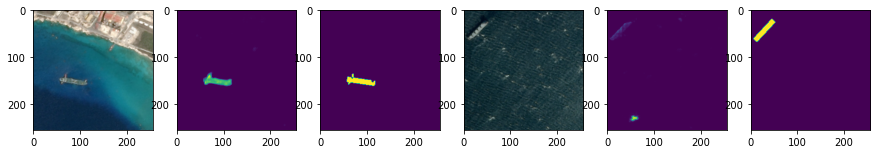

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.6143 - accuracy: 0.9965 - val_loss: 0.0108 - val_dice_loss: 0.5129 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0099 - dice_loss: 0.5824 - accuracy: 0.9961 - val_loss: 0.0110 - val_dice_loss: 0.5164 - val_accuracy: 0.9961
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5695 - accuracy: 0.9966 - val_loss: 0.0112 - val_dice_loss: 0.5206 - val_accuracy: 0.9961
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0083 - dice_loss: 0.5587 - accuracy: 0.9969 - val_loss: 0.0113 - val_dice_loss: 0.5261 - val_accuracy: 0.9961
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.5305 - accuracy: 0.9971 - val_loss: 0.0116 - val_dice_loss: 0.5351 - val_accuracy: 0.9961


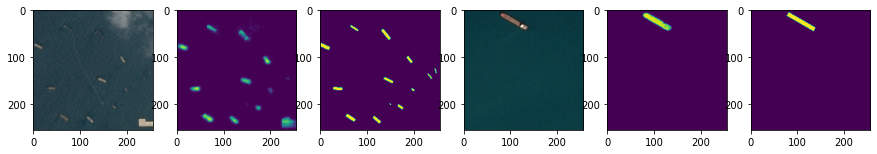

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0230 - dice_loss: 0.6269 - accuracy: 0.9928 - val_loss: 0.0132 - val_dice_loss: 0.4973 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0239 - dice_loss: 0.6110 - accuracy: 0.9928 - val_loss: 0.0133 - val_dice_loss: 0.5053 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0211 - dice_loss: 0.5872 - accuracy: 0.9934 - val_loss: 0.0133 - val_dice_loss: 0.5079 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0195 - dice_loss: 0.5835 - accuracy: 0.9936 - val_loss: 0.0134 - val_dice_loss: 0.5174 - val_accuracy: 0.9951
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.5701 - accuracy: 0.9934 - val_loss: 0.0138 - val_dice_loss: 0.5305 - val_accuracy: 0.9951


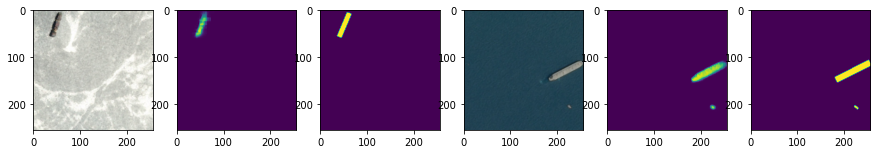

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.6191 - accuracy: 0.9974 - val_loss: 0.0121 - val_dice_loss: 0.5812 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.6338 - accuracy: 0.9971 - val_loss: 0.0121 - val_dice_loss: 0.5848 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0083 - dice_loss: 0.6547 - accuracy: 0.9976 - val_loss: 0.0121 - val_dice_loss: 0.5853 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0082 - dice_loss: 0.6742 - accuracy: 0.9975 - val_loss: 0.0119 - val_dice_loss: 0.5836 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.5592 - accuracy: 0.9978 - val_loss: 0.0118 - val_dice_loss: 0.5799 - val_accuracy: 0.9967


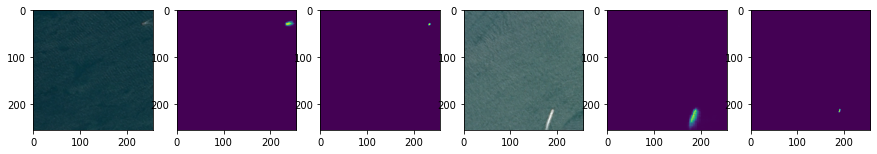

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0131 - dice_loss: 0.6491 - accuracy: 0.9956 - val_loss: 0.0135 - val_dice_loss: 0.5694 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.6691 - accuracy: 0.9958 - val_loss: 0.0135 - val_dice_loss: 0.5696 - val_accuracy: 0.9952
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0105 - dice_loss: 0.6377 - accuracy: 0.9959 - val_loss: 0.0137 - val_dice_loss: 0.5754 - val_accuracy: 0.9951
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.6102 - accuracy: 0.9962 - val_loss: 0.0141 - val_dice_loss: 0.5861 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.5875 - accuracy: 0.9967 - val_loss: 0.0145 - val_dice_loss: 0.5991 - val_accuracy: 0.9948


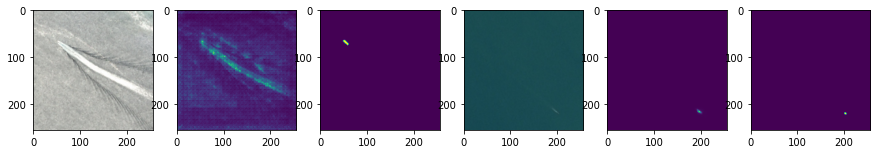

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0130 - dice_loss: 0.5975 - accuracy: 0.9965 - val_loss: 0.0132 - val_dice_loss: 0.4731 - val_accuracy: 0.9947
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.5732 - accuracy: 0.9965 - val_loss: 0.0129 - val_dice_loss: 0.4685 - val_accuracy: 0.9948
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0120 - dice_loss: 0.5762 - accuracy: 0.9964 - val_loss: 0.0127 - val_dice_loss: 0.4643 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0105 - dice_loss: 0.5417 - accuracy: 0.9967 - val_loss: 0.0126 - val_dice_loss: 0.4632 - val_accuracy: 0.9950
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0106 - dice_loss: 0.5252 - accuracy: 0.9968 - val_loss: 0.0126 - val_dice_loss: 0.4648 - val_accuracy: 0.9950


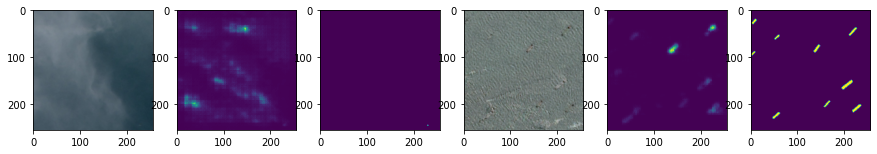

Epoch 1/5
2/2 [==============================] - 4s 3s/step - loss: 0.0125 - dice_loss: 0.6933 - accuracy: 0.9966 - val_loss: 0.0051 - val_dice_loss: 0.8218 - val_accuracy: 0.9991
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0115 - dice_loss: 0.6562 - accuracy: 0.9965 - val_loss: 0.0049 - val_dice_loss: 0.8113 - val_accuracy: 0.9991
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0101 - dice_loss: 0.6546 - accuracy: 0.9970 - val_loss: 0.0046 - val_dice_loss: 0.8008 - val_accuracy: 0.9991
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0088 - dice_loss: 0.6152 - accuracy: 0.9974 - val_loss: 0.0046 - val_dice_loss: 0.7978 - val_accuracy: 0.9991
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0096 - dice_loss: 0.6080 - accuracy: 0.9972 - val_loss: 0.0046 - val_dice_loss: 0.7968 - val_accuracy: 0.9991


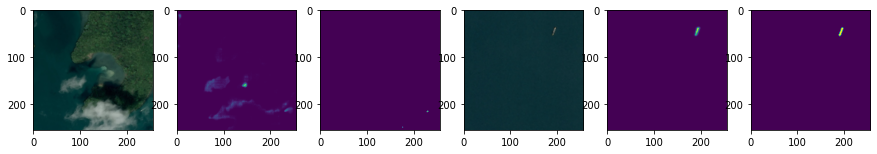

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.5679 - accuracy: 0.9980 - val_loss: 0.0038 - val_dice_loss: 0.5879 - val_accuracy: 0.9989
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0070 - dice_loss: 0.5855 - accuracy: 0.9975 - val_loss: 0.0036 - val_dice_loss: 0.5775 - val_accuracy: 0.9988
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0067 - dice_loss: 0.5742 - accuracy: 0.9978 - val_loss: 0.0036 - val_dice_loss: 0.5695 - val_accuracy: 0.9988
Epoch 4/5
2/2 [==============================] - 4s 3s/step - loss: 0.0064 - dice_loss: 0.6381 - accuracy: 0.9978 - val_loss: 0.0035 - val_dice_loss: 0.5659 - val_accuracy: 0.9988
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0059 - dice_loss: 0.5423 - accuracy: 0.9981 - val_loss: 0.0035 - val_dice_loss: 0.5642 - val_accuracy: 0.9987


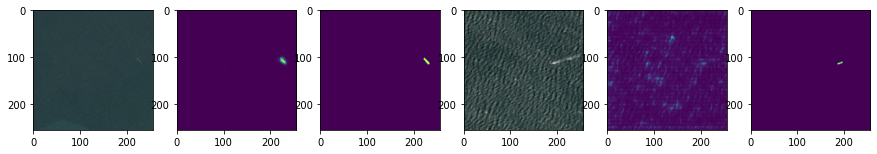

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0095 - dice_loss: 0.5522 - accuracy: 0.9970 - val_loss: 0.0069 - val_dice_loss: 0.6591 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.6158 - accuracy: 0.9966 - val_loss: 0.0070 - val_dice_loss: 0.6625 - val_accuracy: 0.9975
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.5521 - accuracy: 0.9970 - val_loss: 0.0070 - val_dice_loss: 0.6641 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0090 - dice_loss: 0.5178 - accuracy: 0.9971 - val_loss: 0.0069 - val_dice_loss: 0.6641 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.5826 - accuracy: 0.9971 - val_loss: 0.0069 - val_dice_loss: 0.6609 - val_accuracy: 0.9975


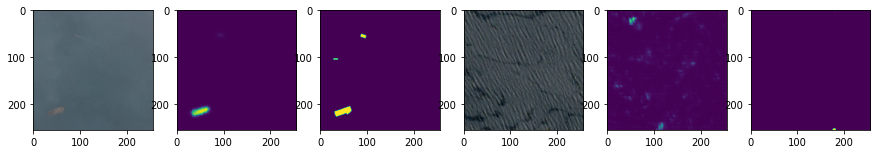

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0087 - dice_loss: 0.5823 - accuracy: 0.9967 - val_loss: 0.0134 - val_dice_loss: 0.5785 - val_accuracy: 0.9950
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0086 - dice_loss: 0.5687 - accuracy: 0.9969 - val_loss: 0.0128 - val_dice_loss: 0.5608 - val_accuracy: 0.9951
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0088 - dice_loss: 0.5485 - accuracy: 0.9968 - val_loss: 0.0124 - val_dice_loss: 0.5458 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.6386 - accuracy: 0.9964 - val_loss: 0.0119 - val_dice_loss: 0.5276 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0077 - dice_loss: 0.5285 - accuracy: 0.9971 - val_loss: 0.0115 - val_dice_loss: 0.5130 - val_accuracy: 0.9955


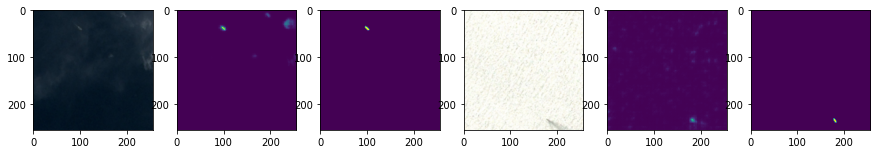

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0100 - dice_loss: 0.4209 - accuracy: 0.9971 - val_loss: 0.0084 - val_dice_loss: 0.6560 - val_accuracy: 0.9966
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0092 - dice_loss: 0.4026 - accuracy: 0.9972 - val_loss: 0.0084 - val_dice_loss: 0.6496 - val_accuracy: 0.9964
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.4318 - accuracy: 0.9972 - val_loss: 0.0084 - val_dice_loss: 0.6448 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0093 - dice_loss: 0.4202 - accuracy: 0.9974 - val_loss: 0.0084 - val_dice_loss: 0.6407 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0094 - dice_loss: 0.4130 - accuracy: 0.9974 - val_loss: 0.0084 - val_dice_loss: 0.6369 - val_accuracy: 0.9963


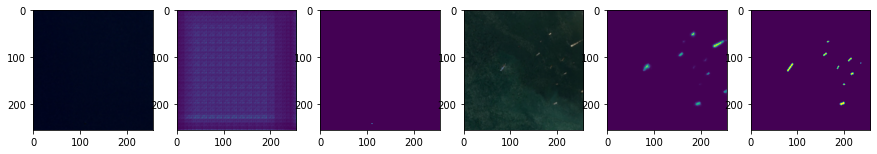

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.7082 - accuracy: 0.9962 - val_loss: 0.0139 - val_dice_loss: 0.7346 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0112 - dice_loss: 0.6966 - accuracy: 0.9965 - val_loss: 0.0141 - val_dice_loss: 0.7337 - val_accuracy: 0.9968
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0110 - dice_loss: 0.6833 - accuracy: 0.9967 - val_loss: 0.0144 - val_dice_loss: 0.7356 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0105 - dice_loss: 0.6637 - accuracy: 0.9968 - val_loss: 0.0147 - val_dice_loss: 0.7407 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0093 - dice_loss: 0.6320 - accuracy: 0.9970 - val_loss: 0.0151 - val_dice_loss: 0.7491 - val_accuracy: 0.9969


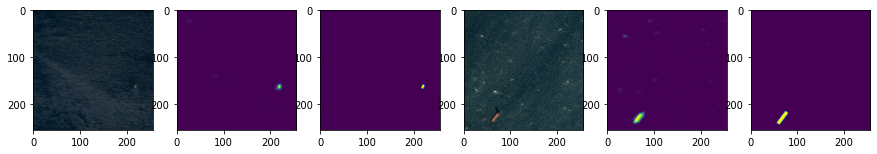

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0129 - dice_loss: 0.4631 - accuracy: 0.9966 - val_loss: 0.0057 - val_dice_loss: 0.4291 - val_accuracy: 0.9982
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0129 - dice_loss: 0.4869 - accuracy: 0.9966 - val_loss: 0.0057 - val_dice_loss: 0.4309 - val_accuracy: 0.9982
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0126 - dice_loss: 0.4946 - accuracy: 0.9967 - val_loss: 0.0057 - val_dice_loss: 0.4335 - val_accuracy: 0.9982
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0123 - dice_loss: 0.4928 - accuracy: 0.9966 - val_loss: 0.0056 - val_dice_loss: 0.4372 - val_accuracy: 0.9982
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0118 - dice_loss: 0.4548 - accuracy: 0.9968 - val_loss: 0.0055 - val_dice_loss: 0.4420 - val_accuracy: 0.9982


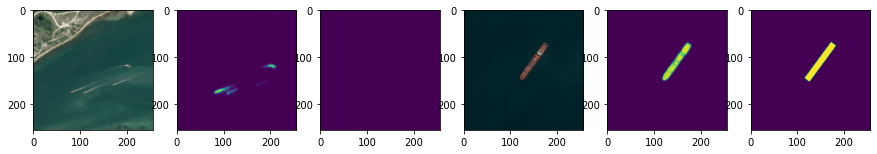

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0148 - dice_loss: 0.4740 - accuracy: 0.9954 - val_loss: 0.0098 - val_dice_loss: 0.4250 - val_accuracy: 0.9970
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0130 - dice_loss: 0.4421 - accuracy: 0.9963 - val_loss: 0.0095 - val_dice_loss: 0.4199 - val_accuracy: 0.9970
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0113 - dice_loss: 0.3930 - accuracy: 0.9969 - val_loss: 0.0094 - val_dice_loss: 0.4177 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0127 - dice_loss: 0.3961 - accuracy: 0.9968 - val_loss: 0.0092 - val_dice_loss: 0.4165 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0103 - dice_loss: 0.3707 - accuracy: 0.9971 - val_loss: 0.0091 - val_dice_loss: 0.4147 - val_accuracy: 0.9968


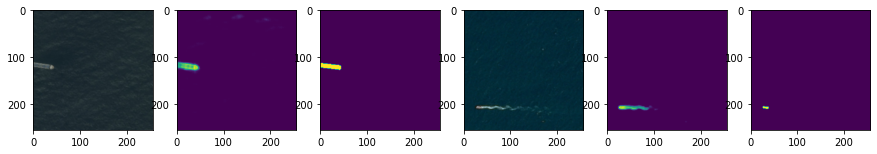

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0194 - dice_loss: 0.4514 - accuracy: 0.9935 - val_loss: 0.0077 - val_dice_loss: 0.4203 - val_accuracy: 0.9972
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.3802 - accuracy: 0.9948 - val_loss: 0.0078 - val_dice_loss: 0.4234 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.3771 - accuracy: 0.9949 - val_loss: 0.0080 - val_dice_loss: 0.4265 - val_accuracy: 0.9970
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0128 - dice_loss: 0.3744 - accuracy: 0.9946 - val_loss: 0.0082 - val_dice_loss: 0.4282 - val_accuracy: 0.9969
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0119 - dice_loss: 0.3524 - accuracy: 0.9952 - val_loss: 0.0083 - val_dice_loss: 0.4283 - val_accuracy: 0.9968


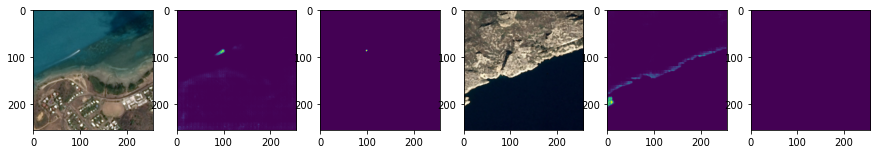

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0173 - dice_loss: 0.5352 - accuracy: 0.9931 - val_loss: 0.0126 - val_dice_loss: 0.4650 - val_accuracy: 0.9958
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0158 - dice_loss: 0.4869 - accuracy: 0.9938 - val_loss: 0.0123 - val_dice_loss: 0.4587 - val_accuracy: 0.9962
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0139 - dice_loss: 0.4890 - accuracy: 0.9949 - val_loss: 0.0120 - val_dice_loss: 0.4498 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.4571 - accuracy: 0.9955 - val_loss: 0.0117 - val_dice_loss: 0.4418 - val_accuracy: 0.9966
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.4495 - accuracy: 0.9955 - val_loss: 0.0115 - val_dice_loss: 0.4370 - val_accuracy: 0.9967


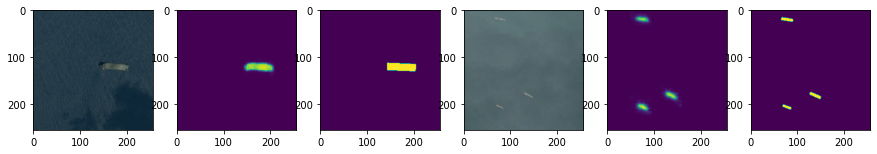

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0188 - dice_loss: 0.6059 - accuracy: 0.9929 - val_loss: 0.0085 - val_dice_loss: 0.4282 - val_accuracy: 0.9980
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0173 - dice_loss: 0.5978 - accuracy: 0.9931 - val_loss: 0.0087 - val_dice_loss: 0.4342 - val_accuracy: 0.9979
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0193 - dice_loss: 0.6761 - accuracy: 0.9929 - val_loss: 0.0088 - val_dice_loss: 0.4431 - val_accuracy: 0.9979
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.5617 - accuracy: 0.9936 - val_loss: 0.0089 - val_dice_loss: 0.4514 - val_accuracy: 0.9979
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0132 - dice_loss: 0.5620 - accuracy: 0.9943 - val_loss: 0.0090 - val_dice_loss: 0.4614 - val_accuracy: 0.9978


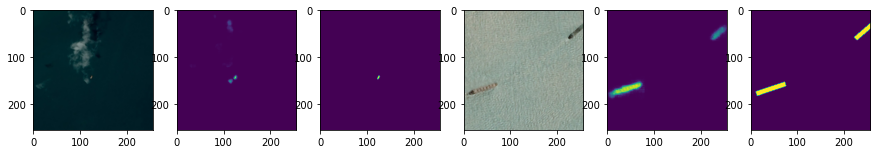

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0172 - dice_loss: 0.5924 - accuracy: 0.9938 - val_loss: 0.0138 - val_dice_loss: 0.6207 - val_accuracy: 0.9955
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.5582 - accuracy: 0.9944 - val_loss: 0.0141 - val_dice_loss: 0.6286 - val_accuracy: 0.9955
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0177 - dice_loss: 0.5974 - accuracy: 0.9932 - val_loss: 0.0146 - val_dice_loss: 0.6341 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0156 - dice_loss: 0.5543 - accuracy: 0.9942 - val_loss: 0.0149 - val_dice_loss: 0.6342 - val_accuracy: 0.9955
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.5199 - accuracy: 0.9937 - val_loss: 0.0153 - val_dice_loss: 0.6355 - val_accuracy: 0.9955


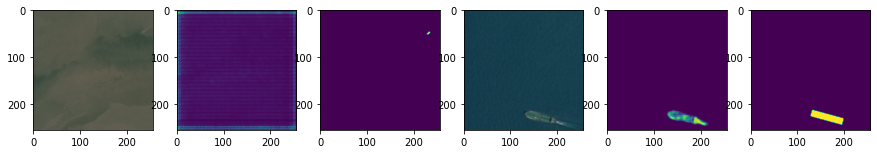

Epoch 1/5
2/2 [==============================] - 3s 2s/step - loss: 0.0186 - dice_loss: 0.5292 - accuracy: 0.9947 - val_loss: 0.0191 - val_dice_loss: 0.6167 - val_accuracy: 0.9963
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0192 - dice_loss: 0.5333 - accuracy: 0.9948 - val_loss: 0.0190 - val_dice_loss: 0.6143 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0187 - dice_loss: 0.5285 - accuracy: 0.9944 - val_loss: 0.0193 - val_dice_loss: 0.6112 - val_accuracy: 0.9963
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0168 - dice_loss: 0.4973 - accuracy: 0.9950 - val_loss: 0.0191 - val_dice_loss: 0.6120 - val_accuracy: 0.9963
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0162 - dice_loss: 0.4879 - accuracy: 0.9952 - val_loss: 0.0185 - val_dice_loss: 0.6156 - val_accuracy: 0.9963


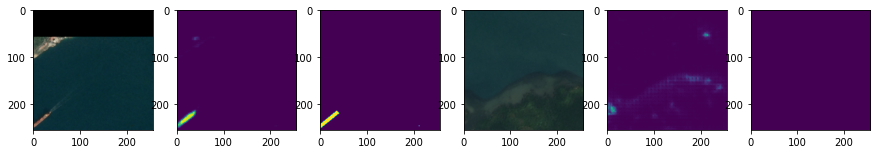

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0068 - dice_loss: 0.7025 - accuracy: 0.9977 - val_loss: 0.0127 - val_dice_loss: 0.4776 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 5s 3s/step - loss: 0.0068 - dice_loss: 0.7138 - accuracy: 0.9979 - val_loss: 0.0127 - val_dice_loss: 0.4778 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 4s 3s/step - loss: 0.0063 - dice_loss: 0.6995 - accuracy: 0.9980 - val_loss: 0.0127 - val_dice_loss: 0.4803 - val_accuracy: 0.9974
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0058 - dice_loss: 0.6884 - accuracy: 0.9979 - val_loss: 0.0128 - val_dice_loss: 0.4850 - val_accuracy: 0.9973
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0053 - dice_loss: 0.6812 - accuracy: 0.9982 - val_loss: 0.0130 - val_dice_loss: 0.4921 - val_accuracy: 0.9973


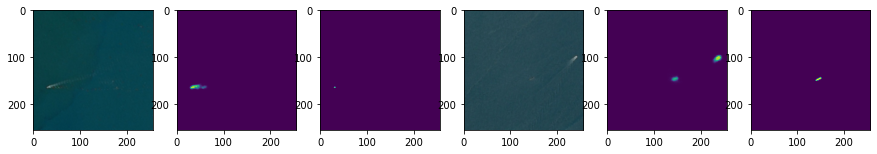

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.5256 - accuracy: 0.9971 - val_loss: 0.0148 - val_dice_loss: 0.5845 - val_accuracy: 0.9954
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0083 - dice_loss: 0.4983 - accuracy: 0.9974 - val_loss: 0.0149 - val_dice_loss: 0.5871 - val_accuracy: 0.9953
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0079 - dice_loss: 0.4544 - accuracy: 0.9975 - val_loss: 0.0148 - val_dice_loss: 0.5856 - val_accuracy: 0.9953
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0076 - dice_loss: 0.4453 - accuracy: 0.9977 - val_loss: 0.0146 - val_dice_loss: 0.5799 - val_accuracy: 0.9954
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0080 - dice_loss: 0.4801 - accuracy: 0.9975 - val_loss: 0.0144 - val_dice_loss: 0.5723 - val_accuracy: 0.9954


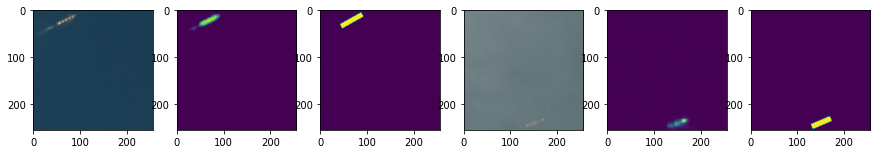

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0146 - dice_loss: 0.6269 - accuracy: 0.9957 - val_loss: 0.0085 - val_dice_loss: 0.6576 - val_accuracy: 0.9974
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0139 - dice_loss: 0.6127 - accuracy: 0.9959 - val_loss: 0.0085 - val_dice_loss: 0.6546 - val_accuracy: 0.9974
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0149 - dice_loss: 0.6200 - accuracy: 0.9959 - val_loss: 0.0085 - val_dice_loss: 0.6519 - val_accuracy: 0.9975
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0135 - dice_loss: 0.6024 - accuracy: 0.9959 - val_loss: 0.0086 - val_dice_loss: 0.6495 - val_accuracy: 0.9975
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0121 - dice_loss: 0.6198 - accuracy: 0.9958 - val_loss: 0.0087 - val_dice_loss: 0.6475 - val_accuracy: 0.9976


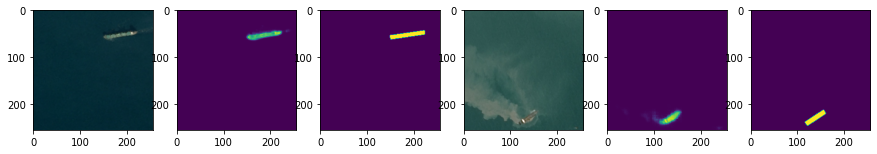

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0153 - dice_loss: 0.6143 - accuracy: 0.9963 - val_loss: 0.0088 - val_dice_loss: 0.5080 - val_accuracy: 0.9961
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0148 - dice_loss: 0.5895 - accuracy: 0.9963 - val_loss: 0.0087 - val_dice_loss: 0.5010 - val_accuracy: 0.9963
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0138 - dice_loss: 0.6055 - accuracy: 0.9961 - val_loss: 0.0085 - val_dice_loss: 0.4932 - val_accuracy: 0.9964
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0124 - dice_loss: 0.6072 - accuracy: 0.9965 - val_loss: 0.0087 - val_dice_loss: 0.4903 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0103 - dice_loss: 0.5734 - accuracy: 0.9964 - val_loss: 0.0093 - val_dice_loss: 0.4950 - val_accuracy: 0.9967


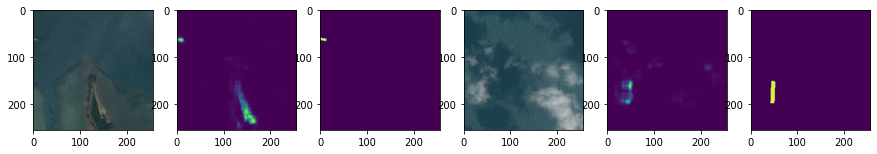

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.4373 - accuracy: 0.9964 - val_loss: 0.0080 - val_dice_loss: 0.5354 - val_accuracy: 0.9975
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0110 - dice_loss: 0.5314 - accuracy: 0.9960 - val_loss: 0.0083 - val_dice_loss: 0.5430 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0096 - dice_loss: 0.4108 - accuracy: 0.9967 - val_loss: 0.0087 - val_dice_loss: 0.5494 - val_accuracy: 0.9971
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0097 - dice_loss: 0.4126 - accuracy: 0.9965 - val_loss: 0.0090 - val_dice_loss: 0.5541 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.3995 - accuracy: 0.9967 - val_loss: 0.0092 - val_dice_loss: 0.5562 - val_accuracy: 0.9969


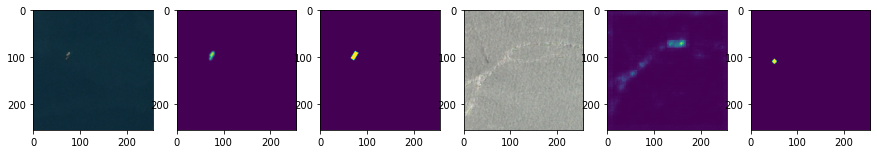

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0193 - dice_loss: 0.5873 - accuracy: 0.9941 - val_loss: 0.0101 - val_dice_loss: 0.5747 - val_accuracy: 0.9965
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.5856 - accuracy: 0.9942 - val_loss: 0.0106 - val_dice_loss: 0.5814 - val_accuracy: 0.9966
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0181 - dice_loss: 0.5875 - accuracy: 0.9941 - val_loss: 0.0112 - val_dice_loss: 0.5934 - val_accuracy: 0.9966
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0166 - dice_loss: 0.5674 - accuracy: 0.9942 - val_loss: 0.0118 - val_dice_loss: 0.6044 - val_accuracy: 0.9964
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.6002 - accuracy: 0.9940 - val_loss: 0.0125 - val_dice_loss: 0.6164 - val_accuracy: 0.9963


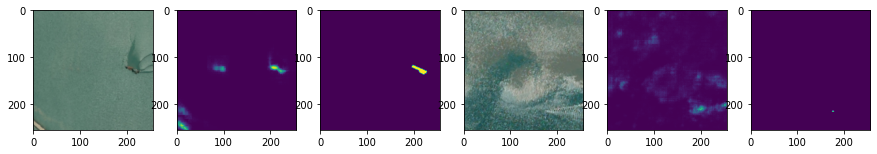

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0090 - dice_loss: 0.5259 - accuracy: 0.9972 - val_loss: 0.0200 - val_dice_loss: 0.4720 - val_accuracy: 0.9942
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0089 - dice_loss: 0.5212 - accuracy: 0.9971 - val_loss: 0.0195 - val_dice_loss: 0.4648 - val_accuracy: 0.9941
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0081 - dice_loss: 0.5041 - accuracy: 0.9976 - val_loss: 0.0191 - val_dice_loss: 0.4576 - val_accuracy: 0.9941
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0082 - dice_loss: 0.5068 - accuracy: 0.9974 - val_loss: 0.0187 - val_dice_loss: 0.4506 - val_accuracy: 0.9941
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0078 - dice_loss: 0.4934 - accuracy: 0.9975 - val_loss: 0.0184 - val_dice_loss: 0.4454 - val_accuracy: 0.9941


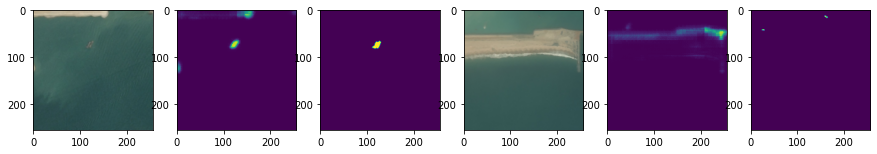

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0172 - dice_loss: 0.5798 - accuracy: 0.9952 - val_loss: 0.0115 - val_dice_loss: 0.6742 - val_accuracy: 0.9962
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0178 - dice_loss: 0.5611 - accuracy: 0.9954 - val_loss: 0.0109 - val_dice_loss: 0.6632 - val_accuracy: 0.9965
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0164 - dice_loss: 0.5965 - accuracy: 0.9954 - val_loss: 0.0104 - val_dice_loss: 0.6528 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5514 - accuracy: 0.9956 - val_loss: 0.0100 - val_dice_loss: 0.6439 - val_accuracy: 0.9968
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0122 - dice_loss: 0.5497 - accuracy: 0.9953 - val_loss: 0.0097 - val_dice_loss: 0.6384 - val_accuracy: 0.9969


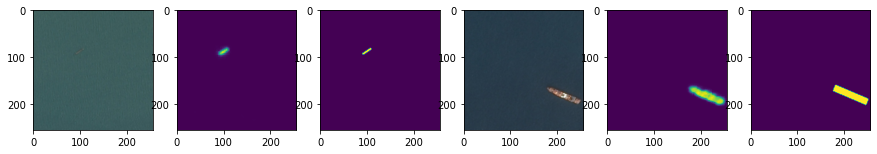

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0100 - dice_loss: 0.5725 - accuracy: 0.9966 - val_loss: 0.0095 - val_dice_loss: 0.6499 - val_accuracy: 0.9973
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0095 - dice_loss: 0.4817 - accuracy: 0.9968 - val_loss: 0.0091 - val_dice_loss: 0.6334 - val_accuracy: 0.9973
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0098 - dice_loss: 0.5433 - accuracy: 0.9968 - val_loss: 0.0089 - val_dice_loss: 0.6213 - val_accuracy: 0.9973
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0091 - dice_loss: 0.4807 - accuracy: 0.9970 - val_loss: 0.0090 - val_dice_loss: 0.6147 - val_accuracy: 0.9972
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0095 - dice_loss: 0.5347 - accuracy: 0.9967 - val_loss: 0.0091 - val_dice_loss: 0.6127 - val_accuracy: 0.9972


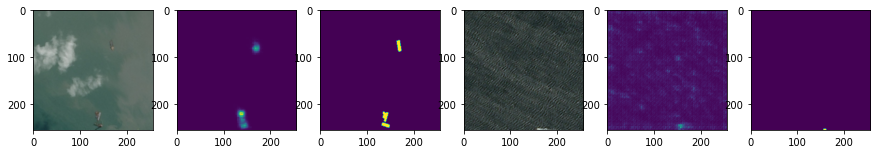

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0128 - dice_loss: 0.5900 - accuracy: 0.9954 - val_loss: 0.0167 - val_dice_loss: 0.7403 - val_accuracy: 0.9949
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0098 - dice_loss: 0.5258 - accuracy: 0.9961 - val_loss: 0.0165 - val_dice_loss: 0.7306 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0100 - dice_loss: 0.5336 - accuracy: 0.9961 - val_loss: 0.0161 - val_dice_loss: 0.7106 - val_accuracy: 0.9949
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0086 - dice_loss: 0.4343 - accuracy: 0.9970 - val_loss: 0.0158 - val_dice_loss: 0.6973 - val_accuracy: 0.9949
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0084 - dice_loss: 0.4608 - accuracy: 0.9967 - val_loss: 0.0157 - val_dice_loss: 0.6902 - val_accuracy: 0.9950


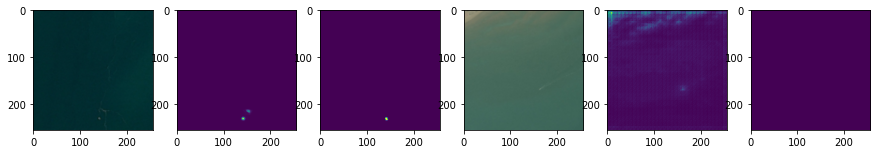

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0075 - dice_loss: 0.4638 - accuracy: 0.9981 - val_loss: 0.0121 - val_dice_loss: 0.7040 - val_accuracy: 0.9976
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0077 - dice_loss: 0.4770 - accuracy: 0.9975 - val_loss: 0.0121 - val_dice_loss: 0.7053 - val_accuracy: 0.9976
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0073 - dice_loss: 0.4723 - accuracy: 0.9979 - val_loss: 0.0120 - val_dice_loss: 0.7057 - val_accuracy: 0.9976
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0066 - dice_loss: 0.4383 - accuracy: 0.9982 - val_loss: 0.0118 - val_dice_loss: 0.7049 - val_accuracy: 0.9976
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0066 - dice_loss: 0.4184 - accuracy: 0.9981 - val_loss: 0.0116 - val_dice_loss: 0.7037 - val_accuracy: 0.9976


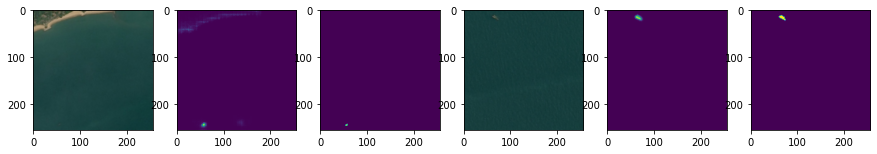

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0186 - dice_loss: 0.6887 - accuracy: 0.9943 - val_loss: 0.0097 - val_dice_loss: 0.6931 - val_accuracy: 0.9968
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0182 - dice_loss: 0.6714 - accuracy: 0.9940 - val_loss: 0.0094 - val_dice_loss: 0.6799 - val_accuracy: 0.9969
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0180 - dice_loss: 0.6790 - accuracy: 0.9942 - val_loss: 0.0092 - val_dice_loss: 0.6668 - val_accuracy: 0.9969
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0159 - dice_loss: 0.6526 - accuracy: 0.9945 - val_loss: 0.0091 - val_dice_loss: 0.6585 - val_accuracy: 0.9970
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0157 - dice_loss: 0.6884 - accuracy: 0.9940 - val_loss: 0.0090 - val_dice_loss: 0.6517 - val_accuracy: 0.9970


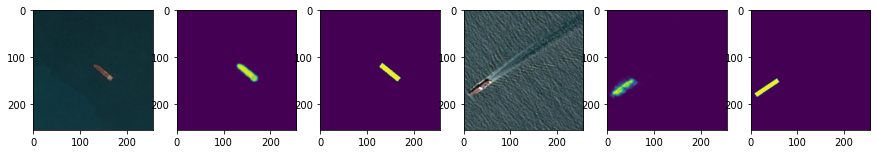

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0152 - dice_loss: 0.6441 - accuracy: 0.9937 - val_loss: 0.0101 - val_dice_loss: 0.6102 - val_accuracy: 0.9971
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0170 - dice_loss: 0.6291 - accuracy: 0.9939 - val_loss: 0.0098 - val_dice_loss: 0.6038 - val_accuracy: 0.9972
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0141 - dice_loss: 0.6208 - accuracy: 0.9945 - val_loss: 0.0097 - val_dice_loss: 0.6036 - val_accuracy: 0.9972
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0129 - dice_loss: 0.5956 - accuracy: 0.9948 - val_loss: 0.0097 - val_dice_loss: 0.6101 - val_accuracy: 0.9971
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0115 - dice_loss: 0.5765 - accuracy: 0.9955 - val_loss: 0.0100 - val_dice_loss: 0.6252 - val_accuracy: 0.9970


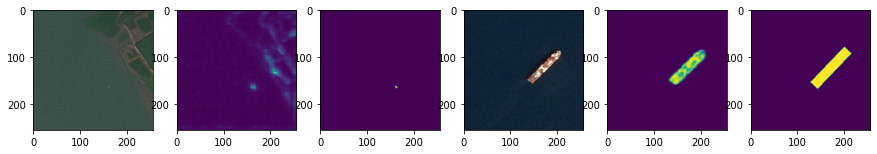

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0089 - dice_loss: 0.6546 - accuracy: 0.9977 - val_loss: 0.0113 - val_dice_loss: 0.7335 - val_accuracy: 0.9967
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0081 - dice_loss: 0.6347 - accuracy: 0.9976 - val_loss: 0.0116 - val_dice_loss: 0.7338 - val_accuracy: 0.9967
Epoch 3/5
2/2 [==============================] - 3s 2s/step - loss: 0.0079 - dice_loss: 0.6099 - accuracy: 0.9977 - val_loss: 0.0120 - val_dice_loss: 0.7338 - val_accuracy: 0.9967
Epoch 4/5
2/2 [==============================] - 3s 2s/step - loss: 0.0092 - dice_loss: 0.6844 - accuracy: 0.9975 - val_loss: 0.0122 - val_dice_loss: 0.7331 - val_accuracy: 0.9967
Epoch 5/5
2/2 [==============================] - 3s 2s/step - loss: 0.0074 - dice_loss: 0.6201 - accuracy: 0.9978 - val_loss: 0.0126 - val_dice_loss: 0.7335 - val_accuracy: 0.9967


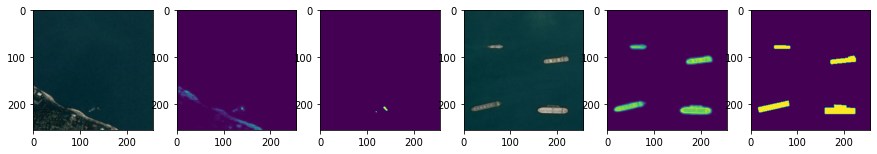

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0315 - dice_loss: 0.6250 - accuracy: 0.9925 - val_loss: 0.0116 - val_dice_loss: 0.6545 - val_accuracy: 0.9953
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0264 - dice_loss: 0.6096 - accuracy: 0.9917 - val_loss: 0.0110 - val_dice_loss: 0.6347 - val_accuracy: 0.9954
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0253 - dice_loss: 0.5542 - accuracy: 0.9927 - val_loss: 0.0111 - val_dice_loss: 0.6278 - val_accuracy: 0.9955
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0220 - dice_loss: 0.5505 - accuracy: 0.9924 - val_loss: 0.0132 - val_dice_loss: 0.6635 - val_accuracy: 0.9957
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0204 - dice_loss: 0.5540 - accuracy: 0.9924 - val_loss: 0.0183 - val_dice_loss: 0.7275 - val_accuracy: 0.9949


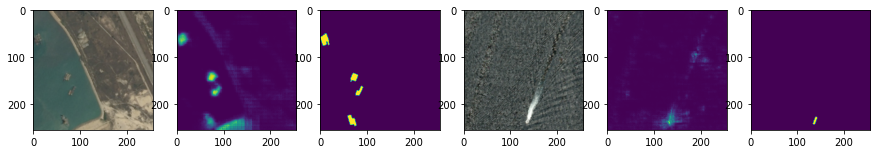

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0133 - dice_loss: 0.7126 - accuracy: 0.9948 - val_loss: 0.0204 - val_dice_loss: 0.6292 - val_accuracy: 0.9948
Epoch 2/5
2/2 [==============================] - 3s 2s/step - loss: 0.0143 - dice_loss: 0.7405 - accuracy: 0.9953 - val_loss: 0.0204 - val_dice_loss: 0.6310 - val_accuracy: 0.9949
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0138 - dice_loss: 0.7248 - accuracy: 0.9955 - val_loss: 0.0182 - val_dice_loss: 0.5923 - val_accuracy: 0.9952
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0108 - dice_loss: 0.6814 - accuracy: 0.9965 - val_loss: 0.0170 - val_dice_loss: 0.5588 - val_accuracy: 0.9952
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0097 - dice_loss: 0.7088 - accuracy: 0.9964 - val_loss: 0.0171 - val_dice_loss: 0.5550 - val_accuracy: 0.9950


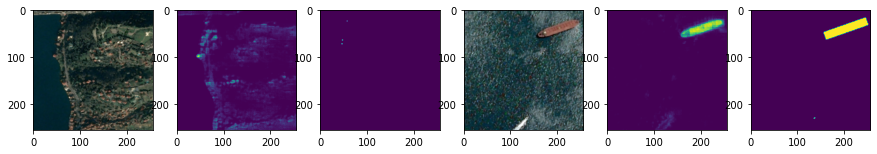

Epoch 1/5
2/2 [==============================] - 5s 3s/step - loss: 0.0139 - dice_loss: 0.6042 - accuracy: 0.9950 - val_loss: 0.0154 - val_dice_loss: 0.7484 - val_accuracy: 0.9960
Epoch 2/5
2/2 [==============================] - 4s 3s/step - loss: 0.0150 - dice_loss: 0.5945 - accuracy: 0.9948 - val_loss: 0.0154 - val_dice_loss: 0.7438 - val_accuracy: 0.9960
Epoch 3/5
2/2 [==============================] - 4s 2s/step - loss: 0.0149 - dice_loss: 0.6063 - accuracy: 0.9943 - val_loss: 0.0151 - val_dice_loss: 0.7323 - val_accuracy: 0.9960
Epoch 4/5
2/2 [==============================] - 4s 2s/step - loss: 0.0145 - dice_loss: 0.5955 - accuracy: 0.9949 - val_loss: 0.0144 - val_dice_loss: 0.7158 - val_accuracy: 0.9960
Epoch 5/5
2/2 [==============================] - 4s 2s/step - loss: 0.0133 - dice_loss: 0.5473 - accuracy: 0.9952 - val_loss: 0.0137 - val_dice_loss: 0.7019 - val_accuracy: 0.9960


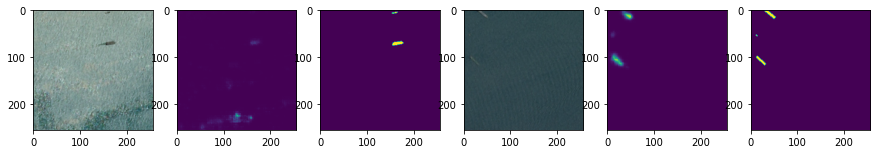

Epoch 1/5
2/2 [==============================] - 4s 2s/step - loss: 0.0139 - dice_loss: 0.6911 - accuracy: 0.9958 - val_loss: 0.0061 - val_dice_loss: 0.6321 - val_accuracy: 0.9979
Epoch 2/5
2/2 [==============================] - 4s 2s/step - loss: 0.0112 - dice_loss: 0.5580 - accuracy: 0.9965 - val_loss: 0.0058 - val_dice_loss: 0.6177 - val_accuracy: 0.9980
Epoch 3/5
1/2 [==============>...............] - ETA: 1s - loss: 0.0096 - dice_loss: 0.4941 - accuracy: 0.9968

KeyboardInterrupt: 

In [53]:
iterations = 10
batch = 20      # batch size
counter = 0     # how many checlpoints saved so far
for iteration in range(iterations):
    start = time()
    for i in range(0, len(dataset)//2-batch-1, batch):
        # first half of the dataset is for training
        images, masks = dataset[list(range(i,i+batch))].values()
        images, masks = transform(images, masks)

        # second half of the dataset is for validation
        vali, valm = dataset[list(range(len(dataset)//2+i,len(dataset)//2+i+batch))].values() 
        vali, valm = transform(vali, valm)
        
        # visualize performance
        plt.figure(figsize=(15,3))
        plt.subplot(1,6,1)
        plt.imshow(np.uint32(vali[0]*stds + means))
        plt.subplot(1,6,2)
        m = model.predict(vali[0:1])
        plt.imshow(m[0])
        plt.subplot(1,6,3)
        plt.imshow(valm[0])
        plt.subplot(1,6,4)
        plt.imshow(np.uint32(images[0]*stds + means))
        plt.subplot(1,6,5)
        m = model.predict(images[0:1])
        plt.imshow(m[0])
        plt.subplot(1,6,6)
        plt.imshow(masks[0])
        plt.show()
        
        model.fit(images, masks, epochs=5, validation_data=(vali,valm), batch_size=10)
        
        if time() - start > 600: # checkpoint
            model.save(f"{modelname}-{counter}.h5")
            counter += 1
            start = time()
    
    # checkpoint after going over all the training data
    model.save(f"{modelname}-{counter}.h5")
    counter += 1

In [49]:
# save the finished model
model.save(f"{modelname}.h5")